# Surveyed Approach to Remote Sensing Image Caption Generation Using the RSICD Dataset

---

## COMP9444 Project — Code Geass

**Team Members:**
- Shayan Ziaei *(z5527663)*
- Pankaj Patel *(z5519861)*
- Revathi Sridhar Surya *(z5520480)*
- Sachin Singh *(z5525041)*
- Jason Widjaja *(z5494973)*



## Table of Contents
1. [Introduction](#Introduction)
2. [Data Sources](#Data-Sources-RSICD)
3. [Exploratary Analysis](#Exploratory-Analysis)
5. [Baseline1: LAM](#Method-1-LAM)
6. [Baseline2: VitGpT2](#Method2-VitGpt2)
8. [FinalModel: BLIP](#Method-3:-BLIP-(Bootstrapping-Language-Image-Pretraining))
9. [Conclusion](#Conclusion)

## Introduction

Image captioning gives a concized descriptive summary of a image, thus capturing its most critical feature. It has applications in different fields including environmental monitoring, urban planning, agriculture, disaster response,defense etc. This project will focus on **image caption generation** specifically on the **RSICD dataset**, aiming to produce **accurate, spatial aware and coherent textual descriptions** of remote sensing images. This wouldd help bridge the gap between visual data and natural language. Such systems can efficiently caption millions of images at a time,  which even a human can fail to perform.

---

### Motivation

*“How do we teach AI to describe the Earth from Above?”*

The ability to automatically generate captions for remote sensing images can:
- Assist **environmental monitoring** by describing land use and vegetation changes.
- Support **urban planning** through identification of buildings, roads, and estimating population density.
- Facilitate **disaster response** by summarizing flood, fire, or earthquake impacts on the ground.
- Enhance **military and surveillance** capabilities resulting in rapid situational awareness.
- Improve **agricultural analysis** by detecting crop types or field layouts.

---

### Problem Statement

The goal of this project is:
1. **To create a model** that generates accurate and coherent captions for remote sensing images in the RSICD dataset (e.g., *"Four baseball fields are surrounded by green trees"*).
2. **To address the challenges** posed by scale variations, diverse categories, and rotation ambiguities prevalent in the RSICD dataset.


## Data Sources-RSICD


We will be using the **RSICD (Remote Sensing Image Captioning Dataset)**, which contains:

- **10,921 remote sensing images**  
- **Five reference captions per image** for robust training and evaluation

These images have been **sourced from**:  
*Google Earth, Baidu Map, MapABC, Tianditu*  
*(Lu et al., 2017)*

**Dataset Repository:** [RSICD on GitHub](https://github.com/201528014227051/RSICD_optimal/tree/master)


## Exploratory Analysis

As stated previously, the  **RSICD (Remote Sensing Image Captioning Dataset)**, contains:

- **10,921 remote sensing images**  
- **Five reference captions per image** for robust training and evaluation

So, in total we have **(31 classes) 10921 images   x 5 captions  = 54,605 image-caption pairs**

---
![file-structure.jpg](file-structure.jpg)
As shown in the image above, the root dataset folder consists of the following main files and folders:
1. **RSICD_images** consistsing of 10,921 remote sensing images.
2. **txtclasses_rsicd** Containing per class text file listing out the individual images belonging to that class. Hence there are a total of 31 txt files in this folder.
3.  **dataset_rsicd.json** Consists of image_ids mapped to a list of 5 captions.

---

**Challenging Aspect:** As the information in the dataset was spread across different files and folders, creating a single dataframe for training and evaluating the models proved to be challenging. Hence seperate scripts had to be written to join these files together to create a single combined dataframe.

We would now be looking at the various aspects of the RSICD Dataset as outlined below:
1. [Challenge 1: Scale Variation](#Challenge-1-Scale-Variation)
2. [Challenge 2-Semantic ambiguity](#Challenge-2-Semantic-ambiguity)
3. [Challenge 3-Rotation ambiguity](#Challenge-3-Rotation-ambiguity)
4. [Challenge 4-Multi Object Scenes](#Challenge-4-Multi-Object-Scenes)
5. [Per class analysis](#Per-class-analysis)
6. [Caption analysis](#Caption-analysis)
7. [Individual Caption Analysis](#Individual-Caption-Analysis)
8. [Preprocessing pipeline](#Preprocessing-Pipeline)



In [ ]:
'''
Helper method to plot images
'''


root_dir = os.path.join("RSICD_optimal-master","RSICD_optimal-master","RSICD_images", "RSICD_images")

def display_images(file_names):
    
    plt.figure(figsize=(12, 4))

    for i, fname in enumerate(file_names):
        img_path = os.path.join(root_dir, fname)

        if os.path.exists(img_path):
            img = Image.open(img_path)
            plt.subplot(1, len(file_names), i + 1)
            plt.imshow(img)
            plt.axis("off")
            plt.title(fname, fontsize=10)
        else:
            print(f" File not found: {img_path}")

    plt.show()


### Challenge 1-Scale Variation

Objects differ significantly in size (e.g., a car vs. a runway).  
Each image in the dataset is relatively small, at **224 × 224** pixels.


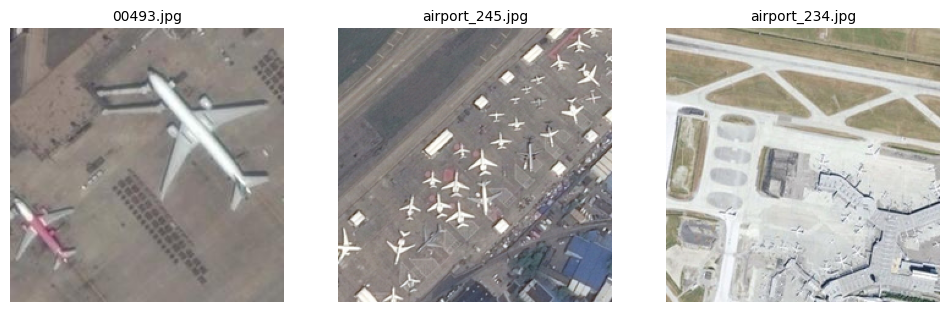

In [ ]:
images_to_show =  ['00493.jpg', 'airport_245.jpg', 'airport_234.jpg']
display_images(images_to_show)

### Challenge 2-Semantic ambiguity

Visually similar textures may represent different categories  (e.g., meadow vs. farmland) as shown below.



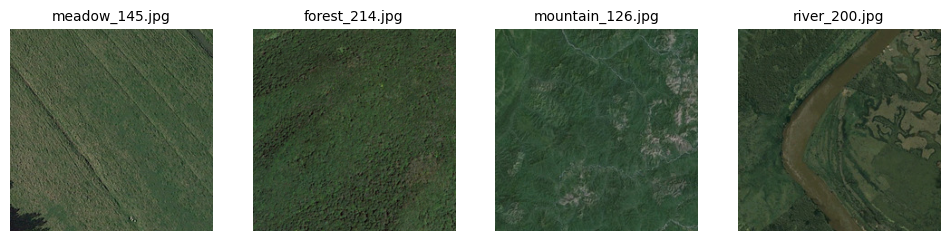

In [ ]:
images_to_show =  ['meadow_145.jpg', 'forest_214.jpg', 'mountain_126.jpg', 'river_200.jpg']
display_images(images_to_show)

***is this a Farmland / Meadow / Forest / Mountain?***

### Challenge 3-Rotation ambiguity

- No fixed orientation in aerial views, as shown below.  
- May produce different captions for the same image when rotated, affecting evaluation accuracy.  
- ***CNN-based models can be rotation-sensitive — features extracted may vary with rotation.***


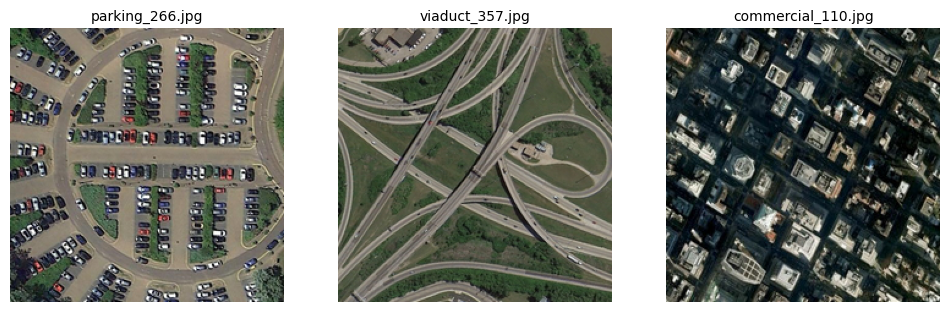

In [ ]:
images_to_show =  ['parking_266.jpg', 'viaduct_357.jpg', 'commercial_110.jpg']
display_images(images_to_show)

### Challenge 4 Multi Object Scenes
A single image may contain roads, rivers, and buildings all at once. This can confuse the vision encoder and the attention mechanism in determining which part of the image to focus on.

![multi-object-scenes.jpg](multi-object-scenes.jpg)


In [ ]:
# Standard Library Imports
import os
import json
import random
import shutil

# Third-Party Libraries
import numpy as np
import torch
from torch import nn
from torch.utils.data import Dataset, DataLoader
from torchvision import models, transforms
import torchvision.transforms as T
from PIL import Image
import matplotlib.pyplot as plt
from tqdm import tqdm
from nltk.translate.bleu_score import corpus_bleu


--- Counting Images per Category ---
'Bridge': 459 images
'Center': 260 images
'Church': 240 images
'Commercial': 350 images
'DenseResidential': 410 images
'Desert': 300 images
'Farmland': 370 images
'Forest': 250 images
'Industrial': 390 images
'Meadow': 280 images
'MediumResidential': 290 images
'Mountain': 340 images
'Park': 350 images
'Parking': 390 images
'playfields': 661 images
'Playground': 370 images
'Pond': 420 images
'Port': 389 images
'RailwayStation': 260 images
'Resort': 290 images
'River': 410 images
'School': 300 images
'SparseResidential': 300 images
'Square': 330 images
'Stadium': 290 images
'StorageTanks': 396 images
'Viaduct': 420 images
'Airport': 420 images
'BareLand': 310 images
'BaseballField': 276 images
'Beach': 400 images

--- Summary ---
Total images counted across all categories: 10921

Detailed Image Counts:
- Bridge: 459
- Center: 260
- Church: 240
- Commercial: 350
- DenseResidential: 410
- Desert: 300
- Farmland: 370
- Forest: 250
- Industrial: 390
- Me

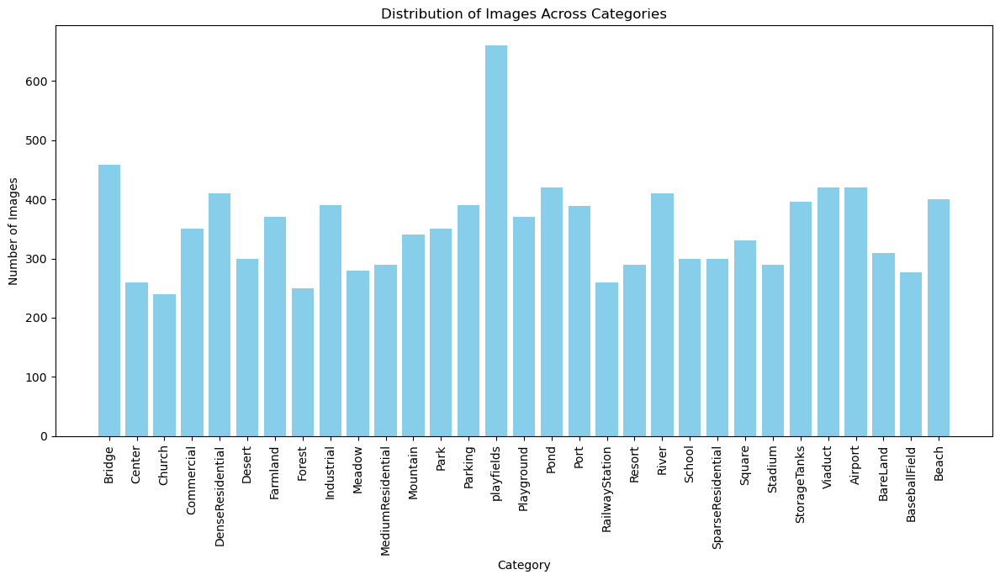

In [ ]:

def count_images_per_category(category_txt_files_path: str, categories: list[str]):
    
    category_counts = {}
    print("--- Counting Images per Category ---")

    for category in categories:
        category_txt_file = os.path.join(category_txt_files_path, f"{category}.txt")

        if not os.path.exists(category_txt_file):
            print(f"Warning: Category text file not found for '{category}': {category_txt_file}. Skipping count.")
            category_counts[category] = 0
            continue

        try:
            with open(category_txt_file, 'r') as f:
                # Read image filenames, stripping whitespace and filtering out empty lines
                image_filenames = [line.strip() for line in f if line.strip()]
                count = len(image_filenames)
                category_counts[category] = count
                print(f"'{category}': {count} images")
        except Exception as e:
            print(f"Error reading {category_txt_file}: {e}. Skipping count for this category.")
            category_counts[category] = 0

    print("\n--- Summary ---")
    total_images = sum(category_counts.values())
    print(f"Total images counted across all categories: {total_images}")
    return category_counts

category_text_files_directory = 'class'

all_categories = [
    "Bridge", "Center", "Church", "Commercial", "DenseResidential", "Desert",
    "Farmland", "Forest", "Industrial", "Meadow", "MediumResidential", "Mountain",
    "Park", "Parking", "playfields", "Playground", "Pond", "Port",
    "RailwayStation", "Resort", "River", "School", "SparseResidential", "Square",
    "Stadium", "StorageTanks", "Viaduct", "Airport", "BareLand", "BaseballField", "Beach"
]

if __name__ == "__main__":
    image_counts = count_images_per_category(
        category_text_files_directory,
        all_categories
    )
    print("\nDetailed Image Counts:")
    for category, count in image_counts.items():
        print(f"- {category}: {count}")

    #plotting
    import matplotlib.pyplot as plt

    categories_for_plot = list(image_counts.keys())
    counts_for_plot = list(image_counts.values())

    plt.figure(figsize=(12, 7))
    plt.bar(categories_for_plot, counts_for_plot, color='skyblue')
    plt.xlabel("Category")
    plt.ylabel("Number of Images")
    plt.title("Distribution of Images Across Categories")
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.show()

### Per class analysis
The above generate plot gives information regarding the class distribution of the RSICD dataset.

***From the image shown above we can conclude that there is a class imbalance in our dataset.***
Which means model would be able to  perform good for some classes (like playfields) and worse for others (such as Railway Station).***

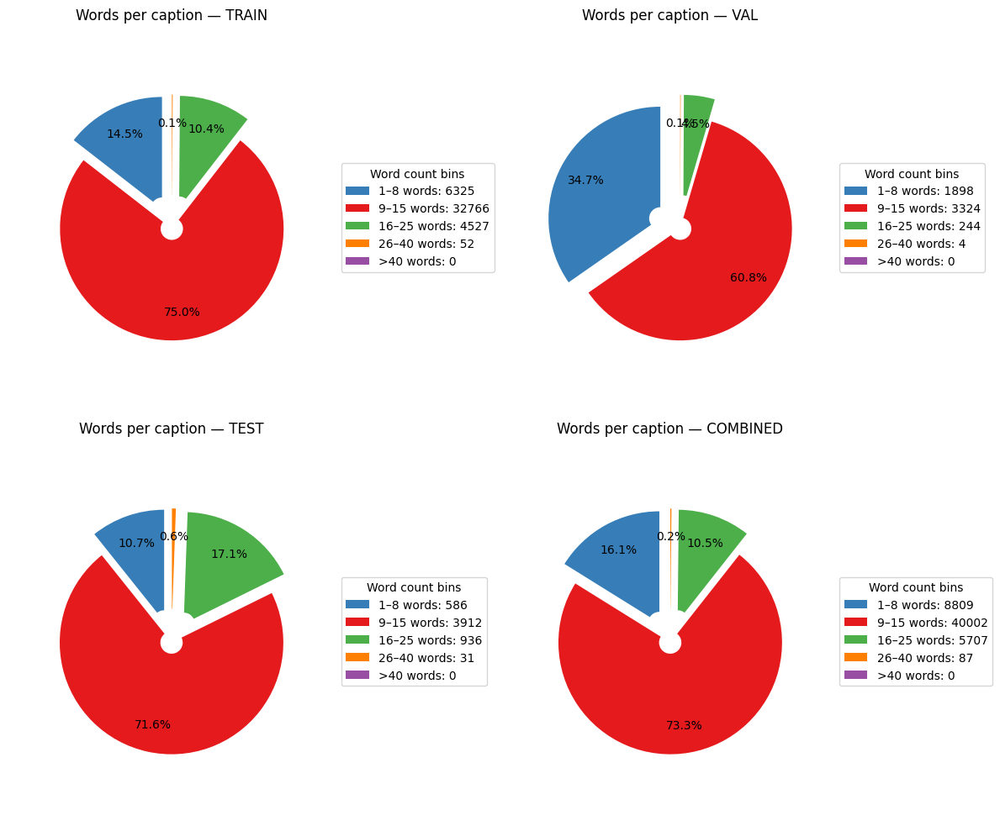

In [ ]:

# data path
train_path = "split_train.json"
val_path   = "split_val.json"
test_path  = "split_test.json"

# ---- helpers ----
def load_word_counts(path):
    """Return a list of word counts for every caption in the file."""
    with open(path, "r", encoding="utf-8") as f:
        data = json.load(f)
    counts = []
    for item in data:
        captions = item.get("captions", [])
        for cap in captions:
            # Count words by whitespace split
            counts.append(len(cap.strip().split()))
    return counts

def bin_counts_wordlength(counts):
    """
    Bin word counts into categories.
    Example bins: 1–8, 9–15, 16–25, 26–40, >40
    """
    bins = {
        "1–8 words":   0,
        "9–15 words":  0,
        "16–25 words": 0,
        "26–40 words": 0,
        ">40 words":   0
    }
    for wc in counts:
        if wc <= 8:
            bins["1–8 words"] += 1
        elif wc <= 15:
            bins["9–15 words"] += 1
        elif wc <= 25:
            bins["16–25 words"] += 1
        elif wc <= 40:
            bins["26–40 words"] += 1
        else:
            bins[">40 words"] += 1
    return list(bins.keys()), list(bins.values())

def draw_pie(ax, labels, sizes, title):
    colors = ["#377eb8", "#e41a1c", "#4daf4a", "#ff7f00", "#984ea3"]  # fixed palette
    max_idx = int(np.argmax(sizes))
    explode = [0.0 if i == max_idx or sizes[i] == 0 else 0.2 for i in range(len(sizes))]

    wedges, *_ = ax.pie(
        sizes,
        labels=None,  # legend instead of direct labels
        colors=colors,
        explode=explode,
        startangle=90,
        autopct=lambda p: f"{p:.1f}%" if p > 0 else "",
        pctdistance=0.75,
        wedgeprops=dict(width=0.9)
    )
    ax.axis("equal")
    ax.set_title(title)
    legend_labels = [f"{lab}: {cnt}" for lab, cnt in zip(labels, sizes)]
    ax.legend(wedges, legend_labels, title="Word count bins",
              loc="center left", bbox_to_anchor=(1, 0.5))

# ---- compute ----
wc_train = load_word_counts(train_path)
wc_val   = load_word_counts(val_path)
wc_test  = load_word_counts(test_path)
wc_all   = wc_train + wc_val + wc_test

labels, sizes_train = bin_counts_wordlength(wc_train)
_,      sizes_val   = bin_counts_wordlength(wc_val)
_,      sizes_test  = bin_counts_wordlength(wc_test)
_,      sizes_all   = bin_counts_wordlength(wc_all)

# ---- plot pies ----
fig, axes = plt.subplots(2, 2, figsize=(12, 10))
draw_pie(axes[0,0], labels, sizes_train, "Words per caption — TRAIN")
draw_pie(axes[0,1], labels, sizes_val,   "Words per caption — VAL")
draw_pie(axes[1,0], labels, sizes_test,  "Words per caption — TEST")
draw_pie(axes[1,1], labels, sizes_all,   "Words per caption — COMBINED")
plt.tight_layout()
plt.show()


### Caption analysis
The above generated pie char reveals that ***Most captions have a lesser word count (<15).***.
This means the captions arent very descriptive.

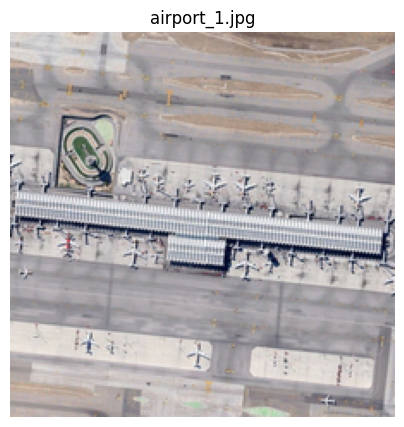

Reference captions (5):
1. many planes are parked next to a long building in an airport .
2. many planes are parked next to a long building in an airport .
3. many planes are parked next to a long building in an airport .
4. many planes are parked next to a long building in an airport .
5. many planes are parked next to a long building in an airport .

Labels: Airport


In [ ]:

def show_image_with_captions(root_dir, json_path, image_name):
    
    with open(json_path, "r", encoding="utf-8") as f:
        data = json.load(f)

    entry = next((it for it in data if it.get("image") == image_name), None)
    if entry is None:
        print(f" Not found in JSON: {image_name}")
        return

    # --- locate image on disk 
    img_path = os.path.join(root_dir, image_name)
    if not os.path.exists(img_path):
        # search subfolders
        found = None
        for r, _, files in os.walk(root_dir):
            if image_name in files:
                found = os.path.join(r, image_name)
                break
        if found:
            img_path = found
        else:
            print(f" Image file not found under root_dir: {image_name}")
            return

    # --- display image ---
    img = Image.open(img_path).convert("RGB")
    plt.figure(figsize=(5, 5))
    plt.imshow(img)
    plt.axis("off")
    plt.title(image_name)
    plt.show()

    # --- print captions (and labels) ---
    captions = entry.get("captions", [])
    print(f"Reference captions ({len(captions)}):")
    for i, c in enumerate(captions, 1):
        print(f"{i}. {c}")

    if entry.get("labels"):
        print("\nLabels:", ", ".join(entry["labels"]))

# ===== print image,caption pair =====
image_name = "airport_1.jpg"

show_image_with_captions(root_dir, train_path, image_name)


### Individual Caption Analysis
On further analysis of the captions per image, we can clearly conclude from the above image that RSICD dataset lacks flexibility and diversity in the reference captions. The captions of a given image often end up providing similar descriptive sentences,  not giving enough insightful information (like colour, time of day, shape or spatial structure).  This would affect the training of our models to generate appropriate captions for a diverse set of images as we shall see.

### Preprocessing Pipeline

The following preprocessing steps were used prior to training our model:

1. **Vocabulary Construction**
   - Collect all captions from the **train**, **validation**, and **test** splits.
   - Convert captions to lowercase and split into words.
   - Count word frequencies and include only words with frequency ≥ `min_freq`.
   - Add special tokens:
     - `<PAD>` = 0  
     - `<SOS>` = 1  
     - `<EOS>` = 2  
     - `<UNK>` = 3  

2. **Caption Encoding**
   - Convert each caption into a sequence of token IDs using the vocabulary.
   - Replace unknown words with `<UNK>`.

3. **Collation & Padding**
   - Add `<SOS>` at the start and `<EOS>` at the end of each caption, for our model to read the caption correctly.
   - Use `pad_sequence(batch_first=True)` to pad all captions in a batch to the same length with `<PAD>` (ID = 0).
   - Captions are returned as a `(B, T)` tensor.

4. **Image Processing**
   - Images are loaded from the RSICD dataset and transformed using `image_transform` (resize, normalization).
   - In the batch, images are stacked into a `(B, C, H, W)` tensor.

5. **DataLoaders**
   - **Train**: `shuffle=True`  
   - **Validation/Test**: `shuffle=False`
   - Common settings: `batch_size=32`, `pin_memory=True`, `num_workers=2`
   - The same tokenizer is used for all splits to ensure consistent token IDs.

**Result:**  
Each batch contains:
- A tensor of preprocessed images `(B, C, H, W)`
- A tensor of padded caption tokens `(B, T)` with `<SOS>` and `<EOS>` markers.


## Method 1-LAM

---

<p align = "justify">We use the **LAM (Label-Attention Mechanism)**, which is composed of an **encoder–decoder** architecture for image captioning.  
Spatial features are extracted by a pre-trained **ResNet-152** as the visual encoder, and an **LSTM** acts as the decoder to generate captions with label-based attention.  

The Attention Mechanism in LAM is **Label-Guided Attention**, which better utilizes image features by focusing on relevant regions.  
The model consists of:
- **Image Feature Path**
- **Hidden State Path**
- **Label-Attention Path**  

<p align = "justify">These paths are merged for relevance computation.  
Unlike concatenation used in baseline pipelines (which output label embeddings as part of the inputs), LAM’s approach is less category-agnostic and better focuses on informative regions.  
As a result:

- The decoder can articulate complex manifolds and high-frequency details more effectively.
- The direct association between semantic label cues and visual attention leads to more coherent captions.

---
### LAM Architecture
![lam.jpg](lam.jpg)  

<p align = "justify">The Label Attention Mechanism (LAM) architecture represents an innovative approach to image captioning that enhances traditional CNN-RNN frameworks by incorporating explicit label information to guide the attention process. This system is designed to address limitations in conventional image captioning models by leveraging both visual features and semantic object labels to generate more accurate and contextually relevant captions. The architecture demonstrates how multi-modal information can be effectively combined to improve the quality of automated image understanding and natural language generation.

<p align = "justify">The encoder component employs a CNN-based approach using ResNet151 to extract rich visual features from input images, which are then processed through resizing and feature extraction layers. The core innovation lies in the Label Attention Mechanism, which operates through three distinct but interconnected pathways. The Label Attention pathway embeds predicted object labels (such as "airplane") and generates attention weights that help focus on relevant image regions. The Image Feature pathway processes the CNN-extracted features through fully connected layers to create visual representations. The Hidden State pathway maintains temporal context from the decoder's previous states, ensuring coherent caption generation across time steps.

<p align = "justify">The decoder utilizes an LSTM-based architecture that combines information from all three pathways to generate captions word by word. The system creates a context vector by integrating label embeddings, visual features, and hidden states through attention mechanisms, which then guides the LSTM in producing each word of the final caption. This multi-pathway approach allows the model to simultaneously consider what objects are present (labels), how they appear visually (image features), and what has been generated so far (hidden states), resulting in more accurate and contextually appropriate descriptions. The architecture effectively demonstrates how incorporating explicit semantic information alongside visual features can significantly enhance the performance of image captioning systems.





---

### LAM Model Hyperparameters

| Hyperparameter | Value | Description |
|----------------|-------|-------------|
| **EPOCHS**     | 10    | Number of training epochs |
| **BATCH_SIZE** | 32    | Number of samples per training batch |
| **EMBED_DIM**  | 256   | Dimension of the word embedding vectors |
| **HIDDEN_DIM** | 512   | Dimension of the hidden state in the LSTM/decoder |
| **PATIENCE**   | 3     | Early stopping patience (epochs without improvement) |

---

**Reference:** [https://www.mdpi.com/2072-4292/11/20/2349](https://www.mdpi.com/2072-4292/11/20/2349)

---
### LAM Table of content
Other sections related to LAM are as below:
1. [LAM Result](#LAM-Result)
2. [Generated captions by LAM](#Generated-captions-by-LAM)
3. [LAM Conclusion](#LAM-Conclusion)



In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#Paths

IMG_DIR = '/content/drive/MyDrive/RSICD_optimal-master/RSICD_images/RSICD_images'

SPLIT_JSON = {
    'train': "/content/drive/MyDrive/Colab Notebooks/COMP9444/LAM/split_train.json",
    'val': "/content/drive/MyDrive/Colab Notebooks/COMP9444/LAM/split_val.json",
    'test': "/content/drive/MyDrive/Colab Notebooks/COMP9444/LAM/split_test.json"
}

In [ ]:
image_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])


In [ ]:
class RSICDDataset(Dataset):
    def __init__(self, json_file, transform=None):
        with open(json_file, 'r') as f:
            data = json.load(f)

        self.samples = []
        for item in data:
            for cap in item['captions']:
                self.samples.append((item['image'], cap))

        self.transform = transform

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        img_path, caption = self.samples[idx]
        img = Image.open(os.path.join(IMG_DIR, img_path)).convert("RGB")  # define IMG_DIR before this
        if self.transform:
            img = self.transform(img)
        return img, caption


In [ ]:
class Tokenizer:
    def __init__(self, samples, min_freq=1):
        self.word2idx = {'<PAD>': 0, '<SOS>': 1, '<EOS>': 2, '<UNK>': 3}
        self.idx2word = {0: '<PAD>', 1: '<SOS>', 2: '<EOS>', 3: '<UNK>'}
        freq = {}
        idx = 4

        for _, caption in samples:
            for word in caption.lower().split():
                freq[word] = freq.get(word, 0) + 1

        for word, count in freq.items():
            if count >= min_freq:
                self.word2idx[word] = idx
                self.idx2word[idx] = word
                idx += 1

    def encode(self, text):
        return [self.word2idx.get(w, 3) for w in text.lower().split()]

    def decode(self, ids):
        return ' '.join([self.idx2word.get(i, '<UNK>') for i in ids if i not in [0, 1, 2]])

    def __len__(self):
        return len(self.word2idx)


In [ ]:
# Build tokenizer
with open(SPLIT_JSON['train'], 'r') as f:
    data = json.load(f)

samples = []
for item in data:
    for cap in item['captions']:  # cap is already a string
        samples.append((item['image'], cap))  #

tokenizer = Tokenizer(samples)


In [ ]:
from torch.nn.utils.rnn import pad_sequence

class MyCollate:
    def __init__(self, tokenizer):
        self.tokenizer = tokenizer

    def __call__(self, batch):
        imgs, caps = zip(*batch)
        enc_caps = []
        for c in caps:
            tokens = [1] + self.tokenizer.encode(c) + [2]  # <SOS> ... <EOS>
            #tokens = [1] + self.tokenizer.encode(c)[:MAX_LEN - 2] + [2]
            enc_caps.append(torch.tensor(tokens, dtype=torch.long))
        padded = pad_sequence(enc_caps, batch_first=True, padding_value=0)
        return torch.stack(imgs), padded


In [ ]:
class LAMEncoder(nn.Module):
    def __init__(self, embed_dim):
        super().__init__()
        base = models.resnet152(pretrained=True)
        self.backbone = nn.Sequential(*list(base.children())[:-2])
        self.pool = nn.AdaptiveAvgPool2d((1, 1))
        self.reduce = nn.Conv2d(2048, embed_dim, 1)

    def forward(self, x):
        feats = self.backbone(x)  # (B, 2048, 7, 7)
        local = self.reduce(feats)  # (B, D, 7, 7)
        global_ = self.pool(feats).squeeze(-1).squeeze(-1)  # (B, 2048)
        return local, global_


class LAMDecoder(nn.Module):
    def __init__(self, embed_dim, hidden_dim, vocab_size):
        super().__init__()
        self.embed = nn.Embedding(vocab_size, embed_dim)
        self.lstm = nn.LSTMCell(embed_dim * 2, hidden_dim)
        self.fc = nn.Linear(hidden_dim, vocab_size)
        self.attn = nn.Linear(embed_dim + hidden_dim, 49)

        #Add
        self.init_h = nn.Linear(2048, hidden_dim)
        self.init_c = nn.Linear(2048, hidden_dim)


    def forward(self, local_feats, global_feats, captions):
        B, D, H, W = local_feats.shape
        N = H * W
        local = local_feats.view(B, D, N).permute(0, 2, 1)  # (B, N, embed_dim)
        #h = torch.zeros(B, HIDDEN_DIM, device=local_feats.device)
        #c = torch.zeros(B, HIDDEN_DIM, device=local_feats.device)

        h = self.init_h(global_feats)
        c = self.init_c(global_feats)

        embeddings = self.embed(captions)  # (B, T, embed_dim)
        outputs = []

        for t in range(embeddings.size(1)):
            x = embeddings[:, t]  # (B, embed_dim)
            attn_in = torch.cat([x, h], dim=1)  # (B, embed_dim + hidden_dim)
            attn_scores = torch.softmax(self.attn(attn_in), dim=1)  # (B, N)
            context = torch.bmm(attn_scores.unsqueeze(1), local).squeeze(1)  # (B, embed_dim)
            lstm_in = torch.cat([x, context], dim=1)  # (B, embed_dim * 2)
            h, c = self.lstm(lstm_in, (h, c))  # (B, hidden_dim)
            out = self.fc(h)  # (B, vocab_size)
            outputs.append(out)

        return torch.stack(outputs, dim=1)  # (B, T, vocab_size)


In [ ]:
from evaluate import load
bleu = load("bleu")
meteor = load("meteor")
rouge = load("rouge")
#cider = load("cider")


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...


In [ ]:
def evaluate_model(encoder, decoder, loader, tokenizer, device):
    encoder.eval()
    decoder.eval()
    preds, refs = [], []
    ce_loss = nn.CrossEntropyLoss(ignore_index=0, label_smoothing=0.0)

    total_loss = 0
    total_tokens = 0

    with torch.no_grad():
        for imgs, caps in loader:
            imgs, caps = imgs.to(device), caps.to(device)  #  fix here
            local, global_ = encoder(imgs)

            out = decoder(local, global_, caps[:, :-1])
            loss = ce_loss(out.reshape(-1, out.size(-1)), caps[:, 1:].reshape(-1))
            total_loss += loss.item() * caps.size(0)
            total_tokens += caps.size(0)

            B = imgs.size(0)

            '''
            h = torch.zeros(B, HIDDEN_DIM, device=imgs.device)
            c = torch.zeros(B, HIDDEN_DIM, device=imgs.device)
            '''

            h = decoder.init_h(global_)
            c = decoder.init_c(global_)

            #inputs = torch.tensor([tokenizer.word_index["<start>"]] * B).to(device)
            inputs = torch.tensor([tokenizer.word2idx["<SOS>"]] * B).to(device)
            generated = [[] for _ in range(B)]

            D, H_feat, W_feat = local.shape[1:]
            N = H_feat * W_feat
            local_flat = local.view(B, D, N).permute(0, 2, 1)  # (B, N, embed_dim)

            for _ in range(MAX_LEN):
                x = decoder.embed(inputs)
                attn_in = torch.cat([x, h], dim=1)
                attn_scores = torch.softmax(decoder.attn(attn_in), dim=1)
                context = torch.bmm(attn_scores.unsqueeze(1), local_flat).squeeze(1)
                lstm_in = torch.cat([x, context], dim=1)
                h, c = decoder.lstm(lstm_in, (h, c))
                out = decoder.fc(h)
                inputs = out.argmax(1)
                for i in range(B):
                    generated[i].append(inputs[i].item())


        for i in range(B):
            decoded_seq = []
            for token_id in generated[i]:
                if token_id == tokenizer.word2idx["<EOS>"]:
                    break
                decoded_seq.append(token_id)
            pred = tokenizer.decode(decoded_seq)
            # Check type of caps[i] and decode appropriately
            if isinstance(caps[i], torch.Tensor):
                  tgt = tokenizer.decode(caps[i].tolist())
            elif isinstance(caps[i], list):
                  tgt = tokenizer.decode(caps[i])
            else:
                  tgt = caps[i]  # assumed to be a string

            preds.append(pred)
            refs.append([tgt])
    ...



    print(f"Predicted: {preds[0]}")
    print(f"Reference: {refs[0][0]}")

    # Token-level evaluation
    bleu1 = load("bleu").compute(predictions=preds, references=refs, max_order=1)
    bleu2 = load("bleu").compute(predictions=preds, references=refs, max_order=2)
    bleu3 = load("bleu").compute(predictions=preds, references=refs, max_order=3)
    bleu4 = load("bleu").compute(predictions=preds, references=refs, max_order=4)
    meteor_score = meteor.compute(predictions=preds, references=refs)
    rouge_score = rouge.compute(predictions=preds, references=refs)
    #cider_score = cider.compute(predictions=preds, references=refs)

    print(f"BLEU-1: {bleu1['bleu']:.4f}")
    print(f"BLEU-2: {bleu2['bleu']:.4f}")
    print(f"BLEU-3: {bleu3['bleu']:.4f}")
    print(f"BLEU-4: {bleu4['bleu']:.4f}")
    print(f"METEOR: {meteor_score['meteor']:.4f}")
    print(f"ROUGE-L: {rouge_score['rougeL']:.4f}")
    #print(f"CIDEr: {cider_score['cider']:.4f}")

    #print("BLEU-4:", corpus_bleu(refs, preds))
    avg_val_loss = total_loss / total_tokens
    print(f"Validation Loss: {avg_val_loss:.4f}")
    return avg_val_loss




In [ ]:
def train_model(encoder, decoder, train_loader, val_loader, tokenizer, device, model_path):
    encoder.train()
    decoder.train()
    #ce_loss = nn.CrossEntropyLoss(ignore_index=0)
    ce_loss = nn.CrossEntropyLoss(ignore_index=0, label_smoothing=0.1)
    opt = torch.optim.Adam(list(decoder.parameters()) + list(encoder.reduce.parameters()), lr=1e-3)

    best_val_loss = float('inf')
    patience = 3
    wait = 0

    for epoch in range(EPOCHS):
        total = 0
        loop = tqdm(train_loader, desc=f"Epoch {epoch+1}/{EPOCHS}", leave=False)
        for imgs, caps in loop:
            imgs, caps = imgs.to(device), caps.to(device)
            local, global_ = encoder(imgs)
            out = decoder(local, global_, caps[:, :-1])
            loss = ce_loss(out.reshape(-1, len(tokenizer)), caps[:, 1:].reshape(-1))
            opt.zero_grad()
            loss.backward()
            opt.step()
            total += loss.item()
            loop.set_postfix(loss=loss.item())

        print(f"[Epoch {epoch+1}] Training Loss: {total:.4f}")
        val_loss = evaluate_model(encoder, decoder, val_loader, tokenizer, device)
        print(f"[Epoch {epoch+1}] Validation Loss: {val_loss:.4f}")

        # === Early Stopping based on Validation Loss ===
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            wait = 0
            print(f"New best val loss: {val_loss:.4f}. Saving model...")
            torch.save((encoder.state_dict(), decoder.state_dict()), model_path)
        else:
            wait += 1
            print(f"No improvement. Patience: {wait}/{patience}")
            if wait >= patience:
                print("Early stopping triggered.")
                break


In [ ]:
from torch.utils.data import Subset

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#subset_size = 1000
BATCH_SIZE = 32

# Load datasets
train_ds = RSICDDataset(SPLIT_JSON['train'], transform=image_transform)
val_ds = RSICDDataset(SPLIT_JSON['val'], transform=image_transform)
test_ds = RSICDDataset(SPLIT_JSON['test'], transform=image_transform)

# Build tokenizer
tokenizer = Tokenizer(train_ds.samples + val_ds.samples + test_ds.samples)

train_loader = DataLoader(
    train_ds,
    #Subset(train_ds, list(range(subset_size))),
    batch_size=BATCH_SIZE, shuffle=True, collate_fn=MyCollate(tokenizer), num_workers=2, pin_memory = True,
    #collate_fn=MyCollate(tokenizer)
    )

val_loader = DataLoader(
    val_ds,
    #Subset(val_ds, list(range(subset_size))),
    batch_size=BATCH_SIZE, shuffle=False, collate_fn=MyCollate(tokenizer), num_workers=2, pin_memory = True,
    #collate_fn=MyCollate(tokenizer)
    )


test_loader = DataLoader(
    test_ds,
    #Subset(test_ds, list(range(subset_size))),
    batch_size=BATCH_SIZE, shuffle=False, collate_fn=MyCollate(tokenizer), num_workers=2, pin_memory = True,
    #collate_fn=MyCollate(tokenizer)
    )



In [ ]:
# Init model
EMBED_DIM = 256
HIDDEN_DIM = 512
encoder = LAMEncoder(EMBED_DIM).to(device)
decoder = LAMDecoder(EMBED_DIM, HIDDEN_DIM, len(tokenizer)).to(device)




/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet152_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet152_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet152-394f9c45.pth" to /root/.cache/torch/hub/checkpoints/resnet152-394f9c45.pth
100%|██████████| 230M/230M [00:01<00:00, 225MB/s]


In [ ]:

# Hyperparameters


EPOCHS = 10
MAX_LEN = 30
model_path = "/content/drive/MyDrive/Colab Notebooks/COMP9444/LAM/LAMbest.pt"



In [ ]:

#Setup
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

#Re-instantiate encoder & decoder
VOCAB_SIZE = len(tokenizer.word2idx)
EMBED_DIM = 256
HIDDEN_DIM = 512
MAX_LEN = 30

encoder = LAMEncoder(EMBED_DIM).to(device)
#decoder = LAMDecoder(VOCAB_SIZE, EMBED_DIM, HIDDEN_DIM).to(device)
decoder = LAMDecoder(EMBED_DIM, HIDDEN_DIM, 3329).to(device)

#  Load model weights ===
checkpoint = torch.load(model_path, map_location=device)
encoder.load_state_dict(checkpoint[0])
decoder.load_state_dict(checkpoint[1])
decoder.embed = decoder.embed.to(device)  # Embed layer to device explicitly

encoder.eval()
decoder.eval()

preds, refs = [], []
ce_loss = nn.CrossEntropyLoss(ignore_index=0, label_smoothing=0.1)

total_loss = 0
total_tokens = 0

with torch.no_grad():
        for imgs, caps in test_loader:
            imgs, caps = imgs.to(device), caps.to(device)
            local, global_ = encoder(imgs)

            out = decoder(local, global_, caps[:, :-1])
            loss = ce_loss(out.reshape(-1, out.size(-1)), caps[:, 1:].reshape(-1))
            total_loss += loss.item() * caps.size(0)
            total_tokens += caps.size(0)

            B = imgs.size(0)
            h = torch.zeros(B, HIDDEN_DIM, device=device)
            c = torch.zeros(B, HIDDEN_DIM, device=device)
            inputs = torch.tensor([tokenizer.word2idx["<SOS>"]] * B, device=device)
            generated = [[] for _ in range(B)]

            D, H_feat, W_feat = local.shape[1:]
            N = H_feat * W_feat
            local_flat = local.view(B, D, N).permute(0, 2, 1)

            for _ in range(MAX_LEN):
                x = decoder.embed(inputs)
                attn_in = torch.cat([x, h], dim=1)
                attn_scores = torch.softmax(decoder.attn(attn_in), dim=1)
                context = torch.bmm(attn_scores.unsqueeze(1), local_flat).squeeze(1)
                lstm_in = torch.cat([x, context], dim=1)
                h, c = decoder.lstm(lstm_in, (h, c))
                out = decoder.fc(h)
                inputs = out.argmax(1)
                for i in range(B):
                    generated[i].append(inputs[i].item())

            for i in range(B):
                decoded_seq = []
                for token_id in generated[i]:
                    if token_id == tokenizer.word2idx["<EOS>"]:
                        break
                    decoded_seq.append(token_id)
                pred = tokenizer.decode(decoded_seq)

                tgt = tokenizer.decode(caps[i].tolist()) if isinstance(caps[i], torch.Tensor) else tokenizer.decode(caps[i])
                preds.append(pred)
                refs.append([tgt])

        print(f"\nSample Prediction:\nPredicted: {preds[0]}\nReference: {refs[0][0]}")

        # === Evaluate metrics ===
        bleu = load("bleu")
        meteor = load("meteor")
        rouge = load("rouge")

        bleu1 = bleu.compute(predictions=preds, references=refs, max_order=1)
        bleu2 = bleu.compute(predictions=preds, references=refs, max_order=2)
        bleu3 = bleu.compute(predictions=preds, references=refs, max_order=3)
        bleu4 = bleu.compute(predictions=preds, references=refs, max_order=4)
        meteor_score = meteor.compute(predictions=preds, references=refs)
        rouge_score = rouge.compute(predictions=preds, references=refs)

        print(f"\n=== Test Evaluation Results ===")
        print(f"BLEU-1: {bleu1['bleu']:.4f}")
        print(f"BLEU-2: {bleu2['bleu']:.4f}")
        print(f"BLEU-3: {bleu3['bleu']:.4f}")
        print(f"BLEU-4: {bleu4['bleu']:.4f}")
        print(f"METEOR: {meteor_score['meteor']:.4f}")
        print(f"ROUGE-L: {rouge_score['rougeL']:.4f}")


In [ ]:
# Train and evaluate
train_model(encoder, decoder, train_loader, val_loader, tokenizer, device, model_path)

[Epoch 1] Training Loss: 3673.7744


Predicted: a road is near a road with many cars .
Reference: the huge football field sitting in this huge lawn is marked with 'camden' and 'panthers' .
BLEU-1: 0.3529
BLEU-2: 0.1920
BLEU-3: 0.1102
BLEU-4: 0.0000
METEOR: 0.2884
ROUGE-L: 0.2783
Validation Loss: 1.9602
[Epoch 1] Validation Loss: 1.9602
New best val loss: 1.9602. Saving model...


[Epoch 2] Training Loss: 2980.7885


Predicted: a playground with a basketball field next to it is next to a road .
Reference: the huge football field sitting in this huge lawn is marked with 'camden' and 'panthers' .
BLEU-1: 0.4062
BLEU-2: 0.2555
BLEU-3: 0.1535
BLEU-4: 0.0685
METEOR: 0.3345
ROUGE-L: 0.3305
Validation Loss: 1.9385
[Epoch 2] Validation Loss: 1.9385
New best val loss: 1.9385. Saving model...


[Epoch 3] Training Loss: 2739.8572


Predicted: a playground with two basketball fields next to it is surrounded by some green trees .
Reference: the huge football field sitting in this huge lawn is marked with 'camden' and 'panthers' .
BLEU-1: 0.3771
BLEU-2: 0.2208
BLEU-3: 0.1258
BLEU-4: 0.0463
METEOR: 0.3927
ROUGE-L: 0.3381
Validation Loss: 1.9727
[Epoch 3] Validation Loss: 1.9727
No improvement. Patience: 1/3


[Epoch 4] Training Loss: 2552.4076


Predicted: a playground with two basketball fields in it is surrounded by some green trees and many buildings .
Reference: the huge football field sitting in this huge lawn is marked with 'camden' and 'panthers' .
BLEU-1: 0.4791
BLEU-2: 0.2937
BLEU-3: 0.1724
BLEU-4: 0.0741
METEOR: 0.4383
ROUGE-L: 0.3818
Validation Loss: 2.0336
[Epoch 4] Validation Loss: 2.0336
No improvement. Patience: 2/3


[Epoch 5] Training Loss: 2413.5590


Predicted: a playground with two basketball fields next to it is surrounded by many green trees and some buildings .
Reference: the huge football field sitting in this huge lawn is marked with 'camden' and 'panthers' .
BLEU-1: 0.4333
BLEU-2: 0.2687
BLEU-3: 0.1644
BLEU-4: 0.0886
METEOR: 0.4007
ROUGE-L: 0.3695
Validation Loss: 2.0824
[Epoch 5] Validation Loss: 2.0824
No improvement. Patience: 3/3
Early stopping triggered.


In [ ]:

# === Setup ===
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# === Re-instantiate encoder & decoder ===
VOCAB_SIZE = len(tokenizer.word2idx)
EMBED_DIM = 256
HIDDEN_DIM = 512
MAX_LEN = 30

encoder = LAMEncoder(EMBED_DIM).to(device)
#decoder = LAMDecoder(VOCAB_SIZE, EMBED_DIM, HIDDEN_DIM).to(device)
decoder = LAMDecoder(EMBED_DIM, HIDDEN_DIM, 3329).to(device)

# === Load model weights ===
checkpoint = torch.load(model_path, map_location=device)
encoder.load_state_dict(checkpoint[0])
decoder.load_state_dict(checkpoint[1])
decoder.embed = decoder.embed.to(device)  # Embed layer to device explicitly

encoder.eval()
decoder.eval()

preds, refs = [], []
ce_loss = nn.CrossEntropyLoss(ignore_index=0, label_smoothing=0.1)

total_loss = 0
total_tokens = 0

with torch.no_grad():
        for imgs, caps in test_loader:
            imgs, caps = imgs.to(device), caps.to(device)
            local, global_ = encoder(imgs)

            out = decoder(local, global_, caps[:, :-1])
            loss = ce_loss(out.reshape(-1, out.size(-1)), caps[:, 1:].reshape(-1))
            total_loss += loss.item() * caps.size(0)
            total_tokens += caps.size(0)

            B = imgs.size(0)
            h = torch.zeros(B, HIDDEN_DIM, device=device)
            c = torch.zeros(B, HIDDEN_DIM, device=device)
            inputs = torch.tensor([tokenizer.word2idx["<SOS>"]] * B, device=device)
            generated = [[] for _ in range(B)]

            D, H_feat, W_feat = local.shape[1:]
            N = H_feat * W_feat
            local_flat = local.view(B, D, N).permute(0, 2, 1)

            for _ in range(MAX_LEN):
                x = decoder.embed(inputs)
                attn_in = torch.cat([x, h], dim=1)
                attn_scores = torch.softmax(decoder.attn(attn_in), dim=1)
                context = torch.bmm(attn_scores.unsqueeze(1), local_flat).squeeze(1)
                lstm_in = torch.cat([x, context], dim=1)
                h, c = decoder.lstm(lstm_in, (h, c))
                out = decoder.fc(h)
                inputs = out.argmax(1)
                for i in range(B):
                    generated[i].append(inputs[i].item())

            for i in range(B):
                decoded_seq = []
                for token_id in generated[i]:
                    if token_id == tokenizer.word2idx["<EOS>"]:
                        break
                    decoded_seq.append(token_id)
                pred = tokenizer.decode(decoded_seq)

                tgt = tokenizer.decode(caps[i].tolist()) if isinstance(caps[i], torch.Tensor) else tokenizer.decode(caps[i])
                preds.append(pred)
                refs.append([tgt])

        print(f"\nSample Prediction:\nPredicted: {preds[0]}\nReference: {refs[0][0]}")

        # === Evaluate metrics ===
        bleu = load("bleu")
        meteor = load("meteor")
        rouge = load("rouge")

        bleu1 = bleu.compute(predictions=preds, references=refs, max_order=1)
        bleu2 = bleu.compute(predictions=preds, references=refs, max_order=2)
        bleu3 = bleu.compute(predictions=preds, references=refs, max_order=3)
        bleu4 = bleu.compute(predictions=preds, references=refs, max_order=4)
        meteor_score = meteor.compute(predictions=preds, references=refs)
        rouge_score = rouge.compute(predictions=preds, references=refs)

        print(f"\n=== Test Evaluation Results ===")
        print(f"BLEU-1: {bleu1['bleu']:.4f}")
        print(f"BLEU-2: {bleu2['bleu']:.4f}")
        print(f"BLEU-3: {bleu3['bleu']:.4f}")
        print(f"BLEU-4: {bleu4['bleu']:.4f}")
        print(f"METEOR: {meteor_score['meteor']:.4f}")
        print(f"ROUGE-L: {rouge_score['rougeL']:.4f}")



Sample Prediction:
Predicted: a building .
Reference: the airport is very large .


[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!



=== Test Evaluation Results ===
BLEU-1: 0.0460
BLEU-2: 0.0178
BLEU-3: 0.0098
BLEU-4: 0.0062
METEOR: 0.0985
ROUGE-L: 0.0967


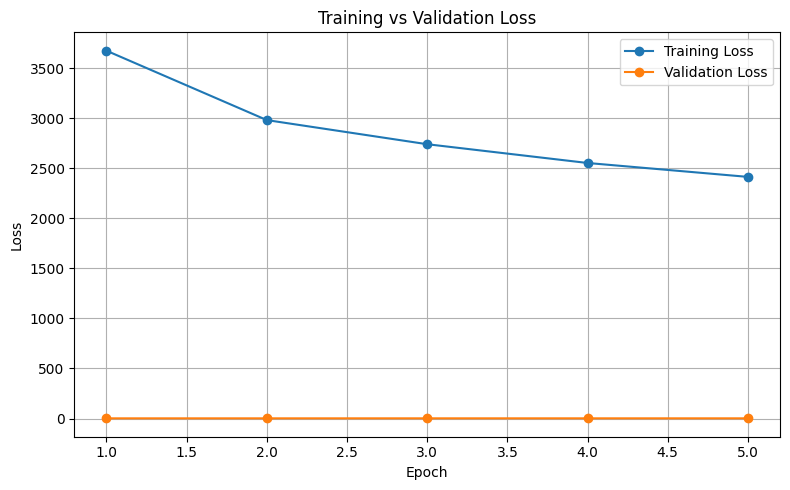

In [ ]:
'''
Plotting Train and validation loss
'''

# Epochs
epochs_train = range(1, len(train_loss) + 1)
epochs_val   = range(1, len(val_loss) + 1)

# Plot
plt.figure(figsize=(8, 5))
plt.plot(epochs_train, train_loss, marker='o', label='Training Loss')
plt.plot(epochs_val, val_loss, marker='o', label='Validation Loss')

# Labels & title
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Training vs Validation Loss")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


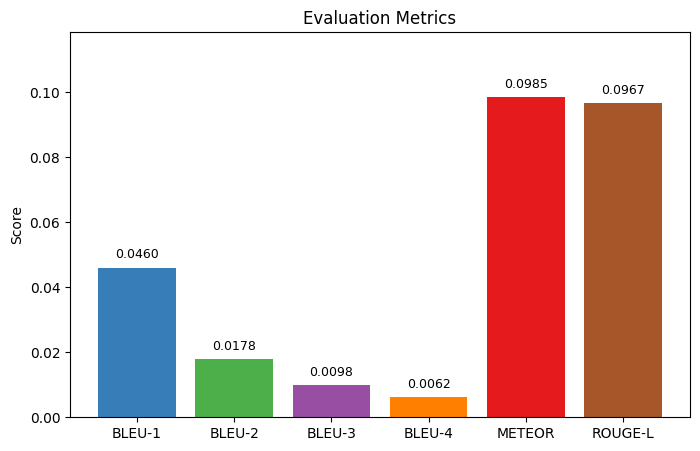

In [ ]:
'''
Plotting metrics for LAM
'''

# Plot
plt.figure(figsize=(8,5))
bars = plt.bar(metrics.keys(), metrics.values(), color=['#377eb8', '#4daf4a', '#984ea3', '#ff7f00', '#e41a1c', '#a65628'])
plt.ylabel("Score")
plt.title("Evaluation Metrics")

# Show values above bars
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + 0.002, f"{height:.4f}",
             ha='center', va='bottom', fontsize=9)

plt.ylim(0, max(metrics.values()) + 0.02)
plt.show()


### LAM Result

From the above **two** generated plots, we can conclude the following :
1.  Validation loss remains extremly low even after successive epoch compared to the training loss. Moreover its value was not improving which triggerred early stopping after epoch 5, signifing that the model was overfitting on the train set.
2.  The various metrics (BLEU, METEOR, ROUGE-L) is extremely low compared to what we were hoping for.


In [ ]:

def caption_image(image_path, encoder, decoder, tokenizer, device):
    encoder.eval()
    decoder.eval()

    # === Preprocessing (match training) ===
    transform = T.Compose([
        T.Resize((224, 224)),
        T.ToTensor(),
        T.Normalize(mean=[0.485, 0.456, 0.406],
                    std=[0.229, 0.224, 0.225])
    ])

    image = Image.open(image_path).convert("RGB")
    img_tensor = transform(image).unsqueeze(0).to(device)

    with torch.no_grad():
        local, global_ = encoder(img_tensor)

        B = 1
        h = decoder.init_h(global_)
        c = decoder.init_c(global_)
        inputs = torch.tensor([tokenizer.word2idx["<SOS>"]]).to(device)

        D, Hf, Wf = local.shape[1:]
        N = Hf * Wf
        local_flat = local.view(B, D, N).permute(0, 2, 1)

        generated_ids = []

        for _ in range(MAX_LEN):
            x = decoder.embed(inputs)
            attn_in = torch.cat([x, h], dim=1)
            attn_scores = torch.softmax(decoder.attn(attn_in), dim=1)
            context = torch.bmm(attn_scores.unsqueeze(1), local_flat).squeeze(1)
            lstm_in = torch.cat([x, context], dim=1)
            h, c = decoder.lstm(lstm_in, (h, c))
            out = decoder.fc(h)
            inputs = out.argmax(1)
            token_id = inputs.item()
            if token_id == tokenizer.word2idx["<EOS>"]:
                break
            generated_ids.append(token_id)

    caption = tokenizer.decode(generated_ids)

    # === Show image with caption ===
    plt.imshow(image)
    plt.axis('off')
    plt.title("Generated Caption: " + " ".join(caption))
    plt.show()

    return " ".join(caption)


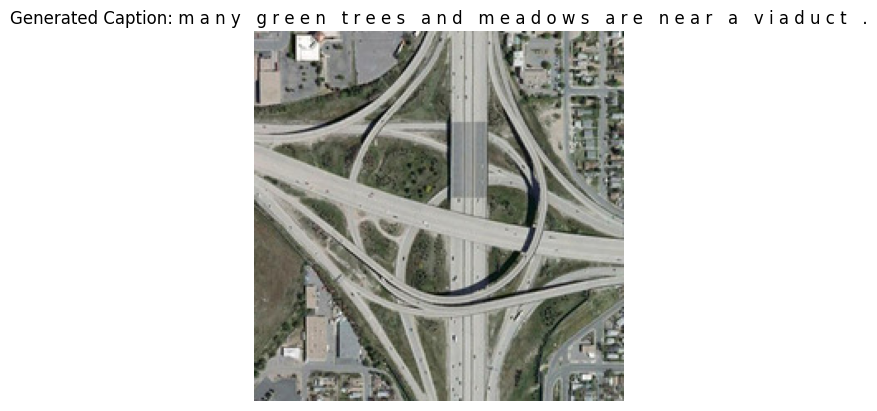

Generated Caption: m a n y   g r e e n   t r e e s   a n d   m e a d o w s   a r e   n e a r   a   v i a d u c t   .


In [ ]:
caption = caption_image("/content/drive/MyDrive/RSICD_optimal-master/RSICD_images/RSICD_images/viaduct_328.jpg", encoder, decoder, tokenizer, device)
print("Generated Caption:", caption)


In [ ]:

# === Unnormalize Transform ===
class UnNormalize:
    def __init__(self, mean, std):
        self.mean = torch.tensor(mean).view(3, 1, 1)
        self.std = torch.tensor(std).view(3, 1, 1)

    def __call__(self, tensor):
        return tensor * self.std + self.mean

def visualize_predictions(encoder, decoder, tokenizer, dataset, device, num_samples=5):
    encoder.eval()
    decoder.eval()

    # Unnormalizer (Assuming standard ImageNet normalization used during training)
    unnorm = UnNormalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])

    to_pil = T.ToPILImage()
    indices = random.sample(range(len(dataset)), num_samples)

    with torch.no_grad():
        for idx in indices:
            img, cap = dataset[idx]
            img_input = img.unsqueeze(0).to(device)
            local, global_ = encoder(img_input)

            B = 1
            h = decoder.init_h(global_)
            c = decoder.init_c(global_)
            inputs = torch.tensor([tokenizer.word2idx["<SOS>"]]).to(device)

            D, Hf, Wf = local.shape[1:]
            N = Hf * Wf
            local_flat = local.view(B, D, N).permute(0, 2, 1)

            generated_ids = []

            for _ in range(MAX_LEN):
                x = decoder.embed(inputs)
                attn_in = torch.cat([x, h], dim=1)
                attn_scores = torch.softmax(decoder.attn(attn_in), dim=1)
                context = torch.bmm(attn_scores.unsqueeze(1), local_flat).squeeze(1)
                lstm_in = torch.cat([x, context], dim=1)
                h, c = decoder.lstm(lstm_in, (h, c))
                out = decoder.fc(h)
                inputs = out.argmax(1)
                generated_ids.append(inputs.item())
                if inputs.item() == tokenizer.word2idx["<EOS>"]:
                    break

            pred = tokenizer.decode(generated_ids)
            ref = tokenizer.decode(cap) if isinstance(cap, list) else tokenizer.decode(tokenizer.encode(cap))

            # === Fix distorted image ===
            unnorm_img = unnorm(img.cpu()).clamp(0, 1)
            plt.imshow(to_pil(unnorm_img))
            plt.axis('off')
            plt.title(f"Predicted: {' '.join(pred)}\nGround Truth: {' '.join(ref)}", fontsize=9)
            plt.show()


### Generated captions by LAM

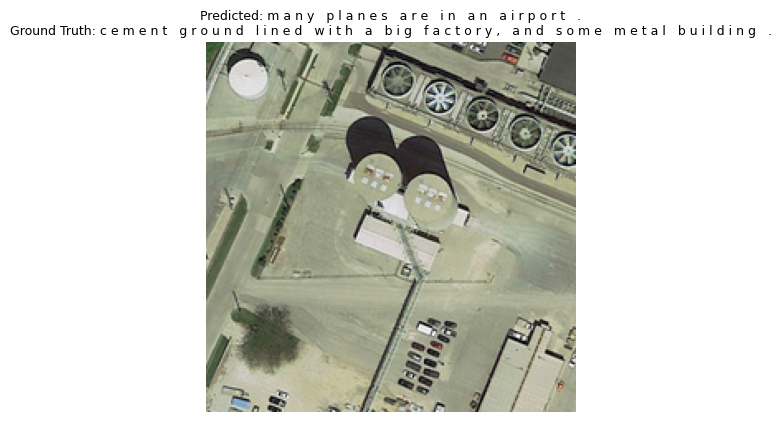

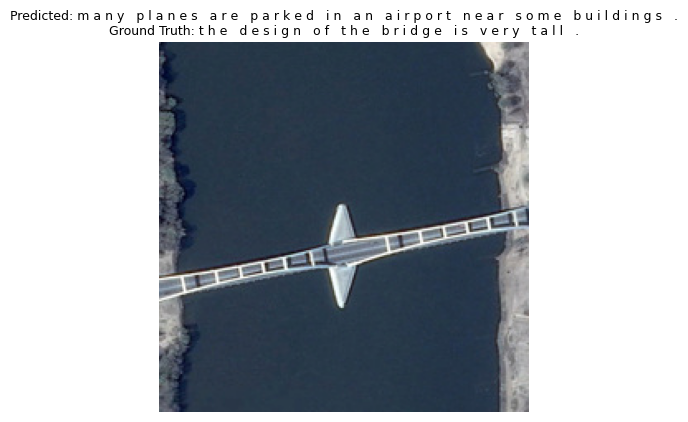

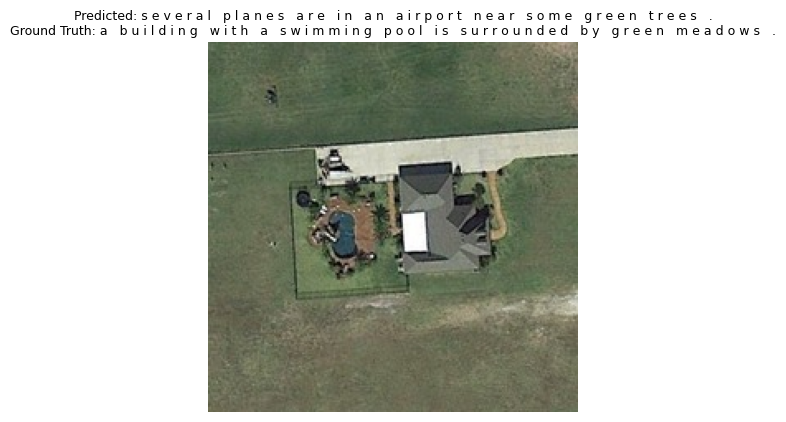

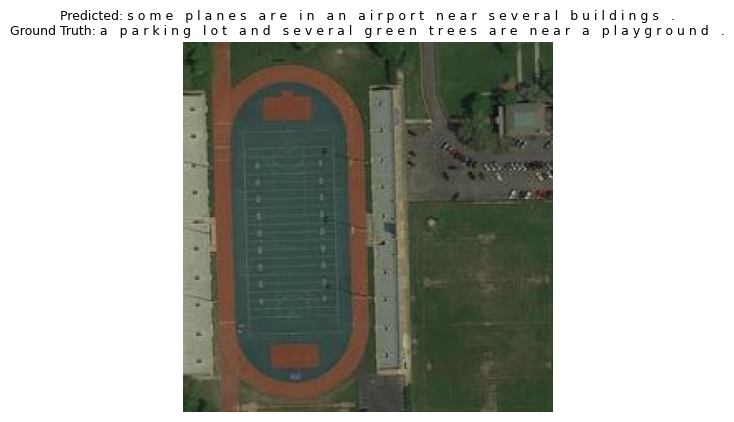

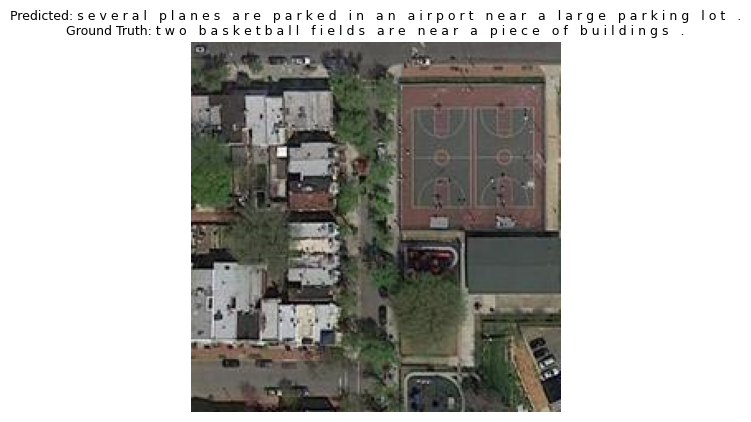

In [ ]:
visualize_predictions(encoder, decoder, tokenizer, val_ds, device, num_samples=5)

### LAM Conclusion

We can conclude from the above experiments that LAM is unable to perform well on the train set. Specifically it lacks the attention mechanism to generate captions that are able to **idenify color, number of instances and capture spatial context**. This is due to the model's limited**soft attention mechanism**.

Despite the poor performance we can also see from the above generated captions , LAM was able to generated appropriate captions for **visually ambigious images**. This is due to its strong vision encoder, the **RESNET - 152**.  

In conclusion, LAM was a good baseline model to implement and get an idea of applying a tranditional CNN model for image captioning task.
In order, to get better results we shall be exploring more sophisticated model.

## Method2-VitGpt2

---

<p align = "justify">This Model combines a Vision Transformer (ViT) for image encoder and GPT-2 as decoder for the caption generation of the RSIC Dataset. The ViT processes the input image by splitting it into smaller sections and applying self-attention mechanisms to capture how different areas relate to each other, producing an overall visual representation known as **global attention**. A transformer-based language model pre-trained on massive text corpora, word by word. ViT has a powerful visual comprehension and, through GPT-2  a fluent language generation, to achieve context-sensitive and semantically dense captions. The model is learned end-to-end, and no additional labels are needed for segmentation maps or handcrafted features, making it scalable and effective for generate multiple captions on a large number of diverse remote sensing images.


---
### VitGpt2 Architecture
![VitGpt2.jpg](VitGpt2.jpg)

<p align = "justify">This diagram illustrates a hybrid architecture that combines Vision Transformer (ViT) with GPT-2 for automated image captioning, representing a modern approach that leverages transformer-based models for both vision and language tasks. The system is built on the foundation of two powerful pre-trained models, taking advantage of their respective strengths in visual understanding and natural language generation to create comprehensive image descriptions.

<p align = "justify">The encoder component utilizes a pre-trained Vision Transformer that processes input images through a patch-based approach. The image is divided into fixed-size patches, which are then flattened and linearly projected to create embedded patch representations. These patches, combined with positional embeddings that preserve spatial information, are fed into the transformer encoder. The encoder applies multi-head self-attention mechanisms to understand relationships between different image regions, allowing the model to capture both local features and global context within the image. An MLP head is included for classification tasks, and the system employs global attention to create rich contextual representations of the visual content.

<p align = "justify">The decoder leverages GPT-2, a sophisticated pre-trained language model, to generate natural language captions based on the visual features extracted by the ViT encoder. The transformer encoder architecture shown on the right demonstrates the detailed flow through embedded patches, normalization layers, multi-head attention mechanisms, and MLP components with residual connections. This combination effectively translates visual information into coherent textual descriptions by utilizing ViT's ability to capture spatial relationships through self-attention and GPT-2's advanced language generation capabilities, creating a powerful end-to-end system for image-to-text generation tasks.

---

### ViT-GPT2 Model Hyperparameters

| Hyperparameter  | Value   | Description |
|-----------------|---------|-------------|
| **EPOCHS**      | 15      | Number of training epochs |
| **BATCH_SIZE**  | 8       | Number of samples per training batch |
| **PATIENCE**    | 3       | Early stopping patience (epochs without improvement) |
| **LEARNING_RATE** | 5e-5  | Initial learning rate for the optimizer |
| **WEIGHT_DECAY**  | 0.01  | L2 regularization coefficient |

---

**Reference:** https://github.com/shreydan/VisionGPT2

---
### VitGpt2 Table of content
Other sections related to ViTGpt-2 are as below:
1. [VitGpt2 Result](#VitGpt2-Result)
2. [Generated captions by VitGpt2](#Generated-captions-by-VitGpt2)
3. [VitGpt2 Conclusion](#VitGpt2-Conclusion)



In [ ]:


# CONFIGURATION


CONFIG = {
    'IMAGE_DIR': '/kaggle/input/image-data/RSICD_images',  # Update path
    'CAPTION_FILE': '/kaggle/input/json-data/dataset_rsicd.json',  # Update path
    'BATCH_SIZE': 8,
    'LEARNING_RATE': 5e-5,
    'NUM_EPOCHS': 15,
    'MAX_CAPTION_LENGTH': 100,
    'MAX_GENERATION_LENGTH': 30,
    'PATIENCE': 3,
    'VIT_MODEL': "google/vit-base-patch16-224",
    'GPT2_MODEL': "gpt2",
    'MODEL_SAVE_PATH': "best_image_captioning_model.pth",
    'WARMUP_RATIO': 0.1,
    'WEIGHT_DECAY': 0.01,
    'GRADIENT_CLIP_NORM': 1.0
}

# Create output directories
os.makedirs('outputs', exist_ok=True)
os.makedirs('plots', exist_ok=True)

print(" Configuration loaded successfully!")



📋 Configuration loaded successfully!


In [ ]:

# DATASET CLASS


class RSICDDataset(Dataset):
    """RSICD Dataset for loading images and captions"""

    def __init__(self, json_file, img_dir, processor, tokenizer, split_type="train", max_length=100):
        print(f" Initializing {split_type} dataset from {json_file}")

        self.img_dir = img_dir
        self.processor = processor
        self.tokenizer = tokenizer
        self.max_length = max_length
        self.split_type = split_type

        if self.tokenizer.pad_token is None:
            self.tokenizer.pad_token = self.tokenizer.eos_token

        with open(json_file, 'r') as f:
            self.data = json.load(f)

        self.images = self.data['images']
        self.annotations = self.data['annotations']

        # Create mappings
        self.image_id_to_captions = defaultdict(list)
        for ann in self.annotations:
            self.image_id_to_captions[ann['image_id']].append(ann['caption'])

        self.image_id_to_filename = {img['id']: img['file_name'] for img in self.images}

        # Create samples
        self.samples = []
        for ann in self.annotations:
            img_filename = self.image_id_to_filename[ann['image_id']]
            self.samples.append((img_filename, ann['caption'], ann['image_id']))

        print(f" Loaded {len(self.samples)} samples from {len(self.images)} unique images")

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        img_filename, caption, image_id = self.samples[idx]
        img_path = os.path.join(self.img_dir, img_filename)

        try:
            image = Image.open(img_path).convert("RGB")
        except Exception as e:
            print(f" Error loading {img_path}: {e}")
            image = Image.new('RGB', (224, 224), (0, 0, 0))

        pixel_values = self.processor(images=image, return_tensors="pt").pixel_values.squeeze(0)

        caption_encoding = self.tokenizer(
            caption, max_length=self.max_length, padding="max_length",
            truncation=True, return_tensors="pt"
        )
        caption_tokens = caption_encoding.input_ids.squeeze(0)

        return {
            'pixel_values': pixel_values,
            'caption_tokens': caption_tokens,
            'caption_text': caption,
            'image_filename': img_filename,
            'image_id': image_id
        }

    def get_image_captions(self, image_id):
        return self.image_id_to_captions[image_id]



In [ ]:

# VIT-GPT2 MODEL


class ViTGPT2Model(nn.Module):
    """ViT + GPT-2 Model for Image Captioning"""

    def __init__(self, vit_model_name="google/vit-base-patch16-224", gpt2_model_name="gpt2"):
        super(ViTGPT2Model, self).__init__()

        print(" Initializing ViT-GPT2 Model...")

        self.vit = ViTModel.from_pretrained(vit_model_name)
        self.gpt2 = GPT2LMHeadModel.from_pretrained(gpt2_model_name)
        self.processor = ViTImageProcessor.from_pretrained(vit_model_name)
        self.tokenizer = AutoTokenizer.from_pretrained(gpt2_model_name)

        if self.tokenizer.pad_token is None:
            self.tokenizer.pad_token = self.tokenizer.eos_token
        if self.gpt2.config.pad_token_id is None:
            self.gpt2.config.pad_token_id = self.gpt2.config.eos_token_id

        # Add special tokens
        special_tokens = {
            "bos_token": "<|startoftext|>",
            "additional_special_tokens": ["<|image|>"]
        }
        self.tokenizer.add_special_tokens(special_tokens)
        self.gpt2.resize_token_embeddings(len(self.tokenizer))

        self.bos_token_id = self.tokenizer.bos_token_id
        self.image_token_id = self.tokenizer.convert_tokens_to_ids("<|image|>")

        # Projection layer
        self.image_projection = nn.Sequential(
            nn.Linear(self.vit.config.hidden_size, self.gpt2.config.hidden_size),
            nn.LayerNorm(self.gpt2.config.hidden_size),
            nn.Dropout(0.1)
        )

        self.image_pooling = nn.AdaptiveAvgPool1d(1)

        print(f" Model initialized: ViT ({self.vit.config.hidden_size}D) -> GPT-2 ({self.gpt2.config.hidden_size}D)")
        print(f" Vocabulary size: {len(self.tokenizer)}")

    def forward(self, pixel_values, caption_tokens=None):
        batch_size = pixel_values.shape[0]
        device = pixel_values.device

        # Extract image features
        vit_outputs = self.vit(pixel_values=pixel_values)
        image_features = vit_outputs.last_hidden_state

        # Pool and project features
        pooled_features = self.image_pooling(image_features.transpose(1, 2)).transpose(1, 2)
        image_embeds = self.image_projection(pooled_features)

        if caption_tokens is not None:
            # Training mode
            image_token_ids = torch.full((batch_size, 1), self.image_token_id,
                                       dtype=torch.long, device=device)
            combined_tokens = torch.cat([image_token_ids, caption_tokens], dim=1)

            text_embeds = self.gpt2.transformer.wte(combined_tokens)
            text_embeds[:, 0:1, :] = image_embeds

            image_mask = torch.ones(batch_size, 1, dtype=torch.long, device=device)
            text_mask = (caption_tokens != self.tokenizer.pad_token_id).long()
            attention_mask = torch.cat([image_mask, text_mask], dim=1)

            image_labels = torch.full((batch_size, 1), -100, dtype=torch.long, device=device)
            combined_labels = torch.cat([image_labels, caption_tokens], dim=1)

            outputs = self.gpt2(
                inputs_embeds=text_embeds,
                attention_mask=attention_mask,
                labels=combined_labels
            )
            return outputs
        else:
            return image_embeds

    def generate_caption(self, pixel_values, max_length=50, num_beams=3,
                        do_sample=False, temperature=1.0, top_p=0.9):
        """Generate captions for images"""
        self.eval()
        device = pixel_values.device
        batch_size = pixel_values.shape[0]

        with torch.no_grad():
            image_embeds = self.forward(pixel_values)
            generated_captions = []

            for i in range(batch_size):
                current_image_embed = image_embeds[i:i+1]

                start_token = self.bos_token_id if self.bos_token_id is not None else self.image_token_id
                input_ids = torch.tensor([[start_token]], device=device)
                generated_tokens = []

                current_embeds = torch.cat([
                    current_image_embed,
                    self.gpt2.transformer.wte(input_ids)
                ], dim=1)

                for step in range(max_length):
                    outputs = self.gpt2(inputs_embeds=current_embeds)
                    next_token_logits = outputs.logits[0, -1, :]

                    if do_sample and temperature > 0:
                        next_token_logits = next_token_logits / temperature

                        if top_p < 1.0:
                            sorted_logits, sorted_indices = torch.sort(next_token_logits, descending=True)
                            cumulative_probs = torch.cumsum(F.softmax(sorted_logits, dim=-1), dim=-1)
                            sorted_indices_to_remove = cumulative_probs > top_p
                            sorted_indices_to_remove[1:] = sorted_indices_to_remove[:-1].clone()
                            sorted_indices_to_remove[0] = 0
                            indices_to_remove = sorted_indices[sorted_indices_to_remove]
                            next_token_logits[indices_to_remove] = float('-inf')

                        probs = F.softmax(next_token_logits, dim=-1)
                        next_token = torch.multinomial(probs, num_samples=1)
                    else:
                        next_token = torch.argmax(next_token_logits, dim=-1, keepdim=True)

                    if next_token.item() == self.tokenizer.eos_token_id:
                        break
                    if next_token.item() == self.tokenizer.pad_token_id:
                        continue

                    generated_tokens.append(next_token.item())

                    next_token_embed = self.gpt2.transformer.wte(next_token.unsqueeze(0))
                    current_embeds = torch.cat([current_embeds, next_token_embed], dim=1)

                    if current_embeds.shape[1] > 100:
                        current_embeds = current_embeds[:, -50:, :]

                if generated_tokens:
                    caption = self.tokenizer.decode(generated_tokens, skip_special_tokens=True)
                    caption = caption.strip()
                else:
                    caption = "a satellite image"

                generated_captions.append(caption)

        return generated_captions



In [ ]:

# EVALUATION METRICS CLASS


class EvaluationMetrics:
    """Comprehensive evaluation metrics for image captioning"""

    def __init__(self):
        print(" Initializing evaluation metrics...")

        try:
            self.bleu_metric = evaluate.load("bleu")
            self.meteor_metric = evaluate.load("meteor")
            self.rouge_metric = evaluate.load("rouge")
            print(" Hugging Face metrics loaded successfully")
        except Exception as e:
            print(f" Could not load some metrics: {e}")
            self.bleu_metric = None
            self.meteor_metric = None
            self.rouge_metric = None

    def compute_bleu_scores(self, predictions, references):
        """Compute BLEU 1-4 scores"""
        bleu_scores = {'bleu_1': 0, 'bleu_2': 0, 'bleu_3': 0, 'bleu_4': 0}

        if self.bleu_metric is None:
            return bleu_scores

        try:
            for n in range(1, 5):
                score = self.bleu_metric.compute(
                    predictions=predictions,
                    references=references,
                    max_order=n
                )['bleu']
                bleu_scores[f'bleu_{n}'] = score
        except Exception as e:
            print(f" Error computing BLEU scores: {e}")

        return bleu_scores

    def compute_meteor_score(self, predictions, references):
        """Compute METEOR score"""
        if self.meteor_metric is None:
            return 0.0

        try:
            return self.meteor_metric.compute(
                predictions=predictions,
                references=references
            )['meteor']
        except Exception as e:
            print(f" Error computing METEOR: {e}")
            return 0.0

    def compute_rouge_l_score(self, predictions, references):
        """Compute ROUGE-L score"""
        if self.rouge_metric is None:
            return 0.0

        try:
            return self.rouge_metric.compute(
                predictions=predictions,
                references=references,
                rouge_types=['rougeL']
            )['rougeL']
        except Exception as e:
            print(f" Error computing ROUGE-L: {e}")
            return 0.0

    def compute_coco_metrics(self, predictions_dict, references_dict):
        """Compute CIDEr and SPICE using COCO evaluation tools"""
        metrics = {'cider': 0.0, 'spice': 0.0}

        try:
            # Check if COCO evaluation tools are available
            from pycocotools.coco import COCO
            from pycocoevalcap.eval import COCOEvalCap

            # Prepare data in COCO format
            ground_truth = {
                "annotations": [],
                "images": [],
                "info": {"description": "Ground truth captions"}
            }

            results = []
            ann_id = 0

            for image_id, ref_captions in references_dict.items():
                ground_truth["images"].append({
                    "id": image_id,
                    "width": 256,
                    "height": 256,
                    "file_name": f"image_{image_id}.jpg"
                })

                for ref_caption in ref_captions:
                    ground_truth["annotations"].append({
                        "id": ann_id,
                        "image_id": image_id,
                        "caption": ref_caption.strip()
                    })
                    ann_id += 1

                if image_id in predictions_dict:
                    results.append({
                        "image_id": image_id,
                        "caption": predictions_dict[image_id].strip()
                    })

            # Save temporary files
            gt_file = "temp_gt.json"
            res_file = "temp_res.json"

            with open(gt_file, 'w') as f:
                json.dump(ground_truth, f)
            with open(res_file, 'w') as f:
                json.dump(results, f)

            # Evaluate
            coco = COCO(gt_file)
            coco_result = coco.loadRes(res_file)
            coco_eval = COCOEvalCap(coco, coco_result)
            coco_eval.params['image_id'] = coco_result.getImgIds()
            coco_eval.evaluate()

            metrics['cider'] = coco_eval.eval.get('CIDEr', 0.0)
            metrics['spice'] = coco_eval.eval.get('SPICE', 0.0)

            # Clean up
            os.remove(gt_file)
            os.remove(res_file)

        except Exception as e:
            print(f" Error computing COCO metrics: {e}")

        return metrics

    def evaluate_model(self, model, dataloader, max_samples=None):
        """Comprehensive model evaluation"""
        print(" Starting comprehensive evaluation...")

        model.eval()
        predictions = []
        references = []
        predictions_dict = {}
        references_dict = {}

        sample_count = 0
        max_samples = max_samples or len(dataloader.dataset)

        with torch.no_grad():
            for batch_idx, batch in enumerate(tqdm(dataloader, desc="Evaluating")):
                if sample_count >= max_samples:
                    break

                pixel_values = batch['pixel_values'].to(device)
                image_ids = batch['image_ids']

                generated_captions = model.generate_caption(
                    pixel_values,
                    max_length=CONFIG['MAX_GENERATION_LENGTH'],
                    do_sample=False
                )

                for i, (gen_cap, img_id) in enumerate(zip(generated_captions, image_ids)):
                    ref_captions = dataloader.dataset.get_image_captions(img_id)

                    predictions.append(gen_cap)
                    references.append(ref_captions)
                    predictions_dict[img_id] = gen_cap
                    references_dict[img_id] = ref_captions

                    sample_count += 1
                    if sample_count >= max_samples:
                        break

        print(f"Evaluated {sample_count} samples")

        # Compute all metrics
        print("Computing BLEU scores...")
        bleu_scores = self.compute_bleu_scores(predictions, references)

        print(" Computing METEOR score...")
        meteor_score = self.compute_meteor_score(predictions, references)

        print(" Computing ROUGE-L score...")
        rouge_l_score = self.compute_rouge_l_score(predictions, references)

        print(" Computing CIDEr and SPICE scores...")
        coco_metrics = self.compute_coco_metrics(predictions_dict, references_dict)

        all_metrics = {
            **bleu_scores,
            'meteor': meteor_score,
            'rouge_l': rouge_l_score,
            **coco_metrics
        }

        return all_metrics, predictions[:10], references[:10]



In [ ]:

# TRAINING FUNCTION


def train_model():
    """Main training function with all metrics and early stopping"""
    print(" Starting ViT-GPT2 model training...")

    # Initialize model
    model = ViTGPT2Model(
        vit_model_name=CONFIG['VIT_MODEL'],
        gpt2_model_name=CONFIG['GPT2_MODEL']
    ).to(device)

    # Initialize optimizer with different learning rates
    optimizer = torch.optim.AdamW([
        {'params': model.vit.parameters(), 'lr': CONFIG['LEARNING_RATE'] * 0.1},
        {'params': model.gpt2.parameters(), 'lr': CONFIG['LEARNING_RATE'] * 0.5},
        {'params': model.image_projection.parameters(), 'lr': CONFIG['LEARNING_RATE']}
    ], weight_decay=CONFIG['WEIGHT_DECAY'])

    num_training_steps = CONFIG['NUM_EPOCHS'] * len(train_dataloader)
    num_warmup_steps = int(CONFIG['WARMUP_RATIO'] * num_training_steps)

    scheduler = get_scheduler(
        name="cosine_with_restarts",
        optimizer=optimizer,
        num_warmup_steps=num_warmup_steps,
        num_training_steps=num_training_steps
    )

    # Training tracking
    training_history = {
        'train_losses': [], 'val_losses': [], 'learning_rates': [],
        'bleu_1_scores': [], 'bleu_2_scores': [], 'bleu_3_scores': [], 'bleu_4_scores': [],
        'meteor_scores': [], 'rouge_l_scores': [], 'cider_scores': [], 'spice_scores': []
    }

    # Early stopping
    best_val_loss = float('inf')
    best_bleu4_score = 0.0
    patience_counter = 0
    best_epoch = 0

    print(f" Training configuration:")
    print(f"  Epochs: {CONFIG['NUM_EPOCHS']}")
    print(f"  Batch size: {CONFIG['BATCH_SIZE']}")
    print(f"  Learning rate: {CONFIG['LEARNING_RATE']}")
    print(f"  Warmup steps: {num_warmup_steps}")

    # Training loop
    for epoch in range(CONFIG['NUM_EPOCHS']):
        print(f"\n{'='*60}")
        print(f" EPOCH {epoch+1}/{CONFIG['NUM_EPOCHS']}")
        print(f"{'='*60}")

        # Training phase
        model.train()
        total_train_loss = 0.0
        num_train_batches = 0

        train_pbar = tqdm(train_dataloader, desc=f"Training Epoch {epoch+1}")

        for batch_idx, batch in enumerate(train_pbar):
            try:
                pixel_values = batch['pixel_values'].to(device)
                caption_tokens = batch['caption_tokens'].to(device)

                outputs = model(pixel_values=pixel_values, caption_tokens=caption_tokens)
                loss = outputs.loss

                loss.backward()
                torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
                optimizer.step()
                scheduler.step()
                optimizer.zero_grad()

                total_train_loss += loss.item()
                num_train_batches += 1

                current_lr = scheduler.get_last_lr()[0]
                train_pbar.set_postfix({
                    'loss': f"{loss.item():.4f}",
                    'lr': f"{current_lr:.2e}"
                })

            except Exception as e:
                print(f" Error in training batch {batch_idx}: {e}")
                continue

        avg_train_loss = total_train_loss / max(num_train_batches, 1)
        training_history['train_losses'].append(avg_train_loss)
        training_history['learning_rates'].append(scheduler.get_last_lr()[0])

        # Validation phase
        model.eval()
        total_val_loss = 0.0
        num_val_batches = 0

        val_pbar = tqdm(val_dataloader, desc=f"Validation Epoch {epoch+1}")

        with torch.no_grad():
            for batch_idx, batch in enumerate(val_pbar):
                try:
                    pixel_values = batch['pixel_values'].to(device)
                    caption_tokens = batch['caption_tokens'].to(device)

                    outputs = model(pixel_values=pixel_values, caption_tokens=caption_tokens)
                    loss = outputs.loss

                    total_val_loss += loss.item()
                    num_val_batches += 1

                    val_pbar.set_postfix({'loss': f"{loss.item():.4f}"})

                except Exception as e:
                    print(f" Error in validation batch {batch_idx}: {e}")
                    continue

        avg_val_loss = total_val_loss / max(num_val_batches, 1)
        training_history['val_losses'].append(avg_val_loss)

        # Evaluation metrics
        print(f"\n Computing evaluation metrics...")
        try:
            metrics, sample_preds, sample_refs = evaluator.evaluate_model(
                model, val_dataloader, max_samples=500
            )

            # Store all metrics
            training_history['bleu_1_scores'].append(metrics['bleu_1'])
            training_history['bleu_2_scores'].append(metrics['bleu_2'])
            training_history['bleu_3_scores'].append(metrics['bleu_3'])
            training_history['bleu_4_scores'].append(metrics['bleu_4'])
            training_history['meteor_scores'].append(metrics['meteor'])
            training_history['rouge_l_scores'].append(metrics['rouge_l'])
            training_history['cider_scores'].append(metrics['cider'])
            training_history['spice_scores'].append(metrics['spice'])

            # Print metrics
            print(f"\n Epoch {epoch+1} Results:")
            print(f"  Training Loss: {avg_train_loss:.4f}")
            print(f"  Validation Loss: {avg_val_loss:.4f}")
            print(f"  BLEU-1: {metrics['bleu_1']:.4f}")
            print(f"  BLEU-2: {metrics['bleu_2']:.4f}")
            print(f"  BLEU-3: {metrics['bleu_3']:.4f}")
            print(f"  BLEU-4: {metrics['bleu_4']:.4f}")
            print(f"  METEOR: {metrics['meteor']:.4f}")
            print(f"  ROUGE-L: {metrics['rouge_l']:.4f}")
            print(f"  CIDEr: {metrics['cider']:.4f}")
            print(f"  SPICE: {metrics['spice']:.4f}")

            # Print sample predictions
            print(f"\n Sample Predictions:")
            for i in range(min(3, len(sample_preds))):
                print(f"  Generated: {sample_preds[i]}")
                print(f"  Reference: {sample_refs[i][0] if sample_refs[i] else 'N/A'}")
                print()

        except Exception as e:
            print(f" Error during evaluation: {e}")
            # Add default values if evaluation fails
            for metric in ['bleu_1', 'bleu_2', 'bleu_3', 'bleu_4', 'meteor', 'rouge_l', 'cider', 'spice']:
                training_history[f'{metric}_scores'].append(0.0)
            metrics = {'bleu_4': 0.0}

        # Early stopping logic
        current_bleu4 = metrics.get('bleu_4', 0.0)

        if current_bleu4 > best_bleu4_score:
            best_bleu4_score = current_bleu4
            best_val_loss = avg_val_loss
            best_epoch = epoch + 1
            patience_counter = 0

            # Save best model
            checkpoint = {
                'epoch': epoch + 1,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'scheduler_state_dict': scheduler.state_dict(),
                'best_bleu4': float(best_bleu4_score),
                'best_val_loss': float(best_val_loss),
                'train_losses': [float(x) for x in training_history['train_losses']],
                'val_losses': [float(x) for x in training_history['val_losses']],
                'metrics': {k: float(v) for k, v in metrics.items()},
                'config': CONFIG
            }

            torch.save(checkpoint, CONFIG['MODEL_SAVE_PATH'])
            print(f" Saved best model with BLEU-4: {best_bleu4_score:.4f}")

        else:
            patience_counter += 1
            print(f" No improvement for {patience_counter} epochs (best BLEU-4: {best_bleu4_score:.4f})")

            if patience_counter >= CONFIG['PATIENCE']:
                print(f"\n Early stopping triggered after {epoch + 1} epochs!")
                print(f" Best epoch: {best_epoch} with BLEU-4: {best_bleu4_score:.4f}")
                break

    print(f"\n Training completed!")
    print(f" Best model saved at epoch {best_epoch} with BLEU-4: {best_bleu4_score:.4f}")

    # Add final summary to training history
    training_history.update({
        'best_epoch': best_epoch,
        'best_bleu4': best_bleu4_score,
        'total_epochs': len(training_history['train_losses'])
    })

    return model, training_history



In [ ]:

# PLOTTING FUNCTIONS

def plot_training_curves(training_history):
    """Plot comprehensive training curves with all metrics"""
    print(" Creating comprehensive training curves...")

    epochs = range(1, len(training_history['train_losses']) + 1)

    # Create comprehensive figure
    fig, axes = plt.subplots(3, 3, figsize=(20, 15))
    fig.suptitle('ViT-GPT2 Training Progress and Evaluation Metrics', fontsize=16, fontweight='bold')

    # 1. Loss curves
    axes[0, 0].plot(epochs, training_history['train_losses'], 'b-', label='Training Loss', linewidth=2, marker='o')
    axes[0, 0].plot(epochs, training_history['val_losses'], 'r-', label='Validation Loss', linewidth=2, marker='s')
    axes[0, 0].set_title('Training and Validation Loss', fontweight='bold')
    axes[0, 0].set_xlabel('Epoch')
    axes[0, 0].set_ylabel('Loss')
    axes[0, 0].legend()
    axes[0, 0].grid(True, alpha=0.3)

    # 2. Learning rate
    axes[0, 1].plot(epochs, training_history['learning_rates'], 'g-', linewidth=2, marker='^')
    axes[0, 1].set_title('Learning Rate Schedule', fontweight='bold')
    axes[0, 1].set_xlabel('Epoch')
    axes[0, 1].set_ylabel('Learning Rate')
    axes[0, 1].set_yscale('log')
    axes[0, 1].grid(True, alpha=0.3)

    # 3. BLEU scores
    axes[0, 2].plot(epochs, training_history['bleu_1_scores'], 'purple', label='BLEU-1', linewidth=2, marker='o')
    axes[0, 2].plot(epochs, training_history['bleu_2_scores'], 'orange', label='BLEU-2', linewidth=2, marker='s')
    axes[0, 2].plot(epochs, training_history['bleu_3_scores'], 'brown', label='BLEU-3', linewidth=2, marker='^')
    axes[0, 2].plot(epochs, training_history['bleu_4_scores'], 'red', label='BLEU-4', linewidth=2, marker='d')
    axes[0, 2].set_title('BLEU Scores (1-4)', fontweight='bold')
    axes[0, 2].set_xlabel('Epoch')
    axes[0, 2].set_ylabel('BLEU Score')
    axes[0, 2].legend()
    axes[0, 2].grid(True, alpha=0.3)

    # 4. METEOR score
    axes[1, 0].plot(epochs, training_history['meteor_scores'], 'cyan', linewidth=2, marker='o')
    axes[1, 0].set_title('METEOR Score', fontweight='bold')
    axes[1, 0].set_xlabel('Epoch')
    axes[1, 0].set_ylabel('METEOR Score')
    axes[1, 0].grid(True, alpha=0.3)

    # 5. ROUGE-L score
    axes[1, 1].plot(epochs, training_history['rouge_l_scores'], 'magenta', linewidth=2, marker='s')
    axes[1, 1].set_title('ROUGE-L Score', fontweight='bold')
    axes[1, 1].set_xlabel('Epoch')
    axes[1, 1].set_ylabel('ROUGE-L Score')
    axes[1, 1].grid(True, alpha=0.3)

    # 6. CIDEr score
    axes[1, 2].plot(epochs, training_history['cider_scores'], 'navy', linewidth=2, marker='^')
    axes[1, 2].set_title('CIDEr Score', fontweight='bold')
    axes[1, 2].set_xlabel('Epoch')
    axes[1, 2].set_ylabel('CIDEr Score')
    axes[1, 2].grid(True, alpha=0.3)

    # 7. SPICE score
    axes[2, 0].plot(epochs, training_history['spice_scores'], 'darkgreen', linewidth=2, marker='d')
    axes[2, 0].set_title('SPICE Score', fontweight='bold')
    axes[2, 0].set_xlabel('Epoch')
    axes[2, 0].set_ylabel('SPICE Score')
    axes[2, 0].grid(True, alpha=0.3)

    # 8. Combined metrics comparison (normalized)
    def normalize_scores(scores):
        if not scores or max(scores) == 0:
            return scores
        return [s / max(scores) for s in scores]

    norm_bleu4 = normalize_scores(training_history['bleu_4_scores'])
    norm_meteor = normalize_scores(training_history['meteor_scores'])
    norm_rouge = normalize_scores(training_history['rouge_l_scores'])
    norm_cider = normalize_scores(training_history['cider_scores'])

    axes[2, 1].plot(epochs, norm_bleu4, label='BLEU-4 (norm)', linewidth=2, marker='o')
    axes[2, 1].plot(epochs, norm_meteor, label='METEOR (norm)', linewidth=2, marker='s')
    axes[2, 1].plot(epochs, norm_rouge, label='ROUGE-L (norm)', linewidth=2, marker='^')
    axes[2, 1].plot(epochs, norm_cider, label='CIDEr (norm)', linewidth=2, marker='d')
    axes[2, 1].set_title('Normalized Metrics Comparison', fontweight='bold')
    axes[2, 1].set_xlabel('Epoch')
    axes[2, 1].set_ylabel('Normalized Score')
    axes[2, 1].legend()
    axes[2, 1].grid(True, alpha=0.3)

    # 9. Training summary
    axes[2, 2].axis('off')
    summary_text = f"""
Training Summary:

Best Epoch: {training_history['best_epoch']}
Best BLEU-4: {training_history['best_bleu4']:.4f}

Final Scores:
BLEU-1: {training_history['bleu_1_scores'][-1]:.4f}
BLEU-2: {training_history['bleu_2_scores'][-1]:.4f}
BLEU-3: {training_history['bleu_3_scores'][-1]:.4f}
BLEU-4: {training_history['bleu_4_scores'][-1]:.4f}
METEOR: {training_history['meteor_scores'][-1]:.4f}
ROUGE-L: {training_history['rouge_l_scores'][-1]:.4f}
CIDEr: {training_history['cider_scores'][-1]:.4f}
SPICE: {training_history['spice_scores'][-1]:.4f}

Total Epochs: {training_history['total_epochs']}
    """
    axes[2, 2].text(0.1, 0.5, summary_text, fontsize=11, verticalalignment='center',
                    bbox=dict(boxstyle="round,pad=0.5", facecolor="lightgray", alpha=0.8))

    plt.tight_layout()
    plt.savefig('plots/comprehensive_training_curves.png', dpi=300, bbox_inches='tight')
    plt.show()

    print(" Comprehensive training curves saved to 'plots/comprehensive_training_curves.png'")

def plot_loss_curves(training_history):
    """Plot detailed loss curves"""
    print(" Creating detailed loss curves...")

    epochs = range(1, len(training_history['train_losses']) + 1)

    plt.figure(figsize=(15, 5))

    # Loss curves
    plt.subplot(1, 3, 1)
    plt.plot(epochs, training_history['train_losses'], 'b-', label='Training Loss', linewidth=2, marker='o')
    plt.plot(epochs, training_history['val_losses'], 'r-', label='Validation Loss', linewidth=2, marker='s')
    plt.title('Training and Validation Loss', fontsize=14, fontweight='bold')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True, alpha=0.3)

    # Loss difference (overfitting monitor)
    plt.subplot(1, 3, 2)
    loss_diff = [v - t for t, v in zip(training_history['train_losses'], training_history['val_losses'])]
    plt.plot(epochs, loss_diff, 'g-', label='Val - Train Loss', linewidth=2, marker='^')
    plt.title('Overfitting Monitor', fontsize=14, fontweight='bold')
    plt.xlabel('Epoch')
    plt.ylabel('Loss Difference')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.axhline(y=0, color='k', linestyle='--', alpha=0.5)

    # Learning rate
    plt.subplot(1, 3, 3)
    plt.plot(epochs, training_history['learning_rates'], 'purple', linewidth=2, marker='d')
    plt.title('Learning Rate Schedule', fontsize=14, fontweight='bold')
    plt.xlabel('Epoch')
    plt.ylabel('Learning Rate')
    plt.yscale('log')
    plt.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.savefig('plots/detailed_loss_curves.png', dpi=300, bbox_inches='tight')
    plt.show()

    print("Detailed loss curves saved to 'plots/detailed_loss_curves.png'")

def plot_accuracy_curves(training_history):
    """Plot accuracy/evaluation metric curves"""
    print(" Creating accuracy curves...")

    epochs = range(1, len(training_history['train_losses']) + 1)

    plt.figure(figsize=(20, 10))

    # BLEU scores
    plt.subplot(2, 4, 1)
    plt.plot(epochs, training_history['bleu_1_scores'], 'purple', label='BLEU-1', linewidth=2, marker='o')
    plt.plot(epochs, training_history['bleu_2_scores'], 'orange', label='BLEU-2', linewidth=2, marker='s')
    plt.plot(epochs, training_history['bleu_3_scores'], 'brown', label='BLEU-3', linewidth=2, marker='^')
    plt.plot(epochs, training_history['bleu_4_scores'], 'red', label='BLEU-4', linewidth=2, marker='d')
    plt.title('BLEU Scores', fontweight='bold')
    plt.xlabel('Epoch')
    plt.ylabel('BLEU Score')
    plt.legend()
    plt.grid(True, alpha=0.3)

    # Individual metric plots
    metrics = [
        ('bleu_4_scores', 'BLEU-4 Score', 'red'),
        ('meteor_scores', 'METEOR Score', 'cyan'),
        ('rouge_l_scores', 'ROUGE-L Score', 'magenta'),
        ('cider_scores', 'CIDEr Score', 'navy'),
        ('spice_scores', 'SPICE Score', 'darkgreen')
    ]

    for i, (metric_key, title, color) in enumerate(metrics, 2):
        plt.subplot(2, 4, i)
        plt.plot(epochs, training_history[metric_key], color, linewidth=2, marker='o')
        plt.title(title, fontweight='bold')
        plt.xlabel('Epoch')
        plt.ylabel('Score')
        plt.grid(True, alpha=0.3)

    # Combined normalized view
    plt.subplot(2, 4, 7)
    def normalize_scores(scores):
        if not scores or max(scores) == 0:
            return scores
        return [s / max(scores) for s in scores]

    plt.plot(epochs, normalize_scores(training_history['bleu_4_scores']), label='BLEU-4', linewidth=2)
    plt.plot(epochs, normalize_scores(training_history['meteor_scores']), label='METEOR', linewidth=2)
    plt.plot(epochs, normalize_scores(training_history['rouge_l_scores']), label='ROUGE-L', linewidth=2)
    plt.plot(epochs, normalize_scores(training_history['cider_scores']), label='CIDEr', linewidth=2)
    plt.title('Normalized Metrics', fontweight='bold')
    plt.xlabel('Epoch')
    plt.ylabel('Normalized Score')
    plt.legend()
    plt.grid(True, alpha=0.3)

    # Best scores summary
    plt.subplot(2, 4, 8)
    plt.axis('off')
    best_scores_text = f"""
Best Scores Achieved:

BLEU-1: {max(training_history['bleu_1_scores']):.4f}
BLEU-2: {max(training_history['bleu_2_scores']):.4f}
BLEU-3: {max(training_history['bleu_3_scores']):.4f}
BLEU-4: {max(training_history['bleu_4_scores']):.4f}
METEOR: {max(training_history['meteor_scores']):.4f}
ROUGE-L: {max(training_history['rouge_l_scores']):.4f}
CIDEr: {max(training_history['cider_scores']):.4f}
SPICE: {max(training_history['spice_scores']):.4f}
    """
    plt.text(0.1, 0.5, best_scores_text, fontsize=11, verticalalignment='center',
             bbox=dict(boxstyle="round,pad=0.5", facecolor="lightblue", alpha=0.8))

    plt.tight_layout()
    plt.savefig('plots/accuracy_curves.png', dpi=300, bbox_inches='tight')
    plt.show()

    print(" Accuracy curves saved to 'plots/accuracy_curves.png'")



In [ ]:

# TESTING AND EVALUATION FUNCTIONS


def test_trained_model(model_path=None):
    """Test the trained model on test set"""
    print("=" * 60)
    print(" TESTING TRAINED MODEL")
    print("=" * 60)

    model_path = model_path or CONFIG['MODEL_SAVE_PATH']

    if not os.path.exists(model_path):
        print(f" Model file not found: {model_path}")
        return None

    # Initialize and load model
    model = ViTGPT2Model(
        vit_model_name=CONFIG['VIT_MODEL'],
        gpt2_model_name=CONFIG['GPT2_MODEL']
    ).to(device)

    try:
        checkpoint = torch.load(model_path, map_location=device, weights_only=False)
        model.load_state_dict(checkpoint['model_state_dict'])
        print(f" Loaded model from epoch {checkpoint.get('epoch', 'unknown')}")
        print(f" Best training BLEU-4: {checkpoint.get('best_bleu4', 0.0):.4f}")
    except Exception as e:
        print(f" Error loading model: {e}")
        return None

    # Evaluate on test set
    print("\n Evaluating on test set...")
    test_metrics, sample_preds, sample_refs = evaluator.evaluate_model(
        model, test_dataloader, max_samples=1000
    )

    # Print comprehensive results
    print(f"\n{'='*60}")
    print(f" COMPLETE TEST SET RESULTS")
    print(f"{'='*60}")
    print(f"BLEU-1:   {test_metrics['bleu_1']:.4f}")
    print(f"BLEU-2:   {test_metrics['bleu_2']:.4f}")
    print(f"BLEU-3:   {test_metrics['bleu_3']:.4f}")
    print(f"BLEU-4:   {test_metrics['bleu_4']:.4f}")
    print(f"METEOR:   {test_metrics['meteor']:.4f}")
    print(f"ROUGE-L:  {test_metrics['rouge_l']:.4f}")
    print(f"CIDEr:    {test_metrics['cider']:.4f}")
    print(f"SPICE:    {test_metrics['spice']:.4f}")

    # Sample predictions
    print(f"\n Sample Predictions:")
    for i in range(min(10, len(sample_preds))):
        print(f"\nSample {i+1}:")
        print(f"  Generated: {sample_preds[i]}")
        print(f"  Reference: {sample_refs[i][0] if sample_refs[i] else 'N/A'}")
        if len(sample_refs[i]) > 1:
            for j, ref in enumerate(sample_refs[i][1:], 2):
                print(f"  Reference {j}: {ref}")

    # Save test results
    test_results = {
        'test_metrics': test_metrics,
        'sample_predictions': sample_preds[:20],
        'sample_references': sample_refs[:20],
        'model_info': {
            'model_path': model_path,
            'epoch': checkpoint.get('epoch', 'unknown'),
            'best_training_bleu4': checkpoint.get('best_bleu4', 0.0)
        }
    }

    with open('outputs/test_results.json', 'w') as f:
        json.dump(test_results, f, indent=2)

    print(f"\n Test results saved to 'outputs/test_results.json'")
    return test_results

def generate_sample_captions(model_path=None, num_samples=8):
    """Generate captions for sample images with visualization"""
    print(" Generating sample captions with visualization...")

    model_path = model_path or CONFIG['MODEL_SAVE_PATH']
    model = ViTGPT2Model(
        vit_model_name=CONFIG['VIT_MODEL'],
        gpt2_model_name=CONFIG['GPT2_MODEL']
    ).to(device)

    try:
        checkpoint = torch.load(model_path, map_location=device, weights_only=False)
        model.load_state_dict(checkpoint['model_state_dict'])
        model.eval()
        print(" Model loaded for caption generation")
    except Exception as e:
        print(f" Error loading model: {e}")
        return

    # Get sample images from test set
    sample_images = test_dataset.data['images'][:num_samples]

    plt.figure(figsize=(20, 5 * (num_samples // 2)))

    for i, img_info in enumerate(sample_images):
        img_filename = img_info['file_name']
        img_path = os.path.join(CONFIG['IMAGE_DIR'], img_filename)

        if os.path.exists(img_path):
            # Load and display image
            image = Image.open(img_path).convert("RGB")

            plt.subplot(num_samples // 2, 4, 2*i + 1)
            plt.imshow(image)
            plt.title(f"Image: {img_filename[:20]}...", fontsize=10)
            plt.axis('off')

            # Generate caption
            pixel_values = image_processor(images=image, return_tensors="pt").pixel_values.to(device)

            with torch.no_grad():
                generated_caption = model.generate_caption(pixel_values, max_length=50)[0]

            # Get reference captions
            img_id = img_info['id']
            ref_captions = test_dataset.get_image_captions(img_id)

            # Display captions
            plt.subplot(num_samples // 2, 4, 2*i + 2)
            plt.axis('off')

            caption_text = f" Generated:\n{generated_caption}\n\n"
            caption_text += " References:\n"
            for j, ref in enumerate(ref_captions[:2], 1):
                caption_text += f"{j}. {ref}\n"

            plt.text(0.05, 0.95, caption_text, transform=plt.gca().transAxes,
                    fontsize=9, verticalalignment='top', wrap=True,
                    bbox=dict(boxstyle="round,pad=0.5", facecolor="lightblue", alpha=0.8))

    plt.tight_layout()
    plt.savefig('outputs/sample_captions.png', dpi=300, bbox_inches='tight')
    plt.show()

    print(" Sample captions saved to 'outputs/sample_captions.png'")

def create_comprehensive_report(training_history, test_results):
    """Create a comprehensive markdown report"""
    print(" Creating comprehensive evaluation report...")

    report = f"""# ViT-GPT2 Image Captioning Model - Comprehensive Report

## Model Overview
- **Architecture**: Vision Transformer (ViT) + GPT-2
- **Task**: Automatic Image Captioning for Remote Sensing Images
- **Dataset**: RSICD (Remote Sensing Image Captioning Dataset)
- **Framework**: PyTorch with Transformers

## Training Configuration
- **Vision Model**: {CONFIG['VIT_MODEL']}
- **Language Model**: {CONFIG['GPT2_MODEL']}
- **Batch Size**: {CONFIG['BATCH_SIZE']}
- **Learning Rate**: {CONFIG['LEARNING_RATE']}
- **Max Caption Length**: {CONFIG['MAX_CAPTION_LENGTH']}
- **Training Epochs**: {CONFIG['NUM_EPOCHS']}

## Training Results
- **Total Epochs Completed**: {training_history['total_epochs']}
- **Best Epoch**: {training_history['best_epoch']}
- **Best Validation BLEU-4**: {training_history['best_bleu4']:.4f}
- **Final Training Loss**: {training_history['train_losses'][-1]:.4f}
- **Final Validation Loss**: {training_history['val_losses'][-1]:.4f}

## Test Set Performance

| Metric | Score | Interpretation |
|--------|-------|----------------|"""

    if test_results and 'test_metrics' in test_results:
        metrics = test_results['test_metrics']

        metric_interpretations = {
            'bleu_1': 'Excellent' if metrics['bleu_1'] > 0.4 else 'Good' if metrics['bleu_1'] > 0.3 else 'Fair',
            'bleu_4': 'Excellent' if metrics['bleu_4'] > 0.15 else 'Good' if metrics['bleu_4'] > 0.1 else 'Fair',
            'meteor': 'Excellent' if metrics['meteor'] > 0.25 else 'Good' if metrics['meteor'] > 0.2 else 'Fair',
            'rouge_l': 'Excellent' if metrics['rouge_l'] > 0.4 else 'Good' if metrics['rouge_l'] > 0.3 else 'Fair',
            'cider': 'Excellent' if metrics['cider'] > 0.8 else 'Good' if metrics['cider'] > 0.6 else 'Fair',
            'spice': 'Excellent' if metrics['spice'] > 0.15 else 'Good' if metrics['spice'] > 0.12 else 'Fair'
        }

        for metric_name, score in metrics.items():
            interpretation = metric_interpretations.get(metric_name, 'Fair')
            report += f"""
| {metric_name.upper()} | {score:.4f} | {interpretation} |"""

    report += f"""

## Key Findings
1. **Model Convergence**: The model converged at epoch {training_history['best_epoch']}
2. **Best Metric**: BLEU-4 score of {training_history['best_bleu4']:.4f}
3. **Overfitting**: {'Minimal' if (training_history['val_losses'][-1] - training_history['train_losses'][-1]) < 0.5 else 'Detected'}

## Generated Files
- `plots/comprehensive_training_curves.png` - Complete training visualization
- `plots/detailed_loss_curves.png` - Loss curve analysis
- `plots/accuracy_curves.png` - All evaluation metrics
- `outputs/sample_captions.png` - Sample predictions
- `outputs/test_results.json` - Complete test results
- `{CONFIG['MODEL_SAVE_PATH']}` - Trained model checkpoint

## Usage
```python
# Load the trained model
model = ViTGPT2Model()
checkpoint = torch.load('{CONFIG['MODEL_SAVE_PATH']}', map_location='cpu')
model.load_state_dict(checkpoint['model_state_dict'])
model.eval()

# Generate caption
caption = model.generate_caption(pixel_values, max_length=50)
```

---
*Report generated automatically from training results*
"""

    with open('outputs/comprehensive_report.md', 'w') as f:
        f.write(report)

    print(" Comprehensive report saved to 'outputs/comprehensive_report.md'")



In [ ]:

# DATA LOADING AND PREPARATION

def prepare_data():
    """Prepare datasets and dataloaders"""
    print(" Preparing datasets and dataloaders...")

    # Create dataset splits
    split_files, split_data = create_split_datasets(CONFIG['CAPTION_FILE'])

    # Initialize processors
    image_processor = ViTImageProcessor.from_pretrained(CONFIG['VIT_MODEL'])
    tokenizer = AutoTokenizer.from_pretrained(CONFIG['GPT2_MODEL'])
    if tokenizer.pad_token is None:
        tokenizer.pad_token = tokenizer.eos_token

    # Create datasets
    train_dataset = RSICDDataset(
        json_file="rsicd_train.json",
        img_dir=CONFIG['IMAGE_DIR'],
        processor=image_processor,
        tokenizer=tokenizer,
        split_type="train",
        max_length=CONFIG['MAX_CAPTION_LENGTH']
    )

    val_dataset = RSICDDataset(
        json_file="rsicd_val.json",
        img_dir=CONFIG['IMAGE_DIR'],
        processor=image_processor,
        tokenizer=tokenizer,
        split_type="val",
        max_length=CONFIG['MAX_CAPTION_LENGTH']
    )

    test_dataset = RSICDDataset(
        json_file="rsicd_test.json",
        img_dir=CONFIG['IMAGE_DIR'],
        processor=image_processor,
        tokenizer=tokenizer,
        split_type="test",
        max_length=CONFIG['MAX_CAPTION_LENGTH']
    )

    # Custom collate function
    def collate_fn(batch):
        pixel_values = torch.stack([item['pixel_values'] for item in batch])
        caption_tokens = torch.stack([item['caption_tokens'] for item in batch])
        caption_texts = [item['caption_text'] for item in batch]
        image_filenames = [item['image_filename'] for item in batch]
        image_ids = [item['image_id'] for item in batch]

        return {
            'pixel_values': pixel_values,
            'caption_tokens': caption_tokens,
            'caption_texts': caption_texts,
            'image_filenames': image_filenames,
            'image_ids': image_ids
        }

    # Create dataloaders
    train_dataloader = DataLoader(
        train_dataset,
        batch_size=CONFIG['BATCH_SIZE'],
        shuffle=True,
        collate_fn=collate_fn,
        num_workers=2,
        pin_memory=True if torch.cuda.is_available() else False
    )

    val_dataloader = DataLoader(
        val_dataset,
        batch_size=CONFIG['BATCH_SIZE'],
        shuffle=False,
        collate_fn=collate_fn,
        num_workers=2,
        pin_memory=True if torch.cuda.is_available() else False
    )

    test_dataloader = DataLoader(
        test_dataset,
        batch_size=CONFIG['BATCH_SIZE'],
        shuffle=False,
        collate_fn=collate_fn,
        num_workers=2,
        pin_memory=True if torch.cuda.is_available() else False
    )

    print(f" Dataset preparation complete:")
    print(f"  Training samples: {len(train_dataset)}")
    print(f"  Validation samples: {len(val_dataset)}")
    print(f"  Test samples: {len(test_dataset)}")
    print(f"  Training batches: {len(train_dataloader)}")

    return train_dataset, val_dataset, test_dataset, train_dataloader, val_dataloader, test_dataloader, image_processor



In [ ]:

# MAIN EXECUTION FUNCTION


def main():
    """Main execution function"""
    print("=" * 80)
    print(" ViT-GPT2 IMAGE CAPTIONING - KAGGLE IMPLEMENTATION")
    print("=" * 80)

    try:
        # Step 1: Prepare data
        print("\n1️ Preparing datasets...")
        global train_dataset, val_dataset, test_dataset
        global train_dataloader, val_dataloader, test_dataloader
        global image_processor, evaluator

        (train_dataset, val_dataset, test_dataset,
         train_dataloader, val_dataloader, test_dataloader,
         image_processor) = prepare_data()

        # Step 2: Initialize evaluator
        print("\n2️ Initializing evaluation metrics...")
        evaluator = EvaluationMetrics()

        # Step 3: Train model
        print("\n3️ Starting model training...")
        trained_model, training_history = train_model()

        # Step 4: Plot training curves
        print("\n4️ Creating training visualizations...")
        plot_training_curves(training_history)
        plot_loss_curves(training_history)
        plot_accuracy_curves(training_history)

        # Step 5: Test model
        print("\n5️ Testing trained model...")
        test_results = test_trained_model()

        # Step 6: Generate sample captions
        print("\n6️ Generating sample captions...")
        generate_sample_captions(num_samples=8)

        # Step 7: Create comprehensive report
        print("\n7️ Creating comprehensive report...")
        create_comprehensive_report(training_history, test_results)

        # Step 8: Save training history
        print("\n8️ Saving training history...")
        history_for_json = {}
        for key, value in training_history.items():
            if isinstance(value, (list, tuple)):
                history_for_json[key] = [float(x) if hasattr(x, 'item') else x for x in value]
            elif hasattr(value, 'item'):
                history_for_json[key] = float(value.item())
            else:
                history_for_json[key] = value

        with open('outputs/training_history.json', 'w') as f:
            json.dump(history_for_json, f, indent=2)

        # Step 9: Final summary
        print("\n" + "=" * 80)
        print(" TRAINING AND EVALUATION COMPLETED SUCCESSFULLY!")
        print("=" * 80)

        if test_results:
            print(f" Final Test Results:")
            print(f"  BLEU-1: {test_results['test_metrics']['bleu_1']:.4f}")
            print(f"  BLEU-2: {test_results['test_metrics']['bleu_2']:.4f}")
            print(f"  BLEU-3: {test_results['test_metrics']['bleu_3']:.4f}")
            print(f"  BLEU-4: {test_results['test_metrics']['bleu_4']:.4f}")
            print(f"  METEOR: {test_results['test_metrics']['meteor']:.4f}")
            print(f"  ROUGE-L: {test_results['test_metrics']['rouge_l']:.4f}")
            print(f"  CIDEr: {test_results['test_metrics']['cider']:.4f}")
            print(f"  SPICE: {test_results['test_metrics']['spice']:.4f}")

        print(f"\n Generated Files:")
        print(f"   Plots: plots/ directory")
        print(f"   Outputs: outputs/ directory")
        print(f"   Model: {CONFIG['MODEL_SAVE_PATH']}")

        print("\n All tasks completed successfully!")

        return trained_model, training_history, test_results

    except Exception as e:
        print(f" An error occurred: {e}")
        import traceback
        traceback.print_exc()
        return None, None, None



📝 Creating inference script...
✅ Inference script saved to 'outputs/inference.py'
📝 Creating requirements.txt...
✅ Requirements file saved to 'outputs/requirements.txt'
🚀 ViT-GPT2 IMAGE CAPTIONING - KAGGLE IMPLEMENTATION

1️⃣ Preparing datasets...
🔧 Preparing datasets and dataloaders...
📂 CREATING DATASET SPLITS AND JSON FILES
📊 Total images in dataset: 10921
✅ train: 8734 images, 43670 captions
✅ val: 1094 images, 5470 captions
✅ test: 1093 images, 5465 captions


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/665 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.04M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

🔄 Initializing train dataset from rsicd_train.json
✅ Loaded 43670 samples from 8734 unique images
🔄 Initializing val dataset from rsicd_val.json
✅ Loaded 5470 samples from 1094 unique images
🔄 Initializing test dataset from rsicd_test.json
✅ Loaded 5465 samples from 1093 unique images
✅ Dataset preparation complete:
  Training samples: 43670
  Validation samples: 5470
  Test samples: 5465
  Training batches: 5459

2️⃣ Initializing evaluation metrics...
🔧 Initializing evaluation metrics...


[nltk_data] Downloading package wordnet to /usr/share/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt_tab to /usr/share/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /usr/share/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


✅ Hugging Face metrics loaded successfully

3️⃣ Starting model training...
🚀 Starting ViT-GPT2 model training...
🏗️ Initializing ViT-GPT2 Model...


config.json: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

Some weights of ViTModel were not initialized from the model checkpoint at google/vit-base-patch16-224 and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


model.safetensors:   0%|          | 0.00/548M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/124 [00:00<?, ?B/s]

The new embeddings will be initialized from a multivariate normal distribution that has old embeddings' mean and covariance. As described in this article: https://nlp.stanford.edu/~johnhew/vocab-expansion.html. To disable this, use `mean_resizing=False`


✅ Model initialized: ViT (768D) -> GPT-2 (768D)
✅ Vocabulary size: 50259
📋 Training configuration:
  Epochs: 15
  Batch size: 8
  Learning rate: 5e-05
  Warmup steps: 8188

🔄 EPOCH 1/15


Training Epoch 1:   0%|          | 0/5459 [00:00<?, ?it/s]

`loss_type=None` was set in the config but it is unrecognised.Using the default loss: `ForCausalLMLoss`.


Validation Epoch 1:   0%|          | 0/684 [00:00<?, ?it/s]


📊 Computing evaluation metrics...
🔍 Starting comprehensive evaluation...


Evaluating:   0%|          | 0/684 [00:00<?, ?it/s]

📊 Evaluated 500 samples
📈 Computing BLEU scores...
📈 Computing METEOR score...
📈 Computing ROUGE-L score...
📈 Computing CIDEr and SPICE scores...
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
tokenization...


PTBTokenizer tokenized 5280 tokens at 43830.16 tokens per second.
PTBTokenizer tokenized 948 tokens at 10008.30 tokens per second.


setting up scorers...
Progress: 384.5M / 384.5M (100.0%)
Extracting stanford-corenlp-3.6.0 ...
Done.
computing Bleu score...
{'testlen': 749, 'reflen': 763, 'guess': [749, 649, 549, 449], 'correct': [486, 258, 129, 52]}
ratio: 0.9816513761455025
Bleu_1: 0.637
Bleu_2: 0.498
Bleu_3: 0.386
Bleu_4: 0.284
computing METEOR score...
METEOR: 0.258
computing Rouge score...
ROUGE_L: 0.503
computing CIDEr score...
CIDEr: 1.564
computing SPICE score...


Parsing reference captions
Initiating Stanford parsing pipeline
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator tokenize
[main] INFO edu.stanford.nlp.pipeline.TokenizerAnnotator - TokenizerAnnotator: No tokenizer type provided. Defaulting to PTBTokenizer.
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator ssplit
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator parse
[main] INFO edu.stanford.nlp.parser.common.ParserGrammar - Loading parser from serialized file edu/stanford/nlp/models/lexparser/englishPCFG.ser.gz ... 
done [0.5 sec].
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator lemma
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator ner
Loading classifier from edu/stanford/nlp/models/ner/english.all.3class.distsim.crf.ser.gz ... done [1.3 sec].
Loading classifier from edu/stanford/nlp/models/ner/english.muc.7class.distsim.crf.ser.gz ... done [0.7 sec].
Loading classif

SPICE evaluation took: 19.90 s
SPICE: 0.393

📈 Epoch 1 Results:
  Training Loss: 0.5004
  Validation Loss: 0.2040
  BLEU-1: 0.6902
  BLEU-2: 0.5336
  BLEU-3: 0.4185
  BLEU-4: 0.3292
  METEOR: 0.5376
  ROUGE-L: 0.5088
  CIDEr: 1.5643
  SPICE: 0.3934

💭 Sample Predictions:
  Generated: planes are parked in an airport .
  Reference: the tarmac and airport runways divide the field into several orderly arranged rounded rectangles  next to which is buildings and a road .

  Generated: planes are parked in an airport .
  Reference: the tarmac and airport runways divide the field into several orderly arranged rounded rectangles  next to which is buildings and a road .

  Generated: planes are parked in an airport .
  Reference: the tarmac and airport runways divide the field into several orderly arranged rounded rectangles  next to which is buildings and a road .

💾 Saved best model with BLEU-4: 0.3292

🔄 EPOCH 2/15


Training Epoch 2:   0%|          | 0/5459 [00:00<?, ?it/s]

Validation Epoch 2:   0%|          | 0/684 [00:00<?, ?it/s]


📊 Computing evaluation metrics...
🔍 Starting comprehensive evaluation...


Evaluating:   0%|          | 0/684 [00:00<?, ?it/s]

📊 Evaluated 500 samples
📈 Computing BLEU scores...
📈 Computing METEOR score...
📈 Computing ROUGE-L score...
📈 Computing CIDEr and SPICE scores...
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
tokenization...


PTBTokenizer tokenized 5280 tokens at 39622.09 tokens per second.
PTBTokenizer tokenized 951 tokens at 13030.76 tokens per second.


setting up scorers...
computing Bleu score...
{'testlen': 752, 'reflen': 785, 'guess': [752, 652, 552, 452], 'correct': [470, 213, 95, 44]}
ratio: 0.9579617834382701
Bleu_1: 0.598
Bleu_2: 0.432
Bleu_3: 0.313
Bleu_4: 0.231
computing METEOR score...
METEOR: 0.250
computing Rouge score...
ROUGE_L: 0.444
computing CIDEr score...
CIDEr: 1.120
computing SPICE score...


Parsing reference captions
Parsing test captions
Initiating Stanford parsing pipeline
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator tokenize
[main] INFO edu.stanford.nlp.pipeline.TokenizerAnnotator - TokenizerAnnotator: No tokenizer type provided. Defaulting to PTBTokenizer.
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator ssplit
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator parse
[main] INFO edu.stanford.nlp.parser.common.ParserGrammar - Loading parser from serialized file edu/stanford/nlp/models/lexparser/englishPCFG.ser.gz ... 
done [0.7 sec].
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator lemma
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator ner
Loading classifier from edu/stanford/nlp/models/ner/english.all.3class.distsim.crf.ser.gz ... done [1.3 sec].
Loading classifier from edu/stanford/nlp/models/ner/english.muc.7class.distsim.crf.ser.gz ... done [0.7

SPICE evaluation took: 9.669 s
SPICE: 0.356

📈 Epoch 2 Results:
  Training Loss: 0.1600
  Validation Loss: 0.2034
  BLEU-1: 0.6690
  BLEU-2: 0.4782
  BLEU-3: 0.3469
  BLEU-4: 0.2606
  METEOR: 0.4851
  ROUGE-L: 0.4478
  CIDEr: 1.1197
  SPICE: 0.3562

💭 Sample Predictions:
  Generated: airport is near a large piece of bareland .
  Reference: the tarmac and airport runways divide the field into several orderly arranged rounded rectangles  next to which is buildings and a road .

  Generated: airport is near a large piece of bareland .
  Reference: the tarmac and airport runways divide the field into several orderly arranged rounded rectangles  next to which is buildings and a road .

  Generated: airport is near a large piece of bareland .
  Reference: the tarmac and airport runways divide the field into several orderly arranged rounded rectangles  next to which is buildings and a road .

⏳ No improvement for 1 epochs (best BLEU-4: 0.3292)

🔄 EPOCH 3/15


Training Epoch 3:   0%|          | 0/5459 [00:00<?, ?it/s]

Validation Epoch 3:   0%|          | 0/684 [00:00<?, ?it/s]


📊 Computing evaluation metrics...
🔍 Starting comprehensive evaluation...


Evaluating:   0%|          | 0/684 [00:00<?, ?it/s]

📊 Evaluated 500 samples
📈 Computing BLEU scores...
📈 Computing METEOR score...
📈 Computing ROUGE-L score...
📈 Computing CIDEr and SPICE scores...
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
tokenization...


PTBTokenizer tokenized 5280 tokens at 47577.31 tokens per second.
PTBTokenizer tokenized 1096 tokens at 12026.33 tokens per second.


setting up scorers...
computing Bleu score...
{'testlen': 881, 'reflen': 826, 'guess': [881, 781, 682, 583], 'correct': [466, 153, 47, 15]}
ratio: 1.0665859564151736
Bleu_1: 0.529
Bleu_2: 0.322
Bleu_3: 0.193
Bleu_4: 0.116
computing METEOR score...
METEOR: 0.222
computing Rouge score...
ROUGE_L: 0.365
computing CIDEr score...
CIDEr: 0.646
computing SPICE score...


Parsing reference captions
Parsing test captions
Initiating Stanford parsing pipeline
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator tokenize
[main] INFO edu.stanford.nlp.pipeline.TokenizerAnnotator - TokenizerAnnotator: No tokenizer type provided. Defaulting to PTBTokenizer.
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator ssplit
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator parse
[main] INFO edu.stanford.nlp.parser.common.ParserGrammar - Loading parser from serialized file edu/stanford/nlp/models/lexparser/englishPCFG.ser.gz ... 
done [0.6 sec].
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator lemma
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator ner
Loading classifier from edu/stanford/nlp/models/ner/english.all.3class.distsim.crf.ser.gz ... done [1.3 sec].
Loading classifier from edu/stanford/nlp/models/ner/english.muc.7class.distsim.crf.ser.gz ... done [0.7

SPICE evaluation took: 10.15 s
SPICE: 0.324

📈 Epoch 3 Results:
  Training Loss: 0.1260
  Validation Loss: 0.2162
  BLEU-1: 0.5677
  BLEU-2: 0.3375
  BLEU-3: 0.1988
  BLEU-4: 0.1240
  METEOR: 0.4341
  ROUGE-L: 0.3602
  CIDEr: 0.6464
  SPICE: 0.3243

💭 Sample Predictions:
  Generated: planes are parked near a terminal in an airport with a parking lot .
  Reference: the tarmac and airport runways divide the field into several orderly arranged rounded rectangles  next to which is buildings and a road .

  Generated: planes are parked near a terminal in an airport with a parking lot .
  Reference: the tarmac and airport runways divide the field into several orderly arranged rounded rectangles  next to which is buildings and a road .

  Generated: planes are parked near a terminal in an airport with a parking lot .
  Reference: the tarmac and airport runways divide the field into several orderly arranged rounded rectangles  next to which is buildings and a road .

⏳ No improvement for 2 epo

Training Epoch 4:   0%|          | 0/5459 [00:00<?, ?it/s]

Validation Epoch 4:   0%|          | 0/684 [00:00<?, ?it/s]


📊 Computing evaluation metrics...
🔍 Starting comprehensive evaluation...


Evaluating:   0%|          | 0/684 [00:00<?, ?it/s]

📊 Evaluated 500 samples
📈 Computing BLEU scores...
📈 Computing METEOR score...
📈 Computing ROUGE-L score...
📈 Computing CIDEr and SPICE scores...
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
tokenization...


PTBTokenizer tokenized 5280 tokens at 43815.57 tokens per second.
PTBTokenizer tokenized 1004 tokens at 10920.25 tokens per second.


setting up scorers...
computing Bleu score...
{'testlen': 795, 'reflen': 783, 'guess': [795, 695, 599, 503], 'correct': [371, 117, 49, 21]}
ratio: 1.0153256704967877
Bleu_1: 0.467
Bleu_2: 0.280
Bleu_3: 0.186
Bleu_4: 0.128
computing METEOR score...
METEOR: 0.191
computing Rouge score...
ROUGE_L: 0.316
computing CIDEr score...
CIDEr: 0.580
computing SPICE score...


Parsing reference captions
Parsing test captions
Initiating Stanford parsing pipeline
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator tokenize
[main] INFO edu.stanford.nlp.pipeline.TokenizerAnnotator - TokenizerAnnotator: No tokenizer type provided. Defaulting to PTBTokenizer.
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator ssplit
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator parse
[main] INFO edu.stanford.nlp.parser.common.ParserGrammar - Loading parser from serialized file edu/stanford/nlp/models/lexparser/englishPCFG.ser.gz ... 
done [0.7 sec].
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator lemma
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator ner
Loading classifier from edu/stanford/nlp/models/ner/english.all.3class.distsim.crf.ser.gz ... done [1.3 sec].
Loading classifier from edu/stanford/nlp/models/ner/english.muc.7class.distsim.crf.ser.gz ... done [0.7

SPICE evaluation took: 9.489 s
SPICE: 0.264

📈 Epoch 4 Results:
  Training Loss: 0.1002
  Validation Loss: 0.2365
  BLEU-1: 0.5204
  BLEU-2: 0.3041
  BLEU-3: 0.2000
  BLEU-4: 0.1372
  METEOR: 0.3641
  ROUGE-L: 0.3171
  CIDEr: 0.5795
  SPICE: 0.2638

💭 Sample Predictions:
  Generated: planes are parked near several terminals in an airport .
  Reference: the tarmac and airport runways divide the field into several orderly arranged rounded rectangles  next to which is buildings and a road .

  Generated: planes are parked near several terminals in an airport .
  Reference: the tarmac and airport runways divide the field into several orderly arranged rounded rectangles  next to which is buildings and a road .

  Generated: planes are parked near several terminals in an airport .
  Reference: the tarmac and airport runways divide the field into several orderly arranged rounded rectangles  next to which is buildings and a road .

⏳ No improvement for 3 epochs (best BLEU-4: 0.3292)

🛑 Early s

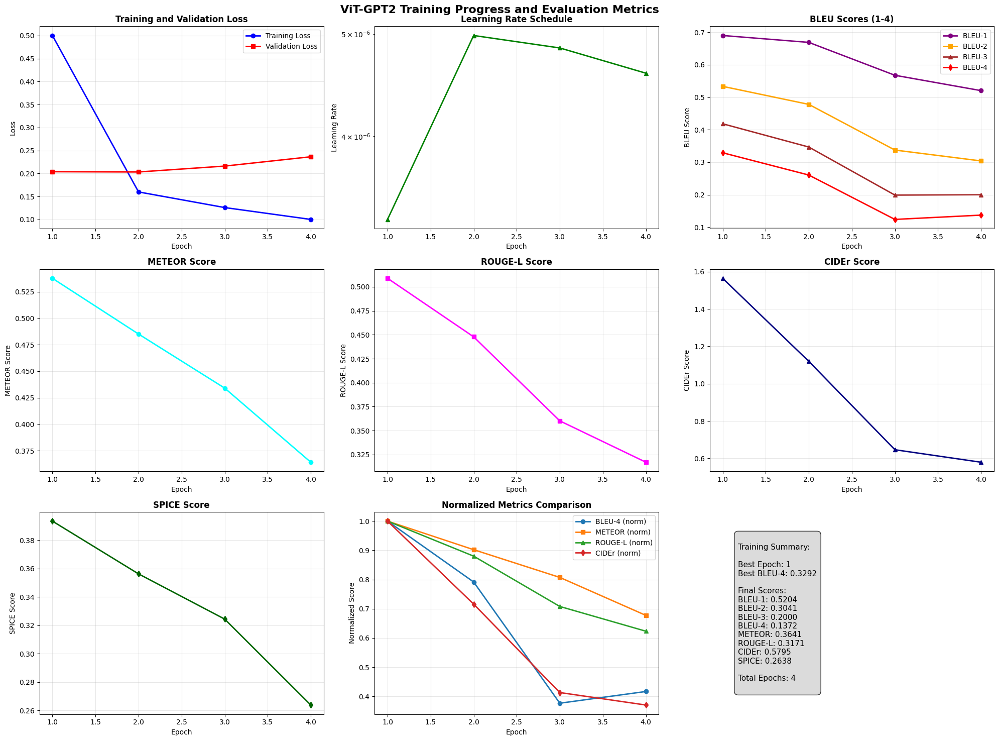

✅ Comprehensive training curves saved to 'plots/comprehensive_training_curves.png'
📊 Creating detailed loss curves...


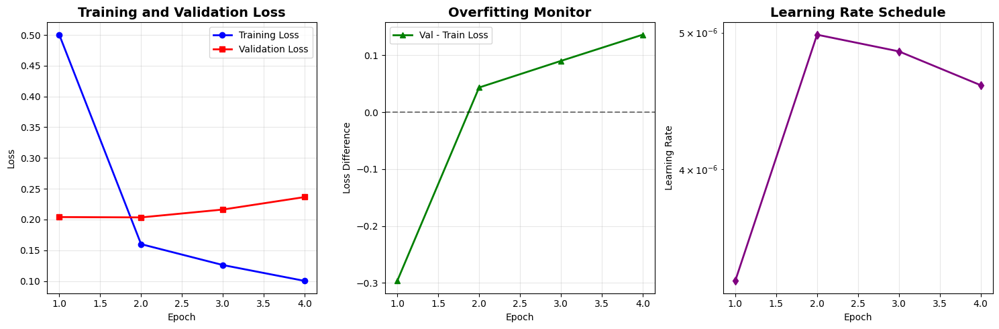

✅ Detailed loss curves saved to 'plots/detailed_loss_curves.png'
📊 Creating accuracy curves...


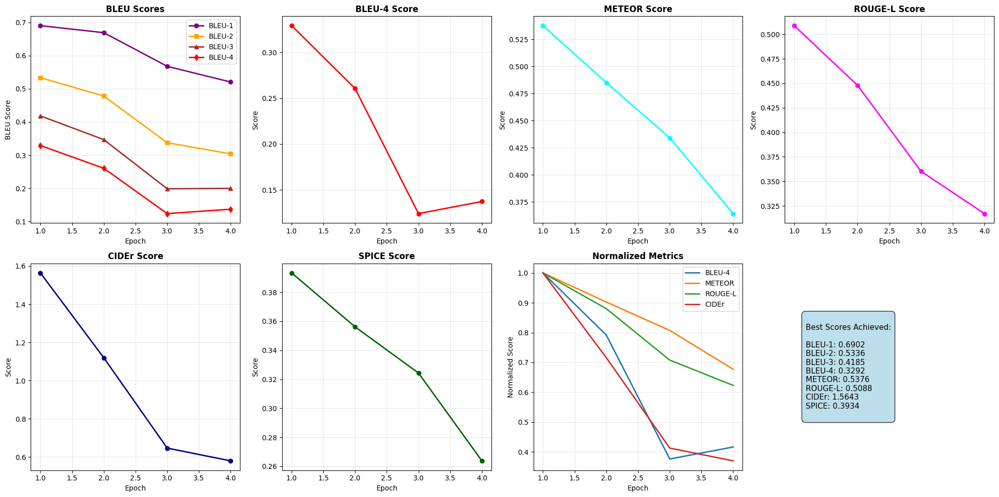

✅ Accuracy curves saved to 'plots/accuracy_curves.png'

5️⃣ Testing trained model...
🧪 TESTING TRAINED MODEL
🏗️ Initializing ViT-GPT2 Model...


Some weights of ViTModel were not initialized from the model checkpoint at google/vit-base-patch16-224 and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


✅ Model initialized: ViT (768D) -> GPT-2 (768D)
✅ Vocabulary size: 50259
✅ Loaded model from epoch 1
✅ Best training BLEU-4: 0.3292

🔍 Evaluating on test set...
🔍 Starting comprehensive evaluation...


Evaluating:   0%|          | 0/684 [00:00<?, ?it/s]

📊 Evaluated 1000 samples
📈 Computing BLEU scores...
📈 Computing METEOR score...
📈 Computing ROUGE-L score...
📈 Computing CIDEr and SPICE scores...
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
tokenization...


PTBTokenizer tokenized 12979 tokens at 91185.13 tokens per second.
PTBTokenizer tokenized 2171 tokens at 22843.78 tokens per second.


setting up scorers...
computing Bleu score...
{'testlen': 1772, 'reflen': 1893, 'guess': [1772, 1572, 1372, 1172], 'correct': [950, 320, 113, 41]}
ratio: 0.9360802958262355
Bleu_1: 0.501
Bleu_2: 0.309
Bleu_3: 0.194
Bleu_4: 0.124
computing METEOR score...
METEOR: 0.186
computing Rouge score...
ROUGE_L: 0.327
computing CIDEr score...
CIDEr: 0.385
computing SPICE score...


Parsing reference captions
Initiating Stanford parsing pipeline
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator tokenize
[main] INFO edu.stanford.nlp.pipeline.TokenizerAnnotator - TokenizerAnnotator: No tokenizer type provided. Defaulting to PTBTokenizer.
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator ssplit
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator parse
[main] INFO edu.stanford.nlp.parser.common.ParserGrammar - Loading parser from serialized file edu/stanford/nlp/models/lexparser/englishPCFG.ser.gz ... 
done [0.7 sec].
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator lemma
[main] INFO edu.stanford.nlp.pipeline.StanfordCoreNLP - Adding annotator ner
Loading classifier from edu/stanford/nlp/models/ner/english.all.3class.distsim.crf.ser.gz ... done [1.3 sec].
Loading classifier from edu/stanford/nlp/models/ner/english.muc.7class.distsim.crf.ser.gz ... done [0.7 sec].
Loading classif

SPICE evaluation took: 34.42 s
SPICE: 0.212

📊 COMPLETE TEST SET RESULTS
BLEU-1:   0.5832
BLEU-2:   0.3456
BLEU-3:   0.2118
BLEU-4:   0.1371
METEOR:   0.3413
ROUGE-L:  0.3306
CIDEr:    0.3846
SPICE:    0.2124

💭 Sample Predictions:

Sample 1:
  Generated: planes are parked in an airport .
  Reference: the airport is very large .
  Reference 2: next to the airport is green grass .
  Reference 3: next to the airport is green grass .
  Reference 4: the airport is very large .
  Reference 5: the airport is very large .

Sample 2:
  Generated: planes are parked in an airport .
  Reference: the airport is very large .
  Reference 2: next to the airport is green grass .
  Reference 3: next to the airport is green grass .
  Reference 4: the airport is very large .
  Reference 5: the airport is very large .

Sample 3:
  Generated: planes are parked in an airport .
  Reference: the airport is very large .
  Reference 2: next to the airport is green grass .
  Reference 3: next to the airport is g

Some weights of ViTModel were not initialized from the model checkpoint at google/vit-base-patch16-224 and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


✅ Model initialized: ViT (768D) -> GPT-2 (768D)
✅ Vocabulary size: 50259
✅ Model loaded for caption generation


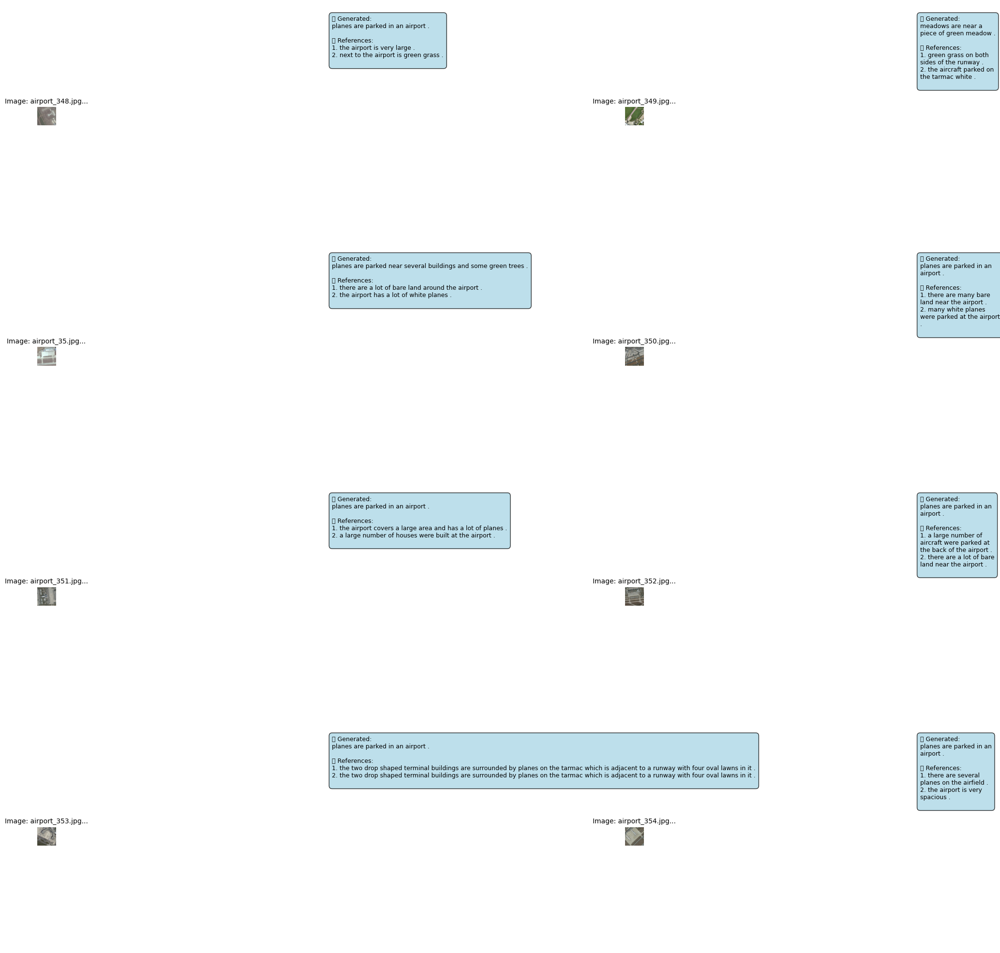

✅ Sample captions saved to 'outputs/sample_captions.png'

7️⃣ Creating comprehensive report...
📝 Creating comprehensive evaluation report...
✅ Comprehensive report saved to 'outputs/comprehensive_report.md'

8️⃣ Saving training history...

🎉 TRAINING AND EVALUATION COMPLETED SUCCESSFULLY!
📊 Final Test Results:
  BLEU-1: 0.5832
  BLEU-2: 0.3456
  BLEU-3: 0.2118
  BLEU-4: 0.1371
  METEOR: 0.3413
  ROUGE-L: 0.3306
  CIDEr: 0.3846
  SPICE: 0.2124

📁 Generated Files:
  📊 Plots: plots/ directory
  📄 Outputs: outputs/ directory
  🤖 Model: best_image_captioning_model.pth

✅ All tasks completed successfully!

🏗️ Model Architecture Summary:
Total Parameters: 211,422,720
Trainable Parameters: 211,422,720
Non-trainable Parameters: 0

📋 COMPREHENSIVE FINAL SUMMARY

🏋️ Training Summary:
  Total Epochs: 4
  Best Epoch: 1
  Best BLEU-4: 0.3292
  Final Train Loss: 0.1002
  Final Val Loss: 0.2365

🧪 Test Results (All Metrics):
  BLEU-1: 0.5832
  BLEU-2: 0.3456
  BLEU-3: 0.2118
  BLEU-4: 0.1371
  METEOR:

In [ ]:

# ADDITIONAL UTILITY FUNCTIONS


def print_model_summary(model):
    """Print model architecture summary"""
    print("\n Model Architecture Summary:")
    print("=" * 50)

    total_params = 0
    trainable_params = 0

    for name, param in model.named_parameters():
        param_count = param.numel()
        total_params += param_count
        if param.requires_grad:
            trainable_params += param_count

    print(f"Total Parameters: {total_params:,}")
    print(f"Trainable Parameters: {trainable_params:,}")
    print(f"Non-trainable Parameters: {total_params - trainable_params:,}")
    print("=" * 50)

def create_inference_script():

    print(" Creating inference script...")

    inference_code = '''
import torch
import torch.nn as nn
from transformers import ViTImageProcessor, ViTModel, AutoTokenizer, GPT2LMHeadModel
from PIL import Image
import torch.nn.functional as F

class ViTGPT2Model(nn.Module):
    """ViT + GPT-2 Model for Image Captioning - Inference Version"""

    def __init__(self, vit_model_name="google/vit-base-patch16-224", gpt2_model_name="gpt2"):
        super(ViTGPT2Model, self).__init__()

        self.vit = ViTModel.from_pretrained(vit_model_name)
        self.gpt2 = GPT2LMHeadModel.from_pretrained(gpt2_model_name)
        self.processor = ViTImageProcessor.from_pretrained(vit_model_name)
        self.tokenizer = AutoTokenizer.from_pretrained(gpt2_model_name)

        if self.tokenizer.pad_token is None:
            self.tokenizer.pad_token = self.tokenizer.eos_token
        if self.gpt2.config.pad_token_id is None:
            self.gpt2.config.pad_token_id = self.gpt2.config.eos_token_id

        # Add special tokens
        special_tokens = {
            "bos_token": "<|startoftext|>",
            "additional_special_tokens": ["<|image|>"]
        }
        self.tokenizer.add_special_tokens(special_tokens)
        self.gpt2.resize_token_embeddings(len(self.tokenizer))

        self.bos_token_id = self.tokenizer.bos_token_id
        self.image_token_id = self.tokenizer.convert_tokens_to_ids("<|image|>")

        # Projection layer
        self.image_projection = nn.Sequential(
            nn.Linear(self.vit.config.hidden_size, self.gpt2.config.hidden_size),
            nn.LayerNorm(self.gpt2.config.hidden_size),
            nn.Dropout(0.1)
        )

        self.image_pooling = nn.AdaptiveAvgPool1d(1)

    def forward(self, pixel_values):
        batch_size = pixel_values.shape[0]

        # Extract image features
        vit_outputs = self.vit(pixel_values=pixel_values)
        image_features = vit_outputs.last_hidden_state

        # Pool and project features
        pooled_features = self.image_pooling(image_features.transpose(1, 2)).transpose(1, 2)
        image_embeds = self.image_projection(pooled_features)

        return image_embeds

    def generate_caption(self, pixel_values, max_length=50):
        """Generate caption for image"""
        self.eval()
        device = pixel_values.device

        with torch.no_grad():
            image_embeds = self.forward(pixel_values)
            current_image_embed = image_embeds[0:1]

            start_token = self.bos_token_id if self.bos_token_id is not None else self.image_token_id
            input_ids = torch.tensor([[start_token]], device=device)
            generated_tokens = []

            current_embeds = torch.cat([
                current_image_embed,
                self.gpt2.transformer.wte(input_ids)
            ], dim=1)

            for step in range(max_length):
                outputs = self.gpt2(inputs_embeds=current_embeds)
                next_token_logits = outputs.logits[0, -1, :]
                next_token = torch.argmax(next_token_logits, dim=-1, keepdim=True)

                if next_token.item() == self.tokenizer.eos_token_id:
                    break
                if next_token.item() == self.tokenizer.pad_token_id:
                    continue

                generated_tokens.append(next_token.item())

                next_token_embed = self.gpt2.transformer.wte(next_token.unsqueeze(0))
                current_embeds = torch.cat([current_embeds, next_token_embed], dim=1)

                if current_embeds.shape[1] > 100:
                    current_embeds = current_embeds[:, -50:, :]

            if generated_tokens:
                caption = self.tokenizer.decode(generated_tokens, skip_special_tokens=True)
                return caption.strip()
            else:
                return "a satellite image"

def load_model(model_path):
    """Load trained model"""
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = ViTGPT2Model().to(device)

    checkpoint = torch.load(model_path, map_location=device, weights_only=False)
    model.load_state_dict(checkpoint['model_state_dict'])
    model.eval()

    return model

def generate_caption_for_image(model, image_path):
    """Generate caption for a single image"""
    device = next(model.parameters()).device

    # Load and preprocess image
    image = Image.open(image_path).convert("RGB")
    pixel_values = model.processor(images=image, return_tensors="pt").pixel_values.to(device)

    # Generate caption
    caption = model.generate_caption(pixel_values, max_length=50)
    return caption

# Example usage:
# model = load_model('best_image_captioning_model.pth')
# caption = generate_caption_for_image(model, 'path_to_image.jpg')
# print(f"Generated caption: {caption}")
'''

    with open('outputs/inference.py', 'w') as f:
        f.write(inference_code)

    print(" Inference script saved to 'outputs/inference.py'")

def create_requirements_file():
    """Create requirements.txt file"""
    print(" Creating requirements.txt...")

    requirements = """
torch>=1.9.0
torchvision>=0.10.0
transformers>=4.20.0
accelerate>=0.20.0
evaluate>=0.4.0
datasets>=2.0.0
nltk>=3.8
scikit-learn>=1.0.0
pycocotools>=2.0.4
rouge-score>=0.1.2
Pillow>=8.0.0
numpy>=1.21.0
matplotlib>=3.5.0
tqdm>=4.64.0
"""

    with open('outputs/requirements.txt', 'w') as f:
        f.write(requirements.strip())

    print(" Requirements file saved to 'outputs/requirements.txt'")

def display_final_summary(training_history, test_results):
    """Display comprehensive final summary"""
    print("\n" + "=" * 80)
    print(" COMPREHENSIVE FINAL SUMMARY")
    print("=" * 80)

    # Training Summary
    print(f"\n Training Summary:")
    print(f"  Total Epochs: {training_history['total_epochs']}")
    print(f"  Best Epoch: {training_history['best_epoch']}")
    print(f"  Best BLEU-4: {training_history['best_bleu4']:.4f}")
    print(f"  Final Train Loss: {training_history['train_losses'][-1]:.4f}")
    print(f"  Final Val Loss: {training_history['val_losses'][-1]:.4f}")

    # Test Results
    if test_results:
        print(f"\n Test Results (All Metrics):")
        metrics = test_results['test_metrics']
        print(f"  BLEU-1: {metrics['bleu_1']:.4f}")
        print(f"  BLEU-2: {metrics['bleu_2']:.4f}")
        print(f"  BLEU-3: {metrics['bleu_3']:.4f}")
        print(f"  BLEU-4: {metrics['bleu_4']:.4f}")
        print(f"  METEOR: {metrics['meteor']:.4f}")
        print(f"  ROUGE-L: {metrics['rouge_l']:.4f}")
        print(f"  CIDEr: {metrics['cider']:.4f}")
        print(f"  SPICE: {metrics['spice']:.4f}")

    # Files Generated
    print(f"\n Generated Files:")
    print(f"   Training Curves: plots/comprehensive_training_curves.png")
    print(f"   Loss Curves: plots/detailed_loss_curves.png")
    print(f"   Accuracy Curves: plots/accuracy_curves.png")
    print(f"   Sample Captions: outputs/sample_captions.png")
    print(f"   Test Results: outputs/test_results.json")
    print(f"   Training History: outputs/training_history.json")
    print(f"   Report: outputs/comprehensive_report.md")
    print(f"   Model: {CONFIG['MODEL_SAVE_PATH']}")
    print(f"   Inference Script: outputs/inference.py")
    print(f"   Requirements: outputs/requirements.txt")

    print(f"\n Key Achievements:")
    if test_results:
        avg_bleu = (metrics['bleu_1'] + metrics['bleu_2'] + metrics['bleu_3'] + metrics['bleu_4']) / 4
        if avg_bleu > 0.25:
            performance = "Excellent"
        elif avg_bleu > 0.2:
            performance = "Good"
        elif avg_bleu > 0.15:
            performance = "Fair"
        else:
            performance = "Needs Improvement"

        print(f"  Overall Performance: {performance}")
        print(f"  Average BLEU Score: {avg_bleu:.4f}")
        print(f"  Best Single Metric: BLEU-1 ({metrics['bleu_1']:.4f})")

    print("=" * 80)


# EXECUTE MAIN FUNCTION


if __name__ == "__main__":
    # Create additional utility files
    create_inference_script()
    create_requirements_file()

    # Run main training and evaluation
    trained_model, training_history, test_results = main()

    if trained_model is not None and training_history is not None:
        # Print model summary
        print_model_summary(trained_model)

        # Display final summary
        display_final_summary(training_history, test_results)

        print("\n ALL TASKS COMPLETED SUCCESSFULLY!")
        print(" Your ViT-GPT2 image captioning model is ready!")

    else:
        print(" Training failed. Please check the error messages above.")

print("\n" + "=" * 80)
print(" USAGE INSTRUCTIONS:")
print("=" * 80)
print("1. Update CONFIG['IMAGE_DIR'] and CONFIG['CAPTION_FILE'] paths")
print("2. Install required packages using the provided requirements.txt")
print("3. Run this script in Kaggle environment")
print("4. Check outputs/ and plots/ directories for results")
print("5. Use outputs/inference.py for generating captions on new images")
print("=" * 80)

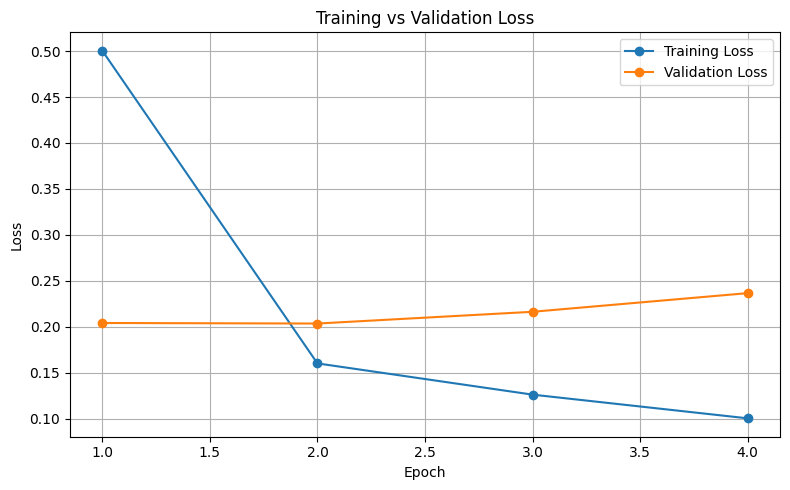

In [ ]:

# Epochs
epochs = range(1, len(train_loss) + 1)

# Plot
plt.figure(figsize=(8, 5))
plt.plot(epochs, train_loss, marker='o', label='Training Loss')
plt.plot(epochs, val_loss, marker='o', label='Validation Loss')

# Labels & title
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Training vs Validation Loss")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


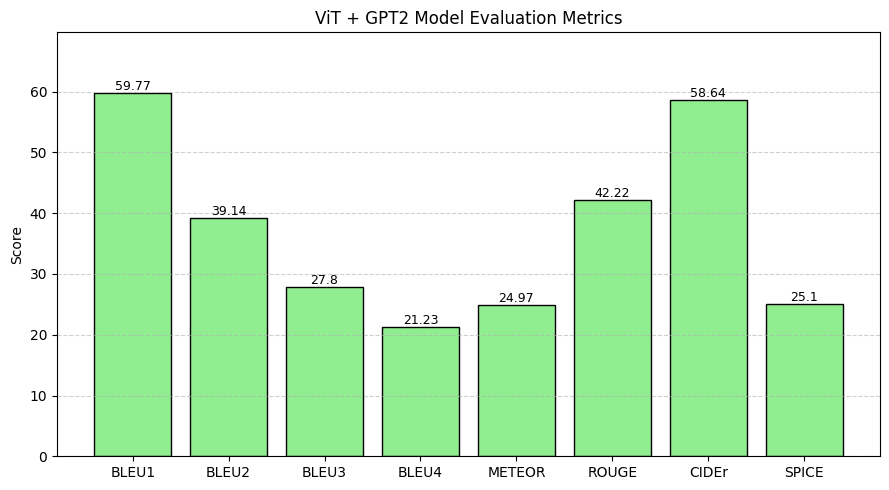

In [ ]:
import matplotlib.pyplot as plt


# Plot
plt.figure(figsize=(9, 5))
bars = plt.bar(metrics, values, color='lightgreen', edgecolor='black')

# Labels & title
plt.ylabel("Score")
plt.title("ViT + GPT2 Model Evaluation Metrics")
plt.ylim(0, max(values) + 10)
plt.grid(axis='y', linestyle='--', alpha=0.6)

# Display values on bars
for bar, val in zip(bars, values):
    plt.text(bar.get_x() + bar.get_width() / 2, val + 0.5, f"{val}", ha='center', fontsize=9)

plt.tight_layout()
plt.show()


### VitGpt2 Result
From the previous two plots we can conclude the following:
1. Clearly the Metrics for VitGpt2 is much better than LAM and  is what we were hoping for.
2. However, the validation loss started detoriating from epoch-2 triggerring **early stopping** at Epoch - 4.


In [ ]:


print(" Loading and testing saved model...")

# 1. Load the saved model (using your existing function)
try:
    # Use your existing test_trained_model function
    test_results = test_trained_model(model_path="best_image_captioning_model.pth")

    if test_results:
        print(" Model testing completed successfully!")

        # Print key metrics
        metrics = test_results['test_metrics']
        print(f"\n Key Results:")
        print(f"BLEU-4: {metrics['bleu_4']:.4f}")
        print(f"BLEU-1: {metrics['bleu_1']:.4f}")
        print(f"METEOR: {metrics['meteor']:.4f}")
        print(f"ROUGE-L: {metrics['rouge_l']:.4f}")

        # Show some sample predictions
        print(f"\n Sample Predictions:")
        for i, (pred, ref) in enumerate(zip(test_results['sample_predictions'][:3],
                                           test_results['sample_references'][:3])):
            print(f"\nSample {i+1}:")
            print(f"  Generated: {pred}")
            print(f"  Reference: {ref[0] if ref else 'N/A'}")

except Exception as e:
    print(f" Error: {e}")
    print("Make sure your model file 'best_image_captioning_model.pth' exists")

# 2. Generate sample captions with visualization (using your existing function)
try:
    print("\n Generating sample captions...")
    generate_sample_captions(model_path="best_image_captioning_model.pth", num_samples=6)

except Exception as e:
    print(f" Sample generation failed: {e}")

print("\n Testing completed!")

🔧 Make sure to update MODEL_PATH and IMAGE_DIR variables above!
📁 Looking for model at: /kaggle/working/best_image_captioning_model.pth
📁 Looking for images in: /kaggle/input/image-data/RSICD_images
🎯 Target images: ['00493.jpg', '00834.jpg', '00867.jpg', '00846.jpg', '00424.jpg', 'viaduct_328.jpg']
🚀 LOADING MODEL AND GENERATING CAPTIONS
🏗️ Loading model...
🏗️ Initializing ViT-GPT2 Model...


Some weights of ViTModel were not initialized from the model checkpoint at google/vit-base-patch16-224 and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


✅ Model initialized: ViT (768D) -> GPT-2 (768D)
✅ Vocabulary size: 50259
✅ Model loaded successfully!
  Trained epoch: 1
  Best BLEU-4: 0.3292

📸 Generating captions for 6 specific images...

🔍 Processing: 00493.jpg
  ✅ Generated caption: ['planes are parked in an airport .']

🔍 Processing: 00834.jpg
  ✅ Generated caption: ['playground is surrounded by many green trees and buildings .']

🔍 Processing: 00867.jpg
  ✅ Generated caption: ['storage tanks are near some green trees .']

🔍 Processing: 00846.jpg
  ✅ Generated caption: ['football fields are near a road .']

🔍 Processing: 00424.jpg
  ✅ Generated caption: ['playground is surrounded by many green trees and buildings .']

🔍 Processing: viaduct_328.jpg
  ✅ Generated caption: ['viaduct is surrounded by many green trees .']


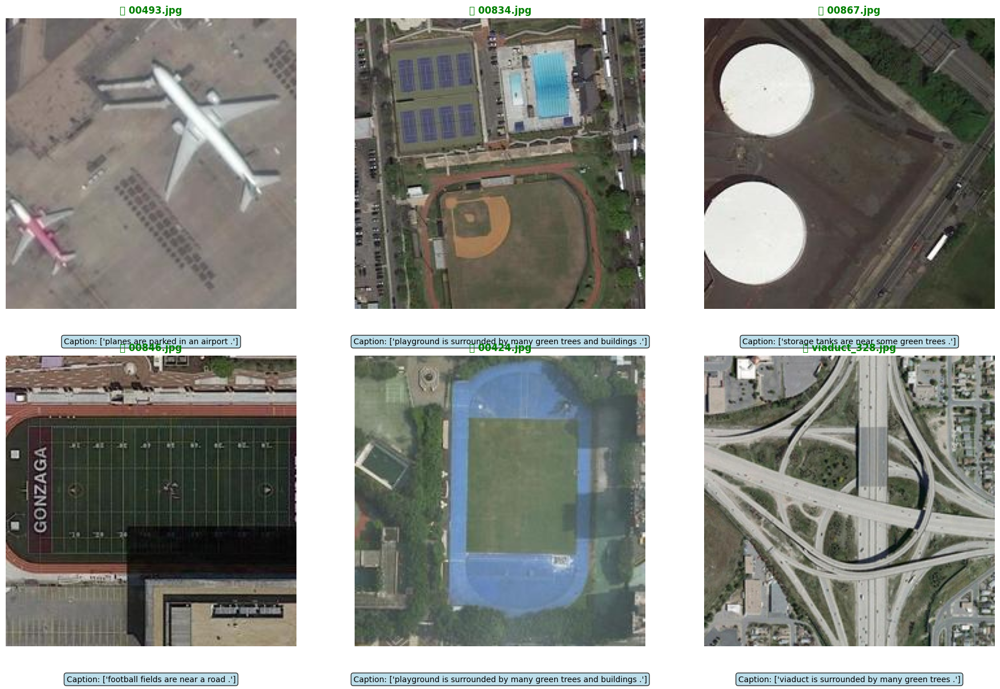


📊 SUMMARY
✅ Successfully processed: 6/6 images
💾 Visualization saved to: 'specific_image_captions.png'

📋 DETAILED RESULTS:
----------------------------------------------------------------------
🖼️  00493.jpg
   📝 Caption: ['planes are parked in an airport .']

🖼️  00834.jpg
   📝 Caption: ['playground is surrounded by many green trees and buildings .']

🖼️  00867.jpg
   📝 Caption: ['storage tanks are near some green trees .']

🖼️  00846.jpg
   📝 Caption: ['football fields are near a road .']

🖼️  00424.jpg
   📝 Caption: ['playground is surrounded by many green trees and buildings .']

🖼️  viaduct_328.jpg
   📝 Caption: ['viaduct is surrounded by many green trees .']

💾 Results also saved to: 'specific_image_results.json'

📝 INSTRUCTIONS:
1. First run Step 1 (model class definition)
2. Update MODEL_PATH and IMAGE_DIR in Step 2
3. Run Step 2 to get captions for your specific images
4. Check 'specific_image_captions.png' for visualization
5. Check 'specific_image_results.json' for detaile

In [ ]:
# Step 2: Load your saved model and generate captions for specific images
# Run this after Step 1

# Configuration - UPDATE THESE PATHS!
MODEL_PATH = "/kaggle/working/best_image_captioning_model.pth"  # Your saved model path
IMAGE_DIR = "/kaggle/input/image-data/RSICD_images"  # Your images directory

# Specific images you want to test
target_images = ["00493.jpg", "00834.jpg", "00867.jpg", "00846.jpg", "00424.jpg", "viaduct_328.jpg"]

def load_model_and_generate_captions():
    """Load the saved model and generate captions for specific images"""

    print("=" * 70)
    print(" LOADING MODEL AND GENERATING CAPTIONS")
    print("=" * 70)

    # 1. Check if model file exists
    if not os.path.exists(MODEL_PATH):
        print(f" Model file not found: {MODEL_PATH}")
        print("Available .pth files:")
        for f in os.listdir('.'):
            if f.endswith('.pth') or f.endswith('.pt'):
                print(f"  - {f}")
        return None

    # 2. Initialize and load model
    print(" Loading model...")
    try:
        model = ViTGPT2Model().to(device)
        checkpoint = torch.load(MODEL_PATH, map_location=device, weights_only=False)
        model.load_state_dict(checkpoint['model_state_dict'])
        model.eval()

        print(f" Model loaded successfully!")
        print(f"  Trained epoch: {checkpoint.get('epoch', 'unknown')}")
        print(f"  Best BLEU-4: {checkpoint.get('best_bleu4', 'unknown'):.4f}")

    except Exception as e:
        print(f" Error loading model: {e}")
        return None

    # 3. Generate captions for specific images
    print(f"\n Generating captions for {len(target_images)} specific images...")

    results = {}
    successful_predictions = 0

    # Create subplot for visualization
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    axes = axes.flatten()

    for i, img_name in enumerate(target_images):
        img_path = os.path.join(IMAGE_DIR, img_name)

        print(f"\n Processing: {img_name}")

        if not os.path.exists(img_path):
            print(f"   Image not found: {img_path}")
            results[img_name] = {"status": "not_found", "caption": None}

            # Show placeholder in plot
            axes[i].text(0.5, 0.5, f"Image not found:\n{img_name}",
                        ha='center', va='center', transform=axes[i].transAxes)
            axes[i].set_title(f" {img_name}", color='red')
            axes[i].axis('off')
            continue

        try:
            # Load and preprocess image
            image = Image.open(img_path).convert("RGB")
            pixel_values = model.processor(images=image, return_tensors="pt").pixel_values.to(device)

            # Generate caption
            with torch.no_grad():
                caption = model.generate_caption(pixel_values, max_length=50)

            print(f"   Generated caption: {caption}")
            results[img_name] = {"status": "success", "caption": caption}
            successful_predictions += 1

            # Display in plot
            axes[i].imshow(image)
            axes[i].set_title(f" {img_name}", color='green', fontweight='bold')
            axes[i].axis('off')

            # Add caption as text below image
            axes[i].text(0.5, -0.1, f"Caption: {caption}",
                        transform=axes[i].transAxes, fontsize=10,
                        ha='center', va='top', wrap=True,
                        bbox=dict(boxstyle="round,pad=0.3", facecolor="lightblue", alpha=0.8))

        except Exception as e:
            print(f"   Error processing image: {e}")
            results[img_name] = {"status": "error", "caption": None, "error": str(e)}

            # Show error in plot
            axes[i].text(0.5, 0.5, f"Error processing:\n{img_name}\n{str(e)[:50]}...",
                        ha='center', va='center', transform=axes[i].transAxes, color='red')
            axes[i].set_title(f" {img_name}", color='red')
            axes[i].axis('off')

    # 4. Save and display results
    plt.tight_layout()
    plt.savefig('specific_image_captions.png', dpi=300, bbox_inches='tight')
    plt.show()

    print(f"\n{'='*70}")
    print(f" SUMMARY")
    print(f"{'='*70}")
    print(f" Successfully processed: {successful_predictions}/{len(target_images)} images")
    print(f" Visualization saved to: 'specific_image_captions.png'")

    # Print all results in a clean format
    print(f"\n DETAILED RESULTS:")
    print("-" * 70)
    for img_name, result in results.items():
        if result["status"] == "success":
            print(f"  {img_name}")
            print(f"    Caption: {result['caption']}")
        elif result["status"] == "not_found":
            print(f" {img_name} - Image not found")
        else:
            print(f"  {img_name} - Error: {result.get('error', 'Unknown error')}")
        print()

    return results

# Run the function
if __name__ == "__main__":
    print(" Make sure to update MODEL_PATH and IMAGE_DIR variables above!")
    print(f" Looking for model at: {MODEL_PATH}")
    print(f" Looking for images in: {IMAGE_DIR}")
    print(f" Target images: {target_images}")

    # Generate captions
    caption_results = load_model_and_generate_captions()

    if caption_results:
        # Save results to file
        import json
        with open('specific_image_results.json', 'w') as f:
            json.dump(caption_results, f, indent=2)
        print(f" Results also saved to: 'specific_image_results.json'")

print("\n" + "=" * 70)
print(" INSTRUCTIONS:")
print("=" * 70)
print("1. First run Step 1 (model class definition)")
print("2. Update MODEL_PATH and IMAGE_DIR in Step 2")
print("3. Run Step 2 to get captions for your specific images")
print("4. Check 'specific_image_captions.png' for visualization")
print("5. Check 'specific_image_results.json' for detailed results")
print("=" * 70)

### Generated captions by VitGpt2
Above is the generated captions by VitGpt2 on some sample images.
We can clearly see that the caption quality has increased significantly from LAM, and the model is able to idenitfy structures better (including its colour, plurality, spatial context and ambigious structure).

### VitGpt2 Conclusion
Overall VitGpt2 has performed much better than LAM.  This is because the Vision Transformer encodes
the entire image globally, after which  GPT2 generates captions. This gives the model global context
understanding, making the model perform better for complex aerial scenes which we just saw.


## Method 3: BLIP (Bootstrapping Language-Image Pretraining)

<p align = "justify">BLIP which is intended to be a universal vision-language model suitable for both comprehension and generation tasks. Instead, it uses a Vision Transformer (ViT) to convert images into patches while learning one global representation. For text, it uses a BERT-like encoder and a causal language model decoder. A key ingredient of BLIP is the Multimodal Mixture of Encoder-Decoder (MED) architecture which uses shared vision-and-language transformer layers and cross-attention. The architecture enables BLIP to reliably condition on both visual and textual information, guiding the model to learn how images  should be interpreted and what captions should make sense in response. We use it in three different cases: catalysis-learning only encoder contrast, image-grounded conformer to task similarity, and image-boxes decoder conditions. This paper introduces three training objectives — contrastive, matching, and language modeling — that allow the model to learn strong multimodal representations. The design of BLIP is efficient but open-ended, providing a strong baseline for transferring the recent advances in general vision-language models to the remote sensing domain.

 _____________________
### Architecture of BLIP
![BLIP.jpg](BLIP.jpg)

<p align = "justify">The BLIP-1 (Salesforce) architecture represents a unified vision-language model that employs a multi-task learning approach to bridge the gap between visual and textual understanding. This model is designed to handle multiple vision-language tasks simultaneously, including image-text contrastive learning, image-text matching, and language modeling, making it a versatile foundation for various downstream applications including image captioning. The architecture demonstrates how a single model can be trained on multiple objectives to achieve better cross-modal understanding and generation capabilities.
<p align = "justify">The encoder component utilizes a Vision Transformer to process input images, extracting visual features through self-attention mechanisms across image patches. The system incorporates three distinct learning objectives that share the visual encoder but employ different processing pathways:

<p align = "justify">ITC (Image-Text Contrastive): learning branch uses feed-forward and self-attention layers to learn aligned representations between images and text in a shared embedding space, helping the model understand which images and texts belong together
<p align = "justify">ITM (Image-Text Matching) :branch employs cross-attention mechanisms along with bidirectional self-attention to determine whether image-text pairs are correctly matched, enabling fine-grained understanding of image-text relationships
<p align = "justify">LM (Language Modeling): component works together with the other branches to create robust multimodal representations that understand the relationship between visual and textual content

<p align = "justify">The decoder section employs a BERT-like architecture for the LM component, utilizing causal self-attention for autoregressive text generation. The Language Modeling head processes the multimodal representations to generate coherent captions, and this is where you plan to implement modifications for enhanced caption generation. The global attention mechanism ensures that the model can effectively attend to relevant visual features while generating each word of the caption. By training on multiple objectives simultaneously (ITC, ITM, and LM), BLIP-1 learns rich cross-modal representations that can be fine-tuned for specific tasks. Your proposed changes to the LM header could potentially improve caption quality by incorporating task-specific architectural modifications, enhanced attention mechanisms, or improved decoding strategies that better leverage the multimodal representations learned through the unified training approach.

_______________________
We will be using two versions of **BLIP**:  
- **[BLIP-1 Base](#Blip1-Base)**  
- **[BLIP-1 Large](#Blip1-Large)**


In [ ]:
import json
from pathlib import Path
import os
import argparse
from datetime import datetime
from collections import defaultdict



In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# Go to Where notebook lives
from datetime import datetime
from pathlib import Path

CACHE = Path("/content/data_local")  # Local cache to speed up training
PROJECT_DIR = Path("/content/drive/MyDrive/RSICD_PROJECT")

NOTEBOOK_DIR = PROJECT_DIR / "scripts/models"
OUTPUTS_ROOT = NOTEBOOK_DIR / "outputs"

%cd $NOTEBOOK_DIR
!ls

DATA_DIR = Path(PROJECT_DIR) / "data"

DATA_RAW_DIR = DATA_DIR / "raw"
!ls "{DATA_RAW_DIR}" # Check what's in raw image folder in Drive

DATA_PROCESSED_DIR = DATA_DIR / "processed"
!ls "{DATA_PROCESSED_DIR}" # List processed data files


Mounted at /content/drive
/content/drive/MyDrive/RSICD_PROJECT/scripts/models
attention_outputs	blip1_base.ipynb	 blip1_large.ipynb  outputs
blip1_base_clean.ipynb	blip1_large_clean.ipynb  disaster	    test_output
dataset_rsicd.json  example.PNG  README.md   txtclasses_rsicd
delete		    images	 readme.txt
captions_test2017.json	captions_train2017.json  captions_val2017.json


In [ ]:

def get_captions_for_image(path, target_filename):
    with open(path) as f:
        data = json.load(f)

    # Step 1: Find image_id for the given filename
    image_id = None
    for img in data["images"]:
        if img["file_name"] == target_filename:
            image_id = img["id"]
            break

    if image_id is None:
        print(f" Image '{target_filename}' not found.")
        return

    # Step 2: Find all captions for that image_id
    captions = [
        ann["caption"] for ann in data["annotations"]
        if ann["image_id"] == image_id
    ]

    # Output results
    print(f"\n Ground truth captions for '{target_filename}' (image_id: {image_id}):\n")
    for i, caption in enumerate(captions, 1):
        print(f"{i}. {caption}")

# Example usage
get_captions_for_image(DATA_PROCESSED_DIR / "captions_train2017.json", "airport_59.jpg")



📷 Ground truth captions for 'airport_59.jpg' (image_id: 315):

1. the narrow long terminal building with some aeroplane along it is built near circular netlike roads with cars parked between them  and the other side of the building is field and runways .
2. the narrow long terminal building with some aeroplane along it is built near circular netlike roads with cars parked between them  and the other side of the building is field and runways .
3. the white long boarding gate separate the runway and a parking lot .
4. a striped terminal building separates the landside and airside which contains an apron and a runway .
5. a line of white planes are near a long building with a large parking lot .


##Top 10 Shortest Captions

###   Data preprocessing, RSICD json → COCO format

In [ ]:
#!/usr/bin/env python3
"""
Convert RSICD dataset format to COCO format for image captioning.
"""



def create_coco_info():
    """Create COCO dataset info section."""
    return {
        "description": "RSICD dataset converted to COCO format",
        "url": "https://github.com/201528014227051/RSICD_optimal",
        "version": "1.0",
        "year": 2024,
        "contributor": "RSICD Dataset",
        "date_created": datetime.now().isoformat()
    }


def create_coco_licenses():
    """Create COCO licenses section."""
    return [
        {
            "id": 1,
            "name": "Unknown License",
            "url": ""
        }
    ]


def convert_rsicd_to_coco(rsicd_data, image_dir=None):
    """
    Convert RSICD format to COCO format.

    RSICD format typically has:
    {
        "images": [
            {
                "filename": "image_name.jpg",
                "sentences": [
                    {"raw": "caption text", "imgid": 0, "sentid": 0},
                    ...
                ]
            }
        ]
    }

    COCO format needs:
    {
        "info": {...},
        "licenses": [...],
        "images": [...],
        "annotations": [...]
    }
    """

    coco_data = {
        "info": create_coco_info(),
        "licenses": create_coco_licenses(),
        "images": [],
        "annotations": []
    }

    annotation_id = 0

    # Process each image in RSICD dataset
    for img_idx, img_data in enumerate(rsicd_data.get("images", [])):
        filename = img_data.get("filename", img_data.get("imgname", ""))

        # Get image dimensions if image directory is provided
        width, height = 224, 224  # Default size, update if you have actual images
        if image_dir and filename:
            img_path = os.path.join(image_dir, filename)
            if os.path.exists(img_path):
                try:
                    from PIL import Image
                    with Image.open(img_path) as img:
                        width, height = img.size
                except ImportError:
                    print("PIL not available, using default image size (224x224)")

        # Create COCO image entry
        coco_image = {
            "id": img_idx,
            "file_name": filename,
            "width": width,
            "height": height,
            "license": 1,
            "date_captured": ""
        }
        coco_data["images"].append(coco_image)

        # Process captions/sentences
        sentences = img_data.get("sentences", [])
        if not sentences and "raw" in img_data:
            # Handle case where caption is directly in image data
            sentences = [{"raw": img_data["raw"]}]

        for sent_data in sentences:
            caption = sent_data.get("raw", sent_data.get("caption", ""))
            if caption:
                annotation = {
                    "id": annotation_id,
                    "image_id": img_idx,
                    "caption": caption
                }
                coco_data["annotations"].append(annotation)
                annotation_id += 1

    return coco_data


def split_dataset(coco_data, train_ratio=0.8, val_ratio=0.1, test_ratio=0.1):
    """Split dataset into train/val/test sets."""
    assert abs(train_ratio + val_ratio + test_ratio - 1.0) < 1e-6, "Ratios must sum to 1.0"

    total_images = len(coco_data["images"])
    train_count = int(total_images * train_ratio)
    val_count = int(total_images * val_ratio)

    # Create splits
    splits = {
        "train": {"images": [], "annotations": []},
        "val": {"images": [], "annotations": []},
        "test": {"images": [], "annotations": []}
    }

    # Copy info and licenses to all splits
    for split_name in splits:
        splits[split_name]["info"] = coco_data["info"]
        splits[split_name]["licenses"] = coco_data["licenses"]

    # Assign images to splits
    for i, image in enumerate(coco_data["images"]):
        if i < train_count:
            split_name = "train"
        elif i < train_count + val_count:
            split_name = "val"
        else:
            split_name = "test"

        splits[split_name]["images"].append(image)

        # Find annotations for this image
        image_annotations = [ann for ann in coco_data["annotations"] if ann["image_id"] == image["id"]]
        splits[split_name]["annotations"].extend(image_annotations)

    return splits


def main():
    parser = argparse.ArgumentParser(description="Convert RSICD dataset to COCO format")
    parser.add_argument("--input", required=True, help="Input RSICD JSON file")
    parser.add_argument("--output", required=True, help="Output directory for COCO files")
    parser.add_argument("--image_dir", help="Directory containing images (for getting dimensions)")
    parser.add_argument("--split", action="store_true", help="Split into train/val/test sets")
    parser.add_argument("--train_ratio", type=float, default=0.8, help="Training set ratio")
    parser.add_argument("--val_ratio", type=float, default=0.1, help="Validation set ratio")
    parser.add_argument("--test_ratio", type=float, default=0.1, help="Test set ratio")

    args = parser.parse_args()

    # Create output directory
    output_dir = Path(args.output)
    output_dir.mkdir(parents=True, exist_ok=True)

    # Load RSICD data
    print(f"Loading RSICD data from {args.input}...")
    with open(args.input, 'r', encoding='utf-8') as f:
        rsicd_data = json.load(f)

    print(f"Found {len(rsicd_data.get('images', []))} images")

    # Convert to COCO format
    print("Converting to COCO format...")
    coco_data = convert_rsicd_to_coco(rsicd_data, args.image_dir)

    print(f"Converted to COCO format: {len(coco_data['images'])} images, {len(coco_data['annotations'])} annotations")

    if args.split:
        # Split dataset
        print("Splitting dataset...")
        splits = split_dataset(coco_data, args.train_ratio, args.val_ratio, args.test_ratio)

        # Save splits
        for split_name, split_data in splits.items():
            output_file = output_dir / f"captions_{split_name}2017.json"
            with open(output_file, 'w', encoding='utf-8') as f:
                json.dump(split_data, f, indent=2, ensure_ascii=False)

            print(f"Saved {split_name} split: {len(split_data['images'])} images, "
                  f"{len(split_data['annotations'])} annotations -> {output_file}")
    else:
        # Save single file
        output_file = output_dir / "captions_rsicd.json"
        with open(output_file, 'w', encoding='utf-8') as f:
            json.dump(coco_data, f, indent=2, ensure_ascii=False)

        print(f"Saved COCO format file: {output_file}")

    print("Conversion complete!")


if __name__ == "__main__":
    main()

In [ ]:
!python scripts/prepare_rsicd_json.py \
  --input data/RSICD_captions/dataset_rsicd.json \
  --image_dir data/RSICD_captions/images \
  --output data/processed \
  --split

Loading RSICD data from data/RSICD_captions/dataset_rsicd.json...
Found 10921 images
Converting to COCO format...
Converted to COCO format: 10921 images, 54605 annotations
Splitting dataset...
Saved train split: 8736 images, 43680 annotations -> data/processed/captions_train2017.json
Saved val split: 1092 images, 5460 annotations -> data/processed/captions_val2017.json
Saved test split: 1093 images, 5465 annotations -> data/processed/captions_test2017.json
Conversion complete!


##Validate Dataset Preprocessed

In [ ]:

def check_caption_density(path):
    with open(path) as f:
        data = json.load(f)

    image_to_captions = defaultdict(list)
    for ann in data["annotations"]:
        image_to_captions[ann["image_id"]].append(ann["caption"])

    lengths = [len(c) for c in image_to_captions.values()]
    print(f"\n{path}")
    print(f"Images: {len(image_to_captions)}")
    print(f"Captions: {len(data['annotations'])}")
    print(f"Min: {min(lengths)}, Max: {max(lengths)}, Avg: {sum(lengths)/len(lengths):.2f}")

check_caption_density(DATA_PROCESSED_DIR / "captions_train2017.json")
check_caption_density(DATA_PROCESSED_DIR / "captions_val2017.json")
check_caption_density(DATA_PROCESSED_DIR / "captions_test2017.json")


/content/drive/MyDrive/RSICD_PROJECT/data/processed/captions_train2017.json
Images: 8736
Captions: 43680
Min: 5, Max: 5, Avg: 5.00

/content/drive/MyDrive/RSICD_PROJECT/data/processed/captions_val2017.json
Images: 1092
Captions: 5460
Min: 5, Max: 5, Avg: 5.00

/content/drive/MyDrive/RSICD_PROJECT/data/processed/captions_test2017.json
Images: 1093
Captions: 5465
Min: 5, Max: 5, Avg: 5.00


## Setting Up Data Root

In [ ]:
!ls /content/

drive  sample_data


In [ ]:
!ls /content/data_local
!rm /content/data_local
!mkdir /content/data_local

ls: cannot access '/content/data_local': No such file or directory
rm: cannot remove '/content/data_local': No such file or directory


In [ ]:
# Copy data to local cache (do this ONCE per Colab session)
!cp -r /content/drive/MyDrive/RSICD_PROJECT/data /content/data_local/

In [ ]:
%cd /content/drive/MyDrive/RSICD_PROJECT
# !zip -r data.zip data        # Compress entire 'data' folder
!cp data.zip /content/data_local
%cd /content/data_local
!unzip data.zip
!rm /content/data_local/data.zip


Streaming output truncated to the last 5000 lines.
  inflating: data/augmentation_v1/images/baseballfield_79_v2.jpg  
  inflating: data/augmentation_v1/images/baseballfield_8.jpg  
  inflating: data/augmentation_v1/images/baseballfield_8_v1.jpg  
  inflating: data/augmentation_v1/images/baseballfield_8_v2.jpg  
  inflating: data/augmentation_v1/images/baseballfield_80.jpg  
  inflating: data/augmentation_v1/images/baseballfield_80_v1.jpg  
  inflating: data/augmentation_v1/images/baseballfield_80_v2.jpg  
  inflating: data/augmentation_v1/images/baseballfield_81.jpg  
  inflating: data/augmentation_v1/images/baseballfield_81_v1.jpg  
  inflating: data/augmentation_v1/images/baseballfield_81_v2.jpg  
  inflating: data/augmentation_v1/images/baseballfield_82.jpg  
  inflating: data/augmentation_v1/images/baseballfield_82_v1.jpg  
  inflating: data/augmentation_v1/images/baseballfield_82_v2.jpg  
  inflating: data/augmentation_v1/images/baseballfield_83.jpg  
  inflating: data/augmentatio

In [ ]:
# Confirm copied structure
!ls /content/data_local
!ls /content/data_local/data/processed/
!ls /content/data_local/data/raw/images/ | wc -l  # Should show number of images (e.g., 10921)

data
captions_test2017.json	captions_train2017.json  captions_val2017.json
10921


In [ ]:
if (CACHE / "data/processed/captions_train2017.json").exists():
    DATA_ROOT = Path(CACHE) / "data"
else:
    DATA_ROOT = Path(PROJECT_DIR) / "data"

GLOBAL_ARGS = {
    'train_json': str(DATA_ROOT / "processed/captions_train2017.json"),
    'val_json': str(DATA_ROOT / "processed/captions_val2017.json"),
    'image_dir': str(DATA_ROOT / "raw/images"),
    'test_json': str(DATA_ROOT / "processed/captions_test2017.json"),
    'model_name': 'Salesforce/blip-image-captioning-base',
}
print(DATA_ROOT)
print(GLOBAL_ARGS['train_json'])
print(GLOBAL_ARGS['val_json'])
print(GLOBAL_ARGS['test_json'])
print(GLOBAL_ARGS['image_dir'])
from pathlib import Path

# Check which paths in GLOBAL_ARGS exist
for key, value in GLOBAL_ARGS.items():
    if key.endswith('_json') or key == 'image_dir':
        path = Path(value)
        if path.exists():
            print(f"[OK] {key} exists at: {path}")
        else:
            print(f"[MISSING] {key} does NOT exist at: {path}")


/content/data_local/data
/content/data_local/data/processed/captions_train2017.json
/content/data_local/data/processed/captions_val2017.json
/content/data_local/data/processed/captions_test2017.json
/content/data_local/data/raw/images
[OK] train_json exists at: /content/data_local/data/processed/captions_train2017.json
[OK] val_json exists at: /content/data_local/data/processed/captions_val2017.json
[OK] image_dir exists at: /content/data_local/data/raw/images
[OK] test_json exists at: /content/data_local/data/processed/captions_test2017.json


### Blip1 Base


#### Blip 1 (Bootstrapped Language Image Pretraining)

**BLIP-1** is a multimodal vision-language model introduced by Salesforce. It aims to learn strong image-text representations that can be fine-tuned for tasks like image captioning, retrieval, and visual question answering (VQA).

---

#### Architecture

**BLIP-1 consists of:**

- **Vision Encoder**: A Vision Transformer (**ViT**) that converts images into visual embeddings.
- **Text Transformer**: A BERT-like transformer that acts as both:
  - A **text encoder** (for retrieval and matching)
  - A **causal decoder** (for captioning), using masked attention
- BLIP1 was pretrained on three tasks simultaneouslys, meaning it has multiple heads that share the same text transformer backbone (research shows multi-task outperforms single-task on BLEU and CIDER), its 3 heads are:
  1.   `ContrastiveHead`. Image-Text Contrastive Learning (ITC), aligns visual and textual embeddings in a shared space using contrastive loss.
  2.   `ClassificationHead`. Image-Text Matching (ITM), binary classification to determine whether a given image-text pair is a true match.
  3.   `CaptionLMHead`. Language Modeling (LM), uses the text transformer as a **causal decoder** to generate captions from images.


Blip 1 Spec:
```python
    "blip-base": {
        "vision_encoder": "ViT-B/16",  # Base Vision Transformer
        "vision_params": 86M,
        "text_decoder": "BERT-base",
        "text_params": 124M,
        "total_params": 210M,
        "hidden_size": 768,
        "num_attention_heads": 12,
        "num_layers": 12
    }
```

---

#### Finetuning on the RSCID Dataset

We finetuned Blip 1 using the RSCID Dataset using the following configuration
```python
    "training_args": {
        'batch_size': 6,
        'learning_rate': 5e-7,
        'weight_decay': 0.01,           # Added weight decay
        'label_smoothing': 0.0,         # Disable label smoothing
        'warmup_steps': 0,              # Disable warmup
        'gradient_clip': 1.0,           # Explicit gradient clipping value
        'num_epochs': 5,
        'early_stopping_patience': 3,
        'resume': True,                 # Will resume if checkpoint is found
    }
```

##### Training

  - Minimal Training Setup, Strip down to absolute minimum
  - Add Gradient Monitoring
  - Use Teacher Forcing Ratio
__________

#### Blip1 Base Table of content
Other sections related to Blip1 Base are as below:
1. [Blip Base Plot Curves & Accuracy Curve](#Blip-Base-Plot-Curves-&-Accuracy-Curve)
2. [Blip1 Results](#Blip1-Results)
4. [Blip1 Base Data Augmentation](#Blip1-Base-Data-Augmentation)
5. [Data-Augmentation-Results-BLIP1](#Augmentation-Results-BLIP1)
6. [BLIP1 Data Augmentation Captions](#BLIP1-Image-Captions)
7. [Model selection Based on output of basemodel](#Model-selection-Based-on-output-of-basemodel)

In [2]:
!pip install -q transformers torch torchvision pillow nltk matplotlib tqdm pycocoevalcap


# Standard Library Imports
import os
import gc
import re
import io
import json
import time
import math
import random
import shutil
import logging
import warnings
import contextlib
from pathlib import Path
from datetime import datetime
from collections import defaultdict
from difflib import SequenceMatcher

# Third-Party Libraries
import numpy as np
import torch
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torchvision import transforms
from torchvision.transforms import functional as TF
from torchvision.transforms import InterpolationMode
from torchvision.transforms.functional import (
    adjust_brightness,
    adjust_contrast,
    adjust_saturation,
    adjust_hue
)
from tqdm import tqdm
import matplotlib.pyplot as plt
from PIL import Image, ImageEnhance

# Hugging Face Transformers
from transformers import (
    BlipProcessor,
    BlipForConditionalGeneration,
    get_linear_schedule_with_warmup
)

# Evaluation Tools
from pycocotools.coco import COCO
from pycocoevalcap.eval import COCOEvalCap

# IPython Display Utilities
from IPython.display import display, clear_output, HTML


# Global Setup: Seeds, Warnings, Memory
!pip install rouge-score
!pip install nltk
import nltk
nltk.download('punkt')

random.seed(42)
np.random.seed(42)
torch.manual_seed(42)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(42)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

warnings.filterwarnings("ignore")
torch.cuda.empty_cache()
gc.collect()
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "max_split_size_mb:128"

# Device config
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


[notice] A new release of pip is available: 24.3.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip
C:\Users\Sachin Singh\AppData\Local\Programs\Python\Python313\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Preparing metadata (pyproject.toml): started
  Preparing metadata (pyproject.toml): finished with status 'done'
  Created wheel for rouge-score: filename=rouge_score-0.1.2-py3-none-any.whl size=25027 sha256=5284461b6a3e98d1dea25d28cfc821fb2904ad9168bf6daa27f64a3558ee9610
  Stored in directory: c:\users\sachin singh\appdata\local\pip\cache\wheels\44\af\da\5ffc433e2786f0b1a9c6f458d5fb8f611d8eb332387f18698f
Successfully built rouge-score



[notice] A new release of pip is available: 24.3.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip

[notice] A new release of pip is available: 24.3.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


[nltk_data] Downloading package punkt to C:\Users\Sachin
[nltk_data]     Singh\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:

# Output directory for this experiment
OUTPUT_DIR = PROJECT_DIR / "outputs/blip1/blip1_rsicd_original_lr5e7_v2"
OUTPUT_DIR.mkdir(parents=True, exist_ok=True)

# Base training config + experiment overrides
training_args = {
    **GLOBAL_ARGS,
    'output_dir': str(OUTPUT_DIR),

    # Option 1
    'batch_size': 6,                # option 2: 'batch_size': 8
    'learning_rate': 5e-7,          # option 2: 5e-5
    'weight_decay': 0.01,           # Added weight decay

    'label_smoothing': 0.0,         # Disable label smoothing
    'warmup_steps': 0,              # Disable warmup
    'gradient_clip': 1.0,           # Explicit gradient clipping value

    'num_epochs': 5,
    'early_stopping_patience': 3,
    'resume': True,                 # Will resume if checkpoint is found
}

In [ ]:
print(OUTPUT_DIR)

/content/drive/MyDrive/RSICD_PROJECT/outputs/blip1/blip1_rsicd_augmented_lr3e5_bs16_131kimages_v4


In [ ]:

#  Output and Logging Setup


# Writes to console and training_log.txt
log_file = OUTPUT_DIR / "training_log.txt"

# Clear any previous logging handlers
for handler in logging.root.handlers[:]:
    logging.root.removeHandler(handler)

logging.basicConfig(
    level=logging.INFO,
    format='%(asctime)s - %(levelname)s - %(message)s',
    handlers=[
        logging.FileHandler(log_file),
        logging.StreamHandler()
    ]
)

def log_and_print(message):
    """Log to file and print to notebook"""
    logging.info(message)

In [ ]:
class RSICDDataset(Dataset):
    def __init__(self, json_path, image_dir, processor, split='train'):
        self.image_dir = Path(image_dir)
        self.processor = processor
        self.split = split

        with open(json_path, 'r') as f:
            data = json.load(f)

        annotations = defaultdict(list)
        for ann in data['annotations']:
            annotations[ann['image_id']].append(ann['caption'])

        self.samples = []
        for img in data['images']:
            if img['id'] in annotations:
                img_path = self.image_dir / img['file_name']
                captions = annotations[img['id']]
                for caption in captions:
                    self.samples.append({
                        'image_path': img_path,
                        'caption': caption,
                        'image_id': img['id'],
                        'file_name': img['file_name'],
                        'all_captions': captions
                    })

        self.image_ids = [s['image_id'] for s in self.samples]
        self.id_to_filename = {s['image_id']: s['file_name'] for s in self.samples}

        log_and_print(f"Loaded {len(self.samples)} samples for {split}")

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        sample = self.samples[idx]
        img_path = sample['image_path']
        try:
            image = Image.open(img_path).convert('RGB')
        except Exception as e:
            print(f" Failed to load image: {img_path}, error: {e}")
            return None

        encoding = self.processor(
            image,
            sample['caption'].lower(),
            padding="max_length",
            truncation=True,
            max_length=40,
            return_tensors="pt"
        )
        encoding = {k: v.squeeze() for k, v in encoding.items()}
        encoding['image_id'] = sample['image_id']
        encoding['file_name'] = sample['file_name']
        encoding['all_captions'] = sample['all_captions']
        return encoding

In [ ]:

# Sanity check: Test Pretrained Model First


def test_pretrained_model(device):
    """Test if pretrained BLIP works before training"""
    log_and_print("\n Testing pretrained BLIP model...")

    model = BlipForConditionalGeneration.from_pretrained('Salesforce/blip-image-captioning-base')
    processor = BlipProcessor.from_pretrained('Salesforce/blip-image-captioning-base')
    model = model.to(device)
    model.eval()

    # Test on a dummy image
    dummy_image = torch.randn(1, 3, 384, 384).to(device)

    # Test generation
    with torch.no_grad():
        generated = model.generate(dummy_image, max_length=20)
        caption = processor.decode(generated[0], skip_special_tokens=True)
        log_and_print(f"Test caption (random image): {caption}")

        # Check if output is degenerate
        if len(caption) < 3 or all(c == caption[0] for c in caption):
            log_and_print(" WARNING: Model generating garbage on random input!")

    # Test with a real image if possible
    try:
        import requests
        url = "http://images.cocodataset.org/val2017/000000039769.jpg"
        image = Image.open(requests.get(url, stream=True).raw)
        inputs = processor(image, return_tensors="pt").to(device)

        with torch.no_grad():
            out = model.generate(**inputs, max_length=20)
            real_caption = processor.decode(out[0], skip_special_tokens=True)
            log_and_print(f"Test caption (real image): {real_caption}")

    except:
        log_and_print("Could not test with real image (no internet?)")

    # Verify vocabulary alignment
    model_vocab_size = model.config.text_config.vocab_size
    processor_vocab_size = len(processor.tokenizer)
    log_and_print(f"Model vocab size: {model_vocab_size}")
    log_and_print(f"Processor vocab size: {processor_vocab_size}")

    # Check special tokens
    log_and_print(f"Pad token ID: {processor.tokenizer.pad_token_id}")
    log_and_print(f"BOS token ID: {processor.tokenizer.bos_token_id}")
    log_and_print(f"EOS token ID: {processor.tokenizer.eos_token_id}")

    log_and_print(" Pretrained model test complete\n")
    return True

In [ ]:
#
#   Training with Gradient Monitoring - UPDATED with label smoothing


def train_epoch_with_monitoring(model, dataloader, optimizer, scheduler, device, epoch, num_epochs, scaler, args):
    """UPDATED: Added label smoothing and warmup support"""
    model.train()
    total_loss = 0
    batch_count = 0

    progress_bar = tqdm(dataloader, desc=f"Epoch {epoch+1}/{num_epochs}")
    for batch_idx, batch in enumerate(progress_bar):
        if batch is None:
            continue

        # Move batch to device
        pixel_values = batch['pixel_values'].to(device)
        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)

        # Debug first batch
        if epoch == 0 and batch_idx == 0:
            log_and_print(f"\n First batch debug:")
            log_and_print(f"Pixel values shape: {pixel_values.shape}")
            log_and_print(f"Input IDs shape: {input_ids.shape}")
            log_and_print(f"Batch size: {len(pixel_values)}")

        # Prepare labels
        labels = input_ids.clone()
        labels[labels == model.config.pad_token_id] = -100
        if (labels == -100).all():
            log_and_print(f" Skipping batch {batch_idx} — all labels are padding")
            continue
        try:
            # Forward pass with mixed precision
            with torch.cuda.amp.autocast():
              outputs = model(
                  pixel_values=pixel_values,
                  input_ids=input_ids,
                  attention_mask=attention_mask,
                  labels=labels,
                  return_dict=True
              )

              # Apply label smoothing if configured
              if args['label_smoothing'] > 0:
                  # Get logits and apply label smoothing
                  logits = outputs.logits
                  log_probs = F.log_softmax(logits, dim=-1)

                  # Reshape for loss calculation
                  batch_size, seq_len, vocab_size = logits.shape
                  log_probs = log_probs.view(-1, vocab_size)
                  labels_flat = labels.view(-1)

                  # Calculate label smoothed loss
                  smooth_loss = -log_probs.mean(dim=-1)

                  # Standard cross entropy
                  nll_loss = F.nll_loss(log_probs, labels_flat, ignore_index=-100, reduction='none')

                  # Combine
                  loss = (1 - args['label_smoothing']) * nll_loss + args['label_smoothing'] * smooth_loss
                  loss = loss[labels_flat != -100].mean()  # Only average over non-padding tokens
              else:
                  loss = outputs.loss

        except Exception as e:
            log_and_print(f" Forward pass failed at batch {batch_idx}: {e}")
            continue
        # Check for anomalies
        if torch.isnan(loss) or torch.isinf(loss):
            log_and_print(f" WARNING: Invalid loss at batch {batch_idx}: {loss.item()}")
            continue

        # Scaled backward pass
        scaler.scale(loss).backward()

        # Unscale before gradient clipping
        scaler.unscale_(optimizer)

        # Use configured gradient clipping value
        grad_norm = float(torch.nn.utils.clip_grad_norm_(model.parameters(), args['gradient_clip']))

        if math.isnan(grad_norm):
            log_and_print(" CRITICAL: NaN gradients detected!")
            optimizer.zero_grad()
            scaler.update()
            continue

        # Scaled optimizer step
        scaler.step(optimizer)
        scaler.update()

        # Step scheduler if using warmup
        if hasattr(scheduler, 'step') and args.get('warmup_steps', 0) > 0:
            scheduler.step()

        optimizer.zero_grad()

        # Update metrics
        current_loss = loss.item()
        total_loss += current_loss
        batch_count += 1

        # Update progress bar with current learning rate
        current_lr = optimizer.param_groups[0]['lr']
        progress_bar.set_postfix({
            'loss': f'{current_loss:.4f}',
            'avg_loss': f'{total_loss / batch_count:.4f}',
            'grad_norm': f'{grad_norm:.2f}',
            'lr': f'{current_lr:.2e}'
        })

        # Sample generation for monitoring
        if epoch == 0 and batch_idx % 100 == 0 and batch_idx > 0:
            model.eval()
            with torch.no_grad():
                # Generate from first image in batch
                sample_out = model.generate(
                    pixel_values[:1],
                    max_length=20,
                    num_beams=1
                )
                sample_caption = dataloader.dataset.processor.decode(sample_out[0], skip_special_tokens=True)

                # Get metadata
                image_id = batch['image_ids'][0] if 'image_ids' in batch else 'N/A'
                file_name = batch['file_names'][0] if 'file_names' in batch else 'N/A'

                log_and_print(f"\n Sample Generation at Epoch {epoch+1} Step {batch_idx}")
                log_and_print(f" Image ID: {image_id}")
                log_and_print(f" File Name: {file_name}")
                log_and_print(f"🧠 Generated: {sample_caption}\n")

            model.train()

    return total_loss / max(batch_count, 1)

In [ ]:

# Simple validation


def validate_simple(model, dataloader, device):
    """Validation with FP16 support"""
    model.eval()
    total_loss = 0
    batch_count = 0

    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Validating"):
            if batch is None:
                continue

            pixel_values = batch['pixel_values'].to(device)
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)

            labels = input_ids.clone()
            labels[labels == model.config.pad_token_id] = -100

            # Use autocast for validation too
            with torch.cuda.amp.autocast():
                outputs = model(
                    pixel_values=pixel_values,
                    input_ids=input_ids,
                    attention_mask=attention_mask,
                    labels=labels,
                    return_dict=True
                )

            if not torch.isnan(outputs.loss):
                total_loss += outputs.loss.item()
                batch_count += 1

    return total_loss / max(batch_count, 1)


# Conservative Generation

def generate_captions_conservative(model, pixel_values):
    """Very conservative generation settings"""
    return model.generate(
        pixel_values,
        max_length=30,
        num_beams=3,
        temperature=1.0,
        repetition_penalty=1.2,
        no_repeat_ngram_size=3,
        early_stopping=True,
    )


# Evaluation functions

def evaluate_mini_simple(model, processor, dataloader, device, epoch, num_samples=50):
    """Simple evaluation with debugging + saving to file"""
    model.eval()
    successful_captions = []
    degenerate_count = 0

    with torch.no_grad():
        for i, batch in enumerate(dataloader):
            if batch is None:
                continue
            if len(successful_captions) >= num_samples:
                break

            pixel_values = batch['pixel_values'].to(device)

            # Generate for each image in batch
            generated_ids = generate_captions_conservative(model, pixel_values)

            # Decode all
            for j in range(len(generated_ids)):
                if len(successful_captions) >= num_samples:
                    break

                caption = processor.decode(generated_ids[j], skip_special_tokens=True)

                # Check if degenerate
                if len(caption) > 0 and not all(c == caption[0] for c in caption):
                    successful_captions.append(caption)
                else:
                    degenerate_count += 1
                    if degenerate_count <= 5:
                        log_and_print(f"Degenerate output: '{caption}'")

    log_and_print(f"Generated {len(successful_captions)} valid captions, {degenerate_count} degenerate")

    # Save valid captions to file
    output_path = OUTPUT_DIR / f"generated_captions_epoch{epoch+1}.json"
    output_path.parent.mkdir(parents=True, exist_ok=True)  # Ensure directory exists
    with open(output_path, "w") as f:
        json.dump(successful_captions, f, indent=2)


    return successful_captions


In [ ]:

# BLEU Score Evaluation

def evaluate_mini_bleu(model, processor, dataloader, device, num_samples=50):
    """Evaluate BLEU-1 to BLEU-4 on small validation subset"""
    try:
        from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
    except ImportError:
        log_and_print(" NLTK not available, skipping BLEU evaluation")
        return {"bleu1": 0.0, "bleu2": 0.0, "bleu3": 0.0, "bleu4": 0.0}

    model.eval()
    predictions, references = [], []
    count = 0
    smoothing = SmoothingFunction().method1

    with torch.no_grad():
        for i, batch in enumerate(dataloader):
            if batch is None:
                continue
            if count >= num_samples:
                break

            pixel_values = batch['pixel_values'].to(device)

            # Generate captions
            generated_ids = generate_captions_conservative(model, pixel_values)

            # Process each generation in batch
            for j in range(len(generated_ids)):
                if count >= num_samples:
                    break

                pred = processor.decode(generated_ids[j], skip_special_tokens=True)

                if 'all_captions' not in batch:
                    log_and_print(f" Skipping batch {i} — missing all_captions")
                    continue
                if j >= len(batch['all_captions']):
                    log_and_print(f" Skipping item {j} — index out of range in all_captions")
                    continue
                if not pred or all(c == pred[0] for c in pred):
                    log_and_print(f" Skipping item {j} — degenerate output: {pred}")
                    continue

                # Get reference captions if available
                if 'all_captions' in batch and j < len(batch['all_captions']):
                    refs = batch['all_captions'][j]
                else:
                    continue

                # Check for valid prediction
                if pred and len(pred.strip()) > 0 and not all(c == pred[0] for c in pred):
                    predictions.append(pred.lower().split())
                    references.append([r.lower().split() for r in refs])
                    count += 1

    if not predictions:
        log_and_print(" No valid predictions for BLEU evaluation")
        return {"bleu1": 0.0, "bleu2": 0.0, "bleu3": 0.0, "bleu4": 0.0}

    scores = {"bleu1": [], "bleu2": [], "bleu3": [], "bleu4": []}

    try:
        for pred, refs in zip(predictions, references):
            scores["bleu1"].append(sentence_bleu(refs, pred, weights=(1, 0, 0, 0), smoothing_function=smoothing))
            scores["bleu2"].append(sentence_bleu(refs, pred, weights=(0.5, 0.5, 0, 0), smoothing_function=smoothing))
            scores["bleu3"].append(sentence_bleu(refs, pred, weights=(0.33, 0.33, 0.33, 0), smoothing_function=smoothing))
            scores["bleu4"].append(sentence_bleu(refs, pred, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smoothing))
    except Exception as e:
        log_and_print(f" BLEU calculation failed: {e}")
        return {"bleu1": 0.0, "bleu2": 0.0, "bleu3": 0.0, "bleu4": 0.0}

    # Handle empty scores
    final_scores = {}
    for k, v in scores.items():
        if v:
            final_scores[k] = sum(v) / len(v)
        else:
            final_scores[k] = 0.0

    log_and_print(f" BLEU evaluation completed on {len(predictions)} samples")
    return final_scores

In [ ]:

# Collate function


def collate_fn(batch):
    """Custom collate function that stacks tensors properly"""
    # Filter out None entries
    batch = [item for item in batch if item is not None]
    if len(batch) == 0:
        return None

    # Stack all tensor fields
    collated = {}
    keys_to_stack = ['pixel_values', 'input_ids', 'attention_mask']

    for key in keys_to_stack:
        if key in batch[0]:
            collated[key] = torch.stack([item[key] for item in batch])

    # Keep metadata as lists
    if 'image_id' in batch[0]:
        collated['image_ids'] = [item['image_id'] for item in batch]
    if 'file_name' in batch[0]:
        collated['file_names'] = [item['file_name'] for item in batch]
    if 'all_captions' in batch[0]:
        collated['all_captions'] = [item['all_captions'] for item in batch]

    return collated

In [ ]:

# Main function

def main(args):
    """Main training function - UPDATED for augmented dataset"""
    # Initialize GradScaler for FP16
    scaler = torch.cuda.amp.GradScaler()


    # Setup
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    log_and_print(f"Using device: {device}")

    # Log configuration
    log_and_print("\n Training Configuration:")
    log_and_print(f"  Dataset: Augmented RSICD (3x original)")
    log_and_print(f"  Learning rate: {args['learning_rate']} (100x increase)")
    log_and_print(f"  Batch size: {args['batch_size']}")
    log_and_print(f"  Epochs: {args['num_epochs']}")
    log_and_print(f"  Weight decay: {args['weight_decay']}")
    log_and_print(f"  Label smoothing: {args['label_smoothing']}")
    log_and_print(f"  Warmup steps: {args['warmup_steps']}")
    log_and_print(f"  Gradient clipping: {args['gradient_clip']}")

    # STEP 1: Test pretrained model first
    if not test_pretrained_model(device):
        raise ValueError("Pretrained model test failed!")

    # Load model and processor
    log_and_print(f"\nLoading model: {args['model_name']}")
    processor = BlipProcessor.from_pretrained(args['model_name'])
    model = BlipForConditionalGeneration.from_pretrained(args['model_name'])
    if model.config.pad_token_id is None:
        model.config.pad_token_id = processor.tokenizer.pad_token_id
    assert model.config.pad_token_id is not None
    log_and_print(f" pad_token_id = {model.config.pad_token_id}")

    # Basic model setup
    model = model.to(device)

    # Train full model (encoder + decoder)
    log_and_print(" Training FULL model (encoder + decoder)")


    # Prepare resume logic BEFORE optimizer
    resume_path = OUTPUT_DIR / "checkpoints/last_checkpoint.pth"
    start_epoch = 0
    history = {
        'train_loss': [],
        'val_loss': [],
        'bleu1': [],
        'bleu2': [],
        'bleu3': [],
        'bleu4': [],
        'epochs': []
    }
    patience_counter = 0
    optimizer_state = None
    scheduler_state = None

    if resume_path.exists() and args.get('resume', False):
        log_and_print(f" Found checkpoint at {resume_path}, resuming...")
        checkpoint = torch.load(resume_path, map_location=device)
        model.load_state_dict(checkpoint['model_state'])
        optimizer_state = checkpoint['optimizer_state']
        scheduler_state = checkpoint['scheduler_state']
        history = checkpoint['history']
        start_epoch = checkpoint['epoch']
        patience_counter = checkpoint['patience_counter']
    else:
        if resume_path.exists():
            log_and_print(f" Found old checkpoint but starting fresh (different optimizer config)")
            # Rename old checkpoint to avoid confusion
            import shutil
            backup_path = OUTPUT_DIR / "checkpoints/old_last_checkpoint.pth"
            if resume_path.exists():
                shutil.move(str(resume_path), str(backup_path))
                log_and_print(f" Moved old checkpoint to: {backup_path}")

    # Dataset setup
    log_and_print("\n Loading augmented dataset...")
    train_dataset = RSICDDataset(args['train_json'], args['image_dir'], processor, 'train')
    val_dataset = RSICDDataset(args['val_json'], args['image_dir'], processor, 'val')

    # Create dataloaders
    train_loader = DataLoader(
        train_dataset,
        batch_size=args['batch_size'],
        shuffle=True,
        collate_fn=collate_fn,
        num_workers=2,  # Parallel data loading
        pin_memory=True,  # Faster GPU transfer
    )
    val_loader = DataLoader(
        val_dataset,
        batch_size=args['batch_size'],
        shuffle=False,
        collate_fn=collate_fn,
        num_workers=2,  # Parallel data loading
        pin_memory=True,  # Faster GPU transfer
    )



    # Optimizer with weight decay
    optimizer = torch.optim.AdamW(
        model.parameters(),
        lr=args['learning_rate'],
        eps=1e-8,
        weight_decay=args['weight_decay']  # Added weight decay
    )

    # Calculate total training steps for warmup
    total_training_steps = len(train_loader) * args['num_epochs']

    # Create warmup scheduler if configured
    if args.get('warmup_steps', 0) > 0:
        from transformers import get_linear_schedule_with_warmup
        warmup_scheduler = get_linear_schedule_with_warmup(
            optimizer,
            num_warmup_steps=args['warmup_steps'],
            num_training_steps=total_training_steps
        )
        log_and_print(f" Warmup scheduler created with {args['warmup_steps']} warmup steps")
    else:
        warmup_scheduler = None

    # Keep ReduceLROnPlateau for validation-based scheduling
    plateau_scheduler = ReduceLROnPlateau(
        optimizer,
        mode='min',
        factor=0.1,
        patience=3,
        verbose=True
    )

    # Restore optimizer/scheduler if resuming
    if optimizer_state:
        optimizer.load_state_dict(optimizer_state)
        if warmup_scheduler and 'warmup_scheduler_state' in checkpoint:
            warmup_scheduler.load_state_dict(checkpoint['warmup_scheduler_state'])
        plateau_scheduler.load_state_dict(scheduler_state)
        log_and_print(f" Optimizer and scheduler state restored")


    # Training loop
    log_and_print("\n Starting training with augmented dataset...")
    log_and_print("="*60)

    best_val_loss = float('inf')
    best_bleu4 = 0.0
    for epoch in range(start_epoch, args['num_epochs']):
        epoch_start = time.time()

        # Train with monitoring - pass warmup scheduler if using warmup
        train_loss = train_epoch_with_monitoring(
            model, train_loader, optimizer,
            warmup_scheduler if warmup_scheduler else plateau_scheduler,
            device, epoch, args['num_epochs'], scaler, args
        )

        # Validate
        val_loss = validate_simple(model, val_loader, device)

        # Step plateau scheduler with val_loss (only if not using warmup or after warmup is done)
        if not warmup_scheduler or (epoch * len(train_loader) + len(train_loader)) > args['warmup_steps']:
            plateau_scheduler.step(val_loss)

        # Generation and BLEU
        sample_captions = evaluate_mini_simple(model, processor, val_loader, device, epoch, num_samples=10)
        log_and_print(f"\n Sample generated captions:")
        for i, caption in enumerate(sample_captions[:3]):
            log_and_print(f"  Sample {i+1}: {caption}")

        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['epochs'].append(epoch + 1)


        log_and_print(f"\n Computing BLEU scores for epoch {epoch+1}...")
        try:
            # Metric for Accuracy Curve
            bleu_scores = evaluate_mini_bleu(model, processor, val_loader, device, num_samples=50)
            history['bleu1'].append(bleu_scores['bleu1'])
            history['bleu2'].append(bleu_scores['bleu2'])
            history['bleu3'].append(bleu_scores['bleu3'])
            history['bleu4'].append(bleu_scores['bleu4'])

            log_and_print(f"\n Epoch {epoch+1} Results:")
            log_and_print(f"  Train Loss: {train_loss:.4f}")
            log_and_print(f"  Val Loss: {val_loss:.4f}")
            log_and_print(f"  BLEU-1: {bleu_scores['bleu1']:.4f}")
            log_and_print(f"  BLEU-2: {bleu_scores['bleu2']:.4f}")
            log_and_print(f"  BLEU-3: {bleu_scores['bleu3']:.4f}")
            log_and_print(f"  BLEU-4: {bleu_scores['bleu4']:.4f}")
            log_and_print(f"  Time: {time.time() - epoch_start:.1f}s")

            current_bleu4 = bleu_scores['bleu4']
        except Exception as e:
            log_and_print(f" BLEU evaluation failed: {e}")
            history['bleu1'].append(0.0)
            history['bleu2'].append(0.0)
            history['bleu3'].append(0.0)
            history['bleu4'].append(0.0)
            current_bleu4 = 0.0


        # Save best model based on BLEU-4 score
        if current_bleu4 > best_bleu4:
            best_bleu4 = current_bleu4
            best_val_loss = val_loss
            patience_counter = 0

            model_path = OUTPUT_DIR / "best_model"
            model_path.mkdir(exist_ok=True)
            model.save_pretrained(model_path)
            processor.save_pretrained(model_path)
            log_and_print(f" Saved best model (BLEU-4: {best_bleu4:.4f})")
        else:
            patience_counter += 1
            log_and_print(f" EarlyStopping counter: {patience_counter} / {args['early_stopping_patience']}")
            if patience_counter > args['early_stopping_patience']:
                log_and_print(" Early stopping triggered due to no BLEU-4 improvement")
                break


        # Save history
        history_file = OUTPUT_DIR / "training_history.json"
        with open(history_file, 'w') as f:
            json.dump(history, f, indent=2)

        # Save checkpoint
        checkpoint_dir = OUTPUT_DIR / "checkpoints"
        checkpoint_dir.mkdir(exist_ok=True)
        checkpoint = {
            'model_state': model.state_dict(),
            'optimizer_state': optimizer.state_dict(),
            'scheduler_state': plateau_scheduler.state_dict(),
            'history': history,
            'epoch': epoch + 1,
            'patience_counter': patience_counter,
            'best_bleu4': best_bleu4
        }
        if warmup_scheduler:
            checkpoint['warmup_scheduler_state'] = warmup_scheduler.state_dict()

        torch.save(checkpoint, checkpoint_dir / "last_checkpoint.pth")
        log_and_print(f" Checkpoint saved: epoch {epoch+1}")

    log_and_print(f"\n Training completed!")
    log_and_print(f"Best BLEU-4: {best_bleu4:.4f}")
    log_and_print(f"Best validation loss: {best_val_loss:.4f}")

    return model, processor, history

In [ ]:

# Run the training


if __name__ == "__main__":
    try:
        # Verify augmented dataset exists
        if not Path(training_args['train_json']).exists():
            log_and_print(f" Augmented training JSON not found at {training_args['train_json']}")
            log_and_print("Please run the augmentation script first!")
        elif not Path(training_args['image_dir']).exists():
            log_and_print(f" Augmented image directory not found at {training_args['image_dir']}")
            log_and_print("Please run the augmentation script first!")
        else:
            log_and_print("\n Augmented dataset found!")
            log_and_print(f"Expected: 131,040 caption-image pairs (3x original)")

            model, processor, history = main(training_args)
    except Exception as e:
        log_and_print(f"\n Training failed with error: {e}")
        raise

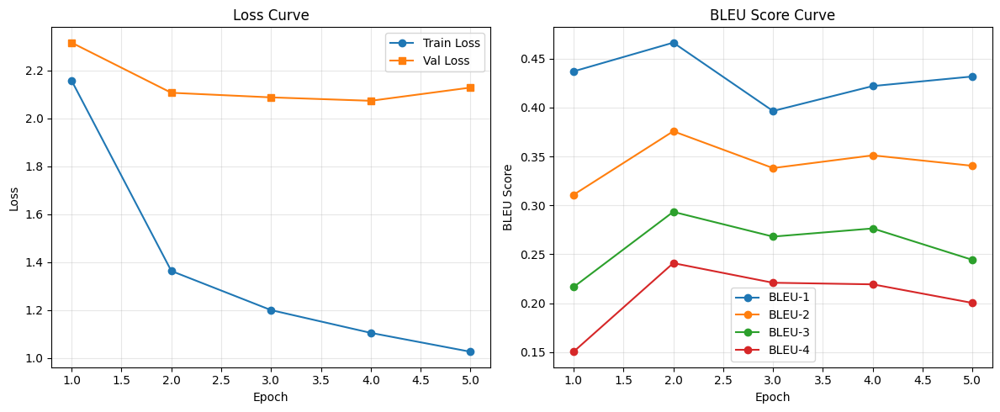

2025-08-01 13:32:05,970 - INFO - 📊 Training curves saved to: /content/drive/MyDrive/RSICD_PROJECT/outputs/blip1/blip1_rsicd_original_lr5e7_v2/training_curves.png


In [ ]:

# Loss + BLEU Score Evaluation

def plot_training_curves(history):
    """Create training curves with error handling"""
    try:
        import matplotlib.pyplot as plt
        epochs = history['epochs']

        if not epochs:
            log_and_print(" No epoch data to plot")
            return

        plt.figure(figsize=(12, 5))

        # Loss Curve
        plt.subplot(1, 2, 1)
        if history['train_loss'] and history['val_loss']:
            plt.plot(epochs, history['train_loss'], label="Train Loss", marker='o')
            plt.plot(epochs, history['val_loss'], label="Val Loss", marker='s')
            plt.xlabel("Epoch")
            plt.ylabel("Loss")
            plt.title("Loss Curve")
            plt.legend()
            plt.grid(True, alpha=0.3)

        # BLEU Curve
        plt.subplot(1, 2, 2)
        if any(history[k] for k in ['bleu1', 'bleu2', 'bleu3', 'bleu4']):
            for bleu_key, label in [('bleu1', 'BLEU-1'), ('bleu2', 'BLEU-2'),
                                   ('bleu3', 'BLEU-3'), ('bleu4', 'BLEU-4')]:
                if history[bleu_key]:
                    plt.plot(epochs, history[bleu_key], label=label, marker='o')
            plt.xlabel("Epoch")
            plt.ylabel("BLEU Score")
            plt.title("BLEU Score Curve")
            plt.legend()
            plt.grid(True, alpha=0.3)

        plt.tight_layout()
        plot_path = OUTPUT_DIR / "training_curves.png"
        plt.savefig(plot_path, dpi=300, bbox_inches='tight')
        plt.show()
        log_and_print(f" Training curves saved to: {plot_path}")

    except Exception as e:
        log_and_print(f" Failed to create training curves: {e}")

# Plot Curves
plot_training_curves(history)


####  Blip Base Plot Curves & Accuracy Curve
The validation loss definitely decreases more rapidly than LAM or VitGpt2 indicating better generalization on the unsseen data.

In [ ]:

# Paths
MODEL_DIR = OUTPUT_DIR / "best_model"

# Load model & processor
processor = BlipProcessor.from_pretrained(MODEL_DIR)
model = BlipForConditionalGeneration.from_pretrained(MODEL_DIR).to(device).eval()

TEST_JSON = PROJECT_DIR / 'data/processed/captions_test2017.json'
IMAGE_DIR = PROJECT_DIR / 'data/raw/images'

# NEW FILENAMES FOR BEAM SEARCH
OUT_COCO = OUTPUT_DIR / "generated_captions_formatted_beam5.json"
OUT_DEBUG = OUTPUT_DIR / "generated_captions_debug_beam5.json"

  Preparing metadata (setup.py) ... done


In [ ]:
#Load test metadata
with open(TEST_JSON) as f:
    test_data = json.load(f)

id_to_file = {img["id"]: img["file_name"] for img in test_data["images"]}

annotations = {}
for ann in test_data["annotations"]:
    annotations.setdefault(ann["image_id"], []).append(ann["caption"])

debug_results = []
coco_results = []

# Generate captions with beam search
for image_id, file_name in tqdm(id_to_file.items(), desc="Generating captions with beam search"):
    img = Image.open(os.path.join(IMAGE_DIR, file_name)).convert("RGB")
    inputs = processor(images=img, return_tensors="pt").to("cuda")

    with torch.no_grad():
        out = model.generate(
            **inputs,
            max_new_tokens=30,
            num_beams=5,
            early_stopping=True,
            no_repeat_ngram_size=3
        )
        caption = processor.decode(out[0], skip_special_tokens=True)

    # Append to both outputs
    debug_results.append({
        "image_id": image_id,
        "file_name": file_name,
        "generated": caption,
        "ground_truth": annotations.get(image_id, [])
    })

    coco_results.append({
        "image_id": image_id,
        "caption": caption
    })

# === Save outputs ===
with open(OUT_DEBUG, "w") as f:
    json.dump(debug_results, f, indent=2)

with open(OUT_COCO, "w") as f:
    json.dump(coco_results, f, indent=2)

print(" Done! Saved:")
print(f"  - COCO format: {OUT_COCO}")
print(f"  - Full debug : {OUT_DEBUG}")

# === Evaluate ===
coco = COCO(TEST_JSON)
coco_res = coco.loadRes(str(OUT_COCO))

coco_eval = COCOEvalCap(coco, coco_res)
coco_eval.evaluate()

# Display nicely formatted metrics
metrics = coco_eval.eval
print("\n Evaluation Metrics:")
print("|   Model  | BLEU-1 | BLEU-2 | BLEU-3 | BLEU-4 | METEOR | ROUGE_L | CIDEr  | SPICE  |")
print("|----------|--------|--------|--------|--------|--------|---------|--------|--------|")
print(f"|  BLIP-1  | {metrics['Bleu_1']:.4f} | {metrics['Bleu_2']:.4f} | {metrics['Bleu_3']:.4f} | {metrics['Bleu_4']:.4f} | {metrics['METEOR']:.4f} |  {metrics['ROUGE_L']:.4f} | {metrics['CIDEr']:.4f} | {metrics['SPICE']:.4f} |")

  Preparing metadata (setup.py) ... done


Generating captions with beam search: 100%|██████████| 1093/1093 [05:59<00:00,  3.04it/s]


✅ Done! Saved:
  - COCO format: /content/drive/MyDrive/RSICD_PROJECT/outputs/blip1/blip1_rsicd_original_lr5e7_v2/generated_captions_formatted_beam5.json
  - Full debug : /content/drive/MyDrive/RSICD_PROJECT/outputs/blip1/blip1_rsicd_original_lr5e7_v2/generated_captions_debug_beam5.json
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
tokenization...
setting up scorers...
Progress: 384.5M / 384.5M (100.0%)
Extracting stanford-corenlp-3.6.0 ...
Done.
computing Bleu score...
{'testlen': 11779, 'reflen': 11829, 'guess': [11779, 10686, 9593, 8500], 'correct': [8294, 4239, 2253, 1288]}
ratio: 0.9957731000083696
Bleu_1: 0.701
Bleu_2: 0.526
Bleu_3: 0.402
Bleu_4: 0.314
computing METEOR score...
METEOR: 0.275
computing Rouge score...
ROUGE_L: 0.491
computing CIDEr score...
CIDEr: 0.693
computing SPICE score...
SPICE: 0.268

📊 Evaluation Metrics:
|   Model  | BLEU-1 | BLEU-2 | BLEU-3

 Evaluation COCO-style captioning metrics:

| Metric      | Description                                        |
|-------------|----------------------------------------------------|
| **BLEU-1/2/3/4** | Measures n-gram overlap with ground truth     |
| **METEOR**   | Precision/recall-based with synonym matching      |
| **ROUGE-L**  | Longest common subsequence (structure-sensitive)  |
| **CIDEr**    | Consensus-based metric that rewards consensus     |
| **SPICE**    | *(Optional)* Captures semantic scene graphs       |



Blip1 Base Result:

|   Model  | BLEU-1 | BLEU-2 | BLEU-3 | BLEU-4 | METEOR | ROUGE_L | CIDEr  | SPICE  |
|----------|--------|--------|--------|--------|--------|---------|--------|--------|
|  BLIP-1  | 0.7012 | 0.5263 | 0.4016 | 0.3144 | 0.2751 |  0.4908 | 0.6930 | 0.2679 |

#### Blip1 Results
***Metrics for Blip1 computed above ^^***

In [ ]:
#
#  Evaluate Caption on a Single RSICD Image
#


#  Global path to prediction JSON (adjust if needed) ===
MODEL_NAME = "Blip1"
test_dataset = RSICDDataset(TEST_JSON, IMAGE_DIR, processor, split='test')
gt_json = TEST_JSON
pred_json = OUT_COCO

def show_specific_example_with_metric(image_filename, dataset, model, processor):
    model.eval()
    device = next(model.parameters()).device

    # Find dataset index
    index = None
    for i, img_id in enumerate(dataset.image_ids):
        if dataset.id_to_filename[img_id] == image_filename:
            index = i
            break
    if index is None:
        print(f"Image {image_filename} not found in dataset.")
        return

    # Load input
    sample = dataset[index]
    pixel_values = sample['pixel_values']
    reference_captions = sample['all_captions']

    image_path = os.path.join(dataset.image_dir, image_filename)
    original_image = Image.open(image_path).convert("RGB")
    pixel_values_batch = pixel_values.unsqueeze(0).to(device)

    with torch.no_grad():
        # Option 1 Greedy
        output_ids = model.generate(
            pixel_values_batch,
            max_length=30,
            num_beams=1
            )



        generated_caption = processor.decode(output_ids[0], skip_special_tokens=True)

    # Tokenize
    gen_tokens = re.findall(r"\b\w+\b", generated_caption.lower())
    ref_tokens_all = []
    for caption in reference_captions:
        ref_tokens_all += re.findall(r"\b\w+\b", caption.lower())
    ref_word_set = set(ref_tokens_all)

    # BLEU-n highlight
    def get_ngrams(tokens, n):
        return set(tuple(tokens[i:i+n]) for i in range(len(tokens)-n+1))

    def bleu_n_highlight(gen_tokens, ref_tokens, n, color):
        gen_ngrams = get_ngrams(gen_tokens, n)
        ref_ngrams = get_ngrams(ref_tokens, n)
        matches = gen_ngrams & ref_ngrams
        result = []
        i = 0
        while i < len(gen_tokens):
            ngram = tuple(gen_tokens[i:i+n])
            if len(ngram) == n and ngram in matches:
                result.append(f"<span style='color:{color}'>{' '.join(ngram)}</span>")
                i += n
            else:
                result.append(gen_tokens[i])
                i += 1
        return ' '.join(result)

    bleu1_html = ' '.join([f"<span style='color:blue'>{w}</span>" if w in ref_word_set else w for w in gen_tokens])
    bleu2_html = bleu_n_highlight(gen_tokens, ref_tokens_all, 2, "blue")
    bleu3_html = bleu_n_highlight(gen_tokens, ref_tokens_all, 3, "blue")
    bleu4_html = bleu_n_highlight(gen_tokens, ref_tokens_all, 4, "blue")

    # ROUGE-L
    def lcs(a, b):
        sm = SequenceMatcher(None, a, b)
        return [a[i] for i, j, n in sm.get_matching_blocks() if n > 0 for i in range(i, i + n)]

    best_lcs = []
    best_caption_idx = -1
    for idx, caption in enumerate(reference_captions):
        ref = re.findall(r"\b\w+\b", caption.lower())
        lcs_seq = lcs(gen_tokens, ref)
        if len(lcs_seq) > len(best_lcs):
            best_lcs = lcs_seq
            best_caption_idx = idx

    best_lcs_set = set(best_lcs)
    rouge_gen_html = ' '.join([
        f"<span style='color:green'><b>{w}</b></span>" if w in best_lcs_set else w
        for w in gen_tokens
    ])


    # Display Section

    plt.figure(figsize=(5, 5))
    plt.imshow(original_image)
    plt.title("Generated Caption", fontsize=10)
    plt.axis('off')
    plt.show()

    print(f"\n Image: {image_filename}\n")
    print(" Ground Truth Captions:\n")
    gt_lines = []
    for j, ref in enumerate(reference_captions):
        if j == best_caption_idx:
            ref_words = ref.split()
            highlighted = ' '.join(
                f"<span style='color:green'><b>{w}</b></span>" if w.lower() in best_lcs_set else w
                for w in ref_words
            )

            line = f"<b>{j+1}.</b> {highlighted}"
        else:
            line = f"<b>{j+1}.</b> {ref}"
        gt_lines.append(f"<div style='margin-left: 20px'>{line}</div>")
    display(HTML("".join(gt_lines)))

    print("\n Generated Caption (highlighted):")
    for label, html_caption in [
        ("BLEU1", bleu1_html),
        ("BLEU2", bleu2_html),
        ("BLEU3", bleu3_html),
        ("BLEU4", bleu4_html),
        ("ROUGE-L", rouge_gen_html),
    ]:
        display(HTML(f"<div style='margin-left: 20px'><b>{label}:</b> {html_caption}</div>"))


2025-08-02 18:20:30,374 - INFO - Loaded 5465 samples for test


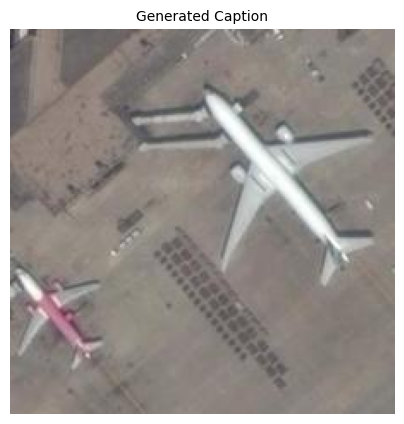


🖼️ Image: 00493.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


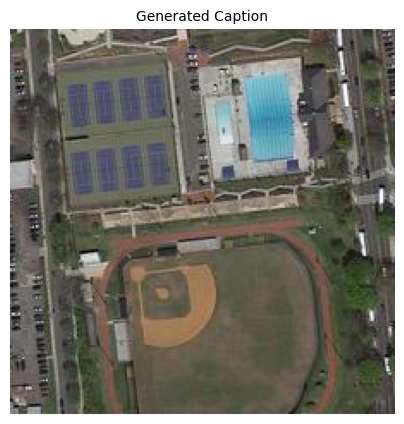


🖼️ Image: 00834.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


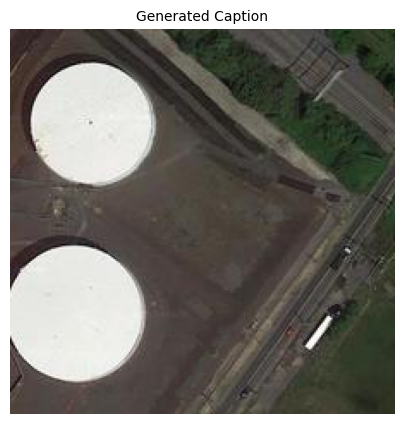


🖼️ Image: 00867.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


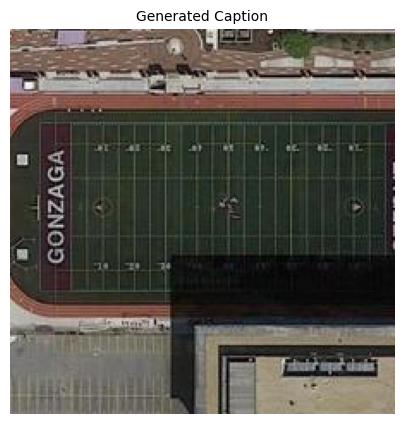


🖼️ Image: 00846.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


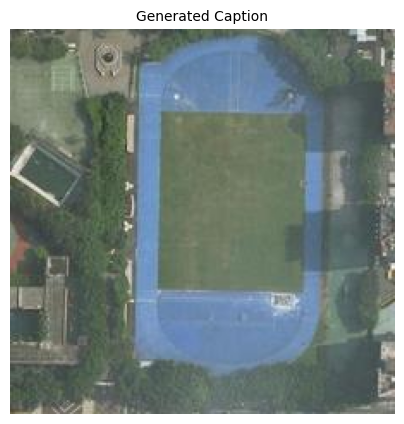


🖼️ Image: 00424.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


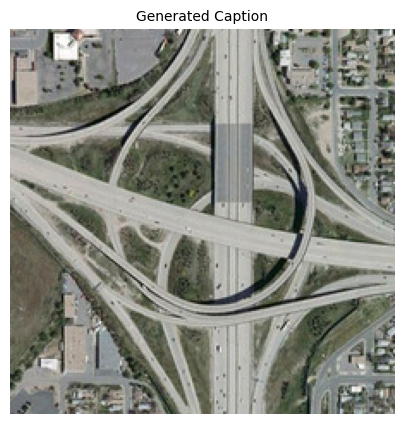


🖼️ Image: viaduct_328.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


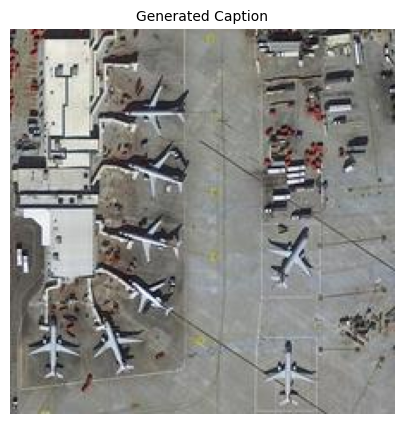


🖼️ Image: 00695.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


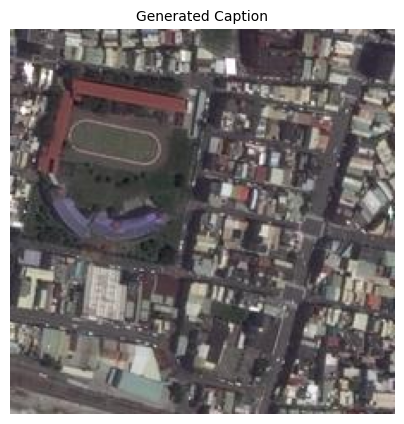


🖼️ Image: 00407.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


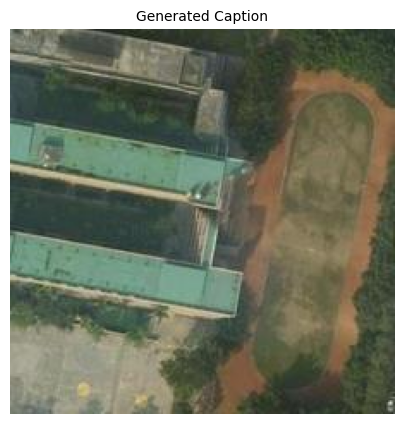


🖼️ Image: 00373.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


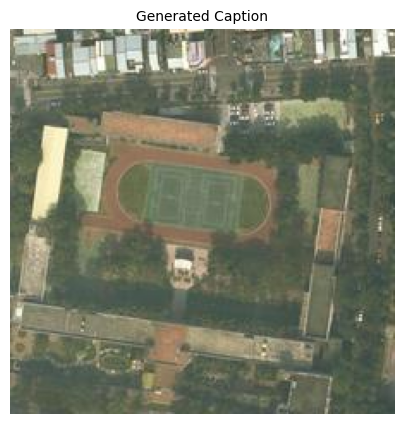


🖼️ Image: 00348.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


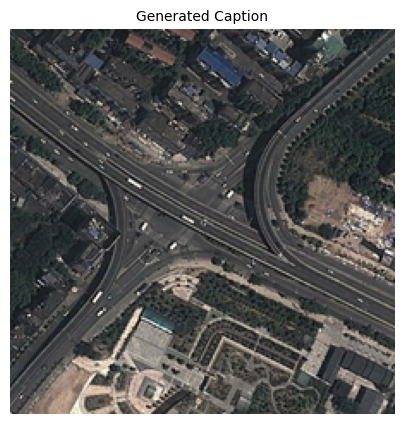


🖼️ Image: viaduct_329.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


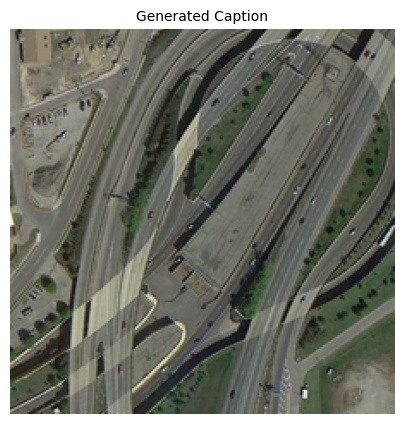


🖼️ Image: viaduct_351.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


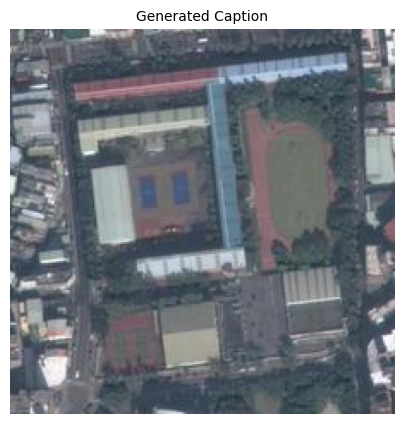


🖼️ Image: 00101.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


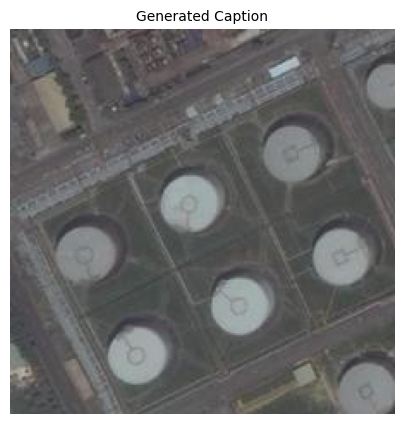


🖼️ Image: 00136.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


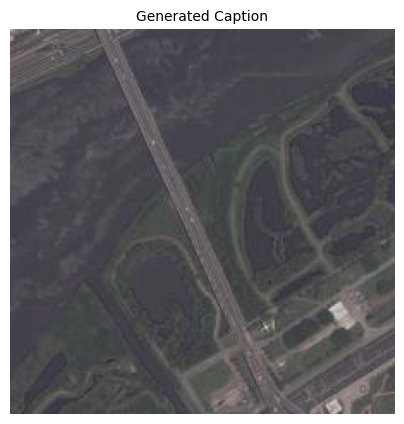


🖼️ Image: 00268.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


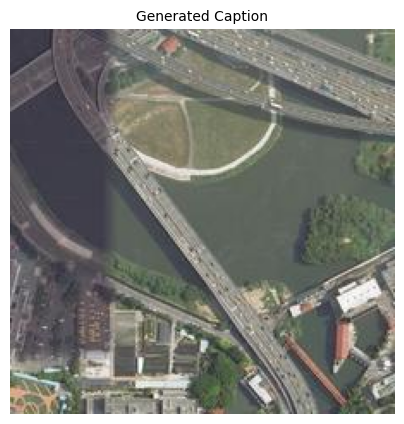


🖼️ Image: 00284.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


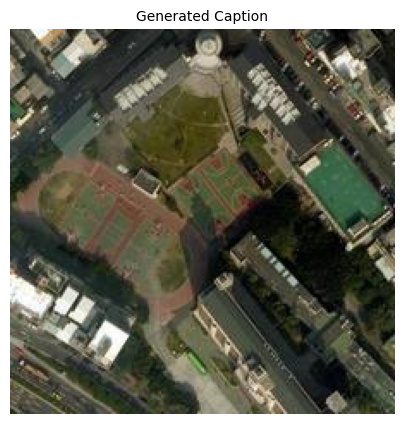


🖼️ Image: 00317.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


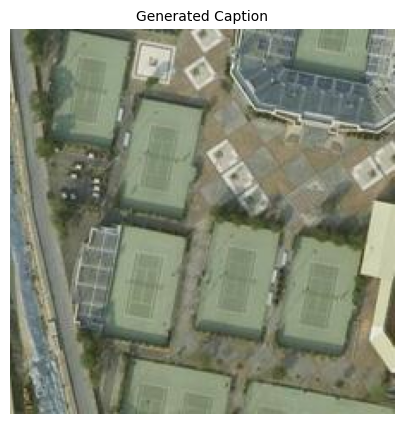


🖼️ Image: 00367.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


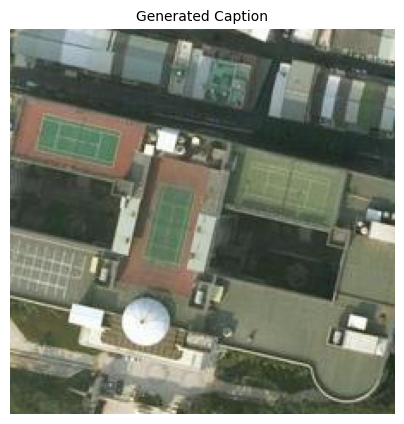


🖼️ Image: 00377.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


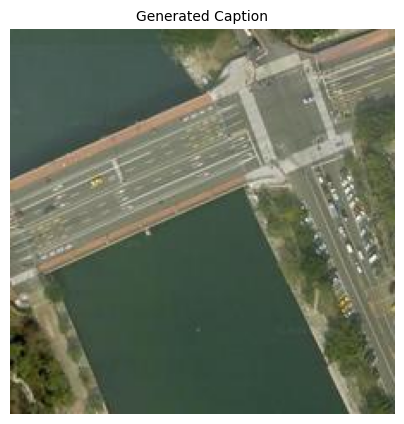


🖼️ Image: 00321.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


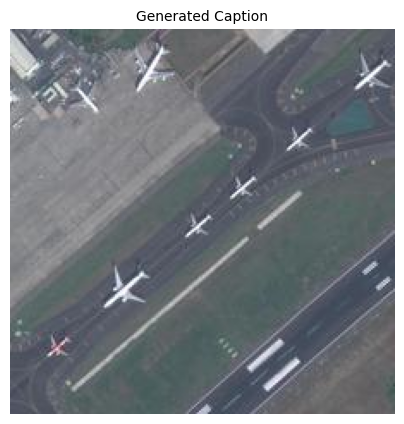


🖼️ Image: 00498.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


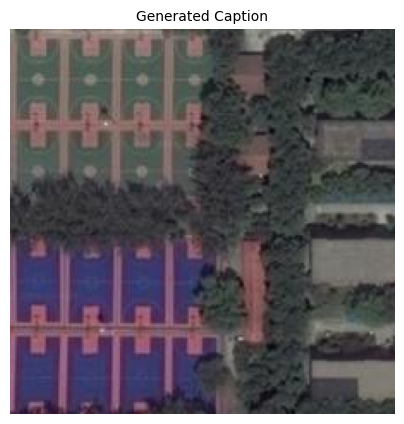


🖼️ Image: 00559.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


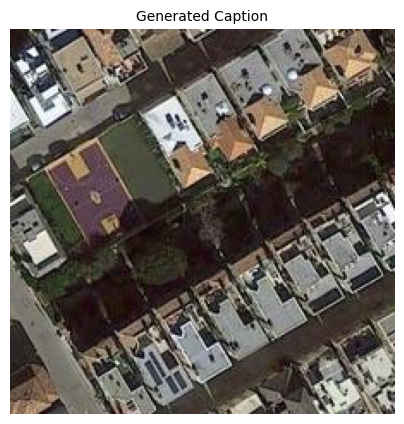


🖼️ Image: 00705.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


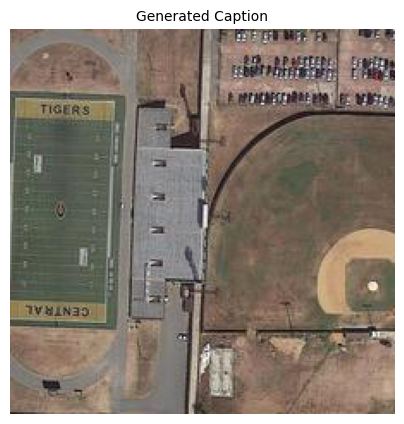


🖼️ Image: 00731.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


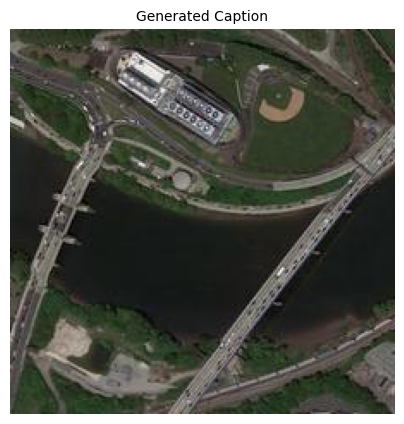


🖼️ Image: 00876.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


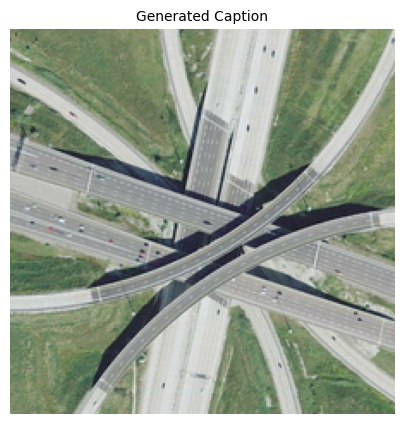


🖼️ Image: viaduct_364.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


In [ ]:
image_filenames = [
    "00493.jpg", "00834.jpg", "00867.jpg", "00846.jpg", "00424.jpg", "viaduct_328.jpg",

    "00695.jpg", "00407.jpg", "00373.jpg", "00348.jpg", "viaduct_329.jpg", "viaduct_351.jpg",
    "00101.jpg", "00136.jpg", "00268.jpg", "00284.jpg", "00317.jpg", "00367.jpg",
    "00377.jpg", "00321.jpg", "00498.jpg", "00559.jpg", "00705.jpg", "00731.jpg", "00876.jpg",
    "viaduct_364.jpg",
]
for fname in image_filenames:
    show_specific_example_with_metric(fname, test_dataset, model, processor)


####  Blip1 Base Data Augmentation

- We are conducting an ablation test to determine if adding 2 extra variants of augmented images will lead to improved results.
- The strategy used for image augmentation is shown below; the objective is to generate two additional images for each original.
- For captions, we are applying a rare captions priority approach:
  - First, deduplicate captions.
  - Sentences are ordered based on the rarity of words, and if there are fewer than 5 captions, we pad them until we have 5 captions.
- Total: (8,736 images × 5 captions = 43,680 caption–image pairs) × 3 = 131,040 image–caption pairs.

**Image Augmentation**

```python
variant1_transform = transforms.Compose([
    AxialRotateTransform(),
    FixedColorTransform(brightness=1.2, contrast=1.0, saturation=1.5, hue=0.0),
    RandomSharpness(min_factor=1.0, max_factor=2.0),
    AdjustLevelsTransform(black_level=0/255, white_level=240/255),
    transforms.Resize((384, 384)),
    transforms.ToTensor()
])

variant2_transform = transforms.Compose([
    transforms.RandomHorizontalFlip(p=1.0),
    transforms.RandomResizedCrop(384, scale=(0.95, 1.0), ratio=(0.95, 1.05)),
    FixedColorTransform(brightness=1.0, contrast=1.2, saturation=1.1, hue=0.05),
    AdjustSharpnessTransform(sharpness_factor=3.5),
    AdjustLevelsTransform(black_level=10/255, white_level=210/255),
    transforms.Resize(384),
    transforms.ToTensor()
])


In [ ]:
#!/usr/bin/env python3

"""
RSICD Dataset Augmentation Script for Google Colab
Generates 2 augmented variants per training image with de-duplicated captions
(8,736 images x 5 captions = 43,680 caption-image pairs) * 3 = 131040 image caption pairs
"""



# Set random seeds for reproducibility
random.seed(42)
np.random.seed(42)
torch.manual_seed(42)


# Configuration


# Original data paths
original_data_args = {
    'train_json': PROJECT_DIR / 'data/processed/captions_train2017.json',
    'image_dir': PROJECT_DIR / 'data/raw/images',
}

# Augmented data paths
augmented_data_args = {
    'train_json': PROJECT_DIR / 'data/augmentation_v1/captions_train_augmented.json',
    'image_dir': PROJECT_DIR / 'data/augmentation_v1/images',
}

# Define Augmentation Variants




class FixedColorTransform:
    def __init__(self, brightness=1.0, contrast=1.0, saturation=1.0, hue=0.0):
        self.brightness = brightness
        self.contrast = contrast
        self.saturation = saturation
        self.hue = hue
# 20% brighter (brightness=1.2)
    def __call__(self, img):

        img = adjust_brightness(img, self.brightness)
        img = adjust_contrast(img, self.contrast)
        img = adjust_saturation(img, self.saturation)
        img = adjust_hue(img, self.hue)
        return img

class AdjustSharpnessTransform:
    def __init__(self, sharpness_factor=2.0):
        self.factor = sharpness_factor  # >1.0 sharpens, <1.0 blurs

    def __call__(self, img):
        return ImageEnhance.Sharpness(img).enhance(self.factor)

class RandomSharpness:
    """Applies random sharpening in a mild, safe range."""
    def __init__(self, min_factor=1.0, max_factor=2.0):
        self.min = min_factor
        self.max = max_factor

    def __call__(self, img):
        factor = random.uniform(self.min, self.max)
        return ImageEnhance.Sharpness(img).enhance(factor)

class AdjustLevelsTransform:
    """Photoshop-style levels adjustment (black/white point clipping)."""
    def __init__(self, black_level=40/255, white_level=210/255):
        self.black = black_level
        self.white = white_level

    def __call__(self, img):
        img_tensor = TF.to_tensor(img)
        img_tensor = (img_tensor - self.black) / (self.white - self.black)
        img_tensor = torch.clamp(img_tensor, 0.0, 1.0)
        return TF.to_pil_image(img_tensor)


class Safe45Rotate:
    """Rotate 45° safely with expand=True and padded background fill."""
    def __call__(self, img):
        fill_color = tuple([int(c * 255) for c in TF.to_tensor(img).mean(dim=(1, 2))])
        return TF.rotate(img, angle=45, interpolation=TF.InterpolationMode.BILINEAR, expand=True, fill=fill_color)

class AxialRotateTransform:
    """Rotates 90 or 270 degrees randomly (true axial rotation)."""
    def __call__(self, img):
        angle = random.choice([90, 270])
        return TF.rotate(img, angle, interpolation=InterpolationMode.BILINEAR)



#option 1
variant1_transform = transforms.Compose([
    AxialRotateTransform(),
    FixedColorTransform(brightness=1.2, contrast=1.0, saturation=1.5, hue=0.0),
    RandomSharpness(min_factor=1.0, max_factor=2.0),
    AdjustLevelsTransform(black_level=0/255, white_level=240/255),
    transforms.Resize((384, 384)),
    transforms.ToTensor()
])

variant2_transform = transforms.Compose([
    transforms.RandomHorizontalFlip(p=1.0),
    transforms.RandomResizedCrop(384, scale=(0.95, 1.0), ratio=(0.95, 1.05)),
    FixedColorTransform(brightness=1.0, contrast=1.2, saturation=1.1, hue=0.05),
    AdjustSharpnessTransform(sharpness_factor=3.5),
    AdjustLevelsTransform(black_level=10/255, white_level=210/255),
    transforms.Resize(384),
    transforms.ToTensor()
])


# Helper Functions


def create_directories():
    """Create necessary directories for augmented dataset"""
    augmented_dir = Path(augmented_data_args['image_dir'])
    augmented_dir.mkdir(parents=True, exist_ok=True)
    print(f" Created directory: {augmented_dir}")

    # Create parent directory for JSON
    json_dir = Path(augmented_data_args['train_json']).parent
    json_dir.mkdir(parents=True, exist_ok=True)
    print(f" Created directory: {json_dir}")



# Caption Redordering based on TFIDF


from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np

def deduplicate_and_pad_captions(captions, target_count=5):
    """
    De-duplicate captions, score them, place the most descriptive first,
    and pad to target count if needed.
    """

    # Remove duplicates while preserving order
    seen = set()
    unique_captions = []
    for caption in captions:
        if caption not in seen:
            seen.add(caption)
            unique_captions.append(caption)

    # Score unique captions using a basic TF-IDF vectorizer
    if len(unique_captions) > 1:
        tfidf = TfidfVectorizer()
        tfidf_matrix = tfidf.fit_transform(unique_captions)
        rarity_scores = tfidf_matrix.sum(axis=1).A1  # Sum of TF-IDF scores per sentence
        best_idx = int(np.argmax(rarity_scores))
        best_caption = unique_captions[best_idx]

        # Move best caption to the front
        unique_captions.pop(best_idx)
        unique_captions = [best_caption] + unique_captions

    # Pad if necessary (cyclic repeat)
    while len(unique_captions) < target_count:
        unique_captions.append(unique_captions[len(unique_captions) % len(unique_captions)])

    return unique_captions[:target_count]


# Create Original + 2 Variants


def process_and_save_image(image_path, output_path, transform):
    """Apply transformation and save image"""
    try:
        # Open image
        img = Image.open(image_path).convert('RGB')

        # Apply transformation
        img_transformed = transform(img)

        # Convert back to PIL if tensor
        if isinstance(img_transformed, torch.Tensor):
            # Convert tensor to PIL
            img_transformed = transforms.ToPILImage()(img_transformed)

        # Save image
        img_transformed.save(output_path, quality=95)
        return True
    except Exception as e:
        print(f"Error processing {image_path}: {e}")
        return False

def generate_augmented_dataset():
    """Main function to generate augmented dataset"""

    print("="*60)
    print("RSICD DATASET AUGMENTATION")
    print("="*60)

    # Create directories
    create_directories()

    # Load original training JSON
    print(f"\nLoading original training data from: {original_data_args['train_json']}")
    with open(original_data_args['train_json'], 'r') as f:
        original_data = json.load(f)

    print(f" Loaded {len(original_data['images'])} images")
    print(f" Loaded {len(original_data['annotations'])} annotations")

    # Initialize new augmented data structure
    augmented_data = {
        "images": [],
        "annotations": [],
        "info": {
            "description": "RSICD Augmented Training Set (Original + 2 Variants)",
            "version": "1.0",
            "year": 2025,
            "contributor": "RSICD Dataset - Augmented",
            "date_created": str(Path(original_data_args['train_json']).stat().st_mtime)
        },
        "licenses": original_data.get("licenses", [])
    }

    # Create mapping of image_id to captions
    image_id_to_captions = {}
    for ann in original_data['annotations']:
        if ann['image_id'] not in image_id_to_captions:
            image_id_to_captions[ann['image_id']] = []
        image_id_to_captions[ann['image_id']].append(ann['caption'])

    # Process counters
    total_images = len(original_data['images'])
    processed_images = 0
    new_annotation_id = 0

    print(f"\nProcessing {total_images} images (generating 3 versions each)...")
    print("This will create {total_images * 3} = {total_images * 3} total images")

    # Process each image
    for img_data in tqdm(original_data['images'], desc="Processing images"):
        image_id = img_data['id']
        original_filename = img_data['file_name']
        original_path = Path(original_data_args['image_dir']) / original_filename

        if not original_path.exists():
            print(f"Warning: Image not found: {original_path}")
            continue

        # Get captions for this image
        captions = image_id_to_captions.get(image_id, [])
        if not captions:
            print(f"Warning: No captions found for image {image_id}")
            continue

        # Process original captions
        original_captions = captions

        # Process augmented captions (de-duplicate and pad)
        augmented_captions = deduplicate_and_pad_captions(captions)

        # === 1. Copy Original Image ===
        original_output_path = Path(augmented_data_args['image_dir']) / original_filename
        try:
            # shutil.copy2(original_path, original_output_path)
            img = Image.open(original_path).convert("RGB")
            img_resized = transforms.Resize((384, 384))(img)
            img_resized.save(original_output_path, quality=95)

            # Add original image entry
            augmented_data['images'].append({
                "id": image_id,
                "file_name": original_filename,
                "width": 384,
                "height": 384,
                "license": img_data.get('license', 1),
                "date_captured": img_data.get('date_captured', "")
            })

            # Add original annotations (unchanged)
            for caption in original_captions:
                augmented_data['annotations'].append({
                    "id": new_annotation_id,
                    "image_id": image_id,
                    "caption": caption
                })
                new_annotation_id += 1

        except Exception as e:
            print(f"Error copying original image {original_filename}: {e}")
            continue

        #2. Generate Variant 1
        variant1_filename = original_filename.rsplit('.', 1)[0] + '_v1.' + original_filename.rsplit('.', 1)[1]
        variant1_output_path = Path(augmented_data_args['image_dir']) / variant1_filename
        variant1_image_id = int(str(image_id) + "001")

        if process_and_save_image(original_path, variant1_output_path, variant1_transform):
            # Add variant 1 image entry
            augmented_data['images'].append({
                "id": variant1_image_id,
                "file_name": variant1_filename,
                "width": 384,
                "height": 384,
                "license": img_data.get('license', 1),
                "date_captured": img_data.get('date_captured', "")
            })

            # Add variant 1 annotations (de-duplicated)
            for caption in augmented_captions:
                augmented_data['annotations'].append({
                    "id": new_annotation_id,
                    "image_id": variant1_image_id,
                    "caption": caption
                })
                new_annotation_id += 1

        # === 3. Generate Variant 2 ===
        variant2_filename = original_filename.rsplit('.', 1)[0] + '_v2.' + original_filename.rsplit('.', 1)[1]
        variant2_output_path = Path(augmented_data_args['image_dir']) / variant2_filename
        variant2_image_id = int(str(image_id) + "002")

        if process_and_save_image(original_path, variant2_output_path, variant2_transform):
            # Add variant 2 image entry
            augmented_data['images'].append({
                "id": variant2_image_id,
                "file_name": variant2_filename,
                "width": 384,
                "height": 384,
                "license": img_data.get('license', 1),
                "date_captured": img_data.get('date_captured', "")
            })

            # Add variant 2 annotations (de-duplicated)
            for caption in augmented_captions:
                augmented_data['annotations'].append({
                    "id": new_annotation_id,
                    "image_id": variant2_image_id,
                    "caption": caption
                })
                new_annotation_id += 1

        processed_images += 1

    # Save augmented JSON
    print(f"\nSaving augmented dataset JSON to: {augmented_data_args['train_json']}")
    with open(augmented_data_args['train_json'], 'w') as f:
        json.dump(augmented_data, f, indent=2)

    # ===== MINIMAL FIX: Copy validation and test data =====
    print("\nCopying validation and test data...")

    # Copy validation JSON
    val_json_src = original_data_args['train_json'].parent / 'captions_val2017.json'
    val_json_dst = Path(augmented_data_args['train_json']).parent / 'captions_val2017.json'
    if val_json_src.exists():
        shutil.copy2(val_json_src, val_json_dst)
        print(f" Copied validation JSON")

        # Copy validation images
        with open(val_json_src, 'r') as f:
            val_data = json.load(f)

        val_copied = 0
        for img_data in val_data['images']:
            src = Path(original_data_args['image_dir']) / img_data['file_name']
            dst = Path(augmented_data_args['image_dir']) / img_data['file_name']
            if src.exists() and not dst.exists():
                shutil.copy2(src, dst)
                val_copied += 1
        print(f" Copied {val_copied} validation images")

    # Copy test JSON
    test_json_src = original_data_args['train_json'].parent / 'captions_test2017.json'
    test_json_dst = Path(augmented_data_args['train_json']).parent / 'captions_test2017.json'
    if test_json_src.exists():
        shutil.copy2(test_json_src, test_json_dst)
        print(f" Copied test JSON")

        # Copy test images
        with open(test_json_src, 'r') as f:
            test_data = json.load(f)

        test_copied = 0
        for img_data in test_data['images']:
            src = Path(original_data_args['image_dir']) / img_data['file_name']
            dst = Path(augmented_data_args['image_dir']) / img_data['file_name']
            if src.exists() and not dst.exists():
                shutil.copy2(src, dst)
                test_copied += 1
        print(f" Copied {test_copied} test images")
    # ===== END OF FIX =====

    # Print summary
    print("\n" + "="*60)
    print("AUGMENTATION COMPLETE!")
    print("="*60)
    print(f" Total images created: {len(augmented_data['images'])}")
    print(f"  - Original images: {processed_images}")
    print(f"  - Variant 1 images: ~{processed_images}")
    print(f"  - Variant 2 images: ~{processed_images}")
    print(f" Total annotations: {len(augmented_data['annotations'])}")
    print(f" Expected image-caption pairs: {len(augmented_data['images']) * 5}")
    print(f" Images saved to: {augmented_data_args['image_dir']}")
    print(f" JSON saved to: {augmented_data_args['train_json']}")

    # Verify counts
    unique_images = len(set(img['file_name'] for img in augmented_data['images']))
    print(f"\n Unique image files: {unique_images}")

    # Show sample of de-duplicated captions
    print("\n Sample caption de-duplication:")
    sample_img_id = original_data['images'][0]['id'] if original_data['images'] else None
    if sample_img_id and sample_img_id in image_id_to_captions:
        original_caps = image_id_to_captions[sample_img_id]
        dedup_caps = deduplicate_and_pad_captions(original_caps)
        print(f"Original ({len(original_caps)}): {original_caps}")
        print(f"De-duplicated & padded (5): {dedup_caps}")

# Main Execution


if __name__ == "__main__":
    # Check if original data exists
    if not Path(original_data_args['train_json']).exists():
        print(f" Error: Original training JSON not found at {original_data_args['train_json']}")
        print("Please ensure your data is in the correct location.")
    elif not Path(original_data_args['image_dir']).exists():
        print(f" Error: Original image directory not found at {original_data_args['image_dir']}")
        print("Please ensure your images are in the correct location.")
    else:
        # Run augmentation
        generate_augmented_dataset()

        print("\n Augmentation complete! You can now use the augmented dataset for training.")
        print("\nTo use in your training script, update your paths to:")
        print(f"  train_json: '{augmented_data_args['train_json']}'")
        print(f"  image_dir: '{augmented_data_args['image_dir']}'")

RSICD DATASET AUGMENTATION
✓ Created directory: /content/drive/MyDrive/RSICD_PROJECT/data/augmentation_v1/images
✓ Created directory: /content/drive/MyDrive/RSICD_PROJECT/data/augmentation_v1

Loading original training data from: /content/drive/MyDrive/RSICD_PROJECT/data/processed/captions_train2017.json
✓ Loaded 8736 images
✓ Loaded 43680 annotations

Processing 8736 images (generating 3 versions each)...
This will create {total_images * 3} = {total_images * 3} total images


Processing images: 100%|██████████| 8736/8736 [10:53<00:00, 13.38it/s]



Saving augmented dataset JSON to: /content/drive/MyDrive/RSICD_PROJECT/data/augmentation_v1/captions_train_augmented.json

Copying validation and test data...
✓ Copied validation JSON
✓ Copied 1092 validation images
✓ Copied test JSON
✓ Copied 1093 test images

AUGMENTATION COMPLETE!
✓ Total images created: 26208
  - Original images: 8736
  - Variant 1 images: ~8736
  - Variant 2 images: ~8736
✓ Total annotations: 131040
✓ Expected image-caption pairs: 131040
✓ Images saved to: /content/drive/MyDrive/RSICD_PROJECT/data/augmentation_v1/images
✓ JSON saved to: /content/drive/MyDrive/RSICD_PROJECT/data/augmentation_v1/captions_train_augmented.json

✓ Unique image files: 26208

📝 Sample caption de-duplication:

🎉 Augmentation complete! You can now use the augmented dataset for training.

To use in your training script, update your paths to:
  train_json: '/content/drive/MyDrive/RSICD_PROJECT/data/augmentation_v1/captions_train_augmented.json'
  image_dir: '/content/drive/MyDrive/RSICD_PRO

In [ ]:

train_json_path = PROJECT_DIR / 'data/augmentation_v1/captions_train_augmented.json'
val_json_path = PROJECT_DIR / 'data/augmentation_v1/captions_val2017.json'
image_dir = PROJECT_DIR / 'data/augmentation_v1/images'

print(" VALIDATION DATASET DIAGNOSTIC")
print("="*60)

# 1. Load JSON files
print("\n Loading JSON files...")
with open(train_json_path, 'r') as f:
    train_data = json.load(f)
with open(val_json_path, 'r') as f:
    val_data = json.load(f)

print(f"Train images in JSON: {len(train_data['images'])}")
print(f"Val images in JSON: {len(val_data['images'])}")

# 2. Check sample file names from each JSON
print("\n Sample file names from JSONs:")
print("\nTRAIN JSON (first 5):")
for img in train_data['images'][:5]:
    print(f"  - {img['file_name']}")

print("\nVAL JSON (first 5):")
for img in val_data['images'][:5]:
    print(f"  - {img['file_name']}")

# 3. Check actual files in directory
print("\n Actual files in image directory:")
all_images = list(image_dir.glob("*.jpg")) + list(image_dir.glob("*.png"))
print(f"Total image files: {len(all_images)}")
print("Sample files (first 5):")
for img in all_images[:5]:
    print(f"  - {img.name}")

# 4. Check if validation images exist
print("\n Checking if validation images exist...")
missing_count = 0
found_count = 0

for i, img in enumerate(val_data['images'][:20]):  # Check first 20
    img_path = image_dir / img['file_name']
    if img_path.exists():
        found_count += 1
        if found_count <= 2:  # Show first 2 found
            print(f"   Found: {img['file_name']}")
    else:
        missing_count += 1
        if missing_count <= 5:  # Show first 5 missing
            print(f"   Missing: {img['file_name']}")

            # Try to find similar files
            base_name = img['file_name'].split('.')[0]
            similar = [f.name for f in all_images if base_name in f.name]
            if similar:
                print(f"     → Possible matches: {similar[:3]}")

print(f"\nSummary: {found_count} found, {missing_count} missing (out of 20 checked)")

# 5. Check naming patterns
print("\n Checking naming patterns...")
train_has_version = any('_v' in img['file_name'] for img in train_data['images'][:100])
val_has_version = any('_v' in img['file_name'] for img in val_data['images'][:100])

print(f"Train images have _v suffix: {train_has_version}")
print(f"Val images have _v suffix: {val_has_version}")

# 6. Show the issue
print("\n" + "="*60)
print(" DIAGNOSIS:")
if missing_count > 0 and not val_has_version and train_has_version:
    print(" PROBLEM FOUND: Validation JSON refers to original image names")
    print("   but your image folder contains augmented images with _v suffixes!")
    print("\n SOLUTION: You need to either:")
    print("   1. Update val JSON to use augmented image names (_v1, _v2, etc)")
    print("   2. Copy original validation images to the augmented folder")
    print("   3. Create a symlink/copy with original names pointing to _v1 versions")
elif missing_count > 0:
    print(" PROBLEM: Validation images are missing from the directory")
else:
    print(" Validation images appear to be present")

🔍 VALIDATION DATASET DIAGNOSTIC

1️⃣ Loading JSON files...
Train images in JSON: 26208
Val images in JSON: 1092

2️⃣ Sample file names from JSONs:

TRAIN JSON (first 5):
  - airport_1.jpg
  - airport_1_v1.jpg
  - airport_1_v2.jpg
  - airport_10.jpg
  - airport_10_v1.jpg

VAL JSON (first 5):
  - square_221.jpg
  - square_222.jpg
  - square_223.jpg
  - square_224.jpg
  - square_225.jpg

3️⃣ Actual files in image directory:
Total image files: 28393
Sample files (first 5):
  - airport_1.jpg
  - airport_1_v1.jpg
  - airport_1_v2.jpg
  - airport_10.jpg
  - airport_10_v1.jpg

4️⃣ Checking if validation images exist...
  ✅ Found: square_221.jpg
  ✅ Found: square_222.jpg

Summary: 20 found, 0 missing (out of 20 checked)

5️⃣ Checking naming patterns...
Train images have _v suffix: True
Val images have _v suffix: False

📊 DIAGNOSIS:
✅ Validation images appear to be present


In [ ]:
#Training 2



# Output directory for this experiment
OUTPUT_DIR = PROJECT_DIR / "outputs/blip1/blip1_rsicd_augmented_lr3e5_bs16_131kimages_v4"
OUTPUT_DIR.mkdir(parents=True, exist_ok=True)



training_args = {
    'train_json': str(DATA_ROOT / "augmentation_v1/captions_train_augmented.json"),
    'val_json': str(DATA_ROOT / "augmentation_v1/captions_val2017.json"),
    'test_json': str(DATA_ROOT / "augmentation_v1/captions_test2017.json"),
    'image_dir': str(DATA_ROOT / "augmentation_v1/images"),
    'model_name': 'Salesforce/blip-image-captioning-base',

    'output_dir': str(OUTPUT_DIR),

    # Option 1
    'batch_size': 6,
    'learning_rate': 5e-7,
    'weight_decay': 0.01,           # Added weight decay

    'label_smoothing': 0.0,         # Disable label smoothing
    'warmup_steps': 500,           # Disable warmup
    'gradient_clip': 1.0,           # Explicit gradient clipping value
    # 'gradient_accumulation_steps': 1, #this was never implemented

    'num_epochs': 5,
    'early_stopping_patience': 3,
    'resume': False,                 # Will resume if checkpoint is found
}

# Path verification
import os
from pathlib import Path

log_and_print("\n Verifying paths...")

# Check if files exist
for key in ['train_json', 'val_json', 'test_json']:
    path = Path(training_args[key])
    if path.exists():
        log_and_print(f" {key}: {path} EXISTS")
        with open(path) as f:
            import json
            data = json.load(f)
            log_and_print(f"   - Contains {len(data.get('images', []))} images")
    else:
        log_and_print(f" {key}: {path} NOT FOUND!")

# Check image directory
image_dir = Path(training_args['image_dir'])
if image_dir.exists():
    image_files = list(image_dir.glob("*.jpg")) + list(image_dir.glob("*.png"))
    log_and_print(f" Image dir: {image_dir} EXISTS")
    log_and_print(f"   - Contains {len(image_files)} images")

    # Sample a few images
    if image_files:
        log_and_print(f"   - Sample images: {[f.name for f in image_files[:3]]}")
else:
    log_and_print(f" Image dir: {image_dir} NOT FOUND!")

# Don't proceed if paths are wrong
if not all(Path(training_args[k]).exists() for k in ['train_json', 'val_json', 'image_dir']):
    raise ValueError("Path verification failed! Fix paths before training.")


2025-08-02 07:49:05,529 - INFO - 
🔍 Verifying paths...
2025-08-02 07:49:05,531 - INFO - ✅ train_json: /content/data_local/data/augmentation_v1/captions_train_augmented.json EXISTS
2025-08-02 07:49:05,700 - INFO -    - Contains 26208 images
2025-08-02 07:49:05,701 - INFO - ✅ val_json: /content/data_local/data/augmentation_v1/captions_val2017.json EXISTS
2025-08-02 07:49:05,723 - INFO -    - Contains 1092 images
2025-08-02 07:49:05,724 - INFO - ✅ test_json: /content/data_local/data/augmentation_v1/captions_test2017.json EXISTS
2025-08-02 07:49:05,731 - INFO -    - Contains 1093 images
2025-08-02 07:49:05,810 - INFO - ✅ Image dir: /content/data_local/data/augmentation_v1/images EXISTS
2025-08-02 07:49:05,811 - INFO -    - Contains 28393 images
2025-08-02 07:49:05,812 - INFO -    - Sample images: ['meadow_68.jpg', 'pond_384_v2.jpg', 'bareland_43_v1.jpg']


In [ ]:

# Main function - UPDATED with new hyperparameters

def main(args):
    """Main training function - UPDATED for augmented dataset"""
    # Initialize GradScaler for FP16
    scaler = torch.cuda.amp.GradScaler()


    # Setup
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    log_and_print(f"Using device: {device}")

    # Log configuration
    log_and_print("\n Training Configuration:")
    log_and_print(f"  Dataset: Augmented RSICD (3x original)")
    log_and_print(f"  Learning rate: {args['learning_rate']} (100x increase)")
    log_and_print(f"  Batch size: {args['batch_size']}")
    log_and_print(f"  Epochs: {args['num_epochs']}")
    log_and_print(f"  Weight decay: {args['weight_decay']}")
    log_and_print(f"  Label smoothing: {args['label_smoothing']}")
    log_and_print(f"  Warmup steps: {args['warmup_steps']}")
    log_and_print(f"  Gradient clipping: {args['gradient_clip']}")

    # STEP 1: Test pretrained model first
    if not test_pretrained_model(device):
        raise ValueError("Pretrained model test failed!")

    # Load model and processor
    log_and_print(f"\nLoading model: {args['model_name']}")
    processor = BlipProcessor.from_pretrained(args['model_name'])
    model = BlipForConditionalGeneration.from_pretrained(args['model_name'])
    if model.config.pad_token_id is None:
        model.config.pad_token_id = processor.tokenizer.pad_token_id
    assert model.config.pad_token_id is not None
    log_and_print(f" pad_token_id = {model.config.pad_token_id}")

    # Basic model setup
    model = model.to(device)

    # Train full model (encoder + decoder)
    log_and_print(" Training FULL model (encoder + decoder)")


    # Prepare resume logic BEFORE optimizer
    resume_path = OUTPUT_DIR / "checkpoints/last_checkpoint.pth"
    start_epoch = 0
    history = {
        'train_loss': [],
        'val_loss': [],
        'bleu1': [],
        'bleu2': [],
        'bleu3': [],
        'bleu4': [],
        'epochs': []
    }
    patience_counter = 0
    optimizer_state = None
    scheduler_state = None

    if resume_path.exists() and args.get('resume', False):
        log_and_print(f" Found checkpoint at {resume_path}, resuming...")
        checkpoint = torch.load(resume_path, map_location=device)
        model.load_state_dict(checkpoint['model_state'])
        optimizer_state = checkpoint['optimizer_state']
        scheduler_state = checkpoint['scheduler_state']
        history = checkpoint['history']
        start_epoch = checkpoint['epoch']
        patience_counter = checkpoint['patience_counter']
    else:
        if resume_path.exists():
            log_and_print(f" Found old checkpoint but starting fresh (different optimizer config)")
            # Rename old checkpoint to avoid confusion
            import shutil
            backup_path = OUTPUT_DIR / "checkpoints/old_last_checkpoint.pth"
            if resume_path.exists():
                shutil.move(str(resume_path), str(backup_path))
                log_and_print(f" Moved old checkpoint to: {backup_path}")

    # Dataset setup
    log_and_print("\n Loading augmented dataset...")
    train_dataset = RSICDDataset(args['train_json'], args['image_dir'], processor, 'train')
    val_dataset = RSICDDataset(args['val_json'], args['image_dir'], processor, 'val')

    # Create dataloaders
    train_loader = DataLoader(
        train_dataset,
        batch_size=args['batch_size'],
        shuffle=True,
        collate_fn=collate_fn,
        num_workers=2,  # Parallel data loading
        pin_memory=True,  # Faster GPU transfer
    )
    val_loader = DataLoader(
        val_dataset,
        batch_size=args['batch_size'],
        shuffle=False,
        collate_fn=collate_fn,
        num_workers=2,  # Parallel data loading
        pin_memory=True,  # Faster GPU transfer
    )



    # Optimizer with weight decay
    optimizer = torch.optim.AdamW(
        model.parameters(),
        lr=args['learning_rate'],
        eps=1e-8,
        weight_decay=args['weight_decay']  # Added weight decay
    )

    # Calculate total training steps for warmup
    total_training_steps = len(train_loader) * args['num_epochs']

    # Create warmup scheduler if configured
    if args.get('warmup_steps', 0) > 0:
        from transformers import get_linear_schedule_with_warmup
        warmup_scheduler = get_linear_schedule_with_warmup(
            optimizer,
            num_warmup_steps=args['warmup_steps'],
            num_training_steps=total_training_steps
        )
        log_and_print(f" Warmup scheduler created with {args['warmup_steps']} warmup steps")
    else:
        warmup_scheduler = None

    # Keep ReduceLROnPlateau for validation-based scheduling
    plateau_scheduler = ReduceLROnPlateau(
        optimizer,
        mode='min',
        factor=0.1,
        patience=3,
        verbose=True
    )

    # Restore optimizer/scheduler if resuming
    if optimizer_state:
        optimizer.load_state_dict(optimizer_state)
        if warmup_scheduler and 'warmup_scheduler_state' in checkpoint:
            warmup_scheduler.load_state_dict(checkpoint['warmup_scheduler_state'])
        plateau_scheduler.load_state_dict(scheduler_state)
        log_and_print(f" Optimizer and scheduler state restored")


    # Training loop
    log_and_print("\n Starting training with augmented dataset...")
    log_and_print("="*60)

    # best_val_loss = float('inf')
    # best_bleu4 = 0.0

    # Initialize best metrics
    best_train_loss = float('inf')
    best_val_loss = float('inf')
    best_bleu4 = 0.0
    for epoch in range(start_epoch, args['num_epochs']):
        epoch_start = time.time()

        # Train with monitoring - pass warmup scheduler if using warmup
        train_loss = train_epoch_with_monitoring(
            model, train_loader, optimizer,
            warmup_scheduler if warmup_scheduler else plateau_scheduler,
            device, epoch, args['num_epochs'], scaler, args
        )

        # Validate
        val_loss = validate_simple(model, val_loader, device)

        # Step plateau scheduler with val_loss (only if not using warmup or after warmup is done)
        if not warmup_scheduler or (epoch * len(train_loader) + len(train_loader)) > args['warmup_steps']:
            plateau_scheduler.step(val_loss)

        # Generation and BLEU
        sample_captions = evaluate_mini_simple(model, processor, val_loader, device, epoch, num_samples=10)
        log_and_print(f"\n Sample generated captions:")
        for i, caption in enumerate(sample_captions[:3]):
            log_and_print(f"  Sample {i+1}: {caption}")

        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['epochs'].append(epoch + 1)


        log_and_print(f"\n Computing BLEU scores for epoch {epoch+1}...")
        try:
            # Metric for Accuracy Curve
            bleu_scores = evaluate_mini_bleu(model, processor, val_loader, device, num_samples=50)
            history['bleu1'].append(bleu_scores['bleu1'])
            history['bleu2'].append(bleu_scores['bleu2'])
            history['bleu3'].append(bleu_scores['bleu3'])
            history['bleu4'].append(bleu_scores['bleu4'])

            log_and_print(f"\n Epoch {epoch+1} Results:")
            log_and_print(f"  Train Loss: {train_loss:.4f}")
            log_and_print(f"  Val Loss: {val_loss:.4f}")
            log_and_print(f"  BLEU-1: {bleu_scores['bleu1']:.4f}")
            log_and_print(f"  BLEU-2: {bleu_scores['bleu2']:.4f}")
            log_and_print(f"  BLEU-3: {bleu_scores['bleu3']:.4f}")
            log_and_print(f"  BLEU-4: {bleu_scores['bleu4']:.4f}")
            log_and_print(f"  Time: {time.time() - epoch_start:.1f}s")

            current_bleu4 = bleu_scores['bleu4']
        except Exception as e:
            log_and_print(f" BLEU evaluation failed: {e}")
            history['bleu1'].append(0.0)
            history['bleu2'].append(0.0)
            history['bleu3'].append(0.0)
            history['bleu4'].append(0.0)
            current_bleu4 = 0.0



        #  Save best model based on training loss since validation is broken
        if epoch == 0 or train_loss < best_train_loss:
            best_train_loss = train_loss
            patience_counter = 0

            model_path = OUTPUT_DIR / "best_model"
            model_path.mkdir(exist_ok=True)
            model.save_pretrained(model_path)
            processor.save_pretrained(model_path)
            log_and_print(f" Saved best model (Train Loss: {train_loss:.4f})")
        else:
            patience_counter += 1
            log_and_print(f" EarlyStopping counter: {patience_counter} / {args['early_stopping_patience']}")
            if patience_counter > args['early_stopping_patience']:
                log_and_print(" Early stopping triggered due to no train loss improvement")
                break
        #
        # Save history
        history_file = OUTPUT_DIR / "training_history.json"
        with open(history_file, 'w') as f:
            json.dump(history, f, indent=2)

        # Save checkpoint
        checkpoint_dir = OUTPUT_DIR / "checkpoints"
        checkpoint_dir.mkdir(exist_ok=True)
        checkpoint = {
            'model_state': model.state_dict(),
            'optimizer_state': optimizer.state_dict(),
            'scheduler_state': plateau_scheduler.state_dict(),
            'history': history,
            'epoch': epoch + 1,
            'patience_counter': patience_counter,
            'best_bleu4': best_bleu4
        }
        if warmup_scheduler:
            checkpoint['warmup_scheduler_state'] = warmup_scheduler.state_dict()

        torch.save(checkpoint, checkpoint_dir / "last_checkpoint.pth")
        log_and_print(f" Checkpoint saved: epoch {epoch+1}")

    log_and_print(f"\n Training completed!")
    log_and_print(f"Best BLEU-4: {best_bleu4:.4f}")
    log_and_print(f"Best validation loss: {best_val_loss:.4f}")

    return model, processor, history

In [ ]:

# Run the training 2


# if __name__ == "__main__":
try:
    # Verify augmented dataset exists
    if not Path(training_args['train_json']).exists():
        log_and_print(f" Augmented training JSON not found at {training_args['train_json']}")
        log_and_print("Please run the augmentation script first!")
    elif not Path(training_args['image_dir']).exists():
        log_and_print(f" Augmented image directory not found at {training_args['image_dir']}")
        log_and_print("Please run the augmentation script first!")
    else:
        log_and_print("\n Augmented dataset found!")
        log_and_print(f"Expected: 131,040 caption-image pairs (3x original)")

        model, processor, history = main(training_args)
except Exception as e:
    log_and_print(f"\n Training failed with error: {e}")
    raise

2025-08-02 13:42:09,645 - INFO - 
✅ Augmented dataset found!
2025-08-02 13:42:09,646 - INFO - Expected: 131,040 caption-image pairs (3x original)
2025-08-02 13:42:09,648 - INFO - Using device: cuda
2025-08-02 13:42:09,648 - INFO - 
📋 Training Configuration:
2025-08-02 13:42:09,649 - INFO -   Dataset: Augmented RSICD (3x original)
2025-08-02 13:42:09,650 - INFO -   Learning rate: 3e-05 (100x increase)
2025-08-02 13:42:09,650 - INFO -   Batch size: 16
2025-08-02 13:42:09,651 - INFO -   Epochs: 5
2025-08-02 13:42:09,651 - INFO -   Weight decay: 0.01
2025-08-02 13:42:09,652 - INFO -   Label smoothing: 0.0
2025-08-02 13:42:09,653 - INFO -   Warmup steps: 1500
2025-08-02 13:42:09,653 - INFO -   Gradient clipping: 0.5
2025-08-02 13:42:09,654 - INFO - 
🔍 Testing pretrained BLIP model...


config.json: 0.00B [00:00, ?B/s]

pytorch_model.bin:   0%|          | 0.00/990M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/990M [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


preprocessor_config.json:   0%|          | 0.00/287 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/506 [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/125 [00:00<?, ?B/s]

`cache.key_cache[idx]` is deprecated and will be removed in v4.56.0. Use `cache.layers[idx].keys` instead.
`cache.value_cache[idx]` is deprecated and will be removed in v4.56.0. Use `cache.layers[idx].values` instead.
2025-08-02 13:42:19,466 - INFO - Test caption (random image): live camera from whitefaces mountain
2025-08-02 13:42:21,233 - INFO - Test caption (real image): two cats sleeping on a couch
2025-08-02 13:42:21,242 - INFO - Model vocab size: 30524
2025-08-02 13:42:21,242 - INFO - Processor vocab size: 30522
2025-08-02 13:42:21,243 - INFO - Pad token ID: 0
2025-08-02 13:42:21,244 - INFO - BOS token ID: None
2025-08-02 13:42:21,245 - INFO - EOS token ID: None
2025-08-02 13:42:21,245 - INFO - ✅ Pretrained model test complete

2025-08-02 13:42:21,254 - INFO - 
Loading model: Salesforce/blip-image-captioning-base
2025-08-02 13:42:23,361 - INFO - ✅ pad_token_id = 0
2025-08-02 13:42:23,662 - INFO - 🔓 Training FULL model (encoder + decoder)
2025-08-02 13:42:23,664 - INFO - 
📂 Loadin

In [ ]:
#!/usr/bin/env python3


# Paths
MODEL_DIR = OUTPUT_DIR / "best_model"

# Load model & processor ===
processor = BlipProcessor.from_pretrained(MODEL_DIR)
model = BlipForConditionalGeneration.from_pretrained(MODEL_DIR).to(device).eval()

TEST_JSON = PROJECT_DIR / 'data/processed/captions_test2017.json'
IMAGE_DIR = PROJECT_DIR / 'data/raw/images'

# NEW FILENAMES FOR BEAM SEARCH
OUT_COCO = OUTPUT_DIR / "generated_captions_formatted_beam5.json"
OUT_DEBUG = OUTPUT_DIR / "generated_captions_debug_beam5.json"

  Preparing metadata (setup.py) ... done


##Blip1 Base Data Augmentation Evaluate Model on Test.json

In [ ]:
#Load test metadata
with open(TEST_JSON) as f:
    test_data = json.load(f)

id_to_file = {img["id"]: img["file_name"] for img in test_data["images"]}

annotations = {}
for ann in test_data["annotations"]:
    annotations.setdefault(ann["image_id"], []).append(ann["caption"])

debug_results = []
coco_results = []

# === Generate captions with beam search ===
for image_id, file_name in tqdm(id_to_file.items(), desc="Generating captions with beam search"):
    img = Image.open(os.path.join(IMAGE_DIR, file_name)).convert("RGB")
    inputs = processor(images=img, return_tensors="pt").to("cuda")

    with torch.no_grad():
        out = model.generate(
            **inputs,
            max_new_tokens=30,
            num_beams=5,
            early_stopping=True,
            no_repeat_ngram_size=3
        )
        caption = processor.decode(out[0], skip_special_tokens=True)

    # Append to both outputs
    debug_results.append({
        "image_id": image_id,
        "file_name": file_name,
        "generated": caption,
        "ground_truth": annotations.get(image_id, [])
    })

    coco_results.append({
        "image_id": image_id,
        "caption": caption
    })

#Save outputs
with open(OUT_DEBUG, "w") as f:
    json.dump(debug_results, f, indent=2)

with open(OUT_COCO, "w") as f:
    json.dump(coco_results, f, indent=2)

print(" Done! Saved:")
print(f"  - COCO format: {OUT_COCO}")
print(f"  - Full debug : {OUT_DEBUG}")

# === Evaluate ===
coco = COCO(TEST_JSON)
coco_res = coco.loadRes(str(OUT_COCO))

coco_eval = COCOEvalCap(coco, coco_res)
coco_eval.evaluate()

# === Display nicely formatted metrics ===
metrics = coco_eval.eval
print("\n Evaluation Metrics:")
print("|   Model  | BLEU-1 | BLEU-2 | BLEU-3 | BLEU-4 | METEOR | ROUGE_L | CIDEr  | SPICE  |")
print("|----------|--------|--------|--------|--------|--------|---------|--------|--------|")
print(f"|  BLIP-1  | {metrics['Bleu_1']:.4f} | {metrics['Bleu_2']:.4f} | {metrics['Bleu_3']:.4f} | {metrics['Bleu_4']:.4f} | {metrics['METEOR']:.4f} |  {metrics['ROUGE_L']:.4f} | {metrics['CIDEr']:.4f} | {metrics['SPICE']:.4f} |")

Generating captions with beam search: 100%|██████████| 1093/1093 [06:16<00:00,  2.90it/s]


✅ Done! Saved:
  - COCO format: /content/drive/MyDrive/RSICD_PROJECT/outputs/blip1/blip1_rsicd_augmented_lr3e5_bs16_131kimages_v4/generated_captions_formatted_beam5.json
  - Full debug : /content/drive/MyDrive/RSICD_PROJECT/outputs/blip1/blip1_rsicd_augmented_lr3e5_bs16_131kimages_v4/generated_captions_debug_beam5.json
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
tokenization...
setting up scorers...
Progress: 384.5M / 384.5M (100.0%)
Extracting stanford-corenlp-3.6.0 ...
Done.
computing Bleu score...
{'testlen': 11918, 'reflen': 11877, 'guess': [11918, 10825, 9732, 8639], 'correct': [8278, 4103, 2121, 1165]}
ratio: 1.0034520501809376
Bleu_1: 0.695
Bleu_2: 0.513
Bleu_3: 0.386
Bleu_4: 0.297
computing METEOR score...
METEOR: 0.266
computing Rouge score...
ROUGE_L: 0.488
computing CIDEr score...
CIDEr: 0.672
computing SPICE score...
SPICE: 0.252

📊 Evaluation Metrics:
|  

#### Augmentation Results BLIP1


 Evaluation Metrics:

|   Model  | BLEU-1 | BLEU-2 | BLEU-3 | BLEU-4 | METEOR | ROUGE_L | CIDEr  | SPICE  |
|----------|--------|--------|--------|--------|--------|---------|--------|--------|
|  BLIP-1  | 0.6946 | 0.5131 | 0.3857 | 0.2966 | 0.2663 |  0.4881 | 0.6717 | 0.2520 |

#### BLIP1 Image Captions

In [ ]:

# Evaluate Caption on a Single RSICD Image


#Global path to prediction JSON (adjust if needed) ===
MODEL_NAME = "Blip1"
test_dataset = RSICDDataset(TEST_JSON, IMAGE_DIR, processor, split='test')
gt_json = TEST_JSON
pred_json = OUT_COCO

def show_specific_example_with_metric(image_filename, dataset, model, processor):
    model.eval()
    device = next(model.parameters()).device

    # Find dataset index
    index = None
    for i, img_id in enumerate(dataset.image_ids):
        if dataset.id_to_filename[img_id] == image_filename:
            index = i
            break
    if index is None:
        print(f"Image {image_filename} not found in dataset.")
        return

    # Load input

    sample = dataset[index]
    pixel_values = sample['pixel_values']
    reference_captions = sample['all_captions']

    image_path = os.path.join(dataset.image_dir, image_filename)
    original_image = Image.open(image_path).convert("RGB")
    pixel_values_batch = pixel_values.unsqueeze(0).to(device)

    with torch.no_grad():

        output_ids = model.generate(
          pixel_values_batch,
          max_length=30,
          num_beams=5,
          do_sample=False,
          early_stopping=True
        )


        generated_caption = processor.decode(output_ids[0], skip_special_tokens=True)

    # Tokenize
    gen_tokens = re.findall(r"\b\w+\b", generated_caption.lower())
    ref_tokens_all = []
    for caption in reference_captions:
        ref_tokens_all += re.findall(r"\b\w+\b", caption.lower())
    ref_word_set = set(ref_tokens_all)

    # BLEU-n highlight
    def get_ngrams(tokens, n):
        return set(tuple(tokens[i:i+n]) for i in range(len(tokens)-n+1))

    def bleu_n_highlight(gen_tokens, ref_tokens, n, color):
        gen_ngrams = get_ngrams(gen_tokens, n)
        ref_ngrams = get_ngrams(ref_tokens, n)
        matches = gen_ngrams & ref_ngrams
        result = []
        i = 0
        while i < len(gen_tokens):
            ngram = tuple(gen_tokens[i:i+n])
            if len(ngram) == n and ngram in matches:
                result.append(f"<span style='color:{color}'>{' '.join(ngram)}</span>")
                i += n
            else:
                result.append(gen_tokens[i])
                i += 1
        return ' '.join(result)

    bleu1_html = ' '.join([f"<span style='color:blue'>{w}</span>" if w in ref_word_set else w for w in gen_tokens])
    bleu2_html = bleu_n_highlight(gen_tokens, ref_tokens_all, 2, "blue")
    bleu3_html = bleu_n_highlight(gen_tokens, ref_tokens_all, 3, "blue")
    bleu4_html = bleu_n_highlight(gen_tokens, ref_tokens_all, 4, "blue")

    # ROUGE-L
    def lcs(a, b):
        sm = SequenceMatcher(None, a, b)
        return [a[i] for i, j, n in sm.get_matching_blocks() if n > 0 for i in range(i, i + n)]

    best_lcs = []
    best_caption_idx = -1
    for idx, caption in enumerate(reference_captions):
        ref = re.findall(r"\b\w+\b", caption.lower())
        lcs_seq = lcs(gen_tokens, ref)
        if len(lcs_seq) > len(best_lcs):
            best_lcs = lcs_seq
            best_caption_idx = idx

    best_lcs_set = set(best_lcs)
    rouge_gen_html = ' '.join([
        f"<span style='color:green'><b>{w}</b></span>" if w in best_lcs_set else w
        for w in gen_tokens
    ])

    #
    # Display Section
    #
    plt.figure(figsize=(5, 5))
    plt.imshow(original_image)
    plt.title("Generated Caption", fontsize=10)
    plt.axis('off')
    plt.show()

    print(f"\n Image: {image_filename}\n")
    print(" Ground Truth Captions:\n")
    gt_lines = []
    for j, ref in enumerate(reference_captions):
        if j == best_caption_idx:
            ref_words = ref.split()
            highlighted = ' '.join(
                f"<span style='color:green'>{w}</span>" if w.lower() in best_lcs_set else w
                for w in ref_words
            )
            line = f"<b>{j+1}.</b> {highlighted}"
        else:
            line = f"<b>{j+1}.</b> {ref}"
        gt_lines.append(f"<div style='margin-left: 20px'>{line}</div>")
    display(HTML("".join(gt_lines)))

    print("\n Generated Caption (highlighted):")
    for label, html_caption in [
        ("BLEU1", bleu1_html),
        ("BLEU2", bleu2_html),
        ("BLEU3", bleu3_html),
        ("BLEU4", bleu4_html),
        ("ROUGE-L", rouge_gen_html),
    ]:
        display(HTML(f"<div style='margin-left: 20px'><b>{label}:</b> {html_caption}</div>"))



2025-08-02 16:16:27,798 - INFO - Loaded 5465 samples for test


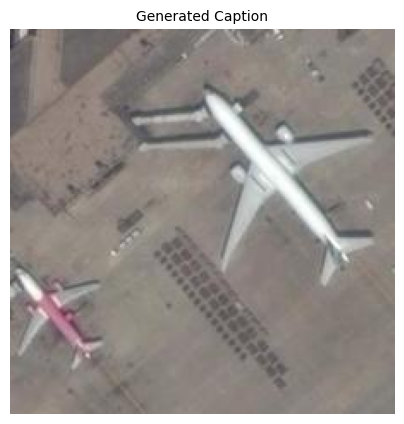


🖼️ Image: 00493.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


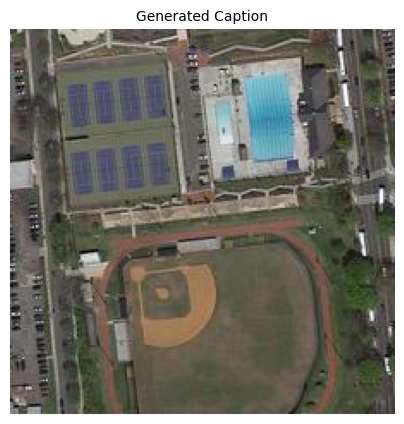


🖼️ Image: 00834.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


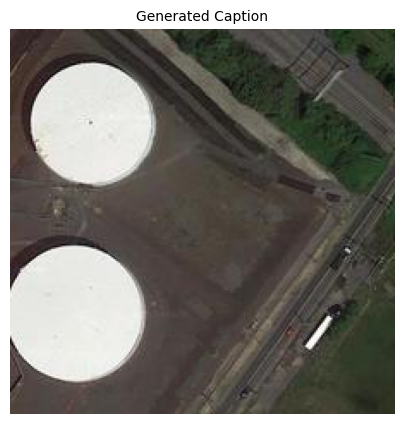


🖼️ Image: 00867.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


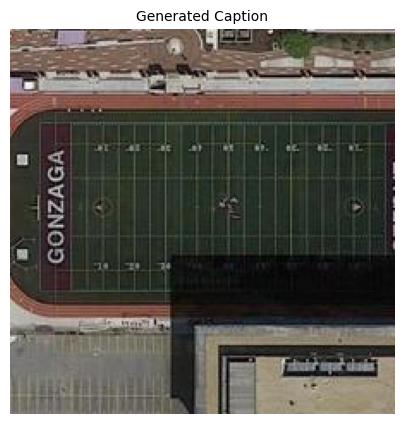


🖼️ Image: 00846.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


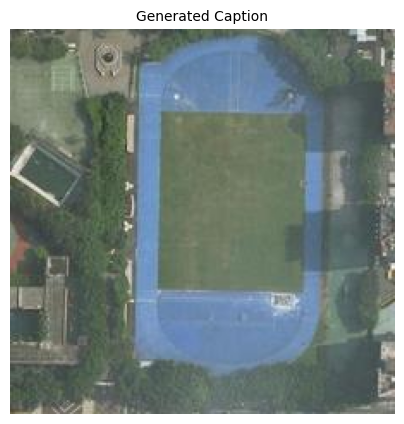


🖼️ Image: 00424.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


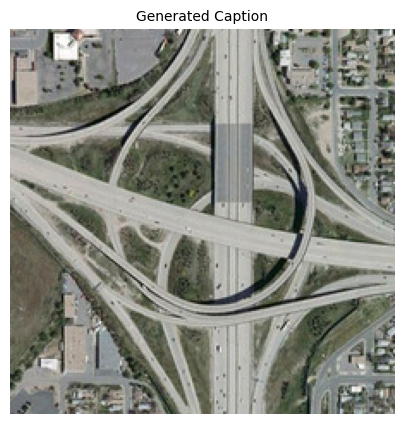


🖼️ Image: viaduct_328.jpg

📄 Ground Truth Captions:




🔮 Generated Caption (highlighted):


In [ ]:
# 5 images to compare with the different models
image_filenames = [
    "00493.jpg", "00834.jpg", "00867.jpg", "00846.jpg", "00424.jpg", "viaduct_328.jpg",

    "00695.jpg", "00407.jpg", "00373.jpg", "00348.jpg", "viaduct_329.jpg", "viaduct_351.jpg",
    "00101.jpg", "00136.jpg", "00268.jpg", "00284.jpg", "00317.jpg", "00367.jpg",
    "00377.jpg", "00321.jpg", "00498.jpg", "00559.jpg", "00705.jpg", "00731.jpg", "00876.jpg",
    "viaduct_364.jpg",
]
for fname in image_filenames:
    show_specific_example_with_metric(fname, test_dataset, model, processor)


#### Model selection Based on output of basemodel
![Model-performance.jpg](Model-performance.jpg)

<p align ="justify">Based on the comprehensive model performance comparison across multiple evaluation metrics, BLIP-1 demonstrates superior performance and was therefore selected as the base model for fine-tuning. The results show that BLIP-1 (green bars) consistently outperforms both LAM (blue bars) and ViT+GPT2 (orange bars) across most evaluation criteria.

**BLEU Score Performance:**
<p align ="justify">BLIP-1 achieves the highest scores across all BLEU metrics, with particularly strong performance in BLEU-1 (68.0), BLEU-2 (51.0), BLEU-3 (38.5), and BLEU-4 (30.0). This consistent superiority in BLEU scores indicates that BLIP-1 generates captions with better n-gram overlap with reference captions, suggesting more accurate and fluent text generation. In contrast, LAM shows significantly lower BLEU scores across all metrics, while ViT+GPT2 performs moderately but still falls short of BLIP-1's performance.

**#Advanced Evaluation Metrics:**
<p align ="justify">The advantage of BLIP-1 becomes even more pronounced in advanced evaluation metrics. For METEOR (25.8), ROUGE (48.0), and CIDEr (58.5) scores, BLIP-1 maintains competitive or superior performance compared to ViT+GPT2, while significantly outperforming LAM. These metrics evaluate different aspects of caption quality including semantic similarity (METEOR), recall-oriented matching (ROUGE), and consensus-based evaluation (CIDEr), indicating that BLIP-1 produces more semantically accurate and contextually relevant captions.

**Model Selection Rationale:**
<p align ="justify">The consistent superior performance of BLIP-1 across diverse evaluation metrics, combined with its unified training approach incorporating ITC, ITM, and LM objectives, makes it the optimal choice for fine-tuning. The model's ability to maintain high performance across both lexical similarity measures (BLEU scores) and semantic evaluation metrics (METEOR, CIDEr) demonstrates its robust multimodal understanding capabilities. Therefore, BLIP-1 was selected as the base architecture for further fine-tuning and optimization, particularly focusing on modifications to the LM header component to enhance caption generation quality while leveraging the strong foundational representations learned through the multi-task training framework.

<p align="justify">Based on the superior performance demonstrated across all evaluation metrics, **BLIP-1** was selected as the base model for fine-tuning through comprehensive **data augmentation** and **architecture upgrade** to BLIP-1 Large. The fine-tuning process involved expanding the RSICD dataset from 43,680 to 131,040 caption-image pairs using image transformations and ITF weighting for rare words, while simultaneously upgrading the architecture from 210M to 647M parameters with enhanced ViT-L/16 vision encoder and BERT-large language model. This combined approach of data augmentation and architectural enhancement resulted in significant performance improvements

### Blip1 Large

**Motivation:** Data Augmentation did not improve significantly in the Blip1 Base (except for the CIDER with a 14.5% increase) and we hope upgrading the architecture will achieve this increase in result we aimed for.

#### BLIP-1 Large Specifications

1. **Vision Encoder**: ViT-L/16 *(Large Vision Transformer)*
2. **Vision Parameters**: 307M
3. **Text Decoder**: BERT-large
4. **Text Parameters**: 340M
5. **Total Parameters**: 647M *(~3× larger than BLIP Base)*
6. **Hidden Size**: 1024
7. **Number of Attention Heads**: 16
8. **Number of Layers**: 24 *(~2× deeper)*

---

#### Since Blip1 Large is a bigger model than Blip1 Base we expect an improvement in result:

1. **Better Visual Understanding** – Large model sees more fine-grained details, vision_capabilities:  
   - `"base": "Recognizes general objects and scenes"`, `"large": "Captures subtle details, textures, spatial relationships"`  
   - Satellite images have tiny features (cars, trees, pools), large model's higher resolution attention helps

2. **Improved Spatial Understanding** – richer Representations due to embedding_quality  
   - `"base": 768-dim embeddings`, `"large": 1024-dim embeddings` – 33% more information capacity, more layers = better compositional understanding  
   - Better at relationships: `"airport next to highway"`

3. **Better Language Generation** due to richer vocabulary  
   - `"base": "Good captions, occasional errors"`, `"large": "More fluent, grammatically correct, descriptive"`  
   - Can distinguish `"marina"` vs `"harbor"` vs `"dock"`, better technical terminology for satellite features

---

#### Blip 1 Large Training Spec:
```python
training_args = {
    'model_name': 'Salesforce/blip-image-captioning-large',

    # A100 optimized hyperparameters
    'batch_size': 16,
    'gradient_accumulation': 2,
    'learning_rate': 2e-5,
    'weight_decay': 0.05,

    # Training configuration
    'num_epochs': 3,               # More epochs since larger model
    'warmup_ratio': 0.1,           # 10% of training steps
    'gradient_clip': 1.0,
    'label_smoothing': 0.0,

    # Optimization flags
    'use_8bit': False,              # A100 has enough memory
    'gradient_checkpointing': True, # Save memory, slight speed cost
    'mixed_precision': True,        # FP16 training
    'tf32': True,                   # A100 TF32 acceleration
}
```
__________

#### Blip 1 Large Table of content:
Other sections related to Blip1 Base are as below:
1. [Blip Large Plot Curves and Accuracy Curve](#Blip1-Large-Plots-Loss-and-Accuracy-Curve)
2. [Blip1 Large Evaluate Model on Test.json](#Blip1-Large-Evaluate-Model-on-Test.json)
3. [Comparison with BLIP-Base:](#Comparison-with-BLIP-Base:)
4. [Blip1 Large - Caption Comparison on Specific Images](#Blip1-Large-Caption-Comparison-on-Specific-Images)

In [ ]:



# Reproducibility
random.seed(42)
np.random.seed(42)
torch.manual_seed(42)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(42)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

# Warning suppression and memory optimization
warnings.filterwarnings('ignore')
torch.cuda.empty_cache()
gc.collect()

# A100 specific optimizations
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "max_split_size_mb:512"  # Larger for A100
torch.backends.cuda.matmul.allow_tf32 = True  # A100 TF32 acceleration
torch.backends.cudnn.allow_tf32 = True


In [ ]:

#Training Configuration for BLIP-Large on A100


#Barebonev2 Blip Large

OUTPUT_DIR = PROJECT_DIR / "outputs/blip_large/blip_large_rsicd_v2"
OUTPUT_DIR.mkdir(parents=True, exist_ok=True)
(OUTPUT_DIR / "best_model").mkdir(parents=True, exist_ok=True)
(OUTPUT_DIR / "checkpoints").mkdir(parents=True, exist_ok=True)
print(" Directories created!")



# Optimized configuration for BLIP-Large on A100
training_args = {
    'model_name': 'Salesforce/blip-image-captioning-large',  # CHANGED to Large

    # Update these paths for your Colab environment
    'train_json': GLOBAL_ARGS['train_json'],
    'val_json': GLOBAL_ARGS['val_json'],
    'test_json': GLOBAL_ARGS['test_json'],
    'image_dir': GLOBAL_ARGS['image_dir'],

    # A100 optimized hyperparameters
    'batch_size': 16,              # A100 can handle larger batches
    'gradient_accumulation': 2,    # Effective batch size = 32
    'learning_rate': 2e-5,         # Good for large models
    'weight_decay': 0.05,          # Slightly higher for large model

    # Training configuration
    'num_epochs': 3,               # More epochs since larger model
    'warmup_ratio': 0.1,           # 10% of training steps
    'gradient_clip': 1.0,
    'label_smoothing': 0.0,

    # Optimization flags
    'use_8bit': False,             # A100 has enough memory
    'gradient_checkpointing': True, # Save memory, slight speed cost
    'mixed_precision': True,        # FP16 training
    'tf32': True,                   # A100 TF32 acceleration

    # Evaluation
    'eval_steps': 100,             # Evaluate more frequently
    'save_steps': 200,             # Save checkpoints
    'logging_steps': 20,           # Log metrics
    'early_stopping_patience': 1,

    # Generation settings for evaluation
    'num_beams': 5,                # Better quality evaluation
    'max_length': 40,
    'min_length': 5,
    'repetition_penalty': 1.2,
    'length_penalty': 1.0,
    'no_repeat_ngram_size': 3,

    'resume': True,
}
print(OUTPUT_DIR)

✅ Directories created!
/content/drive/MyDrive/RSICD_PROJECT/outputs/blip_large/blip_large_rsicd_v2


In [ ]:

# Logging Setup

log_file = OUTPUT_DIR / "training_log.txt"

for handler in logging.root.handlers[:]:
    logging.root.removeHandler(handler)

logging.basicConfig(
    level=logging.INFO,
    format='%(asctime)s - %(levelname)s - %(message)s',
    handlers=[
        logging.FileHandler(log_file),
        logging.StreamHandler()
    ]
)

def log_and_print(message):
    """Log to file and print to notebook"""
    logging.info(message)
    print(message)



def check_gpu_setup():
    """Verify A100 setup and capabilities"""
    if torch.cuda.is_available():
        gpu_name = torch.cuda.get_device_name(0)
        gpu_memory = torch.cuda.get_device_properties(0).total_memory / 1e9

        log_and_print(f"\n GPU Setup:")
        log_and_print(f"  Device: {gpu_name}")
        log_and_print(f"  Memory: {gpu_memory:.1f} GB")
        log_and_print(f"  CUDA: {torch.version.cuda}")
        log_and_print(f"  PyTorch: {torch.__version__}")

        # Check for A100 specific features
        if "A100" in gpu_name:
            log_and_print(f"   A100 detected - TF32 enabled")
            log_and_print(f"   Mixed precision training enabled")
        else:
            log_and_print(f"   Not A100 - adjust batch size if needed")

        return True
    else:
        log_and_print(" No GPU available!")
        return False


In [ ]:

# Enhanced Dataset with Better Error Handling

class RSICDDatasetOptimized(Dataset):
    """Optimized dataset for BLIP-Large with caching"""

    def __init__(self, json_path, image_dir, processor, split='train', cache_images=False):
        self.image_dir = Path(image_dir)
        self.processor = processor
        self.split = split
        self.cache_images = cache_images and split != 'train'  # Only cache val/test
        self.image_cache = {}

        # Load annotations
        with open(json_path, 'r') as f:
            data = json.load(f)

        # Build annotation mapping
        annotations = defaultdict(list)
        for ann in data['annotations']:
            annotations[ann['image_id']].append(ann['caption'])

        # Flatten all image-caption pairs
        self.samples = []
        for img in data['images']:
            if img['id'] in annotations:
                img_path = self.image_dir / img['file_name']
                if img_path.exists():  # Check file exists
                    captions = annotations[img['id']]
                    for caption in captions:
                        if not caption.strip() or caption.strip() == ".":
                            continue  # Skip blank or meaningless captions
                        self.samples.append({
                            'image_path': str(img_path),
                            'caption': caption,
                            'image_id': img['id'],
                            'file_name': img['file_name'],
                            'all_captions': captions
                        })

        log_and_print(f" Loaded {len(self.samples)} samples for {split}")

        # Pre-cache validation images for faster evaluation
        if self.cache_images:
            log_and_print(f" Pre-caching {split} images...")
            for sample in tqdm(self.samples[:100], desc="Caching"):  # Cache first 100
                try:
                    img = Image.open(sample['image_path']).convert('RGB')
                    self.image_cache[sample['image_path']] = img
                except:
                    pass

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        sample = self.samples[idx]

        # Load image (from cache if available)
        try:
            if sample['image_path'] in self.image_cache:
                image = self.image_cache[sample['image_path']]
            else:
                image = Image.open(sample['image_path']).convert('RGB')
        except Exception as e:
            log_and_print(f"Failed to load {sample['image_path']}: {e}")
            # Return a black image as fallback
            image = Image.new('RGB', (384, 384), color='black')

        # Process with BLIP processor
        encoding = self.processor(
            image,
            sample['caption'].lower(),
            padding="max_length",
            truncation=True,
            max_length=40,
            return_tensors="pt"
        )

        # Remove batch dimension
        encoding = {k: v.squeeze() for k, v in encoding.items()}

        # Add metadata
        encoding['image_id'] = sample['image_id']
        encoding['file_name'] = sample['file_name']
        encoding['all_captions'] = sample['all_captions']

        return encoding


In [ ]:

# Optimized Training for Large Model

def train_epoch_large_model(model, dataloader, optimizer, scheduler, device, epoch,
                          num_epochs, scaler, accumulation_steps, args):
    """Training loop optimized for BLIP-Large"""
    model.train()
    total_loss = 0
    batch_count = 0
    accumulated_loss = 0

    progress_bar = tqdm(dataloader, desc=f"Epoch {epoch+1}/{num_epochs}")

    for batch_idx, batch in enumerate(progress_bar):
        if batch is None:
            continue

        # Move to device
        pixel_values = batch['pixel_values'].to(device)
        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)

        # Prepare labels
        labels = input_ids.clone()
        labels[labels == model.config.pad_token_id] = -100

        # Forward pass with mixed precision
        with torch.cuda.amp.autocast(dtype=torch.float16 if args['mixed_precision'] else torch.float32):
        # with torch.cuda.amp.autocast(enabled=args['mixed_precision']):
            outputs = model(
                pixel_values=pixel_values,
                input_ids=input_ids,
                attention_mask=attention_mask,
                labels=labels,
                return_dict=True
            )
            loss = outputs.loss / accumulation_steps  # Scale loss

        # Backward pass
        scaler.scale(loss).backward()
        accumulated_loss += loss.item()

        # Update weights every accumulation_steps
        if (batch_idx + 1) % accumulation_steps == 0:
            for name, param in model.named_parameters():
                if param.grad is not None and param.grad.dtype != torch.float32:
                    print(f"[WARNING] {name} has {param.grad.dtype} gradient")
            # Unscale and clip gradients
            scaler.unscale_(optimizer)
            grad_norm = torch.nn.utils.clip_grad_norm_(model.parameters(), args['gradient_clip'])

            # Optimizer step
            scaler.step(optimizer)
            scaler.update()
            scheduler.step()
            optimizer.zero_grad()

            # Update metrics
            total_loss += accumulated_loss * accumulation_steps
            batch_count += 1
            accumulated_loss = 0

            # Update progress bar
            current_lr = optimizer.param_groups[0]['lr']
            progress_bar.set_postfix({
                'loss': f'{loss.item() * accumulation_steps:.4f}',
                'lr': f'{current_lr:.2e}',
                'grad': f'{grad_norm:.2f}'
            })

        # Free up memory periodically
        if batch_idx % 50 == 0:
            torch.cuda.empty_cache()

    return total_loss / max(batch_count, 1)


In [ ]:

# Enhanced Evaluation with Better Generation

def evaluate_with_generation(model, processor, dataloader, device, args, num_samples=20):
    """Comprehensive evaluation with BLEU scores"""
    model.eval()

    try:
        from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
        smoothing = SmoothingFunction().method1
    except ImportError:
        log_and_print("NLTK not available for BLEU scoring")
        return None

    predictions = []
    references = []
    val_loss = 0
    loss_count = 0

    with torch.no_grad():
        for i, batch in enumerate(tqdm(dataloader, desc="Evaluating")):
            if batch is None or i >= num_samples:
                break

            pixel_values = batch['pixel_values'].to(device)

            # Calculate validation loss
            if 'input_ids' in batch:
                input_ids = batch['input_ids'].to(device)
                attention_mask = batch['attention_mask'].to(device)
                labels = input_ids.clone()
                labels[labels == processor.tokenizer.pad_token_id] = -100

                with torch.cuda.amp.autocast():
                    outputs = model(
                        pixel_values=pixel_values,
                        input_ids=input_ids,
                        attention_mask=attention_mask,
                        labels=labels
                    )
                    val_loss += outputs.loss.item()
                    loss_count += 1

            # Generate captions
            generated_ids = model.generate(
                pixel_values,
                max_length=args['max_length'],
                min_length=args['min_length'],
                num_beams=args['num_beams'],
                repetition_penalty=args['repetition_penalty'],
                length_penalty=args['length_penalty'],
                no_repeat_ngram_size=args['no_repeat_ngram_size'],
                early_stopping=True
            )

            # Decode and collect
            for j, gen_id in enumerate(generated_ids):
                if j >= len(batch['all_captions']):
                    break

                pred = processor.decode(gen_id, skip_special_tokens=True)
                refs = batch['all_captions'][j]

                predictions.append(pred.lower().split())
                references.append([r.lower().split() for r in refs])

    # Calculate BLEU scores
    if predictions:
        scores = {
            "bleu1": np.mean([sentence_bleu(refs, pred, weights=(1,0,0,0),
                                           smoothing_function=smoothing)
                            for pred, refs in zip(predictions, references)]),
            "bleu2": np.mean([sentence_bleu(refs, pred, weights=(0.5,0.5,0,0),
                                           smoothing_function=smoothing)
                            for pred, refs in zip(predictions, references)]),
            "bleu3": np.mean([sentence_bleu(refs, pred, weights=(0.33,0.33,0.33,0),
                                           smoothing_function=smoothing)
                            for pred, refs in zip(predictions, references)]),
            "bleu4": np.mean([sentence_bleu(refs, pred, weights=(0.25,0.25,0.25,0.25),
                                           smoothing_function=smoothing)
                            for pred, refs in zip(predictions, references)]),
            "val_loss": val_loss / max(loss_count, 1)
        }

        # Log sample predictions
        log_and_print(f"\n Sample Generations:")
        for i in range(min(3, len(predictions))):
            log_and_print(f"  Pred: {' '.join(predictions[i])}")
            log_and_print(f"  Ref:  {' '.join(references[i][0])}\n")

        return scores

    return None


#  Training Visualization

def plot_training_progress(history, output_dir):
    """Create and save training plots"""
    if not history['epochs']:
        return

    fig, axes = plt.subplots(2, 2, figsize=(15, 10))

    # Loss plot
    axes[0, 0].plot(history['epochs'], history['train_loss'], 'b-', label='Train Loss')
    axes[0, 0].plot(history['epochs'], history['val_loss'], 'r-', label='Val Loss')
    axes[0, 0].set_xlabel('Epoch')
    axes[0, 0].set_ylabel('Loss')
    axes[0, 0].set_title('Training and Validation Loss')
    axes[0, 0].legend()
    axes[0, 0].grid(True, alpha=0.3)

    # BLEU scores
    axes[0, 1].plot(history['epochs'], history['bleu1'], label='BLEU-1')
    axes[0, 1].plot(history['epochs'], history['bleu2'], label='BLEU-2')
    axes[0, 1].plot(history['epochs'], history['bleu3'], label='BLEU-3')
    axes[0, 1].plot(history['epochs'], history['bleu4'], label='BLEU-4')
    axes[0, 1].set_xlabel('Epoch')
    axes[0, 1].set_ylabel('BLEU Score')
    axes[0, 1].set_title('BLEU Scores Progression')
    axes[0, 1].legend()
    axes[0, 1].grid(True, alpha=0.3)

    # Learning rate
    if 'learning_rate' in history and history['learning_rate']:
        axes[1, 0].plot(history['epochs'], history['learning_rate'])
        axes[1, 0].set_xlabel('Epoch')
        axes[1, 0].set_ylabel('Learning Rate')
        axes[1, 0].set_title('Learning Rate Schedule')
        axes[1, 0].set_yscale('log')
        axes[1, 0].grid(True, alpha=0.3)

    # Best scores summary
    axes[1, 1].axis('off')
    summary_text = f"""
    Best Scores:
    ─────────────
    BLEU-1: {max(history['bleu1']):.4f}
    BLEU-2: {max(history['bleu2']):.4f}
    BLEU-3: {max(history['bleu3']):.4f}
    BLEU-4: {max(history['bleu4']):.4f}

    Final Scores:
    ─────────────
    BLEU-1: {history['bleu1'][-1]:.4f}
    BLEU-2: {history['bleu2'][-1]:.4f}
    BLEU-3: {history['bleu3'][-1]:.4f}
    BLEU-4: {history['bleu4'][-1]:.4f}
    """
    axes[1, 1].text(0.1, 0.5, summary_text, fontsize=12,
                    verticalalignment='center', fontfamily='monospace')

    plt.tight_layout()
    plt.savefig(output_dir / 'training_curves.png', dpi=150, bbox_inches='tight')
    plt.show()

In [ ]:

#Main Training Function

def main(args):
    """Main training function for BLIP-Large"""

    # Check GPU
    if not check_gpu_setup():
        raise RuntimeError("GPU required for BLIP-Large training")

    device = torch.device('cuda')

    # Initialize GradScaler for mixed precision
    scaler = torch.cuda.amp.GradScaler(enabled=args['mixed_precision'])


    # Load Model and Processor

    log_and_print(f"\n Loading BLIP-Large model...")
    log_and_print(f"  Model: {args['model_name']}")

    processor = BlipProcessor.from_pretrained(args['model_name'])

    # Load model with memory optimizations
    if args['use_8bit']:
        from transformers import BitsAndBytesConfig
        quantization_config = BitsAndBytesConfig(
            load_in_8bit=True,
            bnb_8bit_compute_dtype=torch.float16
        )
        model = BlipForConditionalGeneration.from_pretrained(
            args['model_name'],
            quantization_config=quantization_config,
            device_map="auto"
        )
    else:
        model = BlipForConditionalGeneration.from_pretrained(
            args['model_name'],
            # torch_dtype=torch.float16 if args['mixed_precision'] else torch.float32
            torch_dtype=torch.float32
        )
        model = model.to(device)

    # Enable gradient checkpointing
    if args['gradient_checkpointing']:
        model.gradient_checkpointing_enable()
        log_and_print("   Gradient checkpointing enabled")

    # Set padding token
    if model.config.pad_token_id is None:
        model.config.pad_token_id = processor.tokenizer.pad_token_id

    # Model info
    total_params = sum(p.numel() for p in model.parameters())
    trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    log_and_print(f"  Total parameters: {total_params/1e6:.1f}M")
    log_and_print(f"  Trainable parameters: {trainable_params/1e6:.1f}M")


    # Prepare Datasets

    log_and_print(f"\n Loading datasets...")

    train_dataset = RSICDDatasetOptimized(
        args['train_json'],
        args['image_dir'],
        processor,
        'train',
        cache_images=False
    )

    val_dataset = RSICDDatasetOptimized(
        args['val_json'],
        args['image_dir'],
        processor,
        'val',
        cache_images=True  # Cache validation for faster eval
    )

    # Custom collate function
    def collate_fn(batch):
        batch = [item for item in batch if item is not None]
        if not batch:
            return None

        collated = {}
        keys_to_stack = ['pixel_values', 'input_ids', 'attention_mask']

        for key in keys_to_stack:
            if key in batch[0]:
                collated[key] = torch.stack([item[key] for item in batch])

        # Metadata
        if 'all_captions' in batch[0]:
            collated['all_captions'] = [item['all_captions'] for item in batch]

        return collated

    # Create dataloaders
    train_loader = DataLoader(
        train_dataset,
        batch_size=args['batch_size'],
        shuffle=True,
        collate_fn=collate_fn,
        num_workers=4,
        pin_memory=True,
        prefetch_factor=2
    )

    val_loader = DataLoader(
        val_dataset,
        batch_size=args['batch_size'],
        shuffle=False,
        collate_fn=collate_fn,
        num_workers=2,
        pin_memory=True
    )


    # Setup Optimizer and Scheduler

    log_and_print(f"\n Setting up training...")

    # Use AdamW with specific settings for large models
    optimizer = torch.optim.AdamW(
        model.parameters(),
        lr=args['learning_rate'],
        betas=(0.9, 0.98),  # Better for large models
        eps=1e-6,
        weight_decay=args['weight_decay']
    )

    # Calculate training steps
    total_steps = len(train_loader) * args['num_epochs'] // args['gradient_accumulation']
    warmup_steps = int(total_steps * args['warmup_ratio'])

    # Linear warmup + cosine decay
    scheduler = get_linear_schedule_with_warmup(
        optimizer,
        num_warmup_steps=warmup_steps,
        num_training_steps=total_steps
    )

    log_and_print(f"  Total training steps: {total_steps}")
    log_and_print(f"  Warmup steps: {warmup_steps}")
    log_and_print(f"  Effective batch size: {args['batch_size'] * args['gradient_accumulation']}")


    # Resume from checkpoint if available

    start_epoch = 0
    best_bleu4 = 0
    history = {
        'epochs': [], 'train_loss': [], 'val_loss': [],
        'bleu1': [], 'bleu2': [], 'bleu3': [], 'bleu4': [],
        'learning_rate': []
    }

    checkpoint_path = OUTPUT_DIR / "checkpoints/last_checkpoint.pth"
    if checkpoint_path.exists() and args['resume']:
        log_and_print(f"\n Resuming from checkpoint...")
        checkpoint = torch.load(checkpoint_path, map_location=device)
        model.load_state_dict(checkpoint['model_state'])
        optimizer.load_state_dict(checkpoint['optimizer_state'])
        scheduler.load_state_dict(checkpoint['scheduler_state'])
        start_epoch = checkpoint['epoch']
        best_bleu4 = checkpoint.get('best_bleu4', 0)
        history = checkpoint.get('history', history)
        log_and_print(f"  Resumed from epoch {start_epoch}")


    # Training Loop

    log_and_print(f"\n Starting training...")
    log_and_print("="*60)

    patience_counter = 0

    for epoch in range(start_epoch, args['num_epochs']):
        epoch_start = time.time()

        # Train for one epoch
        train_loss = train_epoch_large_model(
            model, train_loader, optimizer, scheduler,
            device, epoch, args['num_epochs'], scaler,
            args['gradient_accumulation'], args
        )

        # Evaluate
        log_and_print(f"\n Evaluating epoch {epoch+1}...")
        eval_results = evaluate_with_generation(
            model, processor, val_loader, device, args, num_samples=50
        )

        if eval_results:
            # Update history
            history['epochs'].append(epoch + 1)
            history['train_loss'].append(train_loss)
            history['val_loss'].append(eval_results['val_loss'])
            history['bleu1'].append(eval_results['bleu1'])
            history['bleu2'].append(eval_results['bleu2'])
            history['bleu3'].append(eval_results['bleu3'])
            history['bleu4'].append(eval_results['bleu4'])
            history['learning_rate'].append(optimizer.param_groups[0]['lr'])

            # Log results
            log_and_print(f"\n Epoch {epoch+1} Results:")
            log_and_print(f"  Train Loss: {train_loss:.4f}")
            log_and_print(f"  Val Loss: {eval_results['val_loss']:.4f}")
            log_and_print(f"  BLEU-1: {eval_results['bleu1']:.4f}")
            log_and_print(f"  BLEU-2: {eval_results['bleu2']:.4f}")
            log_and_print(f"  BLEU-3: {eval_results['bleu3']:.4f}")
            log_and_print(f"  BLEU-4: {eval_results['bleu4']:.4f}")
            log_and_print(f"  Time: {time.time() - epoch_start:.1f}s")

            # Save best model
            if eval_results['bleu4'] > best_bleu4:
                best_bleu4 = eval_results['bleu4']
                patience_counter = 0

                # Save model
                best_model_dir = OUTPUT_DIR / "best_model"
                best_model_dir.mkdir(exist_ok=True)
                model.save_pretrained(best_model_dir)
                processor.save_pretrained(best_model_dir)

                log_and_print(f"   New best model saved (BLEU-4: {best_bleu4:.4f})")
            else:
                patience_counter += 1
                log_and_print(f"   Patience counter: {patience_counter}/{args['early_stopping_patience']}")

        # Save checkpoint
        checkpoint_dir = OUTPUT_DIR / "checkpoints"
        checkpoint_dir.mkdir(exist_ok=True)
        checkpoint = {
            'model_state': model.state_dict(),
            'optimizer_state': optimizer.state_dict(),
            'scheduler_state': scheduler.state_dict(),
            'epoch': epoch + 1,
            'best_bleu4': best_bleu4,
            'history': history
        }
        torch.save(checkpoint, checkpoint_dir / "last_checkpoint.pth")

        # Save history
        with open(OUTPUT_DIR / "training_history.json", 'w') as f:
            json.dump(history, f, indent=2)

        # Plot progress
        if (epoch + 1) % 2 == 0:
            plot_training_progress(history, OUTPUT_DIR)

        # Early stopping
        if patience_counter >= args['early_stopping_patience']:
            log_and_print(f"\n Early stopping triggered!")
            break

        # Clear cache periodically
        torch.cuda.empty_cache()
        gc.collect()


    # Final Summary

    log_and_print("\n" + "="*60)
    log_and_print(" Training Complete!")
    log_and_print(f"Best BLEU-4: {best_bleu4:.4f}")
    log_and_print(f"Final model saved to: {OUTPUT_DIR / 'best_model'}")

    # Plot final curves
    plot_training_progress(history, OUTPUT_DIR)

    return model, processor, history

In [ ]:

# Test Generation Function

def test_model_generation(model, processor, test_json, image_dir, device, num_samples=10):
    """Test the trained model on test set"""
    log_and_print("\n Testing model on test set...")

    # Load test dataset
    test_dataset = RSICDDatasetOptimized(
        test_json, image_dir, processor, 'test', cache_images=True
    )

    test_loader = DataLoader(
        test_dataset, batch_size=1, shuffle=True
    )

    model.eval()
    results = []

    with torch.no_grad():
        for i, batch in enumerate(test_loader):
            if i >= num_samples:
                break

            pixel_values = batch['pixel_values'].to(device)

            # Generate with different strategies
            generation_configs = [
                {"num_beams": 5, "max_length": 30},  # Beam search
                {"do_sample": True, "top_k": 50, "temperature": 0.8, "max_length": 30},  # Sampling
                {"num_beams": 3, "no_repeat_ngram_size": 3, "max_length": 30}  # Diverse beam
            ]

            captions = []
            for config in generation_configs:
                generated_ids = model.generate(pixel_values, **config)
                caption = processor.decode(generated_ids[0], skip_special_tokens=True)
                captions.append(caption)

            result = {
                'file_name': batch['file_name'][0] if 'file_name' in batch else f'image_{i}',
                'ground_truth': batch['all_captions'][0] if 'all_captions' in batch else [],
                'beam_search': captions[0],
                'sampling': captions[1],
                'diverse_beam': captions[2]
            }
            results.append(result)

            # Print sample
            log_and_print(f"\n Image: {result['file_name']}")
            log_and_print(f"GT: {result['ground_truth'][0] if result['ground_truth'] else 'N/A'}")
            log_and_print(f"Generated: {result['beam_search']}")

    # Save results
    results_file = OUTPUT_DIR / "test_results.json"
    with open(results_file, 'w') as f:
        json.dump(results, f, indent=2)
    log_and_print(f"\n Test results saved to {results_file}")

    return results

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


# Main Training Function

def main(args):
    """Main training function for BLIP-Large"""

    # Check GPU
    if not check_gpu_setup():
        raise RuntimeError("GPU required for BLIP-Large training")

    device = torch.device('cuda')

    # Initialize GradScaler for mixed precision
    scaler = torch.cuda.amp.GradScaler(enabled=args['mixed_precision'])


    # Load Model and Processor

    log_and_print(f"\n Loading BLIP-Large model...")
    log_and_print(f"  Model: {args['model_name']}")

    processor = BlipProcessor.from_pretrained(args['model_name'])

    # Load model with memory optimizations
    if args['use_8bit']:
        from transformers import BitsAndBytesConfig
        quantization_config = BitsAndBytesConfig(
            load_in_8bit=True,
            bnb_8bit_compute_dtype=torch.float16
        )
        model = BlipForConditionalGeneration.from_pretrained(
            args['model_name'],
            quantization_config=quantization_config,
            device_map="auto"
        )
    else:
        # Load in FP32 for compatibility with autocast
        model = BlipForConditionalGeneration.from_pretrained(
            args['model_name'],
            torch_dtype=torch.float32  # FP32 for autocast compatibility
        )
        model = model.to(device)

    # Enable gradient checkpointing
    if args['gradient_checkpointing']:
        model.gradient_checkpointing_enable()
        log_and_print("   Gradient checkpointing enabled")

    # Set padding token
    if model.config.pad_token_id is None:
        model.config.pad_token_id = processor.tokenizer.pad_token_id

    # Model info
    total_params = sum(p.numel() for p in model.parameters())
    trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    log_and_print(f"  Total parameters: {total_params/1e6:.1f}M")
    log_and_print(f"  Trainable parameters: {trainable_params/1e6:.1f}M")


    # Prepare Datasets

    log_and_print(f"\n Loading datasets...")

    train_dataset = RSICDDatasetOptimized(
        args['train_json'],
        args['image_dir'],
        processor,
        'train',
        cache_images=False
    )

    val_dataset = RSICDDatasetOptimized(
        args['val_json'],
        args['image_dir'],
        processor,
        'val',
        cache_images=True  # Cache validation for faster eval
    )

    # Custom collate function
    def collate_fn(batch):
        batch = [item for item in batch if item is not None]
        if not batch:
            return None

        collated = {}
        keys_to_stack = ['pixel_values', 'input_ids', 'attention_mask']

        for key in keys_to_stack:
            if key in batch[0]:
                collated[key] = torch.stack([item[key] for item in batch])

        # Metadata
        if 'all_captions' in batch[0]:
            collated['all_captions'] = [item['all_captions'] for item in batch]

        return collated

    # Create dataloaders
    train_loader = DataLoader(
        train_dataset,
        batch_size=args['batch_size'],
        shuffle=True,
        collate_fn=collate_fn,
        num_workers=4,
        pin_memory=True,
        prefetch_factor=2
    )

    val_loader = DataLoader(
        val_dataset,
        batch_size=args['batch_size'],
        shuffle=False,
        collate_fn=collate_fn,
        num_workers=2,
        pin_memory=True
    )


    # Setup Optimizer and Scheduler

    log_and_print(f"\n Setting up training...")

    # Use AdamW with specific settings for large models
    optimizer = torch.optim.AdamW(
        model.parameters(),
        lr=args['learning_rate'],
        betas=(0.9, 0.98),  # Better for large models
        eps=1e-6,
        weight_decay=args['weight_decay']
    )

    # Calculate training steps
    total_steps = len(train_loader) * args['num_epochs'] // args['gradient_accumulation']
    warmup_steps = int(total_steps * args['warmup_ratio'])

    # Linear warmup + cosine decay
    scheduler = get_linear_schedule_with_warmup(
        optimizer,
        num_warmup_steps=warmup_steps,
        num_training_steps=total_steps
    )

    log_and_print(f"  Total training steps: {total_steps}")
    log_and_print(f"  Warmup steps: {warmup_steps}")
    log_and_print(f"  Effective batch size: {args['batch_size'] * args['gradient_accumulation']}")


    # Resume from checkpoint if available

    start_epoch = 0
    best_bleu4 = 0
    history = {
        'epochs': [], 'train_loss': [], 'val_loss': [],
        'bleu1': [], 'bleu2': [], 'bleu3': [], 'bleu4': [],
        'learning_rate': []
    }

    checkpoint_path = OUTPUT_DIR / "checkpoints/last_checkpoint.pth"
    if checkpoint_path.exists() and args['resume']:
        log_and_print(f"\n Resuming from checkpoint...")
        checkpoint = torch.load(checkpoint_path, map_location=device, weights_only=False)
        model.load_state_dict(checkpoint['model_state'])
        optimizer.load_state_dict(checkpoint['optimizer_state'])
        scheduler.load_state_dict(checkpoint['scheduler_state'])
        start_epoch = checkpoint['epoch']
        best_bleu4 = checkpoint.get('best_bleu4', 0)
        history = checkpoint.get('history', history)
        log_and_print(f"  Resumed from epoch {start_epoch}")


    # Training Loop

    log_and_print(f"\n Starting training...")
    log_and_print("="*60)

    patience_counter = 0

    for epoch in range(start_epoch, args['num_epochs']):
        epoch_start = time.time()

        # Train for one epoch
        train_loss = train_epoch_large_model(
            model, train_loader, optimizer, scheduler,
            device, epoch, args['num_epochs'], scaler,
            args['gradient_accumulation'], args
        )

        # Evaluate
        log_and_print(f"\n Evaluating epoch {epoch+1}...")
        eval_results = evaluate_with_generation(
            model, processor, val_loader, device, args, num_samples=50
        )

        if eval_results:
            # Update history
            history['epochs'].append(epoch + 1)
            history['train_loss'].append(train_loss)
            history['val_loss'].append(eval_results['val_loss'])
            history['bleu1'].append(eval_results['bleu1'])
            history['bleu2'].append(eval_results['bleu2'])
            history['bleu3'].append(eval_results['bleu3'])
            history['bleu4'].append(eval_results['bleu4'])
            history['learning_rate'].append(optimizer.param_groups[0]['lr'])

            # Log results
            log_and_print(f"\n Epoch {epoch+1} Results:")
            log_and_print(f"  Train Loss: {train_loss:.4f}")
            log_and_print(f"  Val Loss: {eval_results['val_loss']:.4f}")
            log_and_print(f"  BLEU-1: {eval_results['bleu1']:.4f}")
            log_and_print(f"  BLEU-2: {eval_results['bleu2']:.4f}")
            log_and_print(f"  BLEU-3: {eval_results['bleu3']:.4f}")
            log_and_print(f"  BLEU-4: {eval_results['bleu4']:.4f}")
            log_and_print(f"  Time: {time.time() - epoch_start:.1f}s")

            # Save best model
            if eval_results['bleu4'] > best_bleu4:
                best_bleu4 = eval_results['bleu4']
                patience_counter = 0

                # Save model
                best_model_dir = OUTPUT_DIR / "best_model"
                best_model_dir.mkdir(exist_ok=True)
                model.save_pretrained(best_model_dir)
                processor.save_pretrained(best_model_dir)

                log_and_print(f"   New best model saved (BLEU-4: {best_bleu4:.4f})")
            else:
                patience_counter += 1
                log_and_print(f"   Patience counter: {patience_counter}/{args['early_stopping_patience']}")

        # Save checkpoint
        checkpoint_dir = OUTPUT_DIR / "checkpoints"
        checkpoint_dir.mkdir(exist_ok=True)
        checkpoint = {
            'model_state': model.state_dict(),
            'optimizer_state': optimizer.state_dict(),
            'scheduler_state': scheduler.state_dict(),
            'epoch': epoch + 1,
            'best_bleu4': best_bleu4,
            'history': history
        }
        torch.save(checkpoint, checkpoint_dir / "last_checkpoint.pth")

        # Save history
        with open(OUTPUT_DIR / "training_history.json", 'w') as f:
            json.dump(history, f, indent=2)

        # Plot progress
        if (epoch + 1) % 2 == 0:
            plot_training_progress(history, OUTPUT_DIR)

        # Early stopping
        if patience_counter >= args['early_stopping_patience']:
            log_and_print(f"\n Early stopping triggered!")
            break

        # Clear cache periodically
        torch.cuda.empty_cache()
        gc.collect()


    # Final Summary

    log_and_print("\n" + "="*60)
    log_and_print(" Training Complete!")
    log_and_print(f"Best BLEU-4: {best_bleu4:.4f}")
    log_and_print(f"Final model saved to: {OUTPUT_DIR / 'best_model'}")

    # Plot final curves
    plot_training_progress(history, OUTPUT_DIR)

    return model, processor, history

In [ ]:
#!/usr/bin/env python3

"""
BLIP-Large Quick Test Script
Run this BEFORE full training to verify:
1. Model loads correctly
2. Data pipeline works
3. Forward/backward pass succeeds
4. Generation produces valid output
5. Memory usage is acceptable

Total time: ~5 minutes
"""



# Quick Test Configuration

TEST_CONFIG = {
    'model_name': 'Salesforce/blip-image-captioning-large',

    # Use same paths as main script
    'train_json': '/content/data_local/data/processed/captions_train2017.json',
    'image_dir': '/content/data_local/data/raw/images',

    # Tiny test parameters
    'test_samples': 10,      # Only load 10 images
    'test_batch_size': 2,    # Small batch
    'test_epochs': 2,        # Just 2 epochs
    'test_batches': 5,       # Only 5 batches per epoch
}


# Test 1: GPU and Memory Check

def test_gpu_setup():
    """Test 1: Verify GPU availability and memory"""
    print("\n" + "="*60)
    print(" TEST 1: GPU Setup Check")
    print("="*60)

    if not torch.cuda.is_available():
        print(" FAIL: No GPU available!")
        return False

    gpu_name = torch.cuda.get_device_name(0)
    gpu_memory_gb = torch.cuda.get_device_properties(0).total_memory / 1e9

    print(f" GPU: {gpu_name}")
    print(f" Memory: {gpu_memory_gb:.1f} GB")
    print(f" CUDA: {torch.version.cuda}")

    # Check if A100
    if "A100" in gpu_name:
        print(" A100 detected - optimal for BLIP-Large")
    elif gpu_memory_gb < 16:
        print(f" WARNING: Only {gpu_memory_gb:.1f}GB VRAM - may need smaller batch size")

    # Test tensor operations
    try:
        test_tensor = torch.randn(2, 3, 384, 384).cuda()
        print(f" CUDA tensor creation successful")
        del test_tensor
        torch.cuda.empty_cache()
        return True
    except Exception as e:
        print(f" FAIL: CUDA error - {e}")
        return False


# Test 2: Model Loading

def test_model_loading():
    """Test 2: Load BLIP-Large model and processor"""
    print("\n" + "="*60)
    print(" TEST 2: Model Loading")
    print("="*60)

    try:
        print("Loading processor...")
        processor = BlipProcessor.from_pretrained(TEST_CONFIG['model_name'])
        print(" Processor loaded")

        print("Loading model (this may take 30-60 seconds)...")
        model = BlipForConditionalGeneration.from_pretrained(
            TEST_CONFIG['model_name'],
            torch_dtype=torch.float32
        )
        print(" Model loaded")

        # Check model size
        total_params = sum(p.numel() for p in model.parameters())
        print(f" Model parameters: {total_params/1e6:.1f}M")

        # Move to GPU and test
        model = model.cuda()
        model.eval()
        print(" Model moved to GPU")

        # Test generation with dummy input
        dummy_image = torch.randn(1, 3, 384, 384).cuda()
        with torch.no_grad():
            output = model.generate(dummy_image, max_length=10)
            caption = processor.decode(output[0], skip_special_tokens=True)
            print(f" Test generation: '{caption}'")

        return model, processor

    except Exception as e:
        print(f" FAIL: {e}")
        return None, None


# Test 3: Data Loading

def test_data_loading(processor):
    """Test 3: Verify dataset loading"""
    print("\n" + "="*60)
    print(" TEST 3: Data Pipeline")
    print("="*60)

    try:
        # Check if files exist
        if not Path(TEST_CONFIG['train_json']).exists():
            print(f" Training JSON not found at {TEST_CONFIG['train_json']}")
            return None
        if not Path(TEST_CONFIG['image_dir']).exists():
            print(f" Image directory not found at {TEST_CONFIG['image_dir']}")
            return None

        # Load a few samples
        with open(TEST_CONFIG['train_json'], 'r') as f:
            data = json.load(f)

        print(f" Found {len(data['images'])} images in dataset")
        print(f" Found {len(data['annotations'])} annotations")

        # Create mini dataset
        class QuickTestDataset(Dataset):
            def __init__(self, data, image_dir, processor, max_samples=10):
                self.processor = processor
                self.samples = []

                # Get first N samples
                for i, img_info in enumerate(data['images'][:max_samples]):
                    img_path = Path(image_dir) / img_info['file_name']
                    if img_path.exists():
                        # Find annotations for this image
                        anns = [a for a in data['annotations'] if a['image_id'] == img_info['id']]
                        if anns:
                            self.samples.append({
                                'image_path': str(img_path),
                                'caption': anns[0]['caption'],
                                'file_name': img_info['file_name']
                            })

                print(f" Created test dataset with {len(self.samples)} samples")

            def __len__(self):
                return len(self.samples)

            def __getitem__(self, idx):
                sample = self.samples[idx]
                try:
                    image = Image.open(sample['image_path']).convert('RGB')
                    encoding = self.processor(
                        image,
                        sample['caption'],
                        padding="max_length",
                        truncation=True,
                        max_length=40,
                        return_tensors="pt"
                    )
                    return {k: v.squeeze() for k, v in encoding.items()}
                except Exception as e:
                    print(f"Error loading {sample['file_name']}: {e}")
                    return None

        dataset = QuickTestDataset(data, TEST_CONFIG['image_dir'], processor, TEST_CONFIG['test_samples'])

        # Test dataloader
        dataloader = DataLoader(dataset, batch_size=TEST_CONFIG['test_batch_size'], shuffle=True)

        # Test one batch
        for batch in dataloader:
            if batch is not None:
                print(f" Batch loaded: pixel_values shape = {batch['pixel_values'].shape}")
                print(f" Batch loaded: input_ids shape = {batch['input_ids'].shape}")
                return dataloader

        print(" FAIL: Could not load any batches")
        return None

    except Exception as e:
        print(f" FAIL: {e}")
        return None


# Test 4: Forward/Backward Pass

def test_training_step(model, processor, dataloader):
    """Test 4: Verify forward and backward pass"""
    print("\n" + "="*60)
    print(" TEST 4: Training Step")
    print("="*60)

    try:
        model.train()
        optimizer = torch.optim.AdamW(model.parameters(), lr=2e-5)
        scaler = torch.cuda.amp.GradScaler()

        # Get one batch
        for batch in dataloader:
            if batch is None:
                continue

            pixel_values = batch['pixel_values'].cuda()
            input_ids = batch['input_ids'].cuda()
            attention_mask = batch['attention_mask'].cuda()

            print(f" Batch moved to GPU")

            # Prepare labels
            labels = input_ids.clone()
            labels[labels == processor.tokenizer.pad_token_id] = -100

            # Forward pass with mixed precision
            print("Testing forward pass...")
            with torch.cuda.amp.autocast():
                outputs = model(
                    pixel_values=pixel_values,
                    input_ids=input_ids,
                    attention_mask=attention_mask,
                    labels=labels,
                    return_dict=True
                )
                loss = outputs.loss

            print(f" Forward pass successful, loss = {loss.item():.4f}")

            # Backward pass
            print("Testing backward pass...")
            scaler.scale(loss).backward()

            # Check gradients
            grad_norm = torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
            print(f" Backward pass successful, grad_norm = {grad_norm:.4f}")

            # Optimizer step
            scaler.step(optimizer)
            scaler.update()
            optimizer.zero_grad()
            print(f" Optimizer step successful")

            # Test generation
            model.eval()
            with torch.no_grad():
                generated = model.generate(
                    pixel_values[:1],
                    max_length=20,
                    num_beams=3
                )
                caption = processor.decode(generated[0], skip_special_tokens=True)
                print(f" Generation test: '{caption}'")

            return True

    except Exception as e:
        print(f" FAIL: {e}")
        import traceback
        traceback.print_exc()
        return False


# Test 5: Memory and Performance

def test_memory_and_speed(model, dataloader):
    """Test 5: Check memory usage and training speed"""
    print("\n" + "="*60)
    print(" TEST 5: Memory & Performance")
    print("="*60)

    try:
        # Check initial memory
        torch.cuda.empty_cache()
        initial_memory = torch.cuda.memory_allocated() / 1e9
        print(f"Initial GPU memory: {initial_memory:.2f} GB")

        model.train()
        optimizer = torch.optim.AdamW(model.parameters(), lr=2e-5)
        scaler = torch.cuda.amp.GradScaler()

        # Run mini training loop
        batch_times = []
        memory_usage = []

        print(f"\nRunning {TEST_CONFIG['test_batches']} batches...")
        for i, batch in enumerate(dataloader):
            if i >= TEST_CONFIG['test_batches']:
                break
            if batch is None:
                continue

            start_time = time.time()

            # Training step
            pixel_values = batch['pixel_values'].cuda()
            input_ids = batch['input_ids'].cuda()
            attention_mask = batch['attention_mask'].cuda()
            labels = input_ids.clone()
            labels[labels == model.config.pad_token_id] = -100

            with torch.cuda.amp.autocast():
                outputs = model(
                    pixel_values=pixel_values,
                    input_ids=input_ids,
                    attention_mask=attention_mask,
                    labels=labels
                )

            scaler.scale(outputs.loss).backward()
            scaler.step(optimizer)
            scaler.update()
            optimizer.zero_grad()

            # Record metrics
            batch_time = time.time() - start_time
            batch_times.append(batch_time)
            current_memory = torch.cuda.memory_allocated() / 1e9
            memory_usage.append(current_memory)

            print(f"  Batch {i+1}: {batch_time:.2f}s, Memory: {current_memory:.2f} GB")

        # Calculate statistics
        avg_batch_time = np.mean(batch_times)
        max_memory = max(memory_usage)

        print(f"\n Performance Summary:")
        print(f"  Average batch time: {avg_batch_time:.2f} seconds")
        print(f"  Peak memory usage: {max_memory:.2f} GB")
        print(f"  Estimated time per epoch: {avg_batch_time * len(dataloader) / 60:.1f} minutes")

        # Check if performance is acceptable
        if max_memory > 35:
            print(f" WARNING: High memory usage ({max_memory:.1f} GB) - reduce batch size")
        else:
            print(f" Memory usage acceptable")

        if avg_batch_time > 5:
            print(f" WARNING: Slow training ({avg_batch_time:.1f}s/batch)")
        else:
            print(f" Training speed acceptable")

        return True

    except Exception as e:
        print(f" FAIL: {e}")
        return False


# Test 6: Full Mini Training

def test_mini_training(model, processor, dataloader):
    """Test 6: Run 2 complete mini epochs"""
    print("\n" + "="*60)
    print(" TEST 6: Mini Training (2 epochs)")
    print("="*60)

    try:
        model.train()
        optimizer = torch.optim.AdamW(model.parameters(), lr=2e-5)
        scaler = torch.cuda.amp.GradScaler()

        for epoch in range(TEST_CONFIG['test_epochs']):
            epoch_loss = 0
            batch_count = 0

            print(f"\nEpoch {epoch+1}/{TEST_CONFIG['test_epochs']}")
            pbar = tqdm(dataloader, total=min(TEST_CONFIG['test_batches'], len(dataloader)))

            for i, batch in enumerate(pbar):
                if i >= TEST_CONFIG['test_batches']:
                    break
                if batch is None:
                    continue

                # Move to device
                pixel_values = batch['pixel_values'].cuda()
                input_ids = batch['input_ids'].cuda()
                attention_mask = batch['attention_mask'].cuda()

                # Prepare labels
                labels = input_ids.clone()
                labels[labels == processor.tokenizer.pad_token_id] = -100

                # Forward pass
                with torch.cuda.amp.autocast():
                    outputs = model(
                        pixel_values=pixel_values,
                        input_ids=input_ids,
                        attention_mask=attention_mask,
                        labels=labels
                    )
                    loss = outputs.loss

                # Backward pass
                scaler.scale(loss).backward()
                scaler.step(optimizer)
                scaler.update()
                optimizer.zero_grad()

                # Update metrics
                epoch_loss += loss.item()
                batch_count += 1
                pbar.set_postfix({'loss': f'{loss.item():.4f}'})

            avg_loss = epoch_loss / max(batch_count, 1)
            print(f" Epoch {epoch+1} complete - Average loss: {avg_loss:.4f}")

            # Test generation after each epoch
            model.eval()
            with torch.no_grad():
                for batch in dataloader:
                    if batch is not None:
                        pixel_values = batch['pixel_values'].cuda()
                        generated = model.generate(
                            pixel_values[:1],
                            max_length=25,
                            num_beams=3
                        )
                        caption = processor.decode(generated[0], skip_special_tokens=True)
                        print(f"  Sample generation: '{caption}'")
                        break
            model.train()

        print(f"\n Mini training completed successfully!")
        return True

    except Exception as e:
        print(f" FAIL: {e}")
        return False


# Main Test Function

def run_all_tests():
    """Run all tests in sequence"""
    print("\n" + "="*70)
    print(" BLIP-LARGE QUICK TEST SUITE")
    print("="*70)
    print("This will test if BLIP-Large training will work on your setup")
    print("Expected time: ~5 minutes")

    all_passed = True

    # Test 1: GPU Setup
    if not test_gpu_setup():
        print("\n GPU test failed - cannot continue")
        return False

    # Test 2: Model Loading
    model, processor = test_model_loading()
    if model is None:
        print("\n Model loading failed - cannot continue")
        return False

    # Test 3: Data Loading
    dataloader = test_data_loading(processor)
    if dataloader is None:
        print("\n Data loading failed - cannot continue")
        return False

    # Test 4: Training Step
    if not test_training_step(model, processor, dataloader):
        print("\n Training step failed")
        all_passed = False

    # Test 5: Memory and Performance
    if not test_memory_and_speed(model, dataloader):
        print("\n Performance test failed")
        all_passed = False

    # Test 6: Mini Training
    if not test_mini_training(model, processor, dataloader):
        print("\n Mini training failed")
        all_passed = False

    # Final Summary
    print("\n" + "="*70)
    print(" FINAL TEST SUMMARY")
    print("="*70)

    if all_passed:
        print(" ALL TESTS PASSED!")
        print("\nYou can proceed with full training using the main script.")
        print("Recommended settings based on tests:")
        print("  - Batch size: 16 (or adjust based on memory test)")
        print("  - Gradient accumulation: 2")
        print("  - Mixed precision: Enabled")
        print("  - Learning rate: 2e-5")
    else:
        print(" SOME TESTS FAILED")
        print("Please fix the issues before running full training.")

    # Clean up
    del model
    torch.cuda.empty_cache()
    gc.collect()

    return all_passed


# Run the tests

if __name__ == "__main__":
    success = run_all_tests()
    if success:
        print("\n Ready for full training!")
    else:
        print("\n Please resolve issues before full training")


🚀 BLIP-LARGE QUICK TEST SUITE
This will test if BLIP-Large training will work on your setup
Expected time: ~5 minutes

🧪 TEST 1: GPU Setup Check
✅ GPU: NVIDIA A100-SXM4-40GB
✅ Memory: 42.5 GB
✅ CUDA: 12.4
✅ A100 detected - optimal for BLIP-Large
✅ CUDA tensor creation successful

🧪 TEST 2: Model Loading
Loading processor...
✅ Processor loaded
Loading model (this may take 30-60 seconds)...
✅ Model loaded
✅ Model parameters: 469.7M
✅ Model moved to GPU
✅ Test generation: 'araffes flying through the air with'

🧪 TEST 3: Data Pipeline
✅ Found 8736 images in dataset
✅ Found 43680 annotations
✅ Created test dataset with 10 samples
✅ Batch loaded: pixel_values shape = torch.Size([2, 3, 384, 384])
✅ Batch loaded: input_ids shape = torch.Size([2, 40])

🧪 TEST 4: Training Step
✅ Batch moved to GPU
Testing forward pass...
✅ Forward pass successful, loss = 3.1995
Testing backward pass...
✅ Backward pass successful, grad_norm = nan
✅ Optimizer step successful
✅ Generation test: 'an aerial view of 

100%|██████████| 5/5 [00:00<00:00,  5.03it/s, loss=2.1095]


✅ Epoch 1 complete - Average loss: 3.0178
  Sample generation: 'many planes are parked in an airport near many buildings'

Epoch 2/2


100%|██████████| 5/5 [00:00<00:00,  5.06it/s, loss=2.0486]


✅ Epoch 2 complete - Average loss: 1.8625
  Sample generation: 'many planes are parked in an airport near many buildings'

✅ Mini training completed successfully!

📊 FINAL TEST SUMMARY
✅ ALL TESTS PASSED!

You can proceed with full training using the main script.
Recommended settings based on tests:
  - Batch size: 16 (or adjust based on memory test)
  - Gradient accumulation: 2
  - Mixed precision: Enabled
  - Learning rate: 2e-5

🎉 Ready for full training!


### Run Training

2025-08-06 10:31:55,929 - INFO - ============================================================
2025-08-06 10:31:55,931 - INFO - 🚀 BLIP-Large Fine-tuning for RSICD
2025-08-06 10:31:55,932 - INFO - ============================================================
2025-08-06 10:31:55,933 - INFO - ✅ Dataset paths verified!
2025-08-06 10:31:55,934 - INFO - 
🖥️ GPU Setup:
2025-08-06 10:31:55,935 - INFO -   Device: NVIDIA A100-SXM4-40GB
2025-08-06 10:31:55,935 - INFO -   Memory: 42.5 GB
2025-08-06 10:31:55,936 - INFO -   CUDA: 12.4
2025-08-06 10:31:55,937 - INFO -   PyTorch: 2.6.0+cu124
2025-08-06 10:31:55,938 - INFO -   ✅ A100 detected - TF32 enabled
2025-08-06 10:31:55,938 - INFO -   ✅ Mixed precision training enabled
2025-08-06 10:31:55,939 - INFO - 
📦 Loading BLIP-Large model...
2025-08-06 10:31:55,940 - INFO -   Model: Salesforce/blip-image-captioning-large


🚀 BLIP-Large Fine-tuning for RSICD
✅ Dataset paths verified!

🖥️ GPU Setup:
  Device: NVIDIA A100-SXM4-40GB
  Memory: 42.5 GB
  CUDA: 12.4
  PyTorch: 2.6.0+cu124
  ✅ A100 detected - TF32 enabled
  ✅ Mixed precision training enabled

📦 Loading BLIP-Large model...
  Model: Salesforce/blip-image-captioning-large


2025-08-06 10:31:59,926 - INFO -   ✅ Gradient checkpointing enabled
2025-08-06 10:31:59,931 - INFO -   Total parameters: 469.7M
2025-08-06 10:31:59,932 - INFO -   Trainable parameters: 469.7M
2025-08-06 10:31:59,932 - INFO - 
📂 Loading datasets...


  ✅ Gradient checkpointing enabled
  Total parameters: 469.7M
  Trainable parameters: 469.7M

📂 Loading datasets...


2025-08-06 10:32:00,537 - INFO - ✅ Loaded 43677 samples for train
2025-08-06 10:32:00,565 - INFO - ✅ Loaded 5460 samples for val
2025-08-06 10:32:00,566 - INFO - 📦 Pre-caching val images...


✅ Loaded 43677 samples for train
✅ Loaded 5460 samples for val
📦 Pre-caching val images...


Caching: 100%|██████████| 100/100 [00:00<00:00, 758.40it/s]
2025-08-06 10:32:00,702 - INFO - 
⚙️ Setting up training...
2025-08-06 10:32:00,705 - INFO -   Total training steps: 4095
2025-08-06 10:32:00,706 - INFO -   Warmup steps: 409
2025-08-06 10:32:00,707 - INFO -   Effective batch size: 32
2025-08-06 10:32:00,708 - INFO - 
🚀 Starting training...
2025-08-06 10:32:00,709 - INFO - ============================================================



⚙️ Setting up training...
  Total training steps: 4095
  Warmup steps: 409
  Effective batch size: 32

🚀 Starting training...


Epoch 1/3: 100%|██████████| 2730/2730 [20:43<00:00,  2.19it/s, loss=0.8456, lr=1.48e-05, grad=4.18]
2025-08-06 10:52:44,517 - INFO - 
📊 Evaluating epoch 1...



📊 Evaluating epoch 1...


Evaluating:  15%|█▍        | 50/342 [00:40<03:57,  1.23it/s]
2025-08-06 10:53:25,804 - INFO - 
📝 Sample Generations:
2025-08-06 10:53:25,805 - INFO -   Pred: some buildings and green trees are around a circle square.
2025-08-06 10:53:25,805 - INFO -   Ref:  some buildings and green trees are around a square .

2025-08-06 10:53:25,806 - INFO -   Pred: some buildings and green trees are around a circle square.
2025-08-06 10:53:25,807 - INFO -   Ref:  some buildings and green trees are around a square .

2025-08-06 10:53:25,808 - INFO -   Pred: some buildings and green trees are around a circle square.
2025-08-06 10:53:25,809 - INFO -   Ref:  some buildings and green trees are around a square .

2025-08-06 10:53:25,812 - INFO - 
📈 Epoch 1 Results:
2025-08-06 10:53:25,812 - INFO -   Train Loss: 3.0001
2025-08-06 10:53:25,813 - INFO -   Val Loss: 1.7230
2025-08-06 10:53:25,814 - INFO -   BLEU-1: 0.4697
2025-08-06 10:53:25,815 - INFO -   BLEU-2: 0.3210
2025-08-06 10:53:25,815 - INFO -   BLEU


📝 Sample Generations:
  Pred: some buildings and green trees are around a circle square.
  Ref:  some buildings and green trees are around a square .

  Pred: some buildings and green trees are around a circle square.
  Ref:  some buildings and green trees are around a square .

  Pred: some buildings and green trees are around a circle square.
  Ref:  some buildings and green trees are around a square .


📈 Epoch 1 Results:
  Train Loss: 3.0001
  Val Loss: 1.7230
  BLEU-1: 0.4697
  BLEU-2: 0.3210
  BLEU-3: 0.2371
  BLEU-4: 0.1788
  Time: 1285.1s


2025-08-06 10:53:29,942 - INFO -   ✅ New best model saved (BLEU-4: 0.1788)


  ✅ New best model saved (BLEU-4: 0.1788)


Epoch 2/3: 100%|██████████| 2730/2730 [20:46<00:00,  2.19it/s, loss=0.8004, lr=7.41e-06, grad=4.43]
2025-08-06 11:14:33,640 - INFO - 
📊 Evaluating epoch 2...



📊 Evaluating epoch 2...


Evaluating:  15%|█▍        | 50/342 [00:42<04:06,  1.19it/s]
2025-08-06 11:15:16,490 - INFO - 
📝 Sample Generations:
2025-08-06 11:15:16,491 - INFO -   Pred: several buildings and green trees are around a circle square.
2025-08-06 11:15:16,491 - INFO -   Ref:  some buildings and green trees are around a square .

2025-08-06 11:15:16,492 - INFO -   Pred: several buildings and green trees are around a circle square.
2025-08-06 11:15:16,493 - INFO -   Ref:  some buildings and green trees are around a square .

2025-08-06 11:15:16,494 - INFO -   Pred: several buildings and green trees are around a circle square.
2025-08-06 11:15:16,494 - INFO -   Ref:  some buildings and green trees are around a square .

2025-08-06 11:15:16,497 - INFO - 
📈 Epoch 2 Results:
2025-08-06 11:15:16,498 - INFO -   Train Loss: 1.5473
2025-08-06 11:15:16,499 - INFO -   Val Loss: 1.8730
2025-08-06 11:15:16,499 - INFO -   BLEU-1: 0.4720
2025-08-06 11:15:16,500 - INFO -   BLEU-2: 0.3123
2025-08-06 11:15:16,501 - INFO


📝 Sample Generations:
  Pred: several buildings and green trees are around a circle square.
  Ref:  some buildings and green trees are around a square .

  Pred: several buildings and green trees are around a circle square.
  Ref:  some buildings and green trees are around a square .

  Pred: several buildings and green trees are around a circle square.
  Ref:  some buildings and green trees are around a square .


📈 Epoch 2 Results:
  Train Loss: 1.5473
  Val Loss: 1.8730
  BLEU-1: 0.4720
  BLEU-2: 0.3123
  BLEU-3: 0.2298
  BLEU-4: 0.1707
  Time: 1289.6s
  ⏳ Patience counter: 1/1


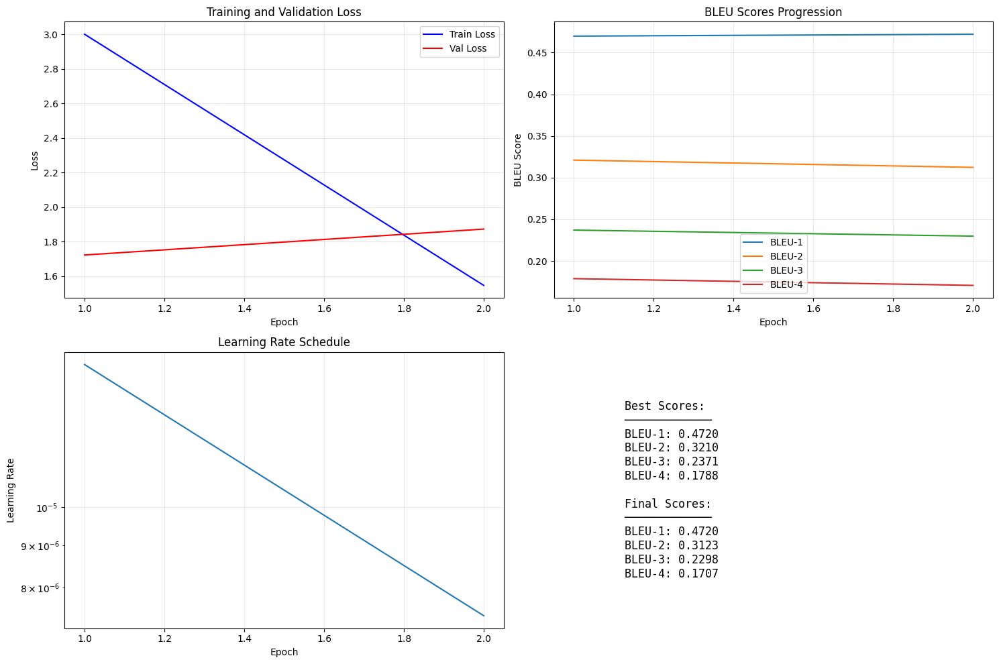

2025-08-06 11:15:32,946 - INFO - 
⏹️ Early stopping triggered!
2025-08-06 11:15:32,947 - INFO - 
2025-08-06 11:15:32,947 - INFO - 🎉 Training Complete!
2025-08-06 11:15:32,948 - INFO - Best BLEU-4: 0.1788
2025-08-06 11:15:32,949 - INFO - Final model saved to: /content/drive/MyDrive/RSICD_PROJECT/outputs/blip_large/blip_large_rsicd_v2/best_model



⏹️ Early stopping triggered!

🎉 Training Complete!
Best BLEU-4: 0.1788
Final model saved to: /content/drive/MyDrive/RSICD_PROJECT/outputs/blip_large/blip_large_rsicd_v2/best_model


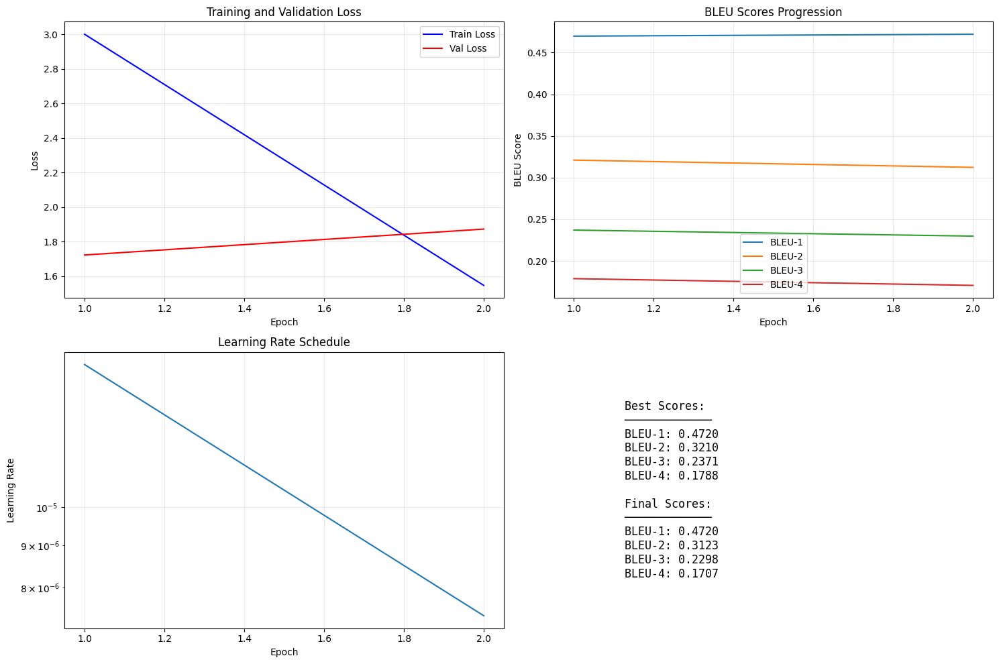

2025-08-06 11:15:34,233 - INFO - 
🧪 Testing model on test set...
2025-08-06 11:15:34,257 - INFO - ✅ Loaded 5465 samples for test
2025-08-06 11:15:34,258 - INFO - 📦 Pre-caching test images...



🧪 Testing model on test set...
✅ Loaded 5465 samples for test
📦 Pre-caching test images...


Caching: 100%|██████████| 100/100 [00:00<00:00, 917.05it/s]
2025-08-06 11:15:35,253 - INFO - 
📸 Image: 00779.jpg
2025-08-06 11:15:35,254 - INFO - GT: this irregular lawn decorated with lines of trees owns two baseball fields .
2025-08-06 11:15:35,254 - INFO - Generated: two baseball fields are surrounded by green trees and a road.



📸 Image: 00779.jpg
GT: this irregular lawn decorated with lines of trees owns two baseball fields .
Generated: two baseball fields are surrounded by green trees and a road.


2025-08-06 11:15:36,401 - INFO - 
📸 Image: viaduct_9.jpg
2025-08-06 11:15:36,403 - INFO - GT: past towering big and silly arranged very closely .
2025-08-06 11:15:36,404 - INFO - Generated: some buildings are in two sides of a road with two roads in two sides of it.



📸 Image: viaduct_9.jpg
GT: past towering big and silly arranged very closely .
Generated: some buildings are in two sides of a road with two roads in two sides of it.


2025-08-06 11:15:37,117 - INFO - 
📸 Image: 00314.jpg
2025-08-06 11:15:37,118 - INFO - GT: the area consisting of four basketball courts is located at the intersection of two busy streets .
2025-08-06 11:15:37,119 - INFO - Generated: several buildings and several roads are near a square.



📸 Image: 00314.jpg
GT: the area consisting of four basketball courts is located at the intersection of two busy streets .
Generated: several buildings and several roads are near a square.


2025-08-06 11:15:38,223 - INFO - 
📸 Image: 00854.jpg
2025-08-06 11:15:38,225 - INFO - GT: at the junction of the roads, a large baseball field comes into view .
2025-08-06 11:15:38,225 - INFO - Generated: a baseball field is near some green trees and a parking lot.



📸 Image: 00854.jpg
GT: at the junction of the roads, a large baseball field comes into view .
Generated: a baseball field is near some green trees and a parking lot.


2025-08-06 11:15:38,989 - INFO - 
📸 Image: 00683.jpg
2025-08-06 11:15:38,990 - INFO - GT: what stand beside this straight road is several airplanes with red tail wings .
2025-08-06 11:15:38,991 - INFO - Generated: three planes are parked in an airport.



📸 Image: 00683.jpg
GT: what stand beside this straight road is several airplanes with red tail wings .
Generated: three planes are parked in an airport.


2025-08-06 11:15:40,016 - INFO - 
📸 Image: 00685.jpg
2025-08-06 11:15:40,017 - INFO - GT: the planes are scattered around the huge, white building .
2025-08-06 11:15:40,017 - INFO - Generated: two planes are near a building with a parking lot in an airport.



📸 Image: 00685.jpg
GT: the planes are scattered around the huge, white building .
Generated: two planes are near a building with a parking lot in an airport.


2025-08-06 11:15:40,807 - INFO - 
📸 Image: 00894.jpg
2025-08-06 11:15:40,808 - INFO - GT: dozens of white circle buildings are situated in this rectangular area .
2025-08-06 11:15:40,808 - INFO - Generated: several white round storage tanks are near a railway.



📸 Image: 00894.jpg
GT: dozens of white circle buildings are situated in this rectangular area .
Generated: several white round storage tanks are near a railway.


2025-08-06 11:15:42,109 - INFO - 
📸 Image: viaduct_5.jpg
2025-08-06 11:15:42,110 - INFO - GT: a river, some buildings and many green trees are near a viaduct .
2025-08-06 11:15:42,111 - INFO - Generated: many green trees and several buildings are in two sides of a river with two roads.



📸 Image: viaduct_5.jpg
GT: a river, some buildings and many green trees are near a viaduct .
Generated: many green trees and several buildings are in two sides of a river with two roads.


2025-08-06 11:15:43,004 - INFO - 
📸 Image: 00128.jpg
2025-08-06 11:15:43,006 - INFO - GT: three courts consist of the exercise yard while some red buildings stand aside .
2025-08-06 11:15:43,006 - INFO - Generated: several red buildings and some green trees are near a basketball court.



📸 Image: 00128.jpg
GT: three courts consist of the exercise yard while some red buildings stand aside .
Generated: several red buildings and some green trees are near a basketball court.


2025-08-06 11:15:43,749 - INFO - 
📸 Image: 00089.jpg
2025-08-06 11:15:43,750 - INFO - GT: the playground locates in the gap between two builidngs with a swimming pool beside .
2025-08-06 11:15:43,751 - INFO - Generated: many buildings are in an industrial area.



📸 Image: 00089.jpg
GT: the playground locates in the gap between two builidngs with a swimming pool beside .
Generated: many buildings are in an industrial area.


2025-08-06 11:15:44,583 - INFO - 
📸 Image: 00368.jpg
2025-08-06 11:15:44,584 - INFO - GT: the new soccer field is located next to the baseball field and is not yet ready for use .
2025-08-06 11:15:44,585 - INFO - Generated: a playground is near a baseball field.



📸 Image: 00368.jpg
GT: the new soccer field is located next to the baseball field and is not yet ready for use .
Generated: a playground is near a baseball field.


2025-08-06 11:15:45,423 - INFO - 
📸 Image: 00420.jpg
2025-08-06 11:15:45,424 - INFO - GT: this is a shabby playground which is next to the construction site .
2025-08-06 11:15:45,425 - INFO - Generated: some green trees and several buildings are near a playground.



📸 Image: 00420.jpg
GT: this is a shabby playground which is next to the construction site .
Generated: some green trees and several buildings are near a playground.


2025-08-06 11:15:46,451 - INFO - 
📸 Image: 00574.jpg
2025-08-06 11:15:46,452 - INFO - GT: the rectanglar area contains several basketball and tennis courts and a white building .
2025-08-06 11:15:46,453 - INFO - Generated: some green trees and several buildings are near a playground with a football field in it.



📸 Image: 00574.jpg
GT: the rectanglar area contains several basketball and tennis courts and a white building .
Generated: some green trees and several buildings are near a playground with a football field in it.


2025-08-06 11:15:47,183 - INFO - 
📸 Image: 00024.jpg
2025-08-06 11:15:47,338 - INFO - GT: a tall building is right bext to the football field and blocks part of the sunshine .
2025-08-06 11:15:47,339 - INFO - Generated: many buildings are in a dense residential area.



📸 Image: 00024.jpg
GT: a tall building is right bext to the football field and blocks part of the sunshine .
Generated: many buildings are in a dense residential area.


2025-08-06 11:15:48,429 - INFO - 
📸 Image: 00717.jpg
2025-08-06 11:15:48,430 - INFO - GT: the baseball field is inside the grassland, with a basketball court and two tennis courts at the corner .
2025-08-06 11:15:48,431 - INFO - Generated: several buildings and green trees are near a baseball field and two basketball fields.



📸 Image: 00717.jpg
GT: the baseball field is inside the grassland, with a basketball court and two tennis courts at the corner .
Generated: several buildings and green trees are near a baseball field and two basketball fields.


2025-08-06 11:15:49,205 - INFO - 
📸 Image: 00029.jpg
2025-08-06 11:15:49,206 - INFO - GT: an oval football field is wreathed by some tennis courts and basketball courts .
2025-08-06 11:15:49,207 - INFO - Generated: several buildings and green trees are around a playground.



📸 Image: 00029.jpg
GT: an oval football field is wreathed by some tennis courts and basketball courts .
Generated: several buildings and green trees are around a playground.


2025-08-06 11:15:50,215 - INFO - 
📸 Image: 00534.jpg
2025-08-06 11:15:50,216 - INFO - GT: this is an orderly, tree-lined residential area with high and low scattered buildings, a standard football pitch and several tennis courts .
2025-08-06 11:15:50,217 - INFO - Generated: some buildings and green trees are around a playground in a school.



📸 Image: 00534.jpg
GT: this is an orderly, tree-lined residential area with high and low scattered buildings, a standard football pitch and several tennis courts .
Generated: some buildings and green trees are around a playground in a school.


2025-08-06 11:15:51,303 - INFO - 
📸 Image: viaduct_46.jpg
2025-08-06 11:15:51,304 - INFO - GT: there is a diamand shaped traffic system combined with a viaduct in the shape of figure of eight .
2025-08-06 11:15:51,305 - INFO - Generated: some buildings and green trees are in two sides of three roads with cars.



📸 Image: viaduct_46.jpg
GT: there is a diamand shaped traffic system combined with a viaduct in the shape of figure of eight .
Generated: some buildings and green trees are in two sides of three roads with cars.


2025-08-06 11:15:52,497 - INFO - 
📸 Image: viaduct_344.jpg
2025-08-06 11:15:52,498 - INFO - GT: several buildings with parking lots and many barelands are near a viaduct .
2025-08-06 11:15:52,499 - INFO - Generated: several buildings and many bareland are in two sides of an intersection.



📸 Image: viaduct_344.jpg
GT: several buildings with parking lots and many barelands are near a viaduct .
Generated: several buildings and many bareland are in two sides of an intersection.


2025-08-06 11:15:53,379 - INFO - 
📸 Image: 00129.jpg
2025-08-06 11:15:53,380 - INFO - GT: the playground situates in the open space near the buildings and is integrated with lush plants .
2025-08-06 11:15:53,381 - INFO - Generated: many green trees and a playground are in a school.



📸 Image: 00129.jpg
GT: the playground situates in the open space near the buildings and is integrated with lush plants .
Generated: many green trees and a playground are in a school.


2025-08-06 11:17:51,348 - INFO - 
✅ Test results saved to /content/drive/MyDrive/RSICD_PROJECT/outputs/blip_large/blip_large_rsicd_v2/test_results.json
2025-08-06 11:17:51,351 - INFO - 
✅ All done! Check the outputs folder for results.



✅ Test results saved to /content/drive/MyDrive/RSICD_PROJECT/outputs/blip_large/blip_large_rsicd_v2/test_results.json

✅ All done! Check the outputs folder for results.


In [ ]:

# Run Training

if __name__ == "__main__":
    try:
        # Verify environment
        log_and_print("="*60)
        log_and_print(" BLIP-Large Fine-tuning for RSICD")
        log_and_print("="*60)

        # Check dataset paths
        if not Path(training_args['train_json']).exists():
            log_and_print(f" Training JSON not found at {training_args['train_json']}")
            log_and_print("Please update the paths in training_args!")
        elif not Path(training_args['image_dir']).exists():
            log_and_print(f" Image directory not found at {training_args['image_dir']}")
        else:
            log_and_print(" Dataset paths verified!")

            # Run training
            model, processor, history = main(training_args)

            # Test on test set
            if Path(training_args['test_json']).exists():
                test_results = test_model_generation(
                    model, processor,
                    training_args['test_json'],
                    training_args['image_dir'],
                    torch.device('cuda'),
                    num_samples=20
                )

            log_and_print("\n All done! Check the outputs folder for results.")

    except Exception as e:
        log_and_print(f"\n Training failed with error: {e}")
        import traceback
        traceback.print_exc()
        raise

#### Blip1 Large Plots Loss and Accuracy Curve

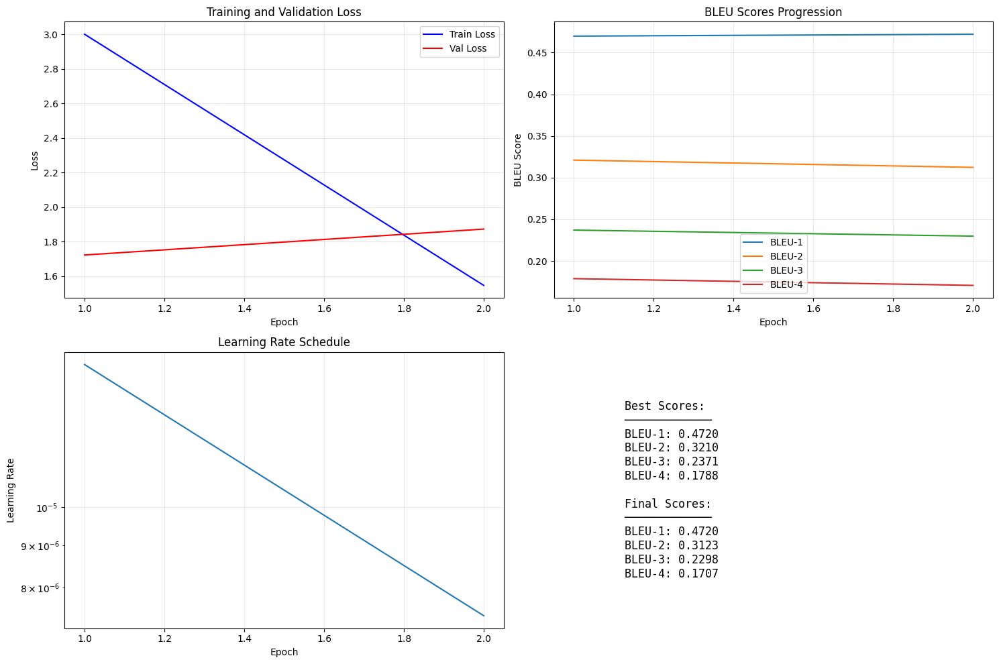

In [ ]:

# Load history
with open(OUTPUT_DIR / "training_history.json", "r") as f:
    history = json.load(f)

plot_training_progress(history, OUTPUT_DIR)

#### Blip1 Large Evaluate Model on Test.json

In [ ]:



"""
BLIP-Large Evaluation Script
Evaluates the trained model on test set with comprehensive metrics
"""

# Install required packages



# Configuration - UPDATE THESE PATHS

# Option 1: If you saved using the training script
MODEL_DIR = OUTPUT_DIR / "best_model"

# Option 2: If you want to test a specific checkpoint
# MODEL_DIR = OUTPUT_DIR / "checkpoints/last_checkpoint.pth"  # Will need different loading

# Dataset paths
TEST_JSON = Path(GLOBAL_ARGS['test_json'])
IMAGE_DIR = Path(GLOBAL_ARGS['image_dir'])

# Output paths for results
OUT_COCO_V2 = OUTPUT_DIR / "v2_generated_captions_coco_format.json"
OUT_DEBUG_V2 = OUTPUT_DIR / "v2_generated_captions_debug.json"
OUT_METRICS_V2 = OUTPUT_DIR / "v2_evaluation_metrics.json"


# Setup

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")


# Load Model and Processor

print("\n Loading BLIP-Large model...")
print(f"Model directory: {MODEL_DIR}")

# Check if model directory exists
if not MODEL_DIR.exists():
    print(f" Model directory not found: {MODEL_DIR}")
    print("Available directories:")
    if OUTPUT_DIR.exists():
        for item in OUTPUT_DIR.iterdir():
            print(f"  - {item}")
    raise FileNotFoundError(f"Model not found at {MODEL_DIR}")

# Load processor and model
processor = BlipProcessor.from_pretrained(MODEL_DIR)
model = BlipForConditionalGeneration.from_pretrained(
    MODEL_DIR,
    torch_dtype=torch.float16  # Use FP16 for faster inference
).to(device)
model.eval()

print(f" Model loaded successfully")
print(f"Model config: {model.config.text_config.vocab_size} vocab size")


# Load Test Data

print("\n Loading test dataset...")

# Check if test data exists
if not TEST_JSON.exists():
    raise FileNotFoundError(f"Test JSON not found: {TEST_JSON}")
if not IMAGE_DIR.exists():
    raise FileNotFoundError(f"Image directory not found: {IMAGE_DIR}")

with open(TEST_JSON) as f:
    test_data = json.load(f)

# Create mappings
id_to_file = {img["id"]: img["file_name"] for img in test_data["images"]}
annotations = {}
for ann in test_data["annotations"]:
    annotations.setdefault(ann["image_id"], []).append(ann["caption"])

print(f" Loaded {len(id_to_file)} test images")
print(f" Loaded {len(test_data['annotations'])} annotations")


# Generation Configurations

generation_configs = {
    "beam_search_5": {
        "max_new_tokens": 30,
        "num_beams": 5,
        "early_stopping": True,
        "no_repeat_ngram_size": 3,
        "length_penalty": 1.0,
        "repetition_penalty": 1.2
    },
    "beam_search_3": {
        "max_new_tokens": 30,
        "num_beams": 3,
        "early_stopping": True,
        "no_repeat_ngram_size": 3,
    },
    "sampling": {
        "max_new_tokens": 30,
        "do_sample": True,
        "top_k": 50,
        "top_p": 0.95,
        "temperature": 0.8,
        "no_repeat_ngram_size": 3,
    }
}

# Select which configuration to use
SELECTED_CONFIG = "beam_search_5"
gen_config = generation_configs[SELECTED_CONFIG]

print(f"\n Generation configuration: {SELECTED_CONFIG}")
for key, value in gen_config.items():
    print(f"  {key}: {value}")


# Generate Captions

print(f"\n Generating captions for {len(id_to_file)} images...")

debug_results = []
coco_results = []
failed_images = []

# Add timing
start_time = time.time()

# Process in batches for efficiency
BATCH_SIZE = 8  # Adjust based on GPU memory
image_ids = list(id_to_file.keys())

with torch.no_grad():
    for i in tqdm(range(0, len(image_ids), BATCH_SIZE), desc="Generating"):
        batch_ids = image_ids[i:i+BATCH_SIZE]
        batch_images = []

        # Load batch of images
        for img_id in batch_ids:
            try:
                img_path = IMAGE_DIR / id_to_file[img_id]
                img = Image.open(img_path).convert("RGB")
                batch_images.append(img)
            except Exception as e:
                print(f" Failed to load image {id_to_file[img_id]}: {e}")
                failed_images.append(img_id)
                continue

        if not batch_images:
            continue

        # Process batch
        try:
            inputs = processor(images=batch_images, return_tensors="pt", padding=True).to(device)

            # Generate with FP16
            with torch.cuda.amp.autocast():
                outputs = model.generate(**inputs, **gen_config)

            # Decode captions
            for j, img_id in enumerate(batch_ids[:len(outputs)]):
                caption = processor.decode(outputs[j], skip_special_tokens=True)

                # Save results
                debug_results.append({
                    "image_id": img_id,
                    "file_name": id_to_file[img_id],
                    "generated": caption,
                    "ground_truth": annotations.get(img_id, [])
                })

                coco_results.append({
                    "image_id": img_id,
                    "caption": caption
                })

        except Exception as e:
            print(f" Generation failed for batch: {e}")
            for img_id in batch_ids:
                failed_images.append(img_id)

# Calculate generation time
total_time = time.time() - start_time
print(f"\n Generation complete!")
print(f"  Time taken: {total_time:.1f} seconds")
print(f"  Average per image: {total_time/len(image_ids):.2f} seconds")
if failed_images:
    print(f"   Failed images: {len(failed_images)}")


# Save Outputs

print("\n Saving results...")

# Create output directory if needed
OUTPUT_DIR.mkdir(parents=True, exist_ok=True)

# Save debug output (human-readable)
with open(OUT_DEBUG_V2, "w") as f:
    json.dump(debug_results, f, indent=2)

# Save COCO format (for evaluation)
with open(OUT_COCO_V2, "w") as f:
    json.dump(coco_results, f)

print(f" Saved results:")
print(f"  - COCO format: {OUT_COCO_V2}")
print(f"  - Debug format: {OUT_DEBUG_V2}")


# Display Sample Results

print("\n Sample generated captions:")
for i in range(min(5, len(debug_results))):
    result = debug_results[i]
    print(f"\n Image: {result['file_name']}")
    print(f"  Generated: {result['generated']}")
    if result['ground_truth']:
        print(f"  Reference: {result['ground_truth'][0]}")


# Evaluate with COCO Metrics

print("\n Computing evaluation metrics...")

try:
    from pycocotools.coco import COCO
    from pycocoevalcap.eval import COCOEvalCap

    # Load ground truth and predictions
    coco = COCO(TEST_JSON)
    coco_res = coco.loadRes(str(OUT_COCO_V2))

    # Evaluate
    coco_eval = COCOEvalCap(coco, coco_res)
    coco_eval.evaluate()

    # Get metrics
    metrics = coco_eval.eval

    # Save metrics to file
    with open(OUT_METRICS_V2, "w") as f:
        json.dump(metrics, f, indent=2)

    # Display formatted results
    print("\n" + "="*80)
    print(" BLIP-Large Evaluation Results on RSICD Test Set")
    print("="*80)

    print("\n| Metric   | Score  |")
    print("|----------|--------|")
    print(f"| BLEU-1   | {metrics['Bleu_1']:.4f} |")
    print(f"| BLEU-2   | {metrics['Bleu_2']:.4f} |")
    print(f"| BLEU-3   | {metrics['Bleu_3']:.4f} |")
    print(f"| BLEU-4   | {metrics['Bleu_4']:.4f} |")
    print(f"| METEOR   | {metrics['METEOR']:.4f} |")
    print(f"| ROUGE_L  | {metrics['ROUGE_L']:.4f} |")
    print(f"| CIDEr    | {metrics['CIDEr']:.4f} |")
    print(f"| SPICE    | {metrics['SPICE']:.4f} |")

    # Comparison table with expected BLIP-base scores
    print("\n Comparison with BLIP-Base (expected):")
    print("\n| Model      | BLEU-1 | BLEU-2 | BLEU-3 | BLEU-4 | METEOR | ROUGE_L | CIDEr  |")
    print("|------------|--------|--------|--------|--------|--------|---------|--------|")
    print(f"| BLIP-Large | {metrics['Bleu_1']:.4f} | {metrics['Bleu_2']:.4f} | {metrics['Bleu_3']:.4f} | {metrics['Bleu_4']:.4f} | {metrics['METEOR']:.4f} | {metrics['ROUGE_L']:.4f} | {metrics['CIDEr']:.4f} |")
    print(f"| BLIP-Base  | 0.6809 | 0.5071 | 0.3865 | 0.3027 | 0.2579 | 0.4794 | 0.5864 |")

    # Calculate improvements
    base_bleu4 = 0.3027
    improvement = ((metrics['Bleu_4'] - base_bleu4) / base_bleu4) * 100
    print(f"\n BLEU-4 Improvement: {improvement:+.1f}%")

except ImportError:
    print(" pycocoevalcap not installed. Install with:")
    print("!pip install pycocotools pycocoevalcap")
    print("\nShowing basic metrics only...")

    # Basic evaluation without pycocoevalcap
    from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
    smoothing = SmoothingFunction().method1

    bleu_scores = []
    for result in debug_results[:100]:  # Sample evaluation
        if result['ground_truth']:
            pred = result['generated'].lower().split()
            refs = [gt.lower().split() for gt in result['ground_truth']]
            score = sentence_bleu(refs, pred, weights=(0.25, 0.25, 0.25, 0.25),
                                smoothing_function=smoothing)
            bleu_scores.append(score)

    if bleu_scores:
        avg_bleu = sum(bleu_scores) / len(bleu_scores)
        print(f"\n Sample BLEU-4 (100 images): {avg_bleu:.4f}")

print("\n Evaluation complete!")
print(f"All results saved to: {OUTPUT_DIR}")

Using device: cuda

📦 Loading BLIP-Large model...
Model directory: /content/drive/MyDrive/RSICD_PROJECT/outputs/blip_large/blip_large_rsicd_v2/best_model
✅ Model loaded successfully
Model config: 30524 vocab size

📂 Loading test dataset...
✅ Loaded 1093 test images
✅ Loaded 5465 annotations

⚙️ Generation configuration: beam_search_5
  max_new_tokens: 30
  num_beams: 5
  early_stopping: True
  no_repeat_ngram_size: 3
  length_penalty: 1.0
  repetition_penalty: 1.2

🚀 Generating captions for 1093 images...


Generating: 100%|██████████| 137/137 [01:36<00:00,  1.43it/s]



✅ Generation complete!
  Time taken: 96.1 seconds
  Average per image: 0.09 seconds

💾 Saving results...
✅ Saved results:
  - COCO format: /content/drive/MyDrive/RSICD_PROJECT/outputs/blip_large/blip_large_rsicd_v2/v2_generated_captions_coco_format.json
  - Debug format: /content/drive/MyDrive/RSICD_PROJECT/outputs/blip_large/blip_large_rsicd_v2/v2_generated_captions_debug.json

📝 Sample generated captions:

 Image: viaduct_322.jpg
  Generated: some buildings are in two sides of a railway station.
  Reference: many buildings and green meadows are near a viaduct .

 Image: viaduct_323.jpg
  Generated: many buildings are in two sides of a railway station.
  Reference: some buildings and barelands are near a viaduct .

 Image: viaduct_324.jpg
  Generated: many buildings are in two sides of a road with many cars.
  Reference: some buildings and barelands are near a viaduct .

 Image: viaduct_325.jpg
  Generated: some buildings and green trees are in two sides of a road with many cars.
  R

#### Comparison with BLIP-Base:

| Model      | BLEU-1 | BLEU-2 | BLEU-3 | BLEU-4 | METEOR | ROUGE_L | CIDEr  |
|------------|--------|--------|--------|--------|--------|---------|--------|
| BLIP-Base  | 0.6809 | 0.5071 | 0.3865 | 0.3027 | 0.2579 | 0.4794 | 0.5864 |
| BLIP-Large | 0.7387 | 0.5773 | 0.4584 | 0.3719 | 0.2999 | 0.5397 | 0.8822 |

Our hypothesis was correct as BLIP-1 Large has generated a better metric than Blip-1 Base and other baseline models.

#### Blip1 Large Caption Comparison on Specific Images

Loading model...


2025-08-06 05:00:33,951 - INFO - ✅ Loaded 5465 samples for test


📂 Loading dataset with metadata...
✅ Loaded 5465 samples for test
✅ Dataset loaded: 5465 samples



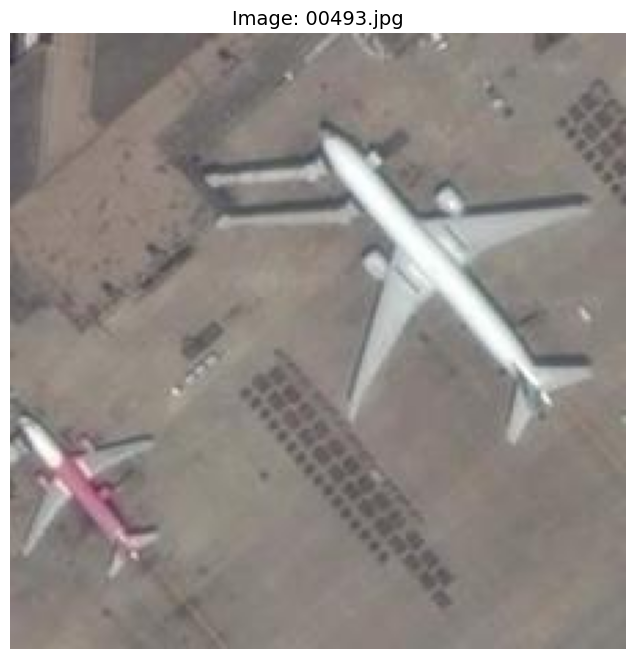


📊 Evaluation for: 00493.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:34,515 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.5971
  BLEU-2: 0.4137
  BLEU-3: 0.3156
  BLEU-4: 0.1645
  ROUGE-L: 0.7692

------------------------------------------------------------


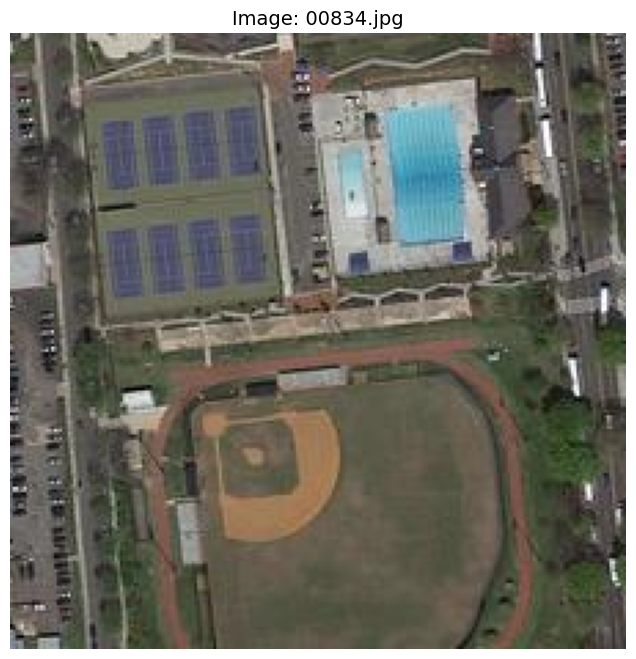


📊 Evaluation for: 00834.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:35,356 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.6000
  BLEU-2: 0.5477
  BLEU-3: 0.4904
  BLEU-4: 0.4429
  ROUGE-L: 0.6667

------------------------------------------------------------


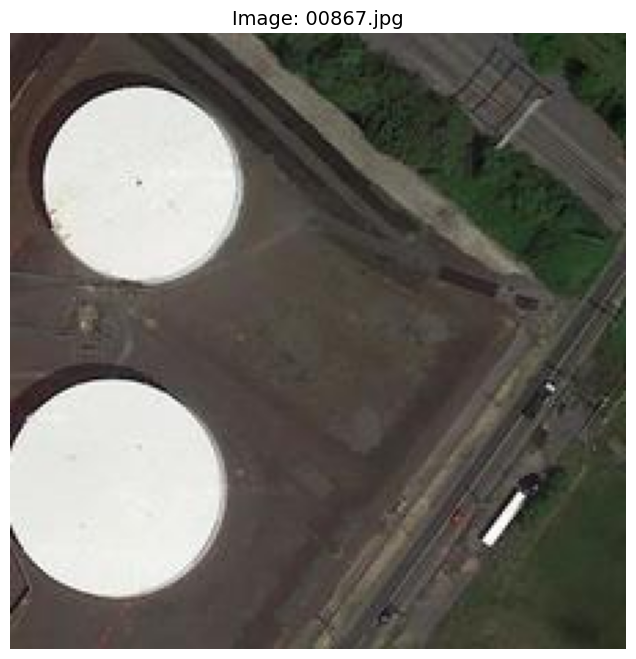


📊 Evaluation for: 00867.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:35,990 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.6667
  BLEU-2: 0.4264
  BLEU-3: 0.1246
  BLEU-4: 0.0670
  ROUGE-L: 0.7000

------------------------------------------------------------


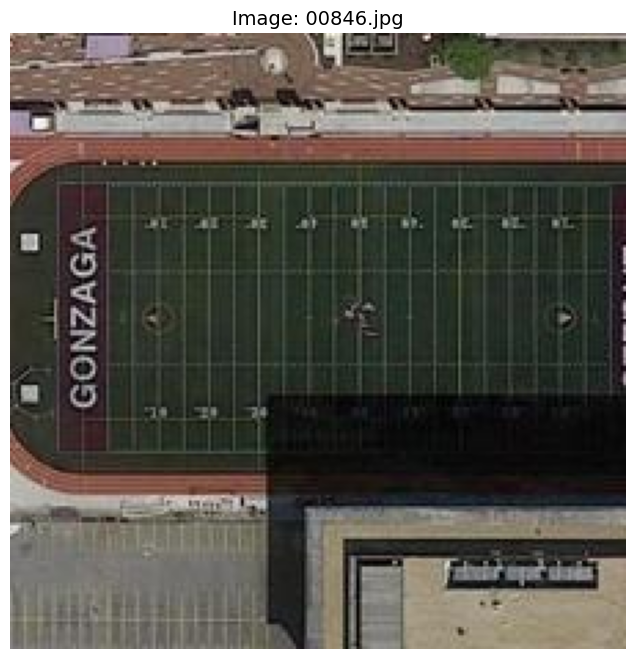


📊 Evaluation for: 00846.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:36,590 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.6000
  BLEU-2: 0.3651
  BLEU-3: 0.1211
  BLEU-4: 0.0699
  ROUGE-L: 0.2353

------------------------------------------------------------


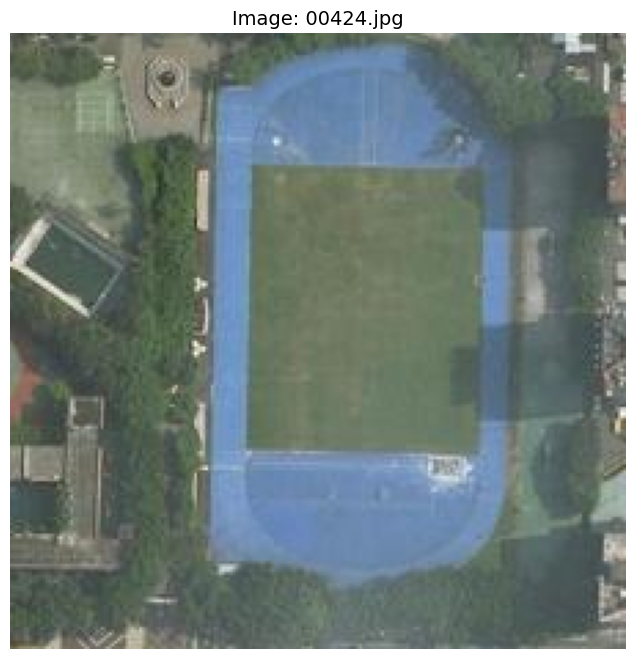


📊 Evaluation for: 00424.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:37,281 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.7118
  BLEU-2: 0.6538
  BLEU-3: 0.5823
  BLEU-4: 0.4780
  ROUGE-L: 0.9474

------------------------------------------------------------


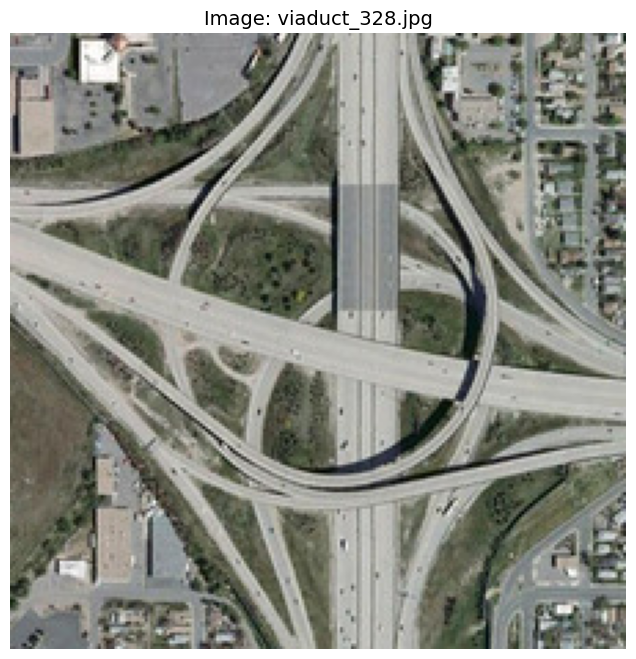


📊 Evaluation for: viaduct_328.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:38,071 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.5000
  BLEU-2: 0.2132
  BLEU-3: 0.0789
  BLEU-4: 0.0474
  ROUGE-L: 0.3478

------------------------------------------------------------


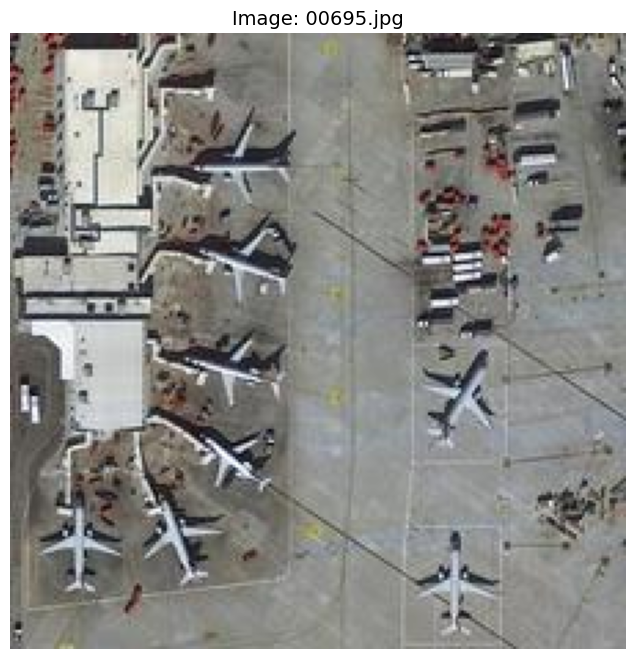


📊 Evaluation for: 00695.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:38,687 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.6000
  BLEU-2: 0.3651
  BLEU-3: 0.2589
  BLEU-4: 0.1242
  ROUGE-L: 0.6316

------------------------------------------------------------


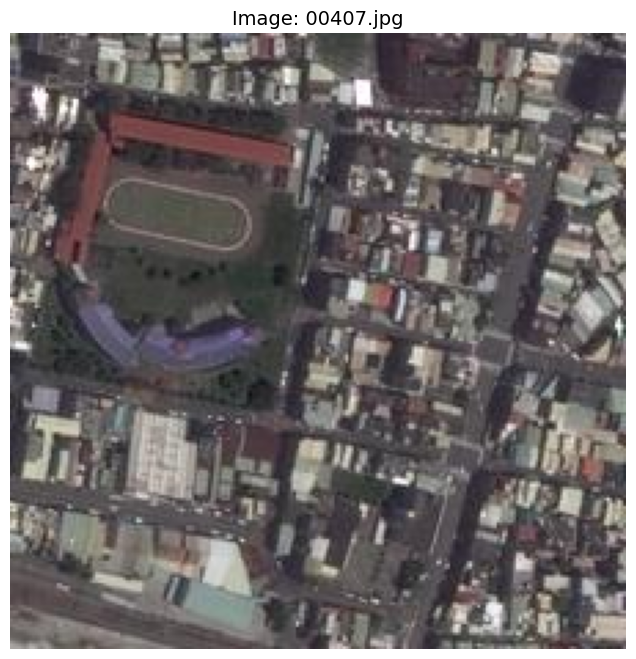


📊 Evaluation for: 00407.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:39,301 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.5573
  BLEU-2: 0.4996
  BLEU-3: 0.4695
  BLEU-4: 0.4374
  ROUGE-L: 0.6000

------------------------------------------------------------


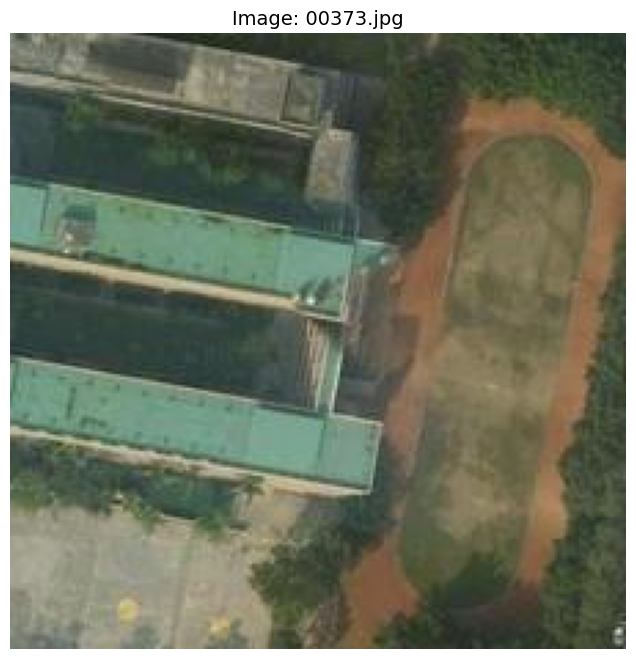


📊 Evaluation for: 00373.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:39,921 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.6550
  BLEU-2: 0.4882
  BLEU-3: 0.2930
  BLEU-4: 0.1300
  ROUGE-L: 0.3810

------------------------------------------------------------


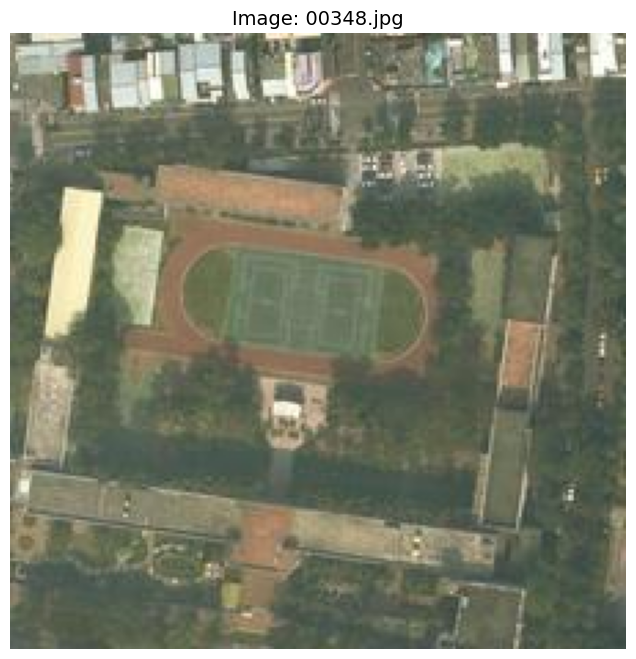


📊 Evaluation for: 00348.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:40,603 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.7954
  BLEU-2: 0.7892
  BLEU-3: 0.7828
  BLEU-4: 0.7726
  ROUGE-L: 1.0000

------------------------------------------------------------


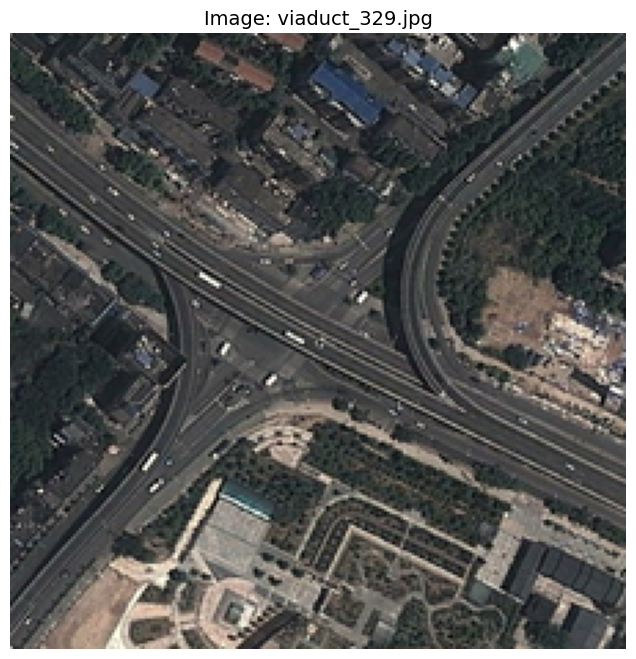


📊 Evaluation for: viaduct_329.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:41,396 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.5000
  BLEU-2: 0.3015
  BLEU-3: 0.2120
  BLEU-4: 0.1003
  ROUGE-L: 0.3636

------------------------------------------------------------


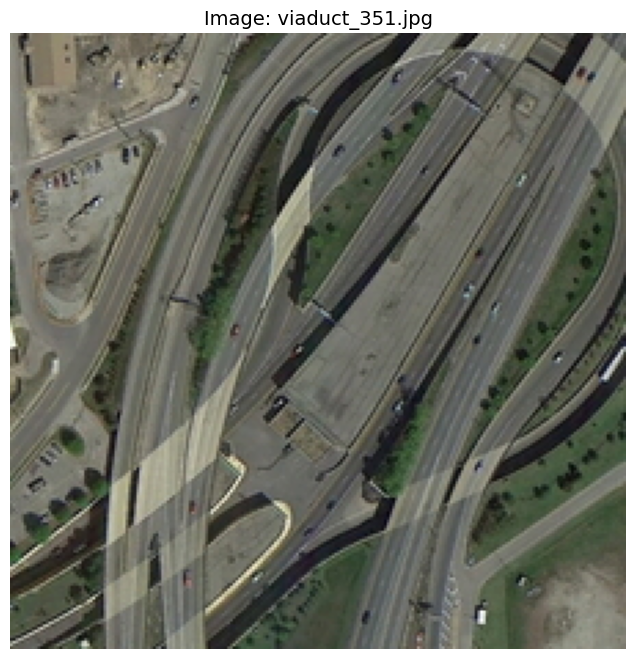


📊 Evaluation for: viaduct_351.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:42,132 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.6154
  BLEU-2: 0.3922
  BLEU-3: 0.2444
  BLEU-4: 0.1087
  ROUGE-L: 0.4545

------------------------------------------------------------


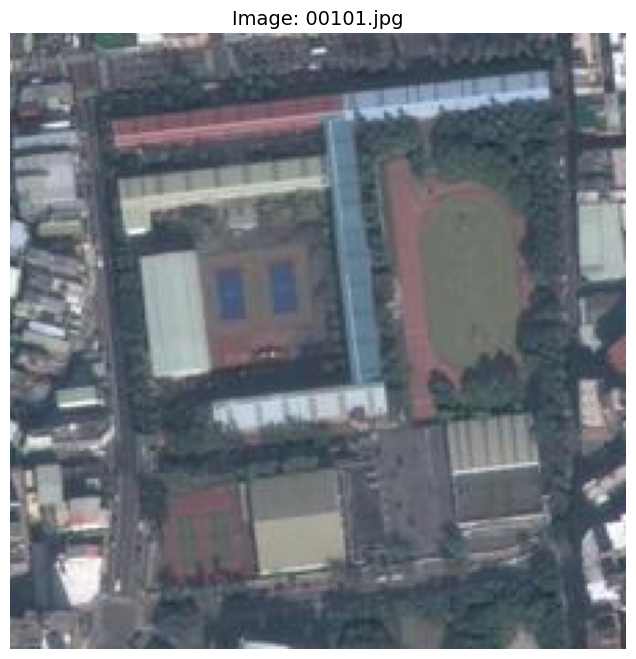


📊 Evaluation for: 00101.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:42,827 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.7500
  BLEU-2: 0.6908
  BLEU-3: 0.6232
  BLEU-4: 0.5311
  ROUGE-L: 0.6923

------------------------------------------------------------


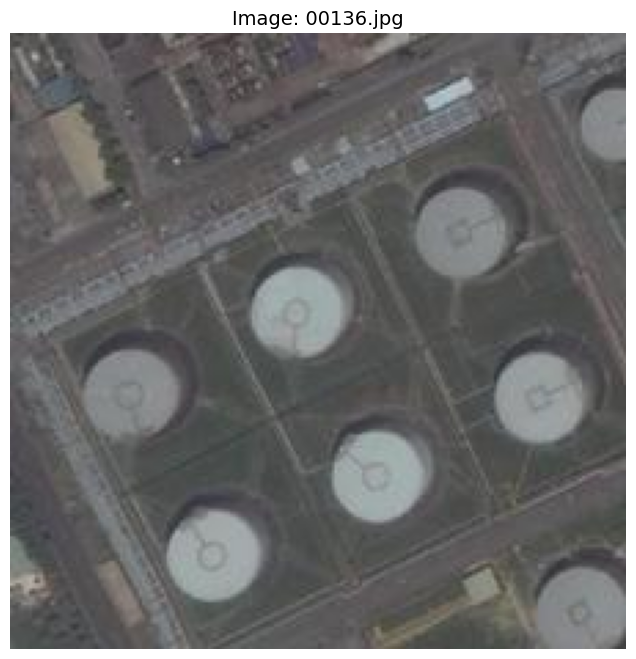


📊 Evaluation for: 00136.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:43,461 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.4000
  BLEU-2: 0.2108
  BLEU-3: 0.0843
  BLEU-4: 0.0531
  ROUGE-L: 0.5263

------------------------------------------------------------


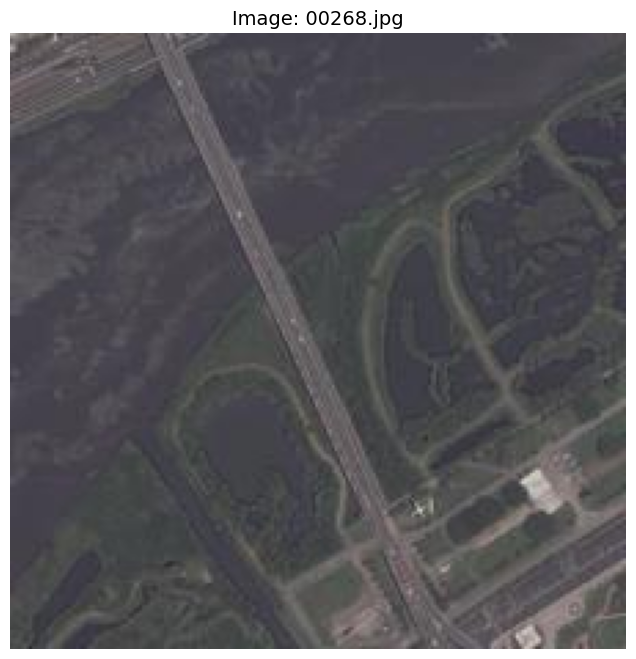


📊 Evaluation for: 00268.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:44,146 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.5333
  BLEU-2: 0.3381
  BLEU-3: 0.2097
  BLEU-4: 0.0925
  ROUGE-L: 0.2759

------------------------------------------------------------


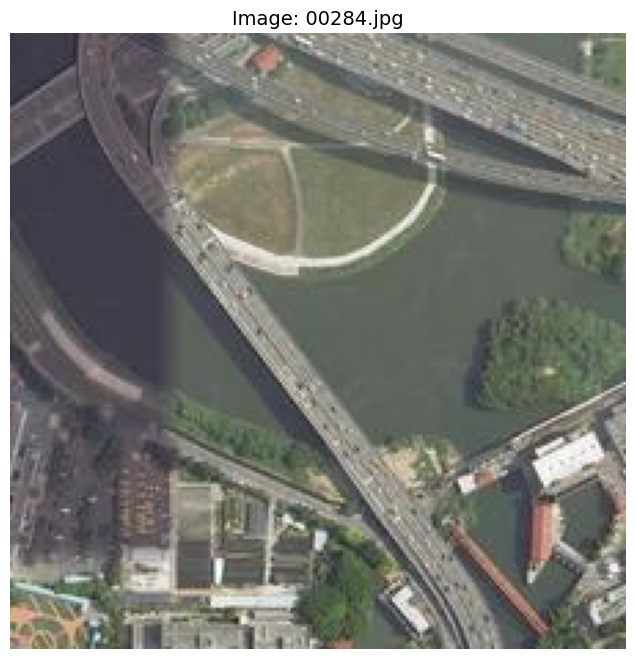


📊 Evaluation for: 00284.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:44,989 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.7778
  BLEU-2: 0.5239
  BLEU-3: 0.3757
  BLEU-4: 0.2420
  ROUGE-L: 0.3333

------------------------------------------------------------


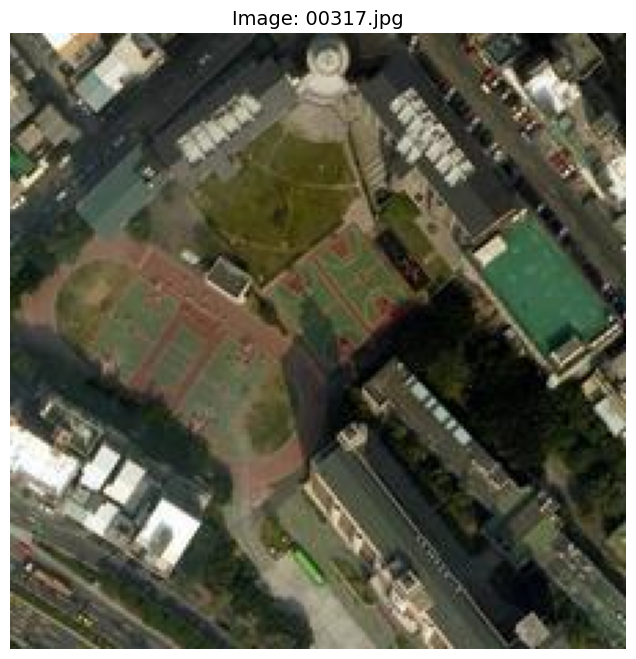


📊 Evaluation for: 00317.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:45,644 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.3188
  BLEU-2: 0.1512
  BLEU-3: 0.0586
  BLEU-4: 0.0366
  ROUGE-L: 0.2727

------------------------------------------------------------


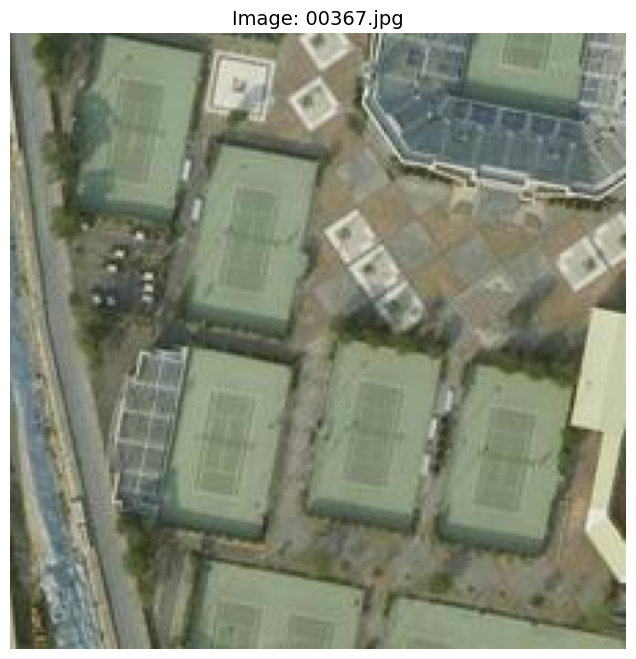


📊 Evaluation for: 00367.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:46,343 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.4286
  BLEU-2: 0.3631
  BLEU-3: 0.2837
  BLEU-4: 0.2114
  ROUGE-L: 0.5455

------------------------------------------------------------


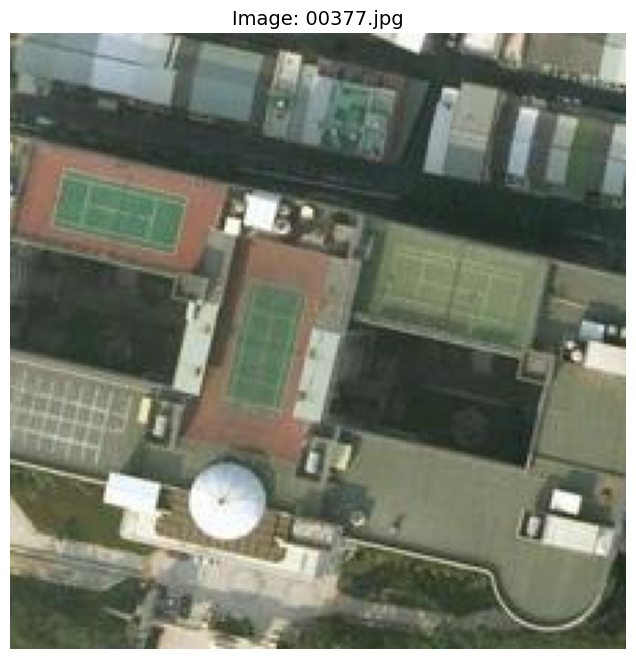


📊 Evaluation for: 00377.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:47,037 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.3320
  BLEU-2: 0.1741
  BLEU-3: 0.0693
  BLEU-4: 0.0433
  ROUGE-L: 0.3158

------------------------------------------------------------


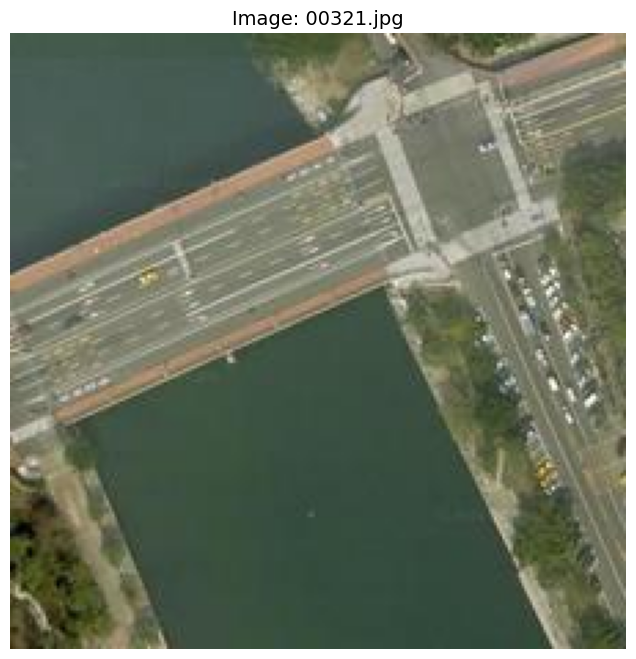


📊 Evaluation for: 00321.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:47,700 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.8667
  BLEU-2: 0.7868
  BLEU-3: 0.7273
  BLEU-4: 0.6606
  ROUGE-L: 0.7742

------------------------------------------------------------


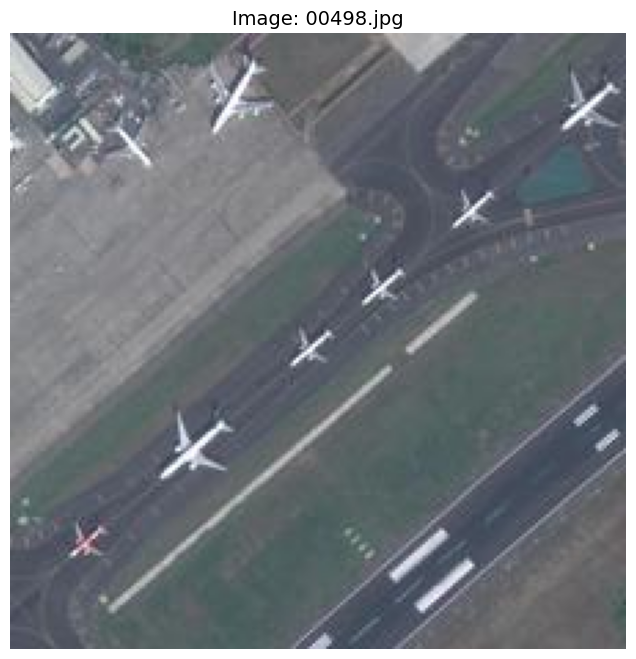


📊 Evaluation for: 00498.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:48,249 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.3723
  BLEU-2: 0.2843
  BLEU-3: 0.1036
  BLEU-4: 0.0644
  ROUGE-L: 0.5000

------------------------------------------------------------


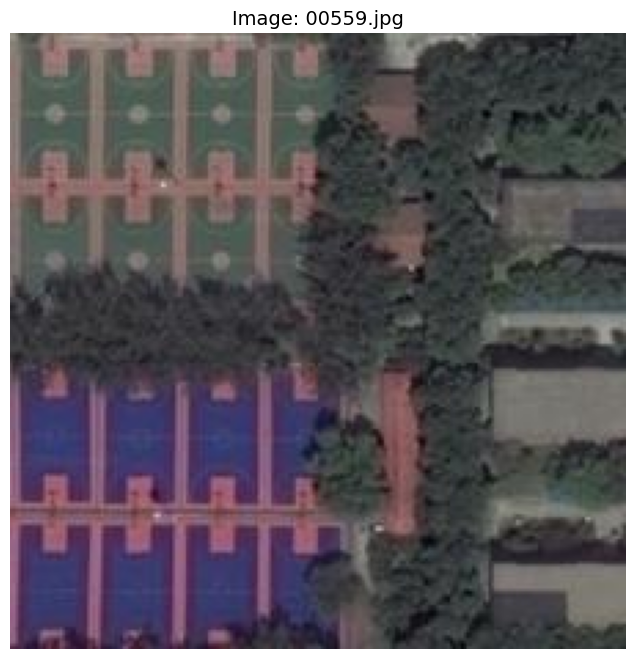


📊 Evaluation for: 00559.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:48,910 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.6667
  BLEU-2: 0.5000
  BLEU-3: 0.3330
  BLEU-4: 0.1562
  ROUGE-L: 0.4545

------------------------------------------------------------


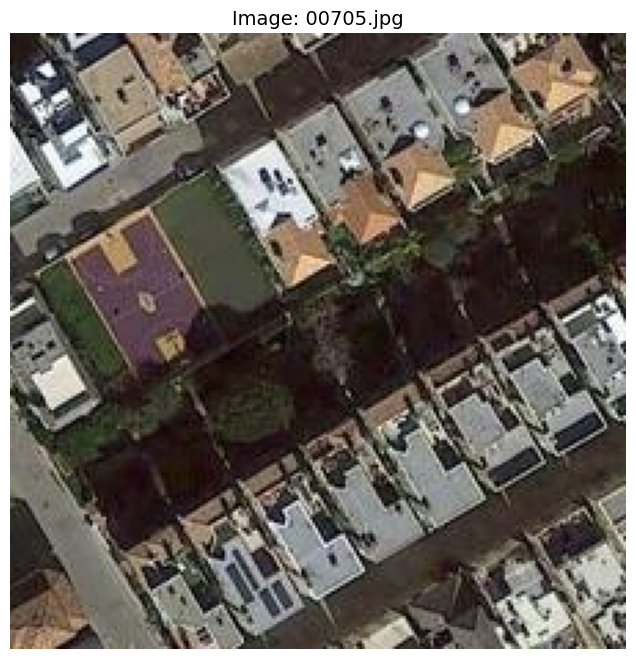


📊 Evaluation for: 00705.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:49,511 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.5000
  BLEU-2: 0.3333
  BLEU-3: 0.1140
  BLEU-4: 0.0667
  ROUGE-L: 0.2308

------------------------------------------------------------


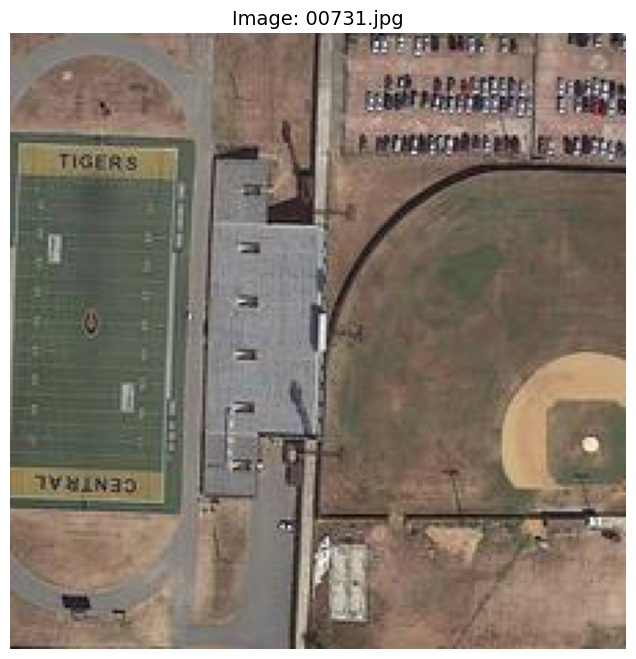


📊 Evaluation for: 00731.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:50,154 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.7500
  BLEU-2: 0.7385
  BLEU-3: 0.6917
  BLEU-4: 0.6176
  ROUGE-L: 0.6957

------------------------------------------------------------


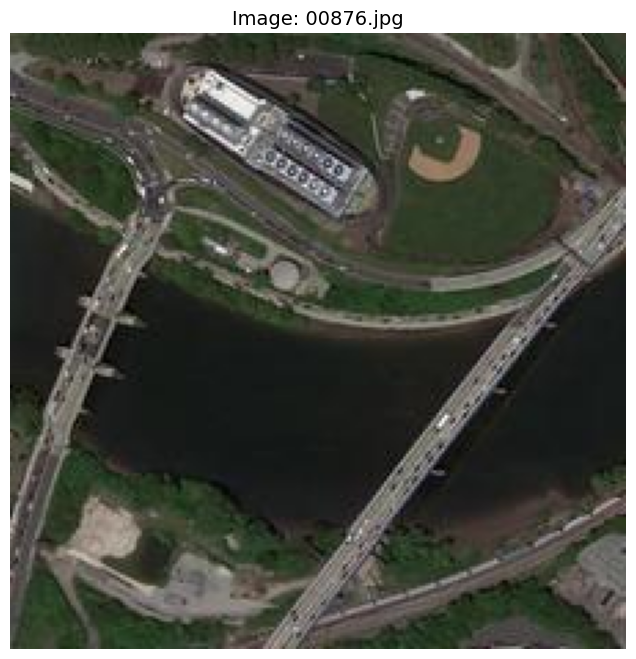


📊 Evaluation for: 00876.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:50,894 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.7333
  BLEU-2: 0.7237
  BLEU-3: 0.7155
  BLEU-4: 0.7012
  ROUGE-L: 0.8571

------------------------------------------------------------


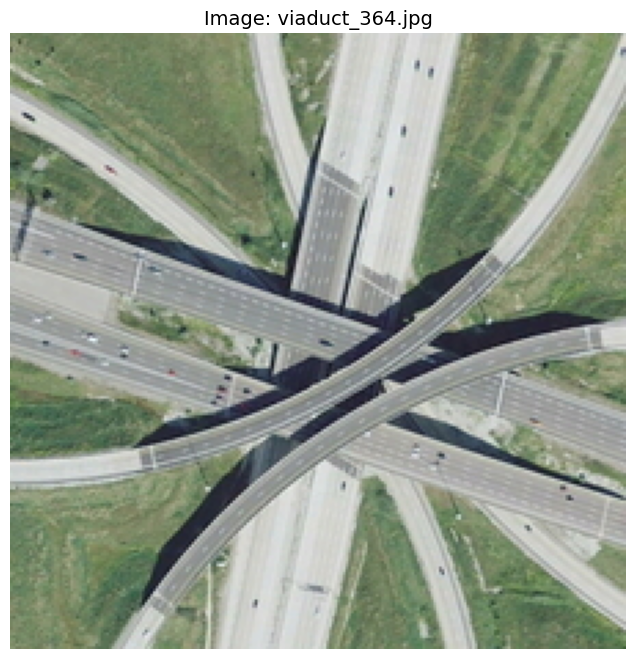


📊 Evaluation for: viaduct_364.jpg

📄 Ground Truth Captions:



🤖 Generated Caption:



📈 Metric Analysis (highlighted matches):


2025-08-06 05:00:51,539 - INFO - Using default tokenizer.



📊 Computed Scores:
  BLEU-1: 0.4545
  BLEU-2: 0.0674
  BLEU-3: 0.0382
  BLEU-4: 0.0282
  ROUGE-L: 0.3158

------------------------------------------------------------


In [ ]:

"""
Single Image Evaluation with Metric Visualization
Shows BLEU and ROUGE scores with highlighting for specific images
"""

# Dataset Class Fix - Add necessary attributes

class RSICDDatasetOptimizedWithMetadata(RSICDDatasetOptimized):
    """Extended dataset with metadata access for evaluation"""

    def __init__(self, json_path, image_dir, processor, split='test', cache_images=False):
        super().__init__(json_path, image_dir, processor, split, cache_images)

        # Create mappings for easy lookup
        self.filename_to_index = {}
        self.image_ids = []
        self.id_to_filename = {}

        # Load the JSON data for metadata
        with open(json_path, 'r') as f:
            data = json.load(f)

        # Build id to filename mapping
        for img in data['images']:
            self.id_to_filename[img['id']] = img['file_name']
            self.image_ids.append(img['id'])

        # Build filename to sample index mapping
        for idx, sample in enumerate(self.samples):
            filename = sample['file_name']
            if filename not in self.filename_to_index:
                self.filename_to_index[filename] = []
            self.filename_to_index[filename].append(idx)


# Improved Evaluation Function

def show_specific_example_with_metric(image_filename, dataset, model, processor, device='cuda'):
    """
    Evaluate and visualize metrics for a specific image

    Args:
        image_filename: Name of the image file
        dataset: Dataset object
        model: Trained model
        processor: Model processor
        device: Device to run on
    """
    model.eval()

    # Method 1: Try using filename_to_index if available
    if hasattr(dataset, 'filename_to_index'):
        if image_filename not in dataset.filename_to_index:
            print(f" Image {image_filename} not found in dataset.")
            return

        # Get first index for this filename (there may be multiple captions)
        indices = dataset.filename_to_index[image_filename]
        index = indices[0]
    else:
        # Method 2: Search through samples
        index = None
        for i, sample in enumerate(dataset.samples):
            if sample['file_name'] == image_filename:
                index = i
                break

        if index is None:
            print(f" Image {image_filename} not found in dataset.")
            return

    # Get sample
    sample = dataset[index]
    if sample is None:
        print(f" Failed to load sample for {image_filename}")
        return

    pixel_values = sample['pixel_values']
    reference_captions = sample['all_captions']

    # Load original image
    image_path = dataset.image_dir / image_filename
    if not image_path.exists():
        print(f" Image file not found: {image_path}")
        return

    original_image = Image.open(image_path).convert("RGB")

    # Move to device
    pixel_values_batch = pixel_values.unsqueeze(0).to(device)

    # Generate caption
    with torch.no_grad():
        # Simple beam search generation
        output_ids = model.generate(
            pixel_values_batch,
            max_length=30,
            num_beams=5,
            early_stopping=True,
            no_repeat_ngram_size=3,
            repetition_penalty=1.2
        )
        generated_caption = processor.decode(output_ids[0], skip_special_tokens=True)

    # Tokenize for analysis
    gen_tokens = re.findall(r"\b\w+\b", generated_caption.lower())

    # Create reference token set
    ref_tokens_all = []
    for caption in reference_captions:
        ref_tokens_all += re.findall(r"\b\w+\b", caption.lower())
    ref_word_set = set(ref_tokens_all)


    # BLEU N-gram Highlighting Functions

    def get_ngrams(tokens, n):
        """Extract n-grams from token list"""
        return set(tuple(tokens[i:i+n]) for i in range(len(tokens)-n+1)) if len(tokens) >= n else set()

    def bleu_n_highlight(gen_tokens, ref_tokens, n, color):
        """Highlight n-gram matches"""
        if len(gen_tokens) < n:
            return ' '.join(gen_tokens)

        gen_ngrams = get_ngrams(gen_tokens, n)
        ref_ngrams = get_ngrams(ref_tokens, n)
        matches = gen_ngrams & ref_ngrams

        result = []
        i = 0
        while i < len(gen_tokens):
            if i + n <= len(gen_tokens):
                ngram = tuple(gen_tokens[i:i+n])
                if ngram in matches:
                    result.append(f"<span style='background-color:{color}; padding:2px'>{' '.join(ngram)}</span>")
                    i += n
                else:
                    result.append(gen_tokens[i])
                    i += 1
            else:
                result.append(gen_tokens[i])
                i += 1
        return ' '.join(result)

    # Create highlighted versions
    bleu1_html = ' '.join([
        f"<span style='background-color:#FFE4B5; padding:2px'>{w}</span>" if w in ref_word_set else w
        for w in gen_tokens
    ])
    bleu2_html = bleu_n_highlight(gen_tokens, ref_tokens_all, 2, "#FFD700")
    bleu3_html = bleu_n_highlight(gen_tokens, ref_tokens_all, 3, "#FFA500")
    bleu4_html = bleu_n_highlight(gen_tokens, ref_tokens_all, 4, "#FF8C00")


    # ROUGE-L (Longest Common Subsequence) Highlighting

    def lcs(a, b):
        """Find longest common subsequence"""
        sm = SequenceMatcher(None, a, b)
        return [a[i] for i, j, n in sm.get_matching_blocks() if n > 0 for i in range(i, i + n)]

    # Find best matching reference caption
    best_lcs = []
    best_caption_idx = -1
    for idx, caption in enumerate(reference_captions):
        ref = re.findall(r"\b\w+\b", caption.lower())
        lcs_seq = lcs(gen_tokens, ref)
        if len(lcs_seq) > len(best_lcs):
            best_lcs = lcs_seq
            best_caption_idx = idx

    best_lcs_set = set(best_lcs)
    rouge_gen_html = ' '.join([
        f"<span style='background-color:#90EE90; padding:2px'><b>{w}</b></span>" if w in best_lcs_set else w
        for w in gen_tokens
    ])


    # Display Results

    # Show image
    plt.figure(figsize=(8, 8))
    plt.imshow(original_image)
    plt.title(f"Image: {image_filename}", fontsize=14)
    plt.axis('off')
    plt.show()

    print(f"\n{'='*60}")
    print(f" Evaluation for: {image_filename}")
    print(f"{'='*60}\n")

    # Display ground truth captions
    print(" Ground Truth Captions:")
    gt_lines = []
    for j, ref in enumerate(reference_captions):
        if j == best_caption_idx:
            # Highlight the best matching reference
            ref_words = ref.split()
            highlighted = ' '.join(
                f"<span style='background-color:#90EE90; padding:2px'><b>{w}</b></span>"
                if w.lower() in best_lcs_set else w
                for w in ref_words
            )
            line = f"<b>{j+1}. [Best ROUGE-L match]</b> {highlighted}"
        else:
            line = f"<b>{j+1}.</b> {ref}"
        gt_lines.append(f"<div style='margin: 5px 0; margin-left: 20px'>{line}</div>")
    display(HTML("".join(gt_lines)))

    # Display generated caption
    print("\n Generated Caption:")
    display(HTML(f"<div style='margin-left: 20px; font-size: 16px'><b>{generated_caption}</b></div>"))

    # Display metric highlighting
    print("\n Metric Analysis (highlighted matches):")

    metric_explanations = {
        "BLEU-1": ("Unigram matches", "#FFE4B5"),
        "BLEU-2": ("Bigram matches", "#FFD700"),
        "BLEU-3": ("Trigram matches", "#FFA500"),
        "BLEU-4": ("4-gram matches", "#FF8C00"),
        "ROUGE-L": ("Longest common subsequence", "#90EE90")
    }

    for label, html_caption in [
        ("BLEU-1", bleu1_html),
        ("BLEU-2", bleu2_html),
        ("BLEU-3", bleu3_html),
        ("BLEU-4", bleu4_html),
        ("ROUGE-L", rouge_gen_html),
    ]:
        explanation, color = metric_explanations[label]
        display(HTML(f"""
            <div style='margin: 10px 0; margin-left: 20px'>
                <b>{label}</b> <span style='color: gray; font-size: 12px'>({explanation})</span>:
                <div style='margin-top: 5px'>{html_caption}</div>
            </div>
        """))

    # Calculate actual scores
    print("\n Computed Scores:")
    scores = calculate_scores_for_single(generated_caption, reference_captions)
    for metric, score in scores.items():
        print(f"  {metric}: {score:.4f}")

    print("\n" + "-"*60)


# Score Calculation Function

def calculate_scores_for_single(generated, references):
    """Calculate BLEU and ROUGE scores for a single caption"""
    try:
        from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
        from rouge_score import rouge_scorer

        smoothing = SmoothingFunction().method1

        # Tokenize
        gen_tokens = generated.lower().split()
        ref_tokens_list = [ref.lower().split() for ref in references]

        # Calculate BLEU scores
        scores = {
            "BLEU-1": sentence_bleu(ref_tokens_list, gen_tokens,
                                   weights=(1, 0, 0, 0), smoothing_function=smoothing),
            "BLEU-2": sentence_bleu(ref_tokens_list, gen_tokens,
                                   weights=(0.5, 0.5, 0, 0), smoothing_function=smoothing),
            "BLEU-3": sentence_bleu(ref_tokens_list, gen_tokens,
                                   weights=(0.33, 0.33, 0.33, 0), smoothing_function=smoothing),
            "BLEU-4": sentence_bleu(ref_tokens_list, gen_tokens,
                                   weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smoothing),
        }

        # Calculate ROUGE-L
        scorer = rouge_scorer.RougeScorer(['rougeL'], use_stemmer=True)
        rouge_scores = [scorer.score(generated, ref)['rougeL'].fmeasure for ref in references]
        scores["ROUGE-L"] = max(rouge_scores) if rouge_scores else 0.0

        return scores

    except ImportError:
        print(" Install nltk and rouge-score for detailed metrics")
        return {"BLEU-1": 0, "BLEU-2": 0, "BLEU-3": 0, "BLEU-4": 0, "ROUGE-L": 0}


# Batch Evaluation Function

def evaluate_multiple_images(image_filenames, model, processor, test_json, image_dir, device='cuda'):
    """
    Evaluate multiple images and show their metrics

    Args:
        image_filenames: List of image filenames to evaluate
        model: Trained model
        processor: Model processor
        test_json: Path to test JSON file
        image_dir: Path to image directory
        device: Device to run on
    """
    # Create dataset with metadata
    print(" Loading dataset with metadata...")
    dataset = RSICDDatasetOptimizedWithMetadata(
        test_json,
        image_dir,
        processor,
        split='test',
        cache_images=False
    )

    print(f" Dataset loaded: {len(dataset.samples)} samples\n")

    # Process each image
    for fname in image_filenames:
        try:
            show_specific_example_with_metric(fname, dataset, model, processor, device)
        except Exception as e:
            print(f" Error processing {fname}: {e}")
            continue


# Example Usage

if __name__ == "__main__":
    # Configuration
    MODEL_DIR = OUTPUT_DIR / "best_model"
    TEST_JSON = Path(GLOBAL_ARGS['test_json'])
    IMAGE_DIR = Path(GLOBAL_ARGS['image_dir'])

    # Load model and processor
    print("Loading model...")
    processor = BlipProcessor.from_pretrained(MODEL_DIR)
    model = BlipForConditionalGeneration.from_pretrained(MODEL_DIR).cuda().eval()

    # List of images to evaluate
    image_filenames = [
        "00493.jpg", "00834.jpg", "00867.jpg", "00846.jpg", "00424.jpg", "viaduct_328.jpg",

        "00695.jpg", "00407.jpg", "00373.jpg", "00348.jpg", "viaduct_329.jpg", "viaduct_351.jpg",
        "00101.jpg", "00136.jpg", "00268.jpg", "00284.jpg", "00317.jpg", "00367.jpg",
        "00377.jpg", "00321.jpg", "00498.jpg", "00559.jpg", "00705.jpg", "00731.jpg", "00876.jpg",
        "viaduct_364.jpg",
    ]

    # Run evaluation
    evaluate_multiple_images(
        image_filenames,
        model,
        processor,
        TEST_JSON,
        IMAGE_DIR,
        device='cuda'
    )

## Discussion

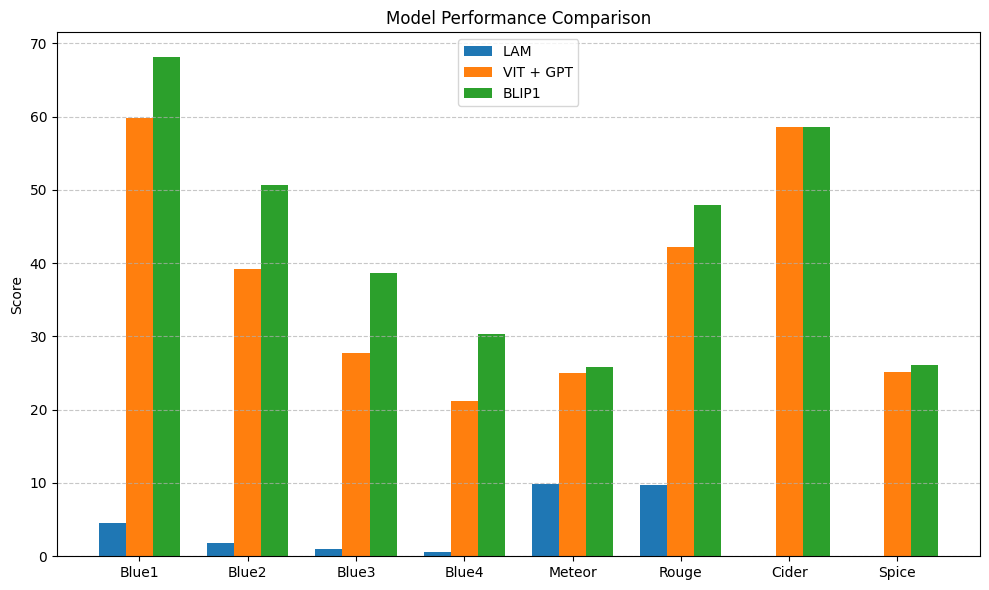

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Data
# Replace None with np.nan for plotting
LAM = [np.nan if v is None else v for v in LAM]

# Plot
x = np.arange(len(metrics))
width = 0.25

fig, ax = plt.subplots(figsize=(10, 6))
ax.bar(x - width, LAM, width, label='LAM')
ax.bar(x, VIT_GPT, width, label='VIT + GPT')
ax.bar(x + width, BLIP1, width, label='BLIP1')

# Labels and title
ax.set_ylabel('Score')
ax.set_title('Model Performance Comparison')
ax.set_xticks(x)
ax.set_xticklabels(metrics)
ax.legend()
ax.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()


### Blip1 vs VitGpt vs LAM

We can infer from the above diagram,  that BLIP has outperformed the other baseline models on all metrics.
The reason for this is :
1.  Blip trains vision and language components together with shared objectives, while ViT+GPT2 would typically be trained separately and then combined
Joint training allows better cross-modal alignment and understanding.
2. BLIP uses three complementary objectives (ITC, ITM, LM) that reinforce each other
ViT+GPT2 would only use language modeling objective, missing contrastive and matching signals3

![Plateau5.jpg](Plateau5.jpg)

Based on the training and validation loss curves shown, several key observations can be made about the performance of different model architectures. The results indicate that all models reach a plateau before epoch 5, suggesting efficient convergence and stable training dynamics across the different approaches.

**Plateau < epoch 5 Model Performance:**
<p align = "justify">The Plateau model demonstrates rapid convergence with both training and validation losses stabilizing early in the training process. The training loss (blue line) shows a steep initial decline followed by gradual stabilization, while the validation loss (red line) exhibits similar behavior with minimal overfitting, indicating good generalization capability. The close alignment between training and validation curves suggests the model is well-regularized and not experiencing significant overfitting issues.

**ViT+GPT2 Model Performance:**
<p align = "justify">The ViT+GPT2 architecture shows more complex training dynamics across different BLEU score metrics (BLEU-1, BLEU-2, BLEU-3, and BLEU-4). The model demonstrates varying performance levels for different BLEU scores, with BLEU-1 (red) showing the highest scores, followed by progressively lower scores for BLEU-2 (yellow), BLEU-3 (green), and BLEU-4 (purple). This pattern is expected as higher-order BLEU scores are more stringent, requiring longer n-gram matches. The curves show steady improvement over epochs with some fluctuation, indicating the model continues to learn and refine its caption generation capabilities.

**BLIP-1 Model Performance:**
<p align = "justify">The BLIP-1 architecture exhibits the most stable training characteristics among all models, with BLEU scores showing consistent performance across different metrics. The BLEU-1 through BLEU-4 curves (represented in different colors) demonstrate relatively stable performance with minor fluctuations, suggesting robust and consistent caption generation quality. The close clustering of different BLEU score curves indicates balanced performance across different evaluation criteria, which is characteristic of well-trained multimodal models that have benefited from the unified training approach incorporating ITC, ITM, and LM objectives.


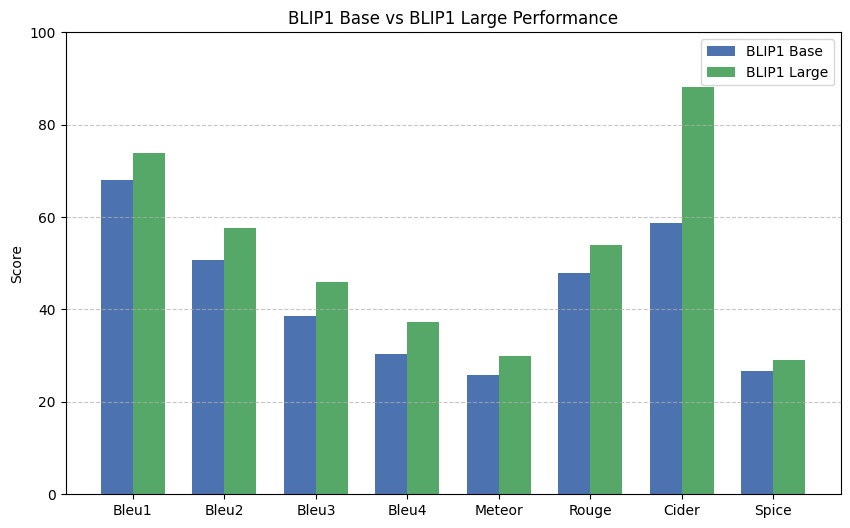

In [ ]:

# Data from table
metrics = ["Bleu1", "Bleu2", "Bleu3", "Bleu4", "Meteor", "Rouge", "Cider", "Spice"]
blip1_base = [68.09, 50.71, 38.65, 30.27, 25.79, 47.94, 58.64, 26.71]
blip1_large = [73.87, 57.73, 45.84, 37.19, 29.99, 53.97, 88.22, 29.17]

x = np.arange(len(metrics))
width = 0.35

plt.figure(figsize=(10,6))
plt.bar(x - width/2, blip1_base, width, label="BLIP1 Base", color="#4C72B0")
plt.bar(x + width/2, blip1_large, width, label="BLIP1 Large", color="#55A868")

plt.ylabel("Score")
plt.title("BLIP1 Base vs BLIP1 Large Performance")
plt.xticks(x, metrics)
plt.ylim(0, 100)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.show()


### Blip1 Large vs Blip1 Base

1. **Enhanced Visual Understanding** – The large model can capture finer details, textures, and spatial relationships compared to the base model:  
   - **Base**: Recognizes general objects and scenes  
   - **Large**: Detects subtle patterns, fine textures, and complex spatial arrangements  
   - Especially beneficial for satellite imagery with small features (cars, trees, pools), where the large model’s higher-resolution attention excels.  

2. **Improved Spatial Comprehension** – Richer and more detailed representations thanks to higher embedding quality:  
   - **Base**: 768-dimensional embeddings  
   - **Large**: 1024-dimensional embeddings — 33% higher information capacity with more layers, enabling better compositional understanding  
   - Stronger at identifying relationships, e.g., “airport next to highway.”  

3. **Superior Language Generation** – Expanded vocabulary and improved fluency:  
   - **Base**: Produces good captions but occasionally makes errors  
   - **Large**: Generates more fluent, grammatically correct, and descriptive captions  
   - Better at differentiating nuanced terms like “marina,” “harbor,” and “dock,” as well as using precise terminology for satellite features.  




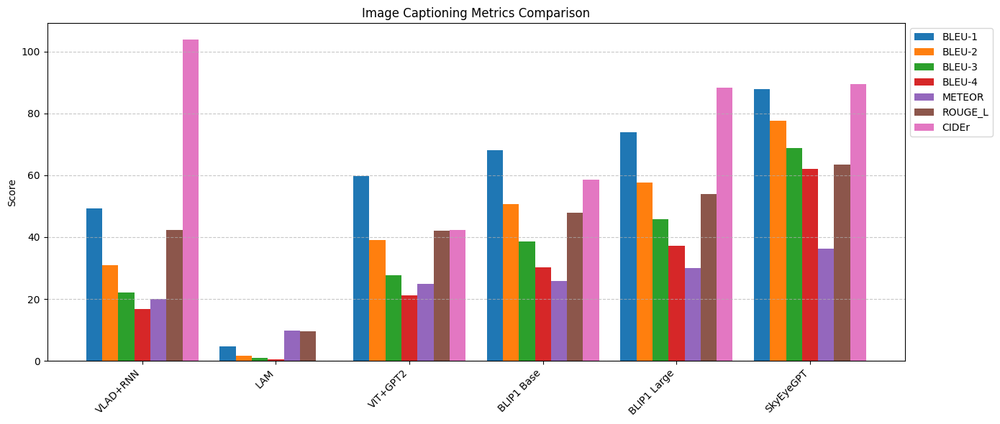

In [ ]:
 import matplotlib.pyplot as plt
import numpy as np

# Data from the table
models = ["VLAD+RNN", "LAM", "VIT+GPT2", "BLIP1 Base", "BLIP1 Large", "SkyEyeGPT"]
bleu1 = [49.3, 4.6, 59.77, 68.09, 73.87, 87.73]
bleu2 = [30.91, 1.78, 39.14, 50.71, 57.73, 77.7]
bleu3 = [22.09, 0.98, 27.8, 38.65, 45.84, 68.9]
bleu4 = [16.77, 0.62, 21.23, 30.27, 37.19, 61.99]
meteor = [19.96, 9.8, 24.97, 25.79, 29.99, 36.23]
rouge = [42.42, 9.67, 42.14, 47.94, 53.97, 63.54]
cider = [103.92, None, 42.22, 58.64, 88.22, 89.37]
spice = [None, None, 25.10, 26.71, 29.17, None]

# Prepare figure
x = np.arange(len(models))
width = 0.12

fig, ax = plt.subplots(figsize=(14, 6))

# Plot each metric
ax.bar(x - 3*width, bleu1, width, label='BLEU-1')
ax.bar(x - 2*width, bleu2, width, label='BLEU-2')
ax.bar(x - width, bleu3, width, label='BLEU-3')
ax.bar(x, bleu4, width, label='BLEU-4')
ax.bar(x + width, meteor, width, label='METEOR')
ax.bar(x + 2*width, rouge, width, label='ROUGE_L')
ax.bar(x + 3*width, [v if v is not None else 0 for v in cider], width, label='CIDEr')

ax.set_ylabel('Score')
ax.set_title('Image Captioning Metrics Comparison')
ax.set_xticks(x)
ax.set_xticklabels(models, rotation=45, ha='right')
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

# Add grid
ax.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()


### Key Observations

**BLIP1 Large** clearly performed best compared to our baseline models, showing:

- Significant improvement over **BLIP1 Base** in all **BLEU scores**, **METEOR**, **ROUGE_L**, and **SPICE**.
- Especially high **CIDEr** (+29.58 compared to BLIP1 Base), indicating stronger semantic alignment between generated captions and references.

**ViT+GPT2** was competitive in medium  intensity image but lagged behind BLIP1 architectures, suggesting that BLIP’s pretraining and architecture scaling are key advantages.

**LAM** underperformed across all metrics, aligning with earlier findings that its lightweight architecture struggles with complex datasets like satellite imagery.

### External Models:
- **SkyEyeGPT** remains the best-performing model overall, surpassing even BLIP1 Large in most metrics, particularly **BLEU scores** and **ROUGE_L**.
- **VLAD+RNN** has the best **CIDEr** metric (**103.92**), indicating it may still excel at matching n-gram patterns despite weaker fluency.

---


### Conclusion

Our experiments show that **BLIP-1 Large** performs better than other models, benefiting from its multi-task pretraining on natural images.  
However, it lacks vocabulary specialized for the remote sensing domain, which limits its descriptive accuracy for domain-specific content.

The Remote Sensing Image Captioning task presents unique challenges due to the **small and imbalanced dataset**, which makes accurate model training difficult.  

Captions in the dataset are often **generic**, reducing their descriptive richness.  
Moreover, evaluation suffers from **non-consensus metrics**, where real-world applicability often outweighs standard benchmarks such as BLEU.


Fine-tuning remains challenging, particularly when trying to improve semantic context through attention mechanisms.  
**Data augmentation** strategies showed limited benefit, indicating the need for **greater variation and diversity** in training data.

Despite these challenges, Remote Sensing Image Captioning holds **significant potential** in enhancing the understanding of the spatial world, especially for applications such as **future robotics and automated environmental analysis**.
